[*********************100%%**********************]  20 of 20 completed


Epoch 1/3
1908/1908 [==============================] - 178s 90ms/step - loss: 0.0115 - val_loss: 0.0052
Epoch 2/3
1908/1908 [==============================] - 165s 87ms/step - loss: 0.0068 - val_loss: 0.0012
Epoch 3/3
1908/1908 [==============================] - 165s 87ms/step - loss: 0.0013 - val_loss: 9.5031e-04


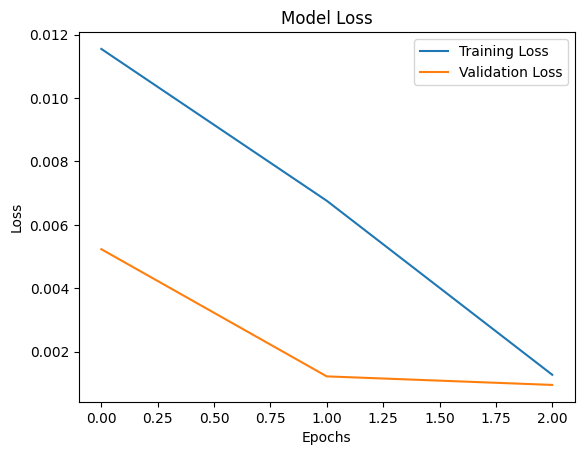

530/530 [==============================] - 14s 24ms/step
Root Mean Squared Error: 0.002202387918952039


In [ ]:
import numpy as np
import pandas as pd
import yfinance as yf
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from keras.models import Sequential
from keras.layers import LSTM, Dense, Dropout
from keras.callbacks import EarlyStopping
import matplotlib.pyplot as plt

# Fetching data for Nifty top 20 stocks from Yahoo Finance
nifty_stocks = ["RELIANCE.NS", "TCS.NS", "HDFCBANK.NS", "ADANIENT.NS", "INFY.NS",
                "KOTAKBANK.NS", "ICICIBANK.NS", "LT.NS", "BHARTIARTL.NS",
                "HCLTECH.NS", "MARUTI.NS", "AXISBANK.NS", "SBIN.NS",
                "INDUSINDBK.NS", "ASIANPAINT.NS", "ITC.NS", "NESTLEIND.NS",
                "TATAMOTORS.NS", "SUNPHARMA.NS", "ULTRACEMCO.NS"]

start_date = "2000-01-01"
end_date = "2023-12-31"

stock_data = yf.download(nifty_stocks, start=start_date, end=end_date)

# Calculating log returns
log_returns = np.log(stock_data['Adj Close'] / stock_data['Adj Close'].shift(1))

# Calculating volatility (standard deviation of log returns)
volatility = log_returns.rolling(window=252).std().dropna()

# Define a function to prepare the data for LSTM model
def prepare_data(data, window_size):
    X, y = [], []
    for i in range(len(data) - window_size):
        X.append(data[i:i+window_size])
        y.append(data[i+window_size])
    return np.array(X), np.array(y)

# Scaling the data
scaler = MinMaxScaler(feature_range=(0, 1))
scaled_data = scaler.fit_transform(volatility.values.reshape(-1, 1))

# Prepare data for LSTM model
window_size = 60  # Number of past days to consider
X, y = prepare_data(scaled_data, window_size)

# Splitting data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)

# Reshape input data to be 3D [samples, time steps, features]
X_train = np.reshape(X_train, (X_train.shape[0], window_size, 1))
X_test = np.reshape(X_test, (X_test.shape[0], window_size, 1))

# Building the LSTM model
model = Sequential()
model.add(LSTM(units=50, return_sequences=True, input_shape=(X_train.shape[1], 1)))
model.add(Dropout(0.2))
model.add(LSTM(units=50, return_sequences=True))
model.add(Dropout(0.2))
model.add(LSTM(units=50))
model.add(Dropout(0.2))
model.add(Dense(units=1))

# Compile the model
model.compile(optimizer='adam', loss='mean_squared_error')

# Train the model
early_stop = EarlyStopping(monitor='val_loss', patience=5, verbose=1)
history = model.fit(X_train, y_train, epochs=3, batch_size=32, validation_split=0.1, callbacks=[early_stop], verbose=1)

# Plotting training loss and validation loss
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Make predictions
predictions = model.predict(X_test)

# Rescale predictions and actual values
predictions = scaler.inverse_transform(predictions)
y_test = scaler.inverse_transform(y_test)

# Calculate root mean squared error
rmse = np.sqrt(np.mean(((predictions - y_test) ** 2)))
print('Root Mean Squared Error:', rmse)


In [ ]:
# Fetching data for the required period
start_date_test = "2018-08-01"
end_date_test = "2023-08-01"
test_stock_data = yf.download(nifty_stocks, start=start_date_test, end=end_date_test)

# Calculating log returns
test_log_returns = np.log(test_stock_data['Adj Close'] / test_stock_data['Adj Close'].shift(1))

# Calculating volatility (standard deviation of log returns)
test_volatility = test_log_returns.rolling(window=252).std().dropna()

# Scaling the data
scaled_test_data = scaler.transform(test_volatility.values.reshape(-1, 1))

# Prepare data for LSTM model
test_X, test_y = prepare_data(scaled_test_data, window_size)

# Reshape input data to be 3D [samples, time steps, features]
test_X = np.reshape(test_X, (test_X.shape[0], window_size, 1))

# Make predictions
test_predictions = model.predict(test_X)

# Rescale predictions and actual values
test_predictions = scaler.inverse_transform(test_predictions)
test_y = scaler.inverse_transform(test_y)

# Calculate root mean squared error
test_rmse = np.sqrt(np.mean(((test_predictions - test_y) ** 2)))
print('Root Mean Squared Error on Test Data:', test_rmse)


[*********************100%%**********************]  20 of 20 completed


612/612 [==============================] - 27s 43ms/step
Root Mean Squared Error on Test Data: 0.0022564185799618932


In [ ]:
# Fetching data for Nifty top 20 stocks from 2018 to 2023
start_date_test = "2018-01-01"
end_date_test = "2023-12-31"
test_stock_data = yf.download(nifty_stocks, start=start_date_test, end=end_date_test)

# Calculating log returns
test_log_returns = np.log(test_stock_data['Adj Close'] / test_stock_data['Adj Close'].shift(1))

# Calculating volatility (standard deviation of log returns)
test_volatility = test_log_returns.rolling(window=252).std().dropna()

# Scaling the test data
test_scaled_data = scaler.transform(test_volatility.values.reshape(-1, 1))

# Prepare data for LSTM model
test_X, test_y = prepare_data(test_scaled_data, window_size)

# Reshape input data to be 3D [samples, time steps, features]
test_X = np.reshape(test_X, (test_X.shape[0], window_size, 1))

# Make predictions on test data
test_predictions = model.predict(test_X)

# Rescale predictions
test_predictions = scaler.inverse_transform(test_predictions)

# Calculate RMSE for test data
test_rmse = np.sqrt(np.mean(((test_predictions - test_y) ** 2)))
print('Root Mean Squared Error on Test Data:', test_rmse)


[*********************100%%**********************]  20 of 20 completed


767/767 [==============================] - 19s 25ms/step
Root Mean Squared Error on Test Data: 0.26924177165770063


In [ ]:
# Print actual and predicted volatilities for each stock
for stock_symbol in nifty_stocks:
    actual_volatility = test_volatility[stock_symbol].values
    predicted_volatility = test_predictions.reshape(-1)  # Flatten the predictions

    print(f"Stock Symbol: {stock_symbol}")
    print("Date\t\t\tActual Volatility\tPredicted Volatility")
    for date, actual, predicted in zip(test_volatility.index, actual_volatility, predicted_volatility):
        # print(f"{date}\t{actual:.6f}\t\t\t{predicted:.6f}")
        print(len(test_volatility.index),len(predicted_volatility))


In [ ]:
!pip install arch

In [ ]:
import yfinance as yf
import numpy as np
import pandas as pd
from arch import arch_model
import datetime

# Fetching data for Reliance Industries Limited (RELIANCE.NS) from August 2018 to August 2023
ticker = 'RELIANCE.NS'
start_date = '2018-08-01'
end_date = '2023-08-31'

data = yf.download(ticker, start=start_date, end=end_date)

# Calculate daily returns
returns = data['Adj Close'].pct_change().dropna()

# Predict volatility for each day
predicted_volatility = []
for date in returns.index:
    train_data = returns.loc[:date]
    model = arch_model(train_data, vol='Garch', p=1, q=1)
    fit_model = model.fit(disp='off')
    tomorrow_volatility = fit_model.forecast(horizon=1).variance[-1:]
    predicted_volatility.append(tomorrow_volatility.iloc[-1, 0])

# Creating a DataFrame to store predicted volatilities
predicted_df = pd.DataFrame({'Date': returns.index, 'Predicted Volatility': predicted_volatility})
predicted_df.set_index('Date', inplace=True)

print(predicted_df)


In [ ]:
import yfinance as yf
import numpy as np
import pandas as pd
from arch import arch_model
import datetime
import matplotlib.pyplot as plt

# Fetching data for Reliance Industries Limited (RELIANCE.NS) from August 2018 to August 2023
ticker = 'RELIANCE.NS'
start_date = '2018-08-01'
end_date = '2023-08-31'

data = yf.download(ticker, start=start_date, end=end_date)

# Calculate daily returns
returns = data['Adj Close'].pct_change().dropna()

# Predict volatility for each day
predicted_volatility = []
for i in range(1, len(returns)):
    train_data = returns.iloc[:i]
    model = arch_model(train_data, vol='Garch', p=1, q=1)
    fit_model = model.fit(disp='off')
    tomorrow_volatility = fit_model.forecast(horizon=1).variance[-1:]
    predicted_volatility.append(np.sqrt(tomorrow_volatility.iloc[-1, 0]))

# Creating a DataFrame to store predicted volatilities
predicted_df = pd.DataFrame({'Date': returns.index[1:], 'Predicted Volatility': predicted_volatility})
predicted_df.set_index('Date', inplace=True)

# Plotting
plt.figure(figsize=(12, 6))
plt.plot(predicted_df.index, predicted_df['Predicted Volatility'], label='Predicted Volatility', color='blue')
plt.plot(returns.index[1:], returns.values[1:], label='Daily Returns', color='red', alpha=0.5)
plt.title('Predicted Volatility vs Daily Returns')
plt.xlabel('Date')
plt.ylabel('Value')
plt.legend()
plt.show()


[*********************100%%**********************]  1 of 1 completed
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning:

The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.




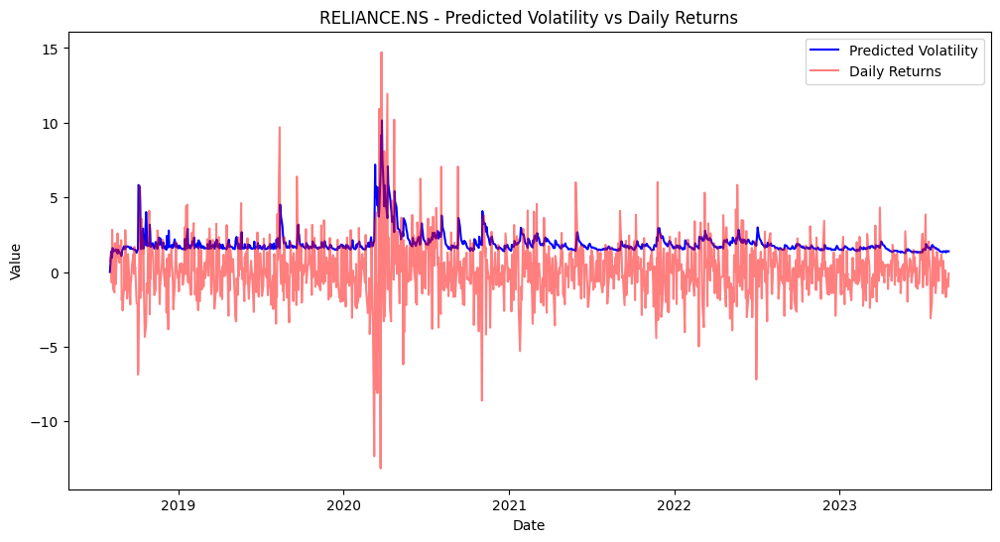

[*********************100%%**********************]  1 of 1 completed
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning:

The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.




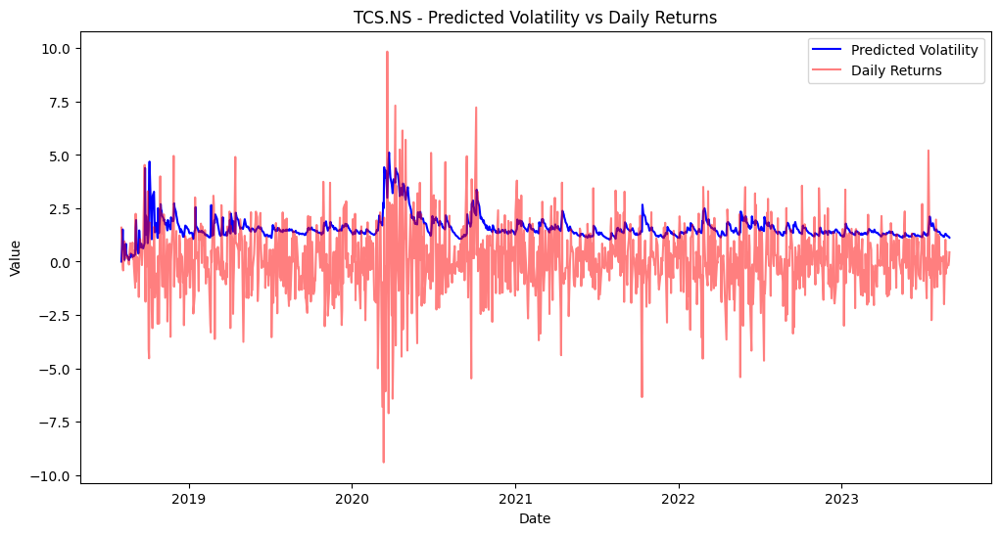

[*********************100%%**********************]  1 of 1 completed
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning:

The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.




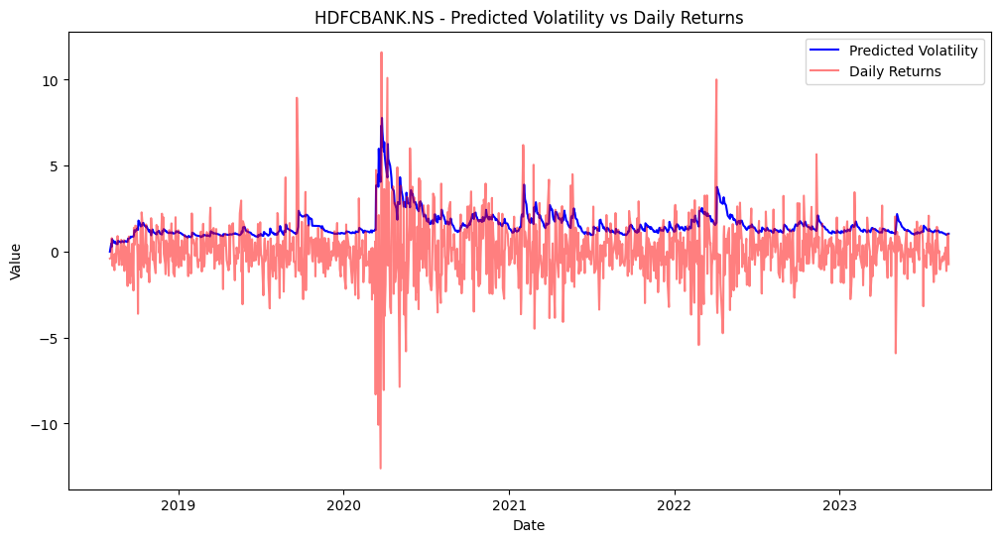

[*********************100%%**********************]  1 of 1 completed
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning:

The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.




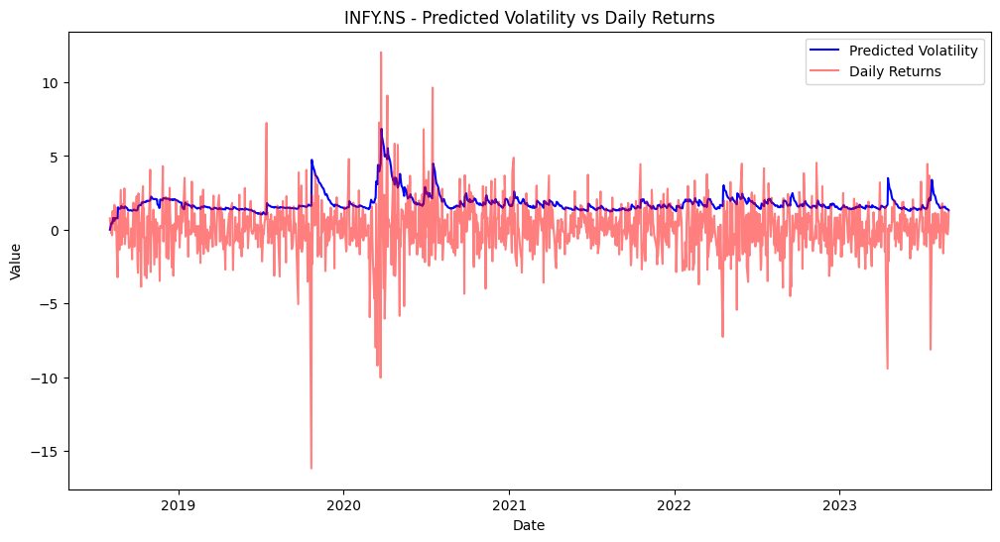

[*********************100%%**********************]  1 of 1 completed
ERROR:yfinance:
1 Failed download:
ERROR:yfinance:['HDFC.NS']: Exception('%ticker%: No price data found, symbol may be delisted (1d 2018-08-01 -> 2023-08-31)')
[*********************100%%**********************]  1 of 1 completed
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning:

The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.




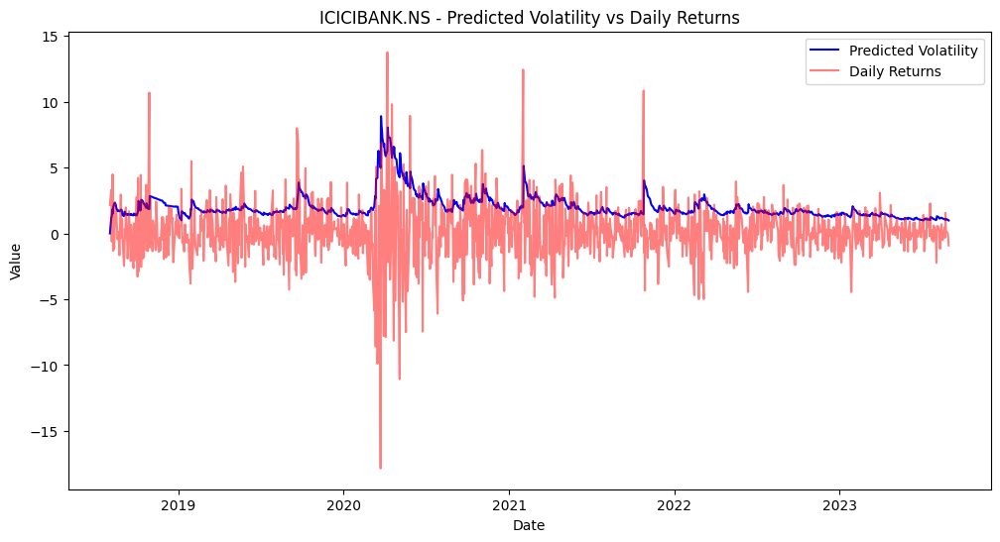

[*********************100%%**********************]  1 of 1 completed
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning:

The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.




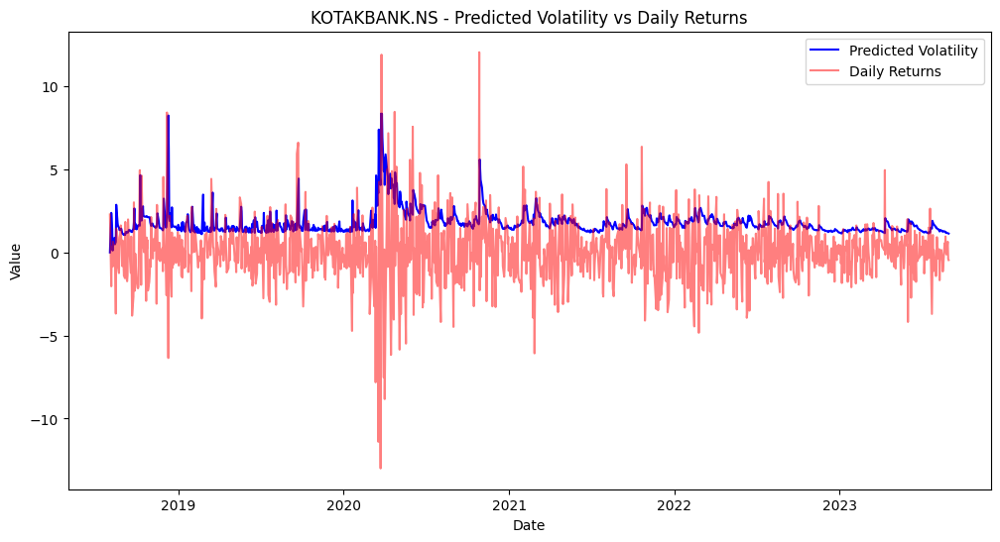

[*********************100%%**********************]  1 of 1 completed
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning:

The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.




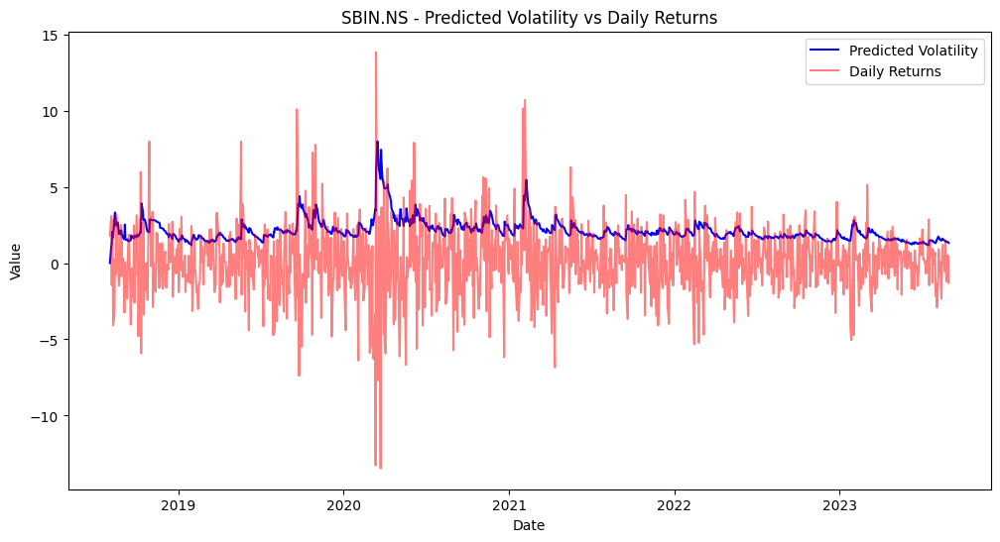

[*********************100%%**********************]  1 of 1 completed
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning:

The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.




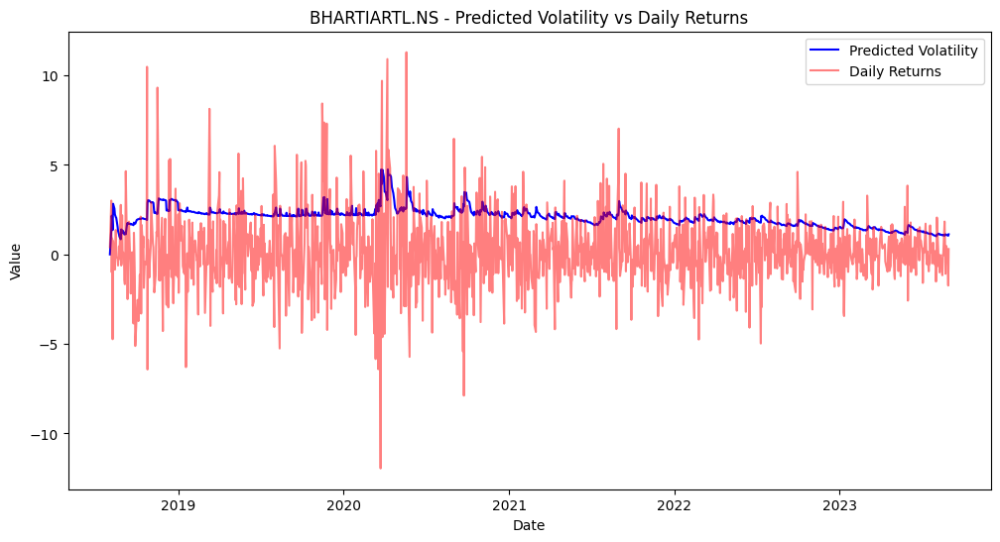

[*********************100%%**********************]  1 of 1 completed
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning:

The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.




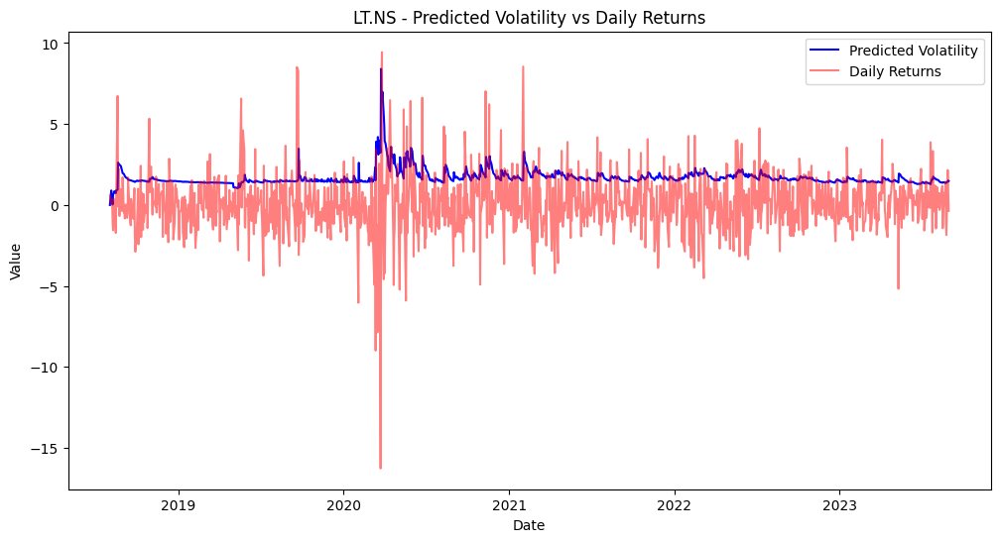

[*********************100%%**********************]  1 of 1 completed
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning:

The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.




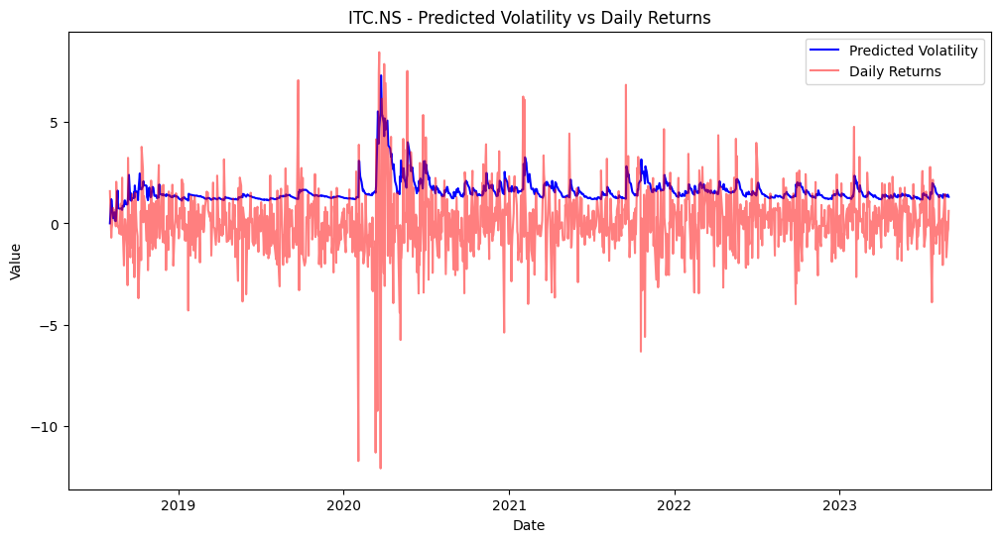

[*********************100%%**********************]  1 of 1 completed
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning:

The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.




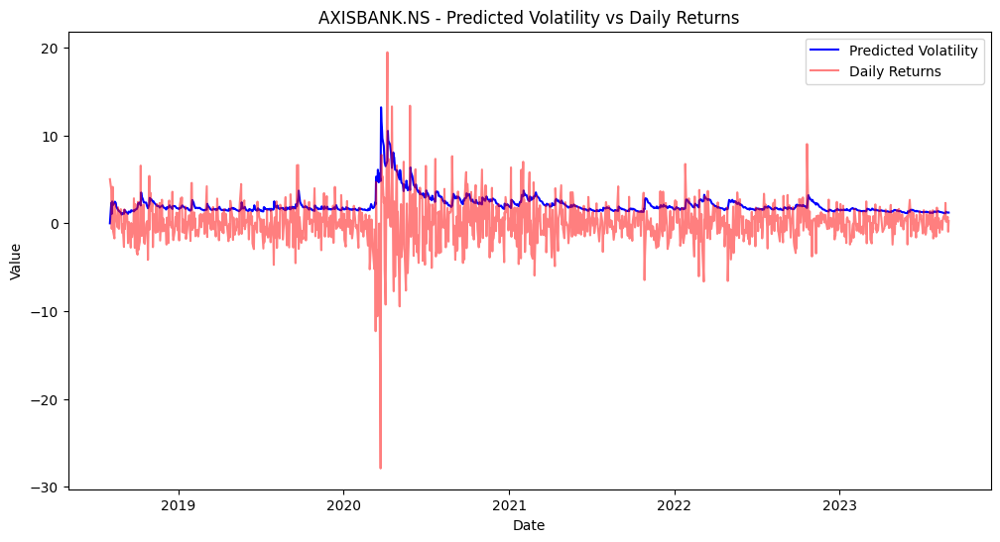

[*********************100%%**********************]  1 of 1 completed
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning:

The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.




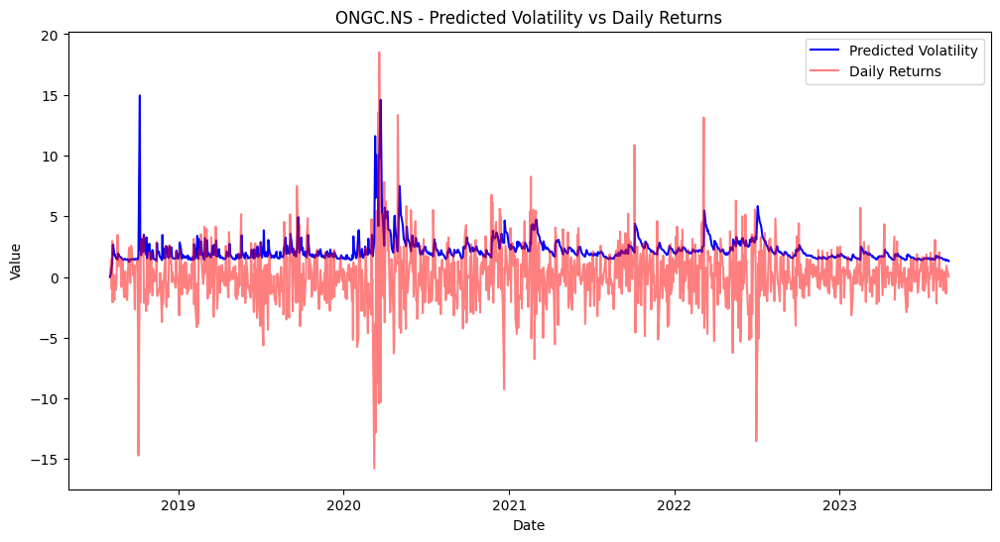

[*********************100%%**********************]  1 of 1 completed
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning:

The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.




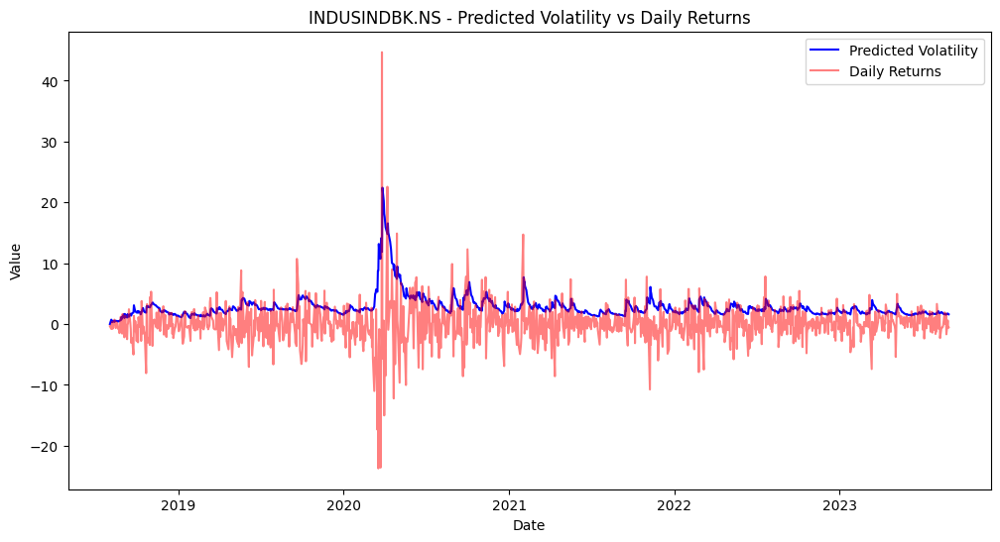

[*********************100%%**********************]  1 of 1 completed
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning:

The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.




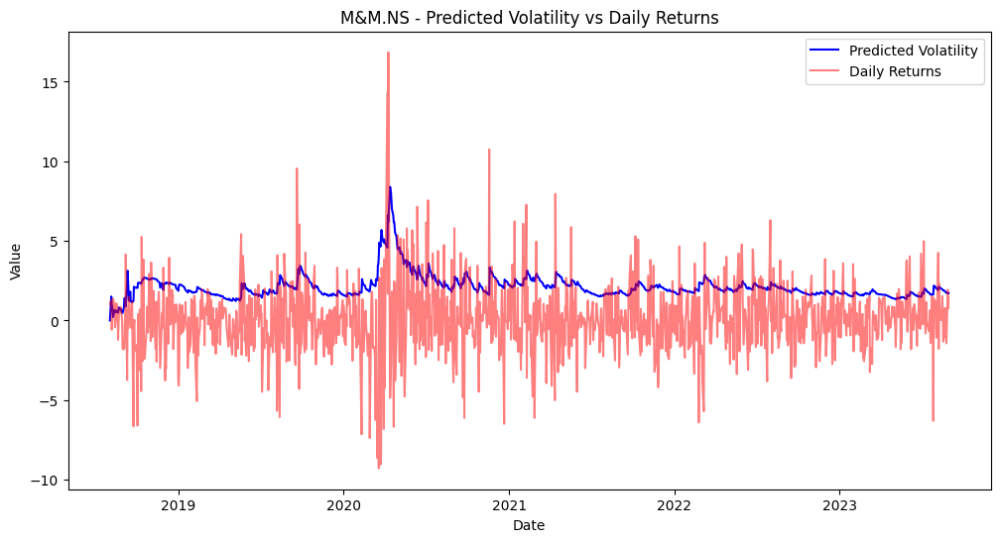

[*********************100%%**********************]  1 of 1 completed
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning:

The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.




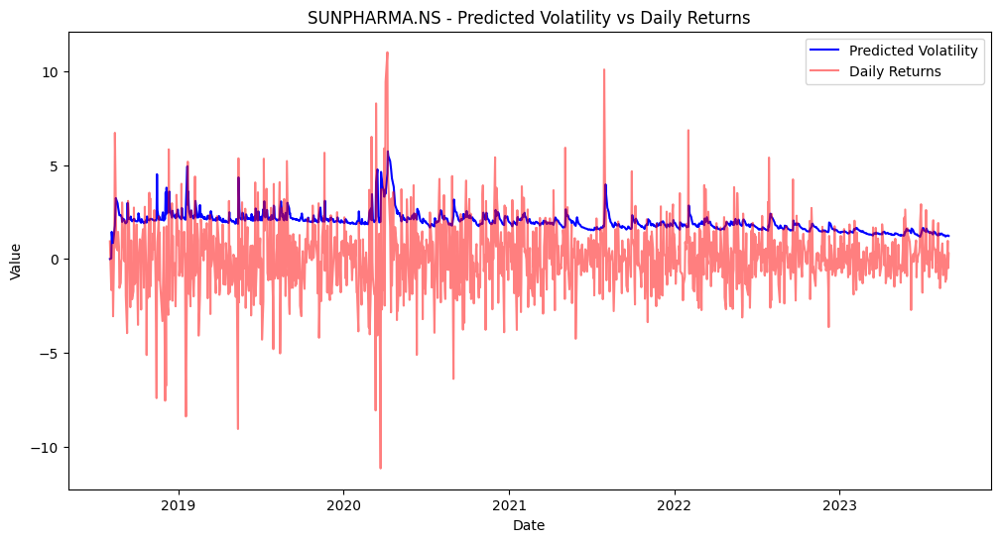

[*********************100%%**********************]  1 of 1 completed
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning:

The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.




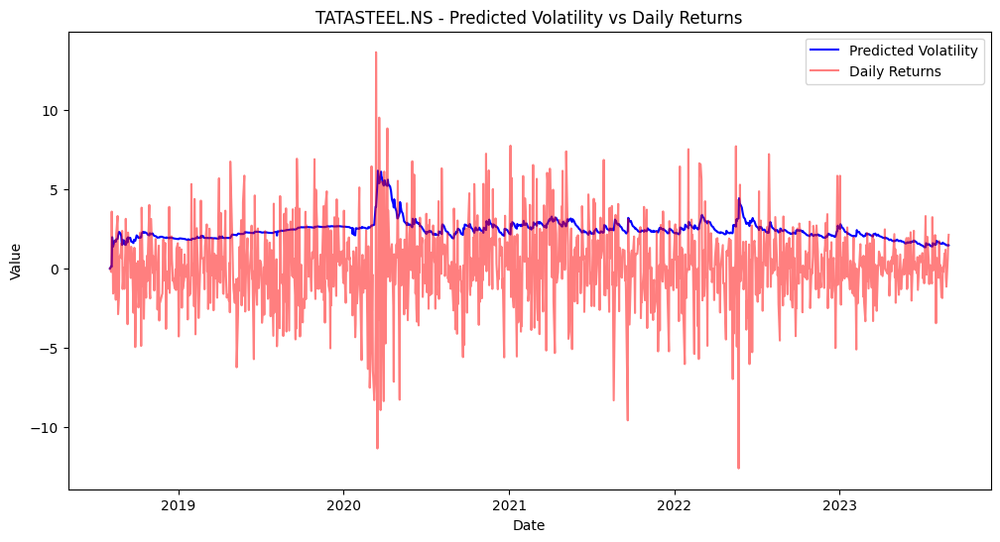

[*********************100%%**********************]  1 of 1 completed
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning:

The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.




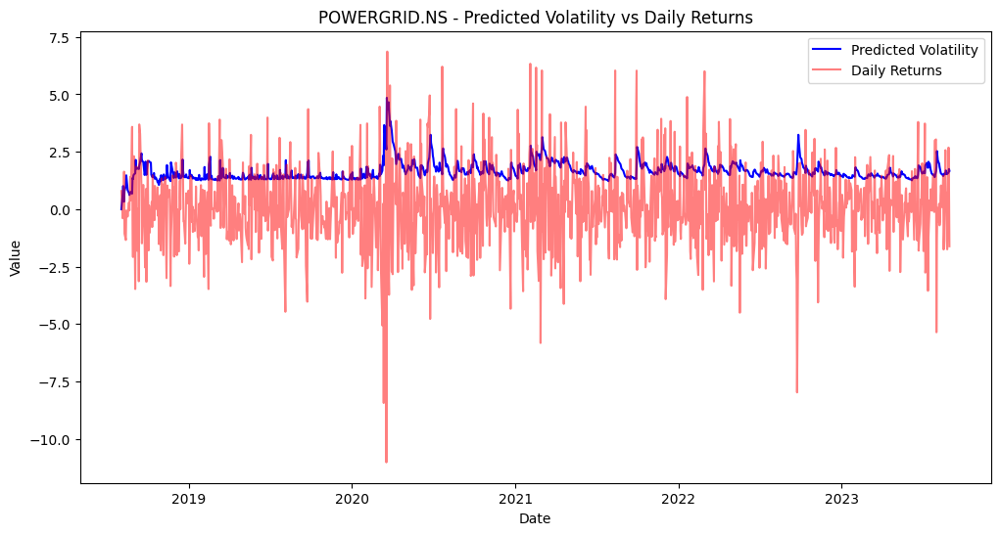

[*********************100%%**********************]  1 of 1 completed
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning:

The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.




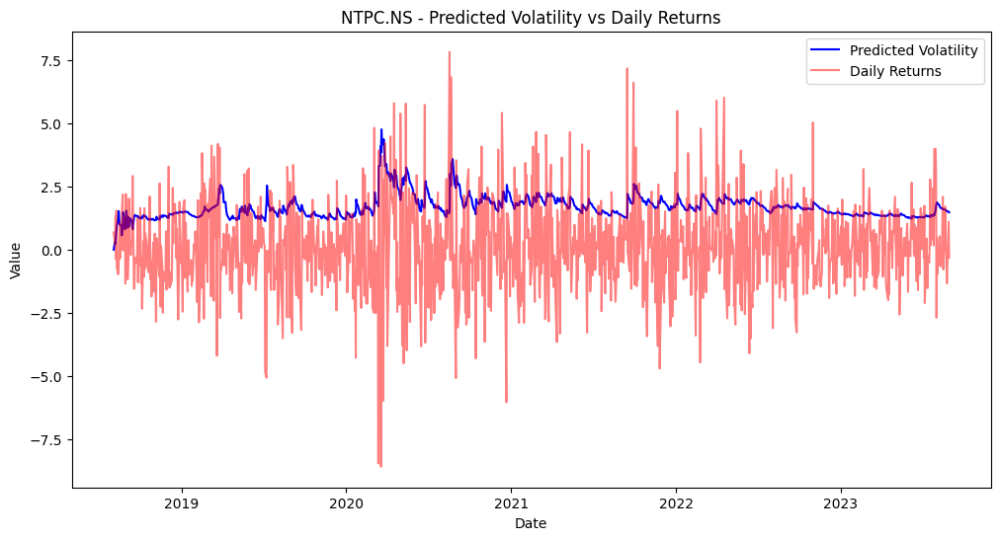

[*********************100%%**********************]  1 of 1 completed
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:766: ConvergenceWarning:

The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.




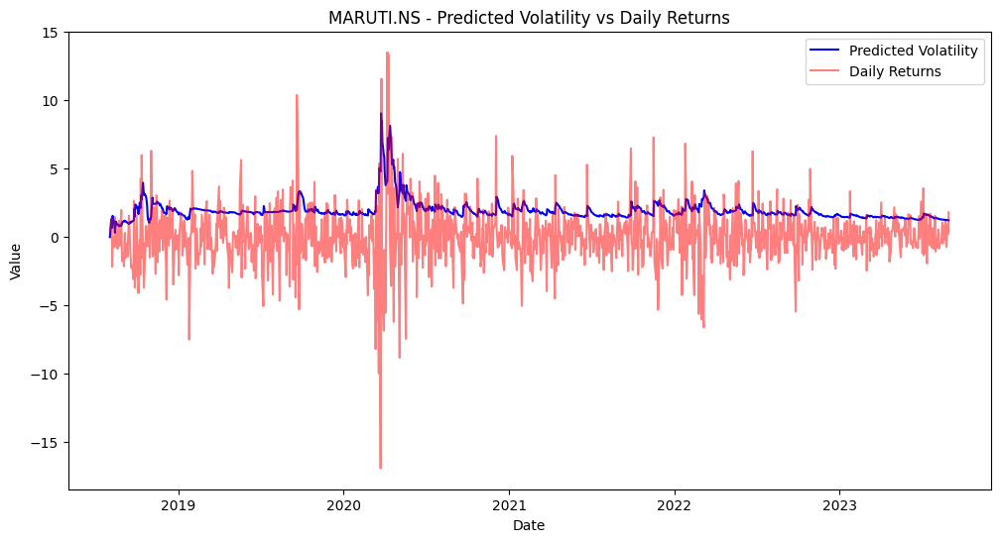

In [ ]:
import yfinance as yf
import numpy as np
import pandas as pd
from arch import arch_model
import matplotlib.pyplot as plt

# List of top 20 NSE stock symbols
top_20_stocks = [
    'RELIANCE.NS', 'TCS.NS', 'HDFCBANK.NS', 'INFY.NS', 'HDFC.NS', 'ICICIBANK.NS', 'KOTAKBANK.NS',
    'SBIN.NS', 'BHARTIARTL.NS', 'LT.NS', 'ITC.NS', 'AXISBANK.NS', 'ONGC.NS', 'INDUSINDBK.NS',
    'M&M.NS', 'SUNPHARMA.NS', 'TATASTEEL.NS', 'POWERGRID.NS', 'NTPC.NS', 'MARUTI.NS'
]

# Fetching data for the top 20 NSE stocks from August 2018 to August 2023
start_date = '2018-08-01'
end_date = '2023-08-31'

for stock in top_20_stocks:
    data = yf.download(stock, start=start_date, end=end_date)
    if len(data) > 0:
        returns = data['Adj Close'].pct_change().dropna() * 100  # Rescale the data
        predicted_volatility = []
        for i in range(1, len(returns)):
            train_data = returns.iloc[:i]
            model = arch_model(train_data, vol='Garch', p=1, q=1, rescale=False)  # Disable rescale
            fit_model = model.fit(disp='off')
            tomorrow_volatility = fit_model.forecast(horizon=1).variance[-1:]
            predicted_volatility.append(np.sqrt(tomorrow_volatility.iloc[-1, 0]))

        # Plotting
        plt.figure(figsize=(12, 6))
        plt.plot(returns.index[1:], predicted_volatility, label='Predicted Volatility', color='blue')
        plt.plot(returns.index[1:], returns.values[1:], label='Daily Returns', color='red', alpha=0.5)
        plt.title(f'{stock} - Predicted Volatility vs Daily Returns')
        plt.xlabel('Date')
        plt.ylabel('Value')
        plt.legend()
        plt.show()


# Volatility Breakout Strategy

In [ ]:
import pandas as pd
import yfinance as yf  # For downloading stock data from Yahoo Finance

# Function to calculate high volatility based on historical stock prices
def calculate_volatility(stock_data, window=20):
    stock_data['Returns'] = stock_data['Close'].pct_change()
    volatility = stock_data['Returns'].rolling(window=window).std()
    return volatility

# Function to generate buy and sell signals based on volatility threshold
def generate_signals(stock_data, volatility_threshold=0.05):
    signals = pd.DataFrame(index=stock_data.index)
    signals['Buy'] = (stock_data['Volatility'] > volatility_threshold).astype(int)
    signals['Sell'] = (stock_data['Volatility'] < volatility_threshold).astype(int)
    return signals

# Main function to apply strategy on NSE top 20 stocks
def apply_trading_strategy():
    # Download data for top 20 NSE stocks
    top_20_stocks = ['TCS.NS', 'HDFCBANK.NS', 'RELIANCE.NS', 'INFY.NS', 'ICICIBANK.NS', 'SBIN.NS', 'HCLTECH.NS',
                     'KOTAKBANK.NS', 'BHARTIARTL.NS', 'LT.NS', 'ITC.NS', 'MARUTI.NS', 'AXISBANK.NS', 'HINDUNILVR.NS',
                     'ONGC.NS', 'TATASTEEL.NS', 'POWERGRID.NS', 'NESTLEIND.NS', 'SUNPHARMA.NS', 'ULTRACEMCO.NS']

    # Define the time period for data
    start_date = '2020-01-01'
    end_date = '2024-01-01'

    # Initialize an empty DataFrame to store signals for all stocks
    all_signals = pd.DataFrame()

    # Loop through each stock, calculate volatility, and generate signals
    for stock_symbol in top_20_stocks:
        # Download stock data from Yahoo Finance
        stock_data = yf.download(stock_symbol, start=start_date, end=end_date)

        # Calculate volatility
        stock_data['Volatility'] = calculate_volatility(stock_data)

        # Generate buy and sell signals
        signals = generate_signals(stock_data)

        # Combine signals with existing signals
        all_signals = pd.concat([all_signals, signals['Buy']], axis=1)

    # Summing up signals across all stocks to find overall buy/sell signals
    all_signals['Total_Buy'] = all_signals.sum(axis=1)
    all_signals['Total_Sell'] = len(top_20_stocks) - all_signals['Total_Buy']

    # Printing the total buy and sell signals
    print("Total Buy Signals:", all_signals['Total_Buy'].sum())
    print("Total Sell Signals:", all_signals['Total_Sell'].sum())

# Execute the trading strategy
apply_trading_strategy()


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%*******

Total Buy Signals: 352
Total Sell Signals: 19488


[*********************100%%**********************]  1 of 1 completed


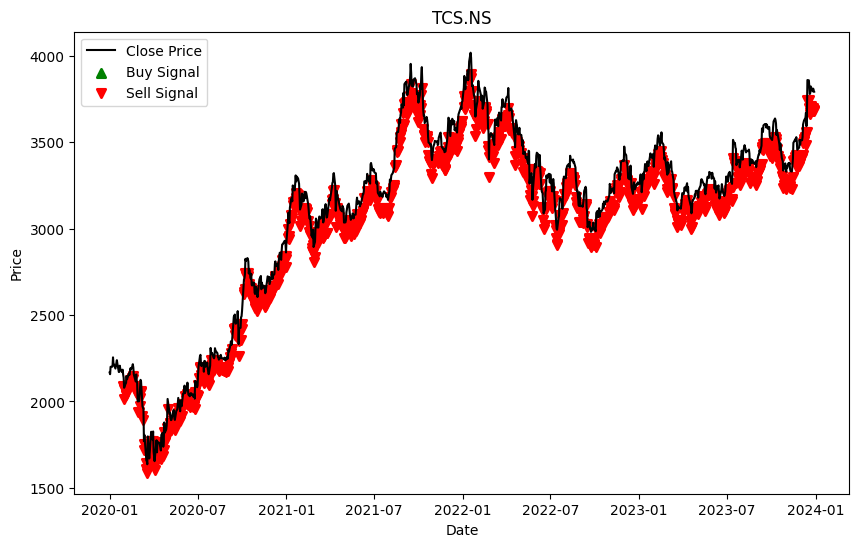

[*********************100%%**********************]  1 of 1 completed


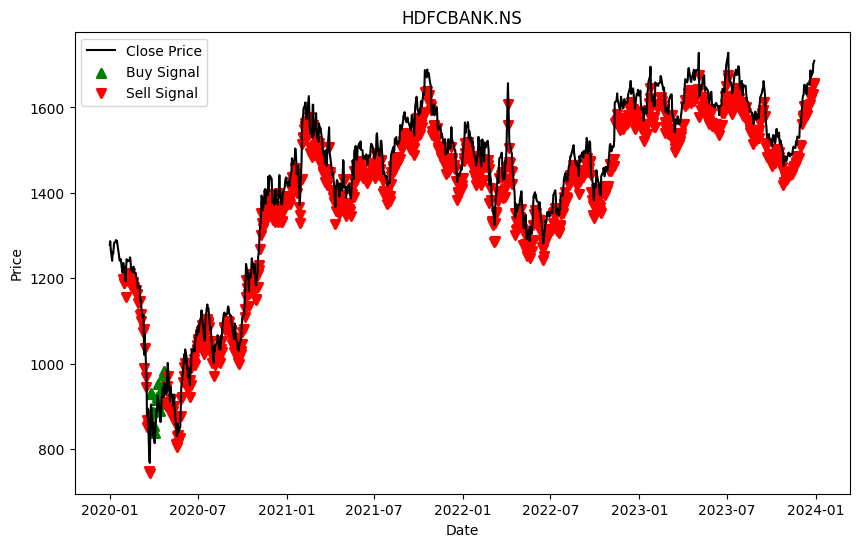

[*********************100%%**********************]  1 of 1 completed


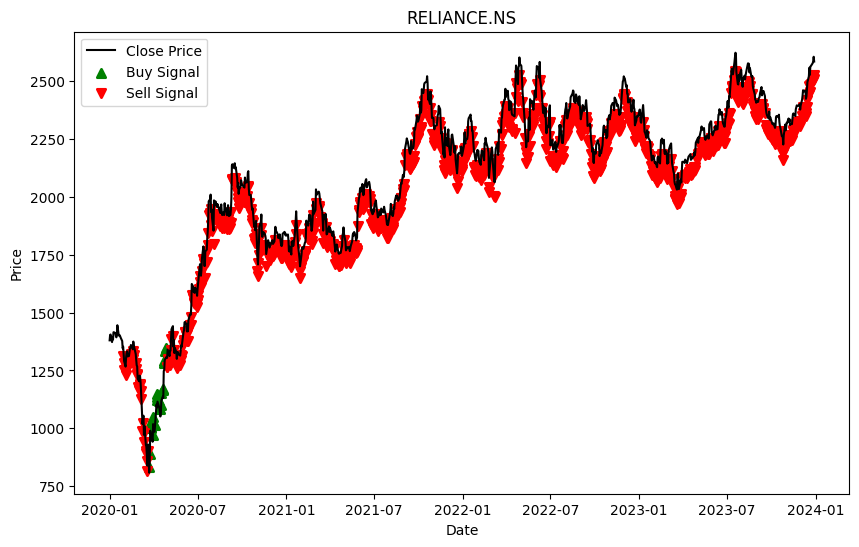

[*********************100%%**********************]  1 of 1 completed


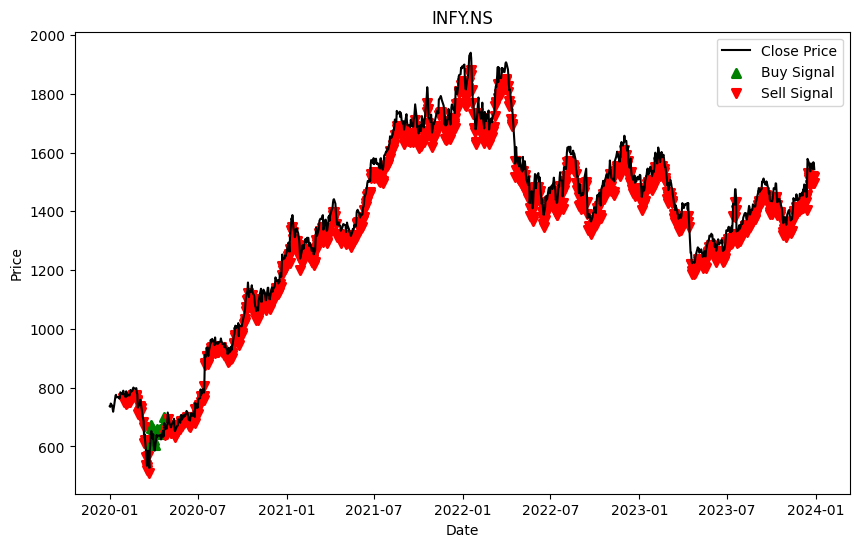

[*********************100%%**********************]  1 of 1 completed


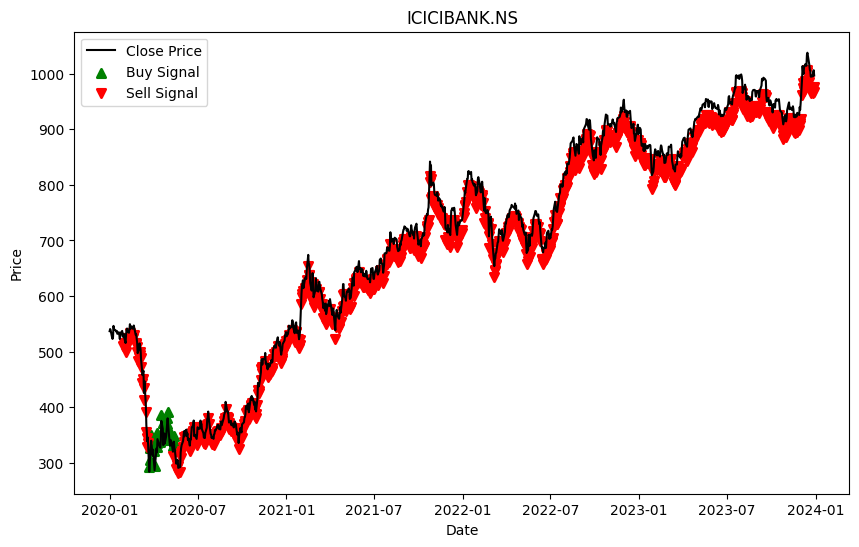

[*********************100%%**********************]  1 of 1 completed


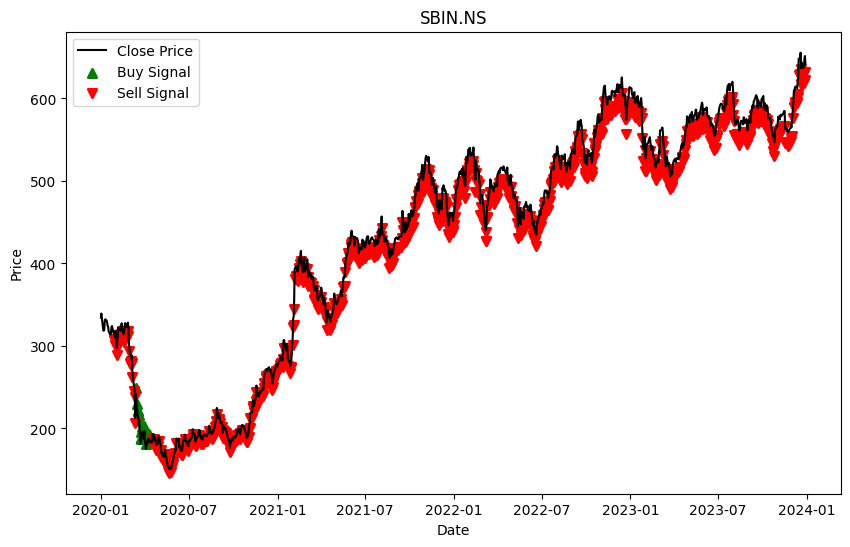

[*********************100%%**********************]  1 of 1 completed


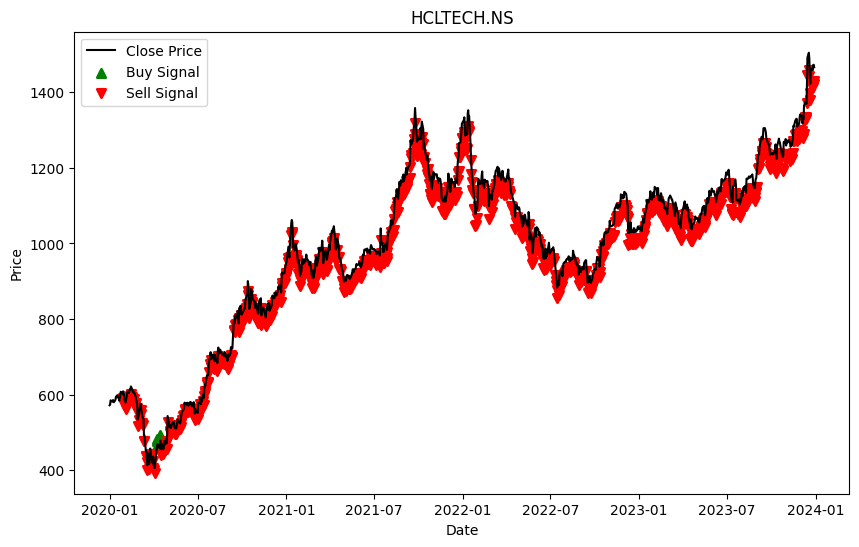

[*********************100%%**********************]  1 of 1 completed


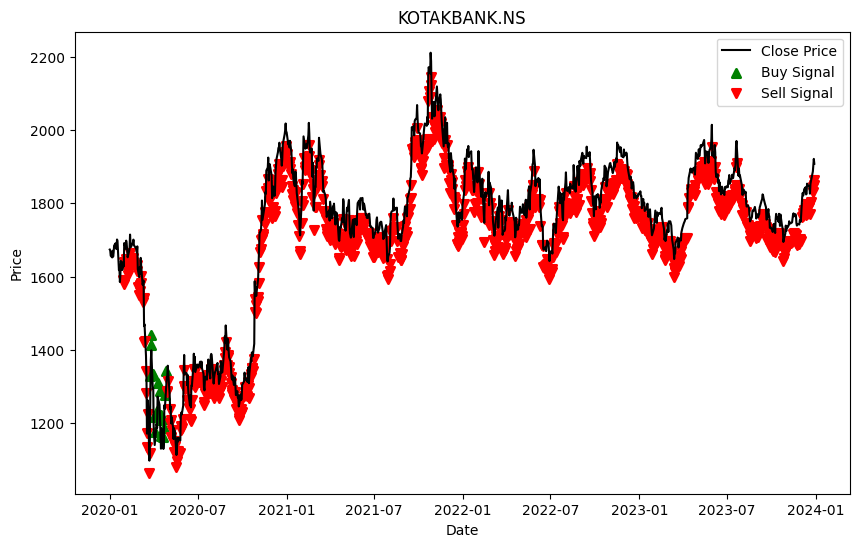

[*********************100%%**********************]  1 of 1 completed


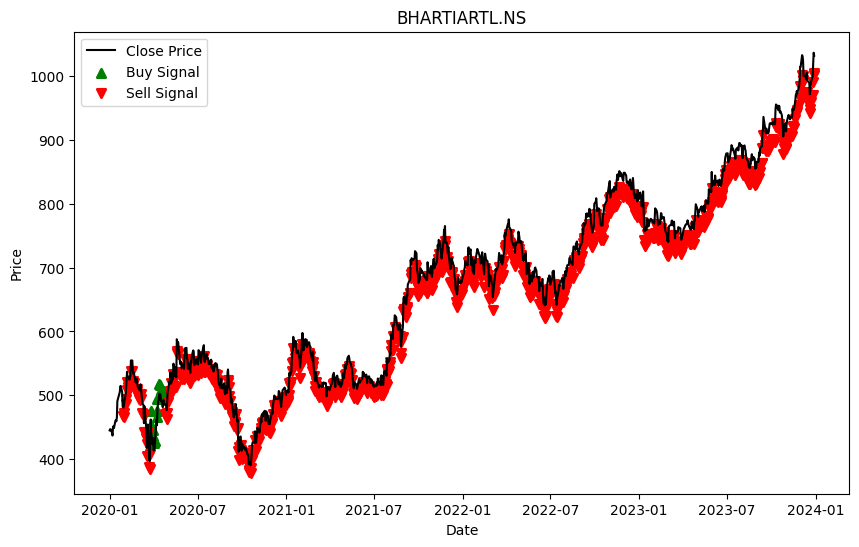

[*********************100%%**********************]  1 of 1 completed


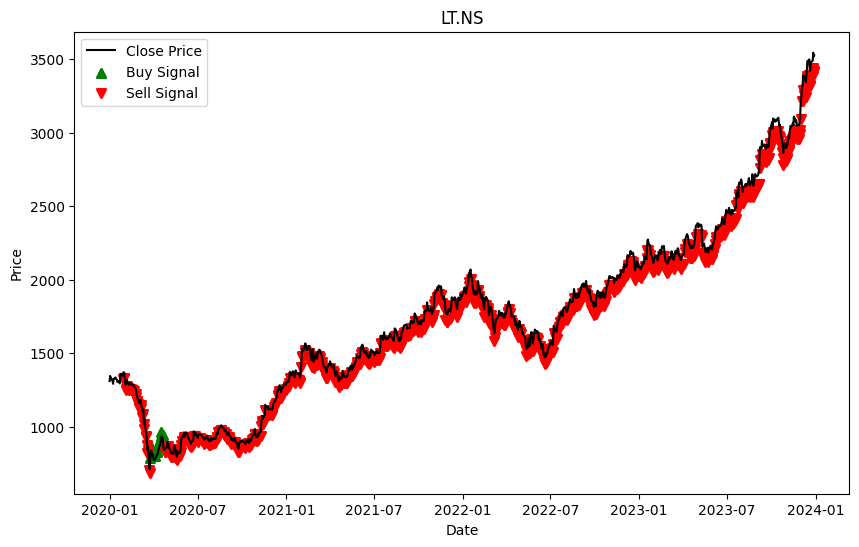

[*********************100%%**********************]  1 of 1 completed


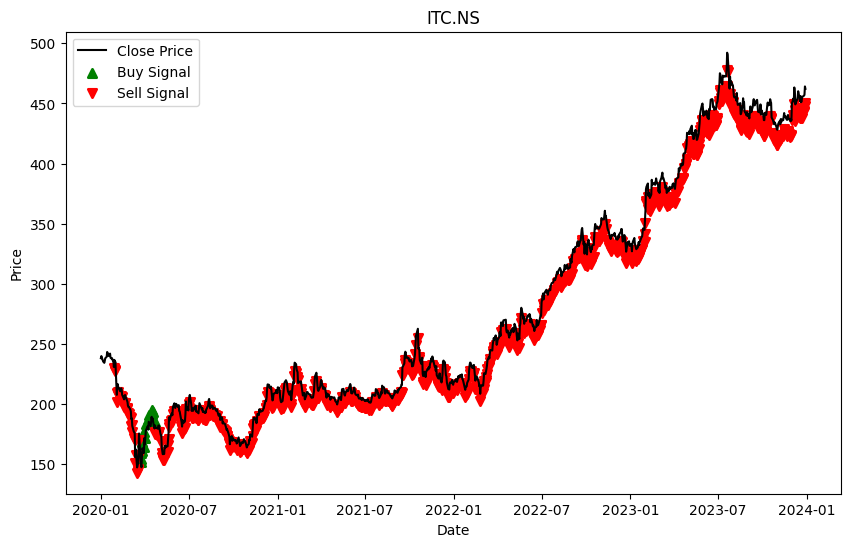

[*********************100%%**********************]  1 of 1 completed


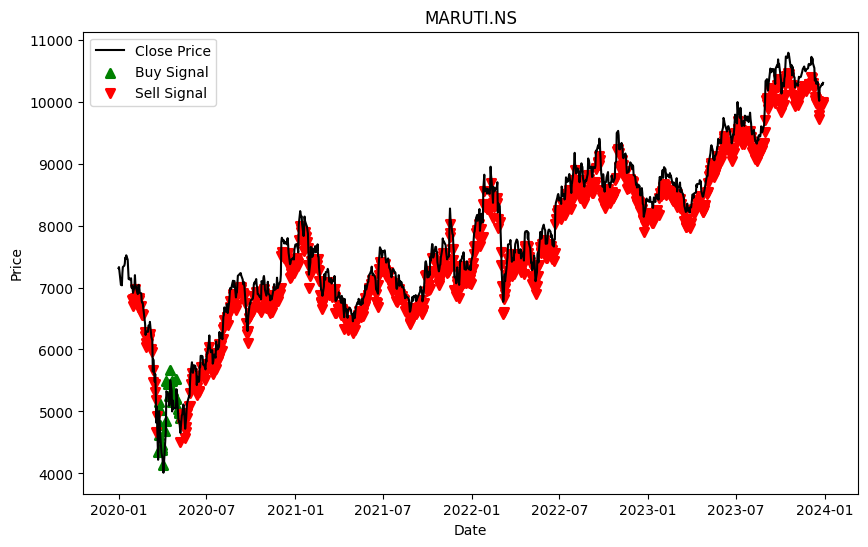

[*********************100%%**********************]  1 of 1 completed


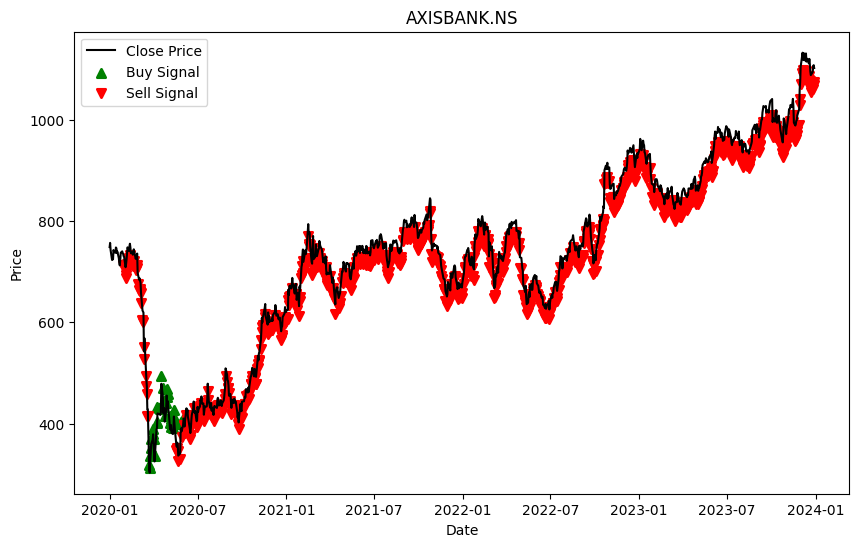

[*********************100%%**********************]  1 of 1 completed


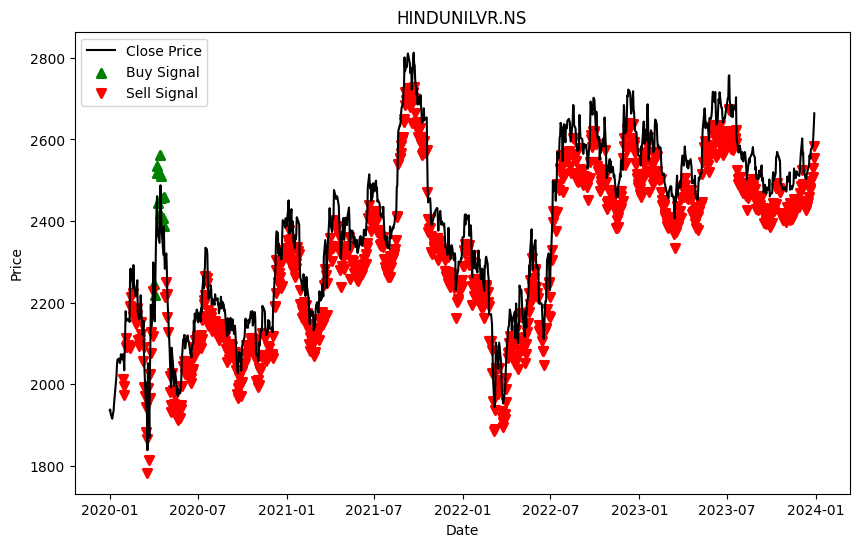

[*********************100%%**********************]  1 of 1 completed


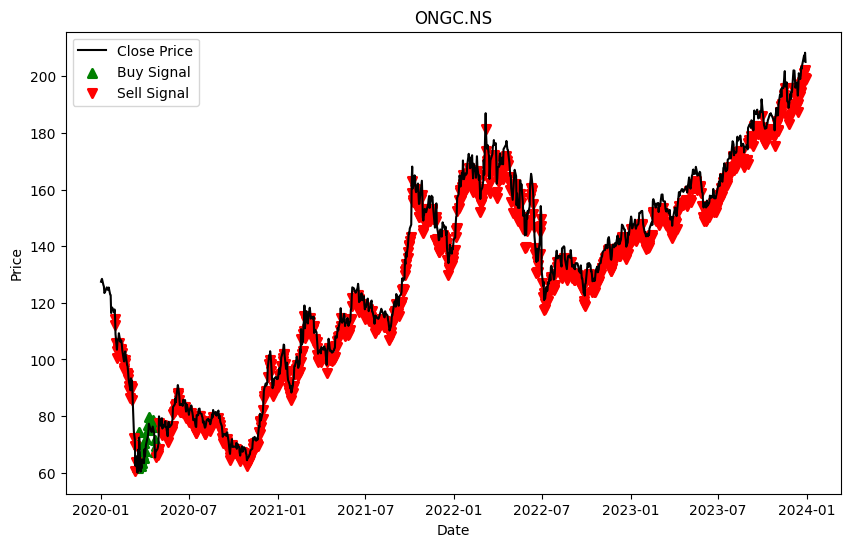

[*********************100%%**********************]  1 of 1 completed


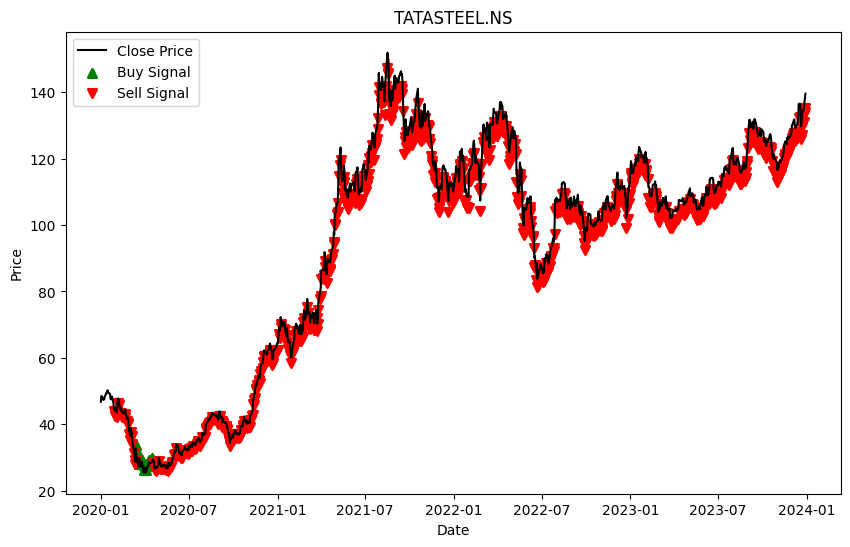

[*********************100%%**********************]  1 of 1 completed


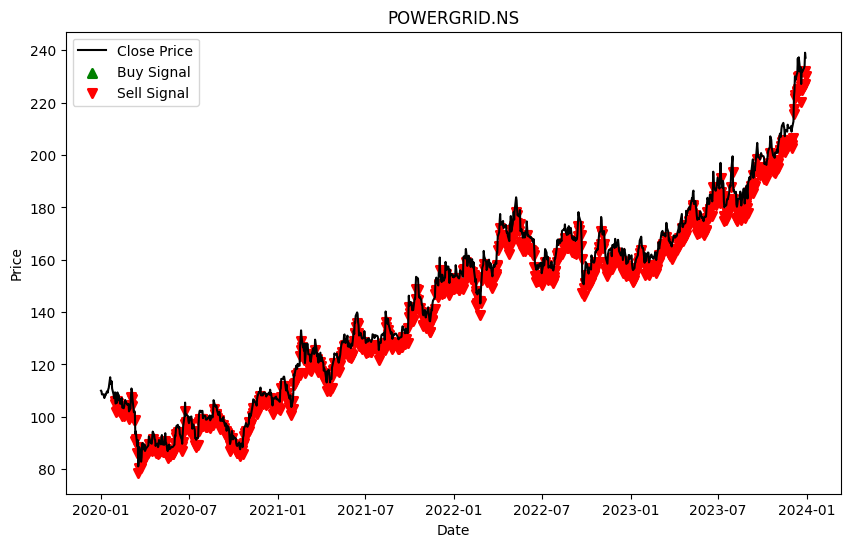

[*********************100%%**********************]  1 of 1 completed


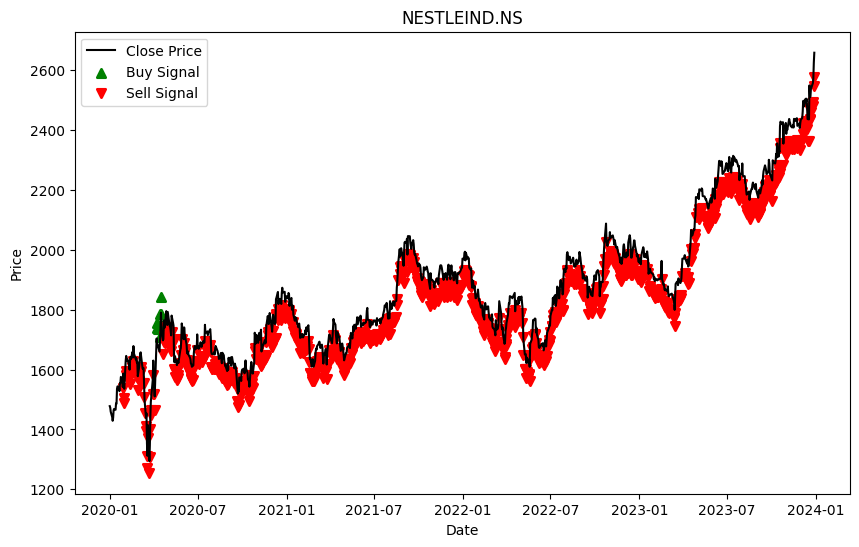

[*********************100%%**********************]  1 of 1 completed


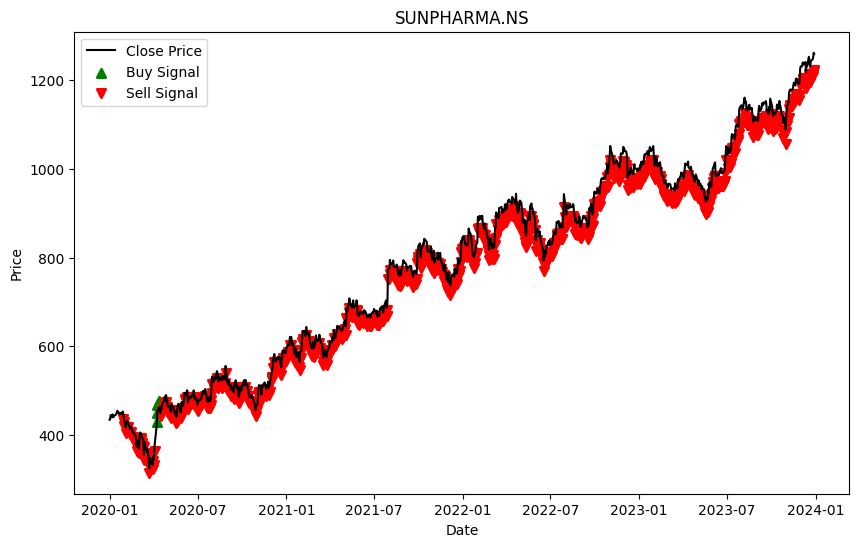

[*********************100%%**********************]  1 of 1 completed


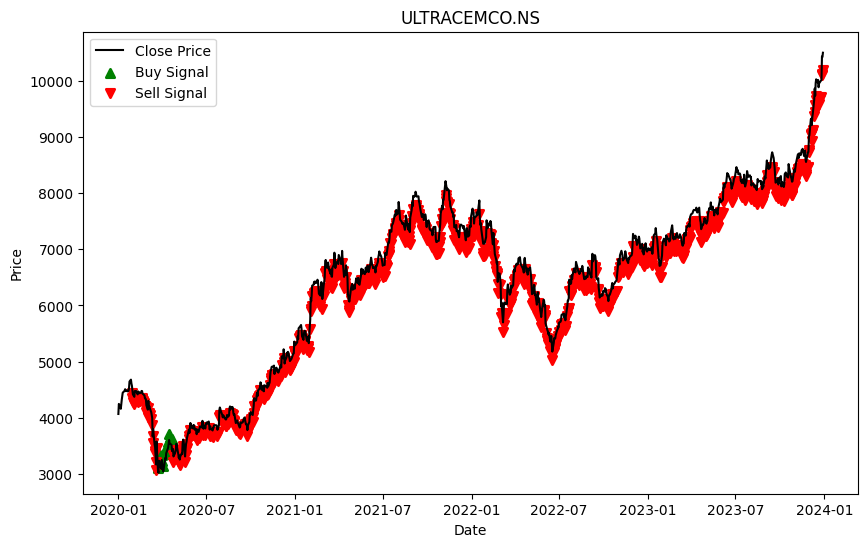

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

Total Buy Signals: 352
Total Sell Signals: 19488



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%******


Yearly Returns for Each Stock:
TCS.NS :  0.7500460100760378
HDFCBANK.NS :  0.33681372801271237
RELIANCE.NS :  0.8727767535556465
INFY.NS :  1.093913382011257
ICICIBANK.NS :  0.8567302758936888
SBIN.NS :  0.9197188349795213
HCLTECH.NS :  1.563335858545706
KOTAKBANK.NS :  0.1398105910403653
BHARTIARTL.NS :  1.3198312482274512
LT.NS :  1.6917058906301397
ITC.NS :  0.9407811602600902
MARUTI.NS :  0.40902243447834374
AXISBANK.NS :  0.47228533572310916
HINDUNILVR.NS :  0.3756163713837013
ONGC.NS :  0.6088662845165012
TATASTEEL.NS :  1.9845003003640742
POWERGRID.NS :  1.1569757874174718
NESTLEIND.NS :  0.7985120671532282
SUNPHARMA.NS :  1.899953917963857
ULTRACEMCO.NS :  1.5837760897140223


In [ ]:
import pandas as pd
import yfinance as yf
import matplotlib.pyplot as plt

# Function to calculate high volatility based on historical stock prices
def calculate_volatility(stock_data, window=20):
    stock_data['Returns'] = stock_data['Close'].pct_change()
    volatility = stock_data['Returns'].rolling(window=window).std()
    return volatility

# Function to generate buy and sell signals based on volatility threshold
def generate_signals(stock_data, volatility_threshold=0.05):
    signals = pd.DataFrame(index=stock_data.index)
    signals['Buy'] = (stock_data['Volatility'] > volatility_threshold).astype(int)
    signals['Sell'] = (stock_data['Volatility'] < volatility_threshold).astype(int)
    return signals

# Function to calculate yearly returns for a stock
def calculate_yearly_returns(stock_data):
    yearly_returns = (stock_data['Close'][-1] / stock_data['Close'][0]) - 1
    return yearly_returns

# Main function to apply strategy on NSE top 20 stocks
def apply_trading_strategy():
    # Download data for top 20 NSE stocks
    top_20_stocks = ['TCS.NS', 'HDFCBANK.NS', 'RELIANCE.NS', 'INFY.NS', 'ICICIBANK.NS', 'SBIN.NS', 'HCLTECH.NS',
                     'KOTAKBANK.NS', 'BHARTIARTL.NS', 'LT.NS', 'ITC.NS', 'MARUTI.NS', 'AXISBANK.NS', 'HINDUNILVR.NS',
                     'ONGC.NS', 'TATASTEEL.NS', 'POWERGRID.NS', 'NESTLEIND.NS', 'SUNPHARMA.NS', 'ULTRACEMCO.NS']

    # Define the time period for data
    start_date = '2020-01-01'
    end_date = '2024-01-01'

    # Initialize an empty DataFrame to store signals for all stocks
    all_signals = pd.DataFrame()

    # Loop through each stock, calculate volatility, generate signals, and plot
    for stock_symbol in top_20_stocks:
        # Download stock data from Yahoo Finance
        stock_data = yf.download(stock_symbol, start=start_date, end=end_date)

        # Calculate volatility
        stock_data['Volatility'] = calculate_volatility(stock_data)

        # Generate buy and sell signals
        signals = generate_signals(stock_data)

        # Plotting
        plt.figure(figsize=(10, 6))
        plt.plot(stock_data['Close'], label='Close Price', color='black')
        plt.scatter(signals.index[signals['Buy'] == 1], stock_data.loc[signals['Buy'] == 1, 'Close'] * 1.03, label='Buy Signal', marker='^', color='green', lw=2)
        plt.scatter(signals.index[signals['Sell'] == 1], stock_data.loc[signals['Sell'] == 1, 'Close'] * 0.97, label='Sell Signal', marker='v', color='red', lw=2)
        plt.title(stock_symbol)
        plt.xlabel('Date')
        plt.ylabel('Price')
        plt.legend()
        plt.show()

        # Combine signals with existing signals
        all_signals = pd.concat([all_signals, signals['Buy']], axis=1)

    # Summing up signals across all stocks to find overall buy/sell signals
    all_signals['Total_Buy'] = all_signals.sum(axis=1)
    all_signals['Total_Sell'] = len(top_20_stocks) - all_signals['Total_Buy']

    # Printing the total buy and sell signals
    print("Total Buy Signals:", all_signals['Total_Buy'].sum())
    print("Total Sell Signals:", all_signals['Total_Sell'].sum())

    # Calculate yearly returns for each stock
    yearly_returns = {}
    for stock_symbol in top_20_stocks:
        stock_data = yf.download(stock_symbol, start=start_date, end=end_date)
        yearly_returns[stock_symbol] = calculate_yearly_returns(stock_data)

    print("\nYearly Returns for Each Stock:")
    for stock, returns in yearly_returns.items():
        print(stock, ": ", returns)

# Execute the trading strategy
apply_trading_strategy()


In [ ]:
import pandas as pd
import yfinance as yf

# Function to calculate yearly returns for a stock from 2018 to 2023
def calculate_yearly_returns(stock_data):
    yearly_returns = {}
    for year in range(2018, 2024):
        start_date = str(year) + '-01-01'
        end_date = str(year) + '-12-31'
        if start_date in stock_data.index and end_date in stock_data.index:
            start_price = stock_data.loc[start_date, 'Close']
            end_price = stock_data.loc[end_date, 'Close']
            yearly_returns[year] = ((end_price / start_price) - 1) * 100  # Calculate returns in percentage
    return yearly_returns

# Main function to calculate yearly returns for each stock from 2018 to 2023
def calculate_yearly_returns_all():
    # Download data for top 20 NSE stocks
    top_20_stocks = ['TCS.NS', 'HDFCBANK.NS', 'RELIANCE.NS', 'INFY.NS', 'ICICIBANK.NS', 'SBIN.NS', 'HCLTECH.NS',
                     'KOTAKBANK.NS', 'BHARTIARTL.NS', 'LT.NS', 'ITC.NS', 'MARUTI.NS', 'AXISBANK.NS', 'HINDUNILVR.NS',
                     'ONGC.NS', 'TATASTEEL.NS', 'POWERGRID.NS', 'NESTLEIND.NS', 'SUNPHARMA.NS', 'ULTRACEMCO.NS']

    # Define the time period for data
    start_date = '2018-01-01'
    end_date = '2024-01-01'

    # Calculate yearly returns for each stock for every year
    yearly_returns_all_stocks = {}
    for stock_symbol in top_20_stocks:
        # Download stock data from Yahoo Finance
        stock_data = yf.download(stock_symbol, start=start_date, end=end_date)

        # Calculate yearly returns
        yearly_returns_all_stocks[stock_symbol] = calculate_yearly_returns(stock_data)

    # Print yearly returns for each stock for every year
    for stock, yearly_returns in yearly_returns_all_stocks.items():
        print("\nYearly Returns for", stock)
        for year, returns in yearly_returns.items():
            print(year, ": ", returns)

# Execute the function to calculate yearly returns for each stock from 2018 to 2023
calculate_yearly_returns_all()


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%*******


Yearly Returns for TCS.NS
2018 :  43.10931198597907
2019 :  13.606258970993746
2020 :  32.07002542098938
2021 :  27.664990955562185

Yearly Returns for HDFCBANK.NS
2018 :  14.40819364636694
2019 :  18.439543573774884
2020 :  12.333808560407578
2021 :  3.813899422734779

Yearly Returns for RELIANCE.NS
2018 :  23.24814190086557
2019 :  35.06245259201748
2020 :  32.7582644938732
2021 :  19.152201583293802

Yearly Returns for INFY.NS
2018 :  27.511969634014655
2019 :  9.939108012083864
2020 :  70.42818625725302
2021 :  49.76794582322819

Yearly Returns for ICICIBANK.NS
2018 :  16.065100890940222
2019 :  48.15120946091065
2020 :  -0.31672328030390995
2021 :  40.312800836789094

Yearly Returns for SBIN.NS
2018 :  -3.647024416943845
2019 :  11.398529105732091
2020 :  -17.790401503459453
2021 :  64.79957847730826

Yearly Returns for HCLTECH.NS
2018 :  9.747349742693089
2019 :  18.372660318950906
2020 :  65.42530015220638
2021 :  38.77958712108758

Yearly Returns for KOTAKBANK.NS
2018 :  25.65

# Volatility ATR


[*********************100%%**********************]  1 of 1 completed


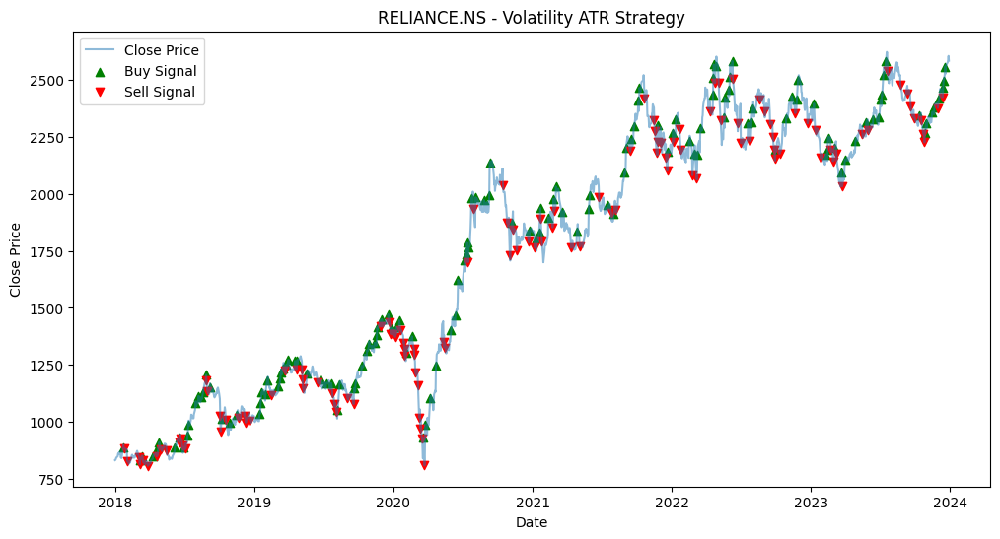

[*********************100%%**********************]  1 of 1 completed


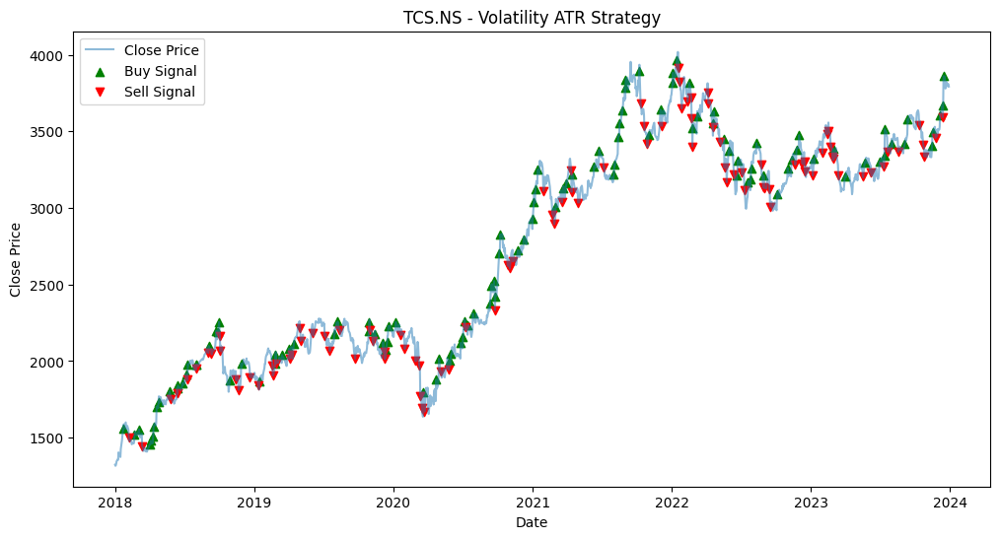

[*********************100%%**********************]  1 of 1 completed


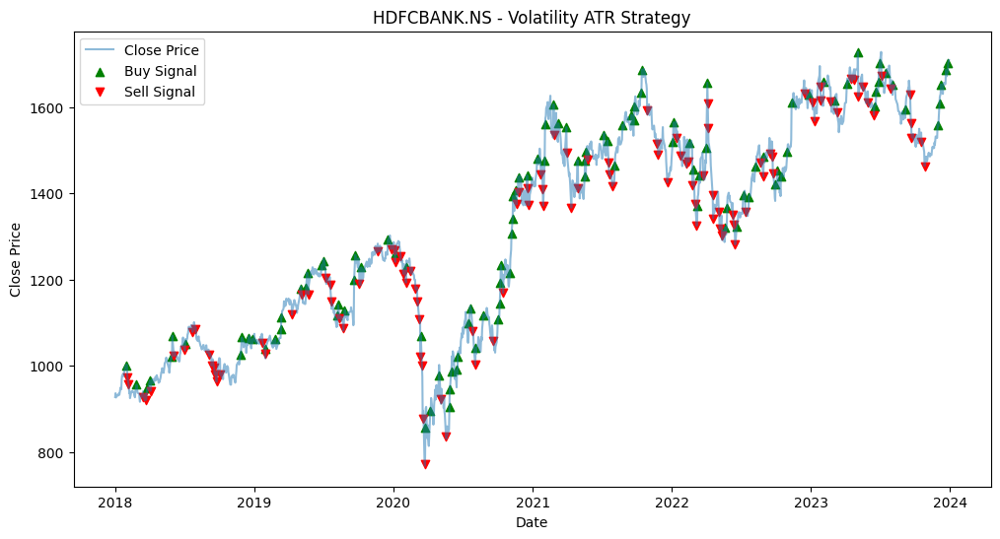

[*********************100%%**********************]  1 of 1 completed


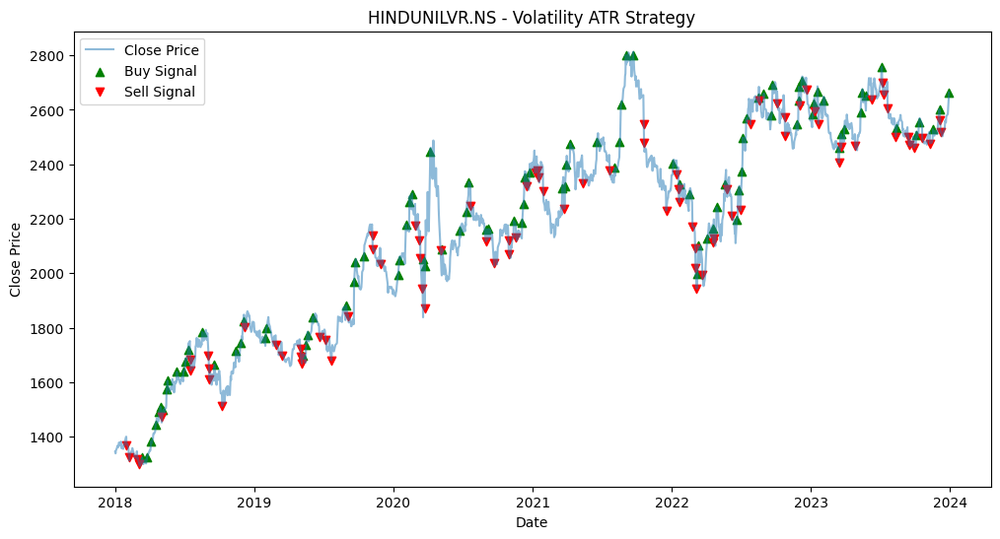

[*********************100%%**********************]  1 of 1 completed


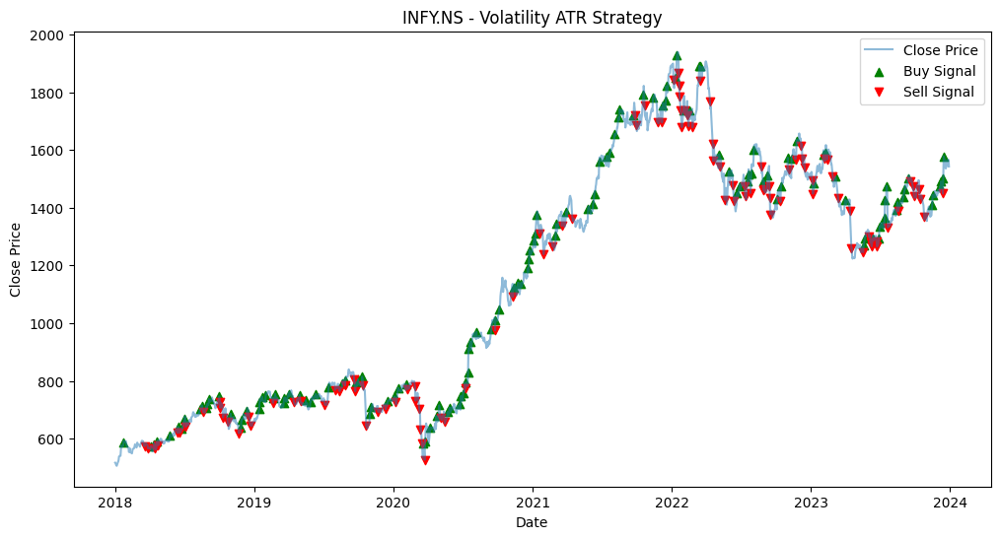

[*********************100%%**********************]  1 of 1 completed


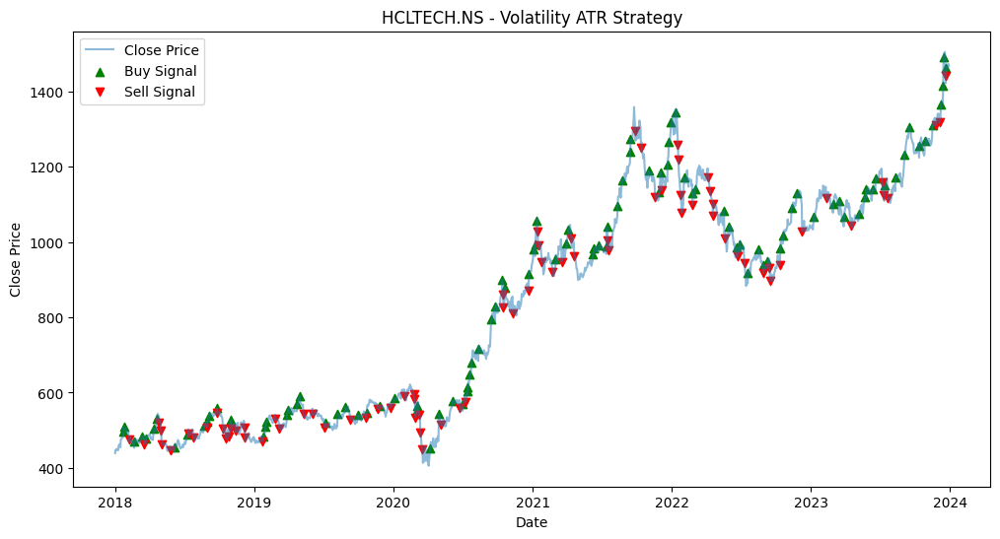

[*********************100%%**********************]  1 of 1 completed


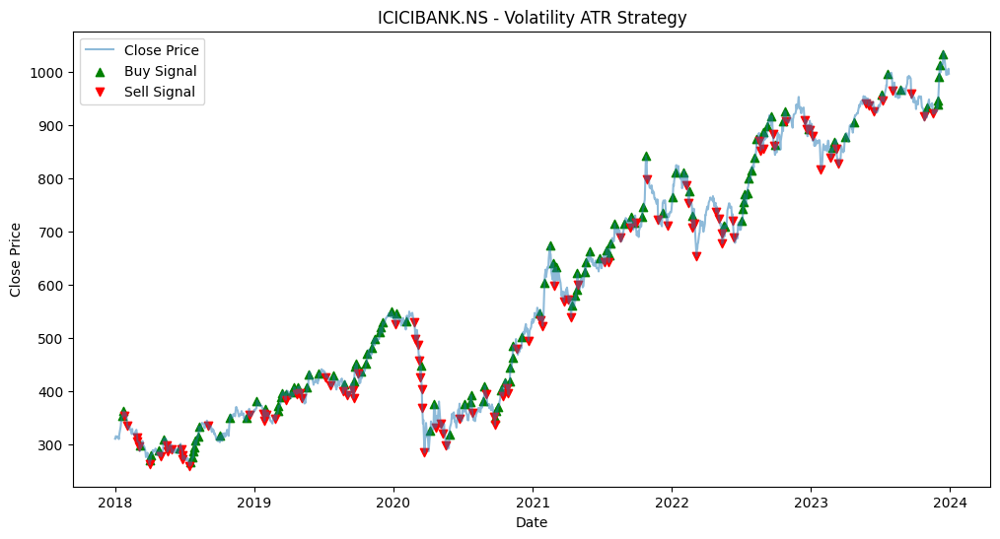

[*********************100%%**********************]  1 of 1 completed


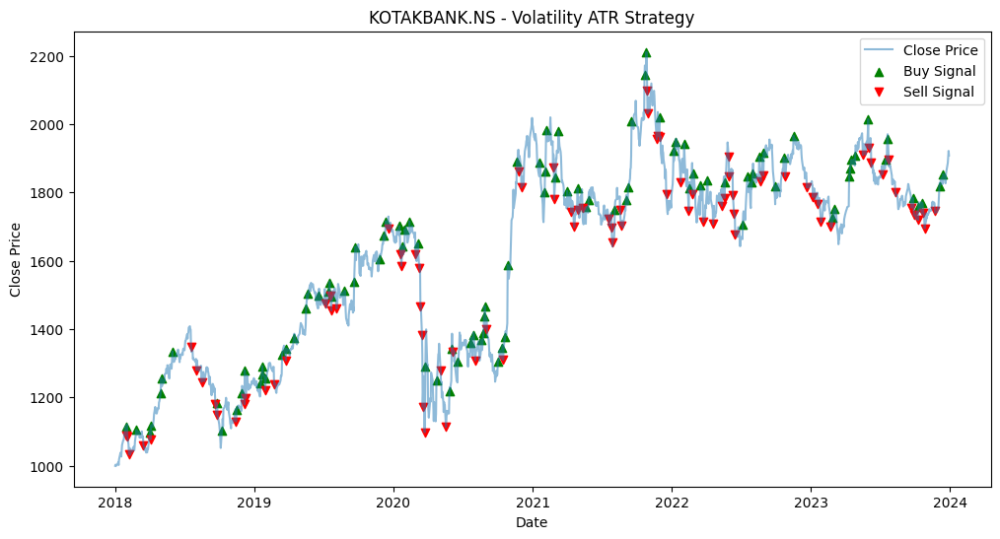

[*********************100%%**********************]  1 of 1 completed


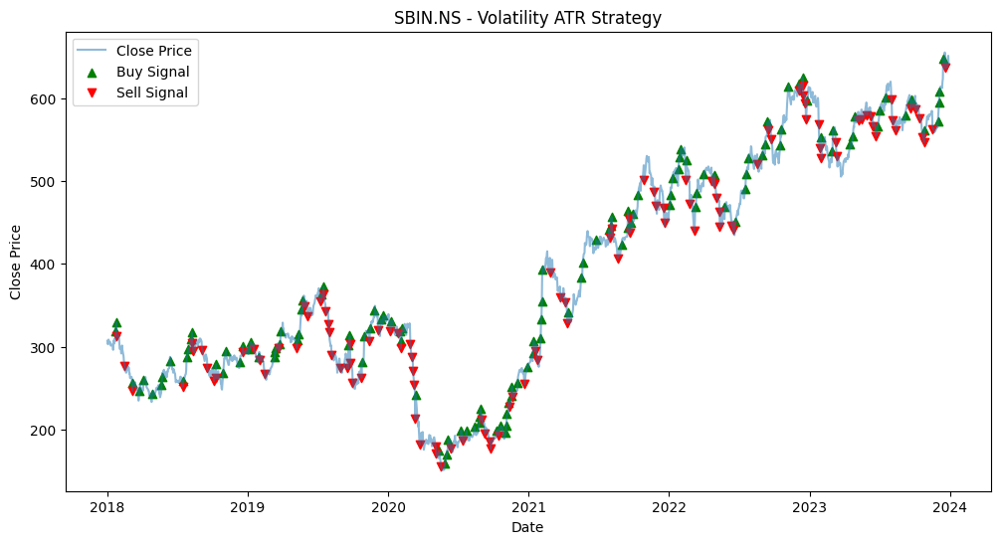

[*********************100%%**********************]  1 of 1 completed


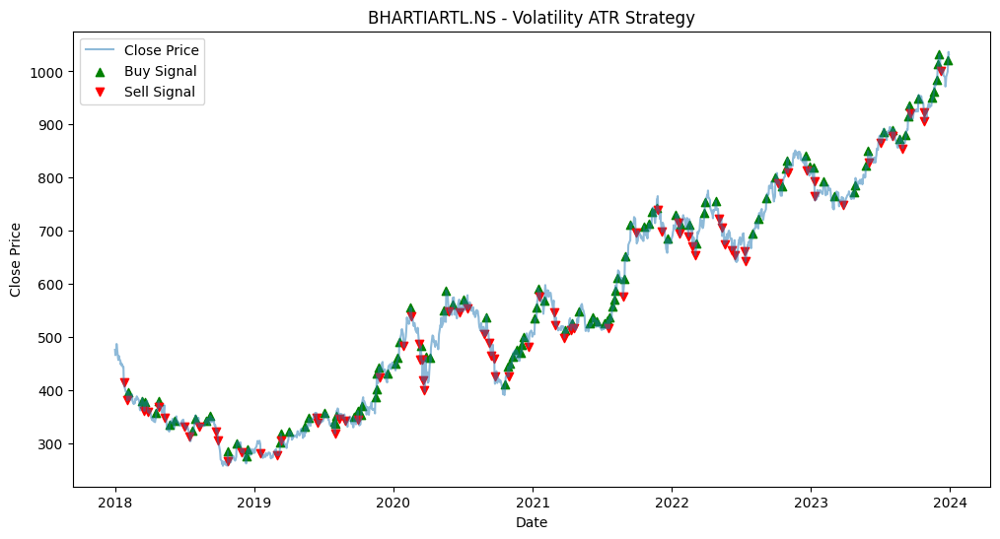

[*********************100%%**********************]  1 of 1 completed


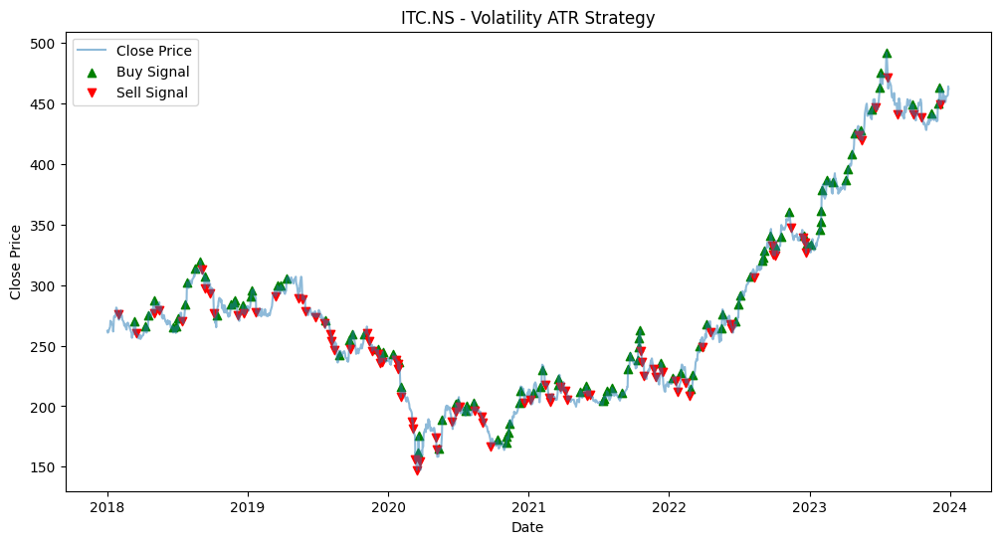

[*********************100%%**********************]  1 of 1 completed


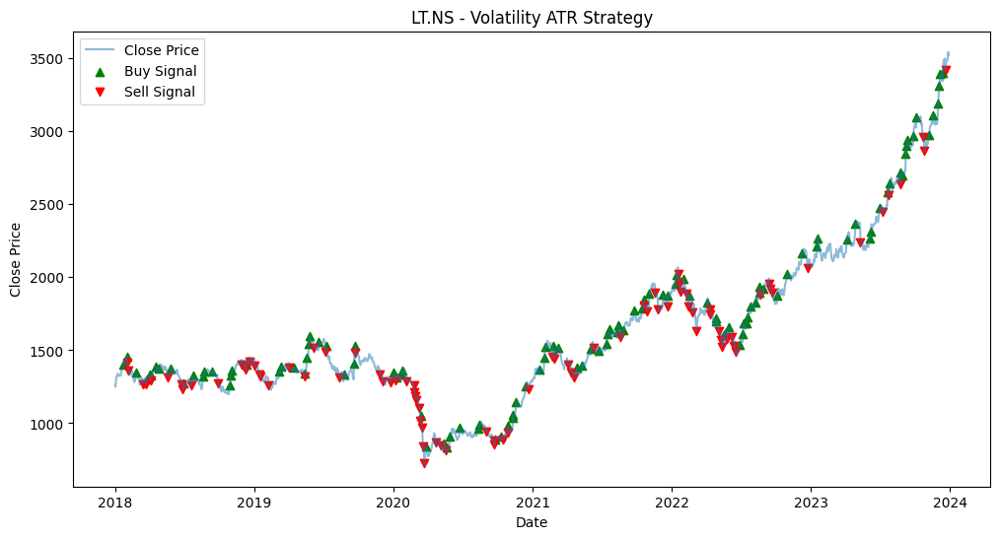

[*********************100%%**********************]  1 of 1 completed


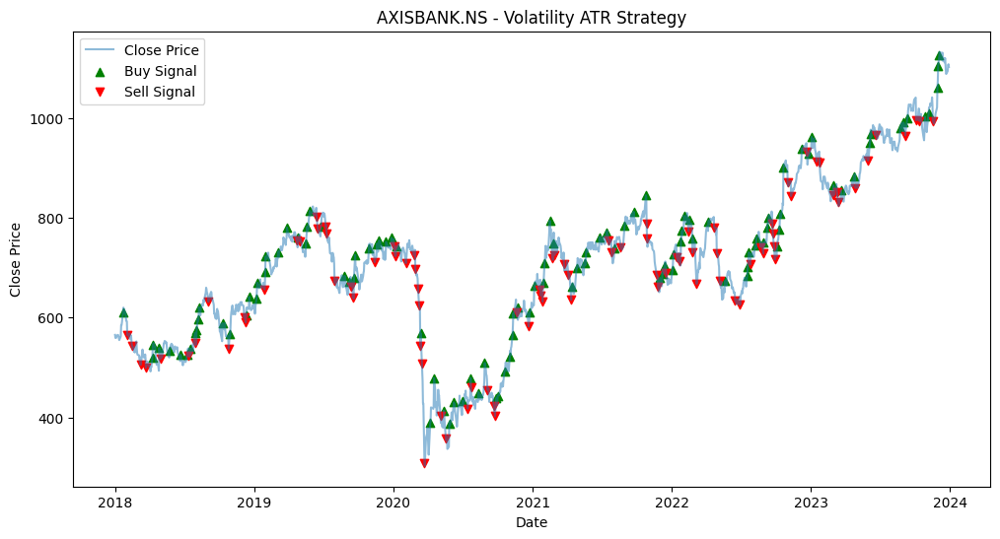

[*********************100%%**********************]  1 of 1 completed


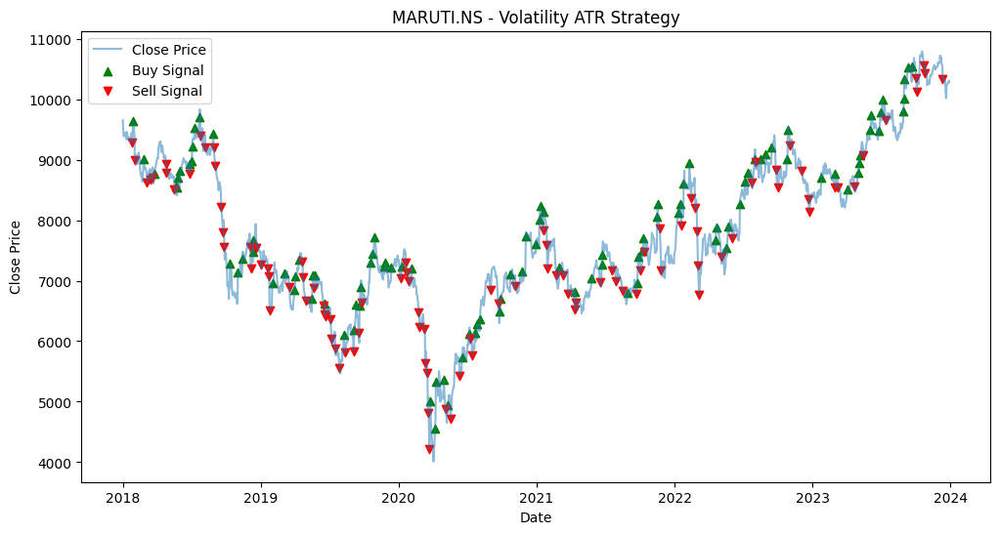

[*********************100%%**********************]  1 of 1 completed


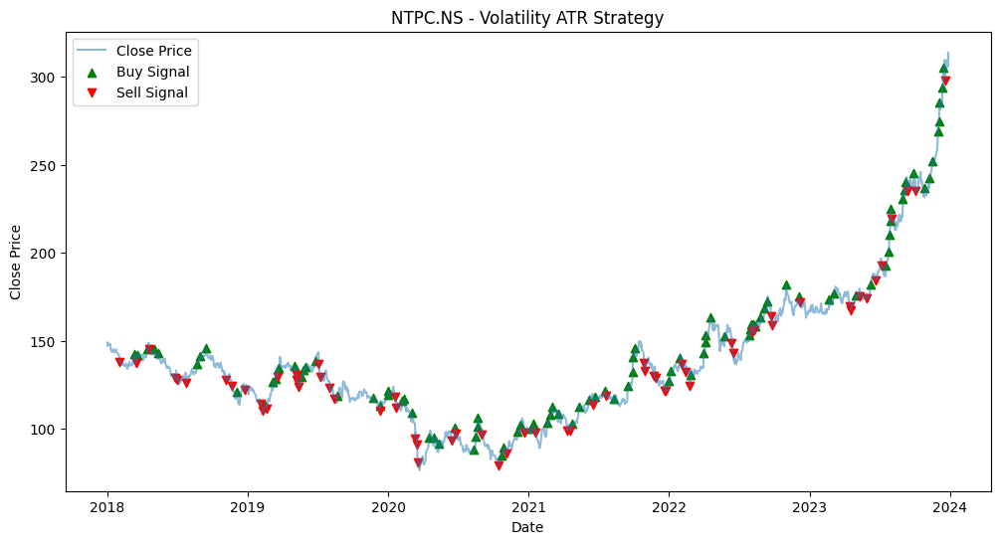

[*********************100%%**********************]  1 of 1 completed


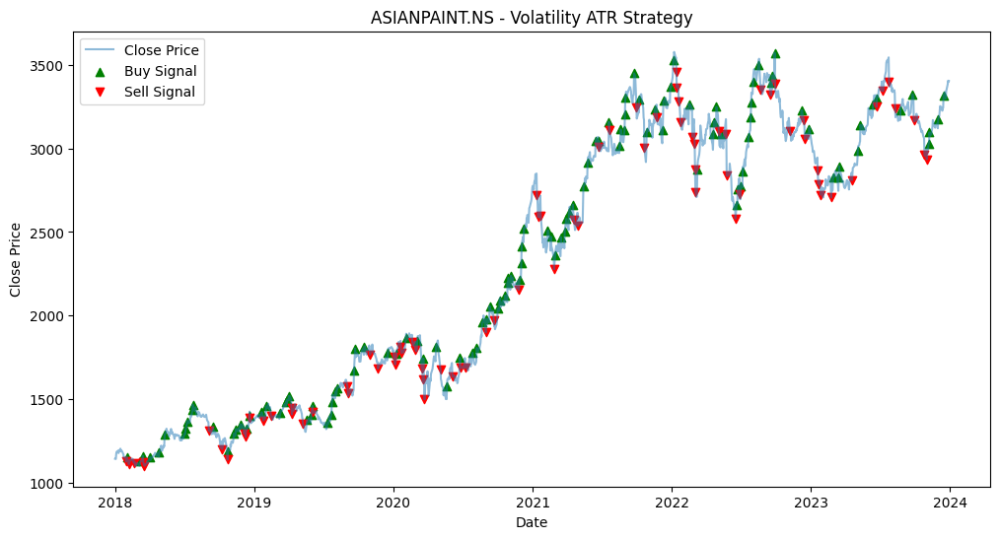

[*********************100%%**********************]  1 of 1 completed


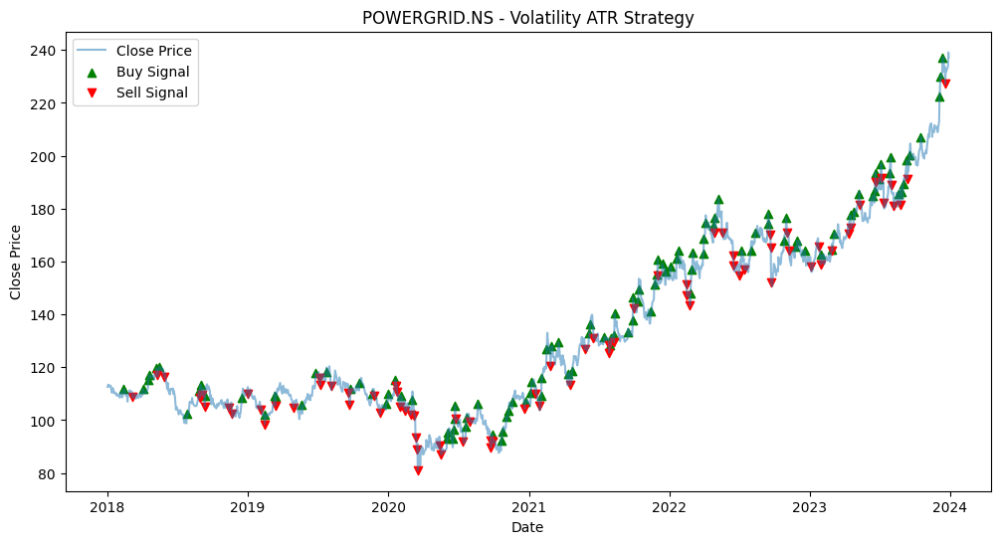

[*********************100%%**********************]  1 of 1 completed


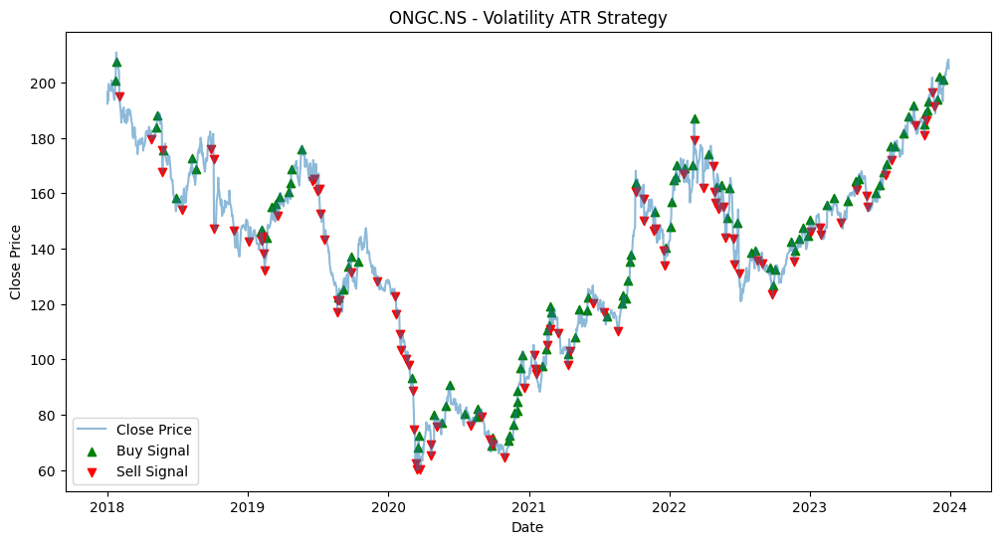

[*********************100%%**********************]  1 of 1 completed


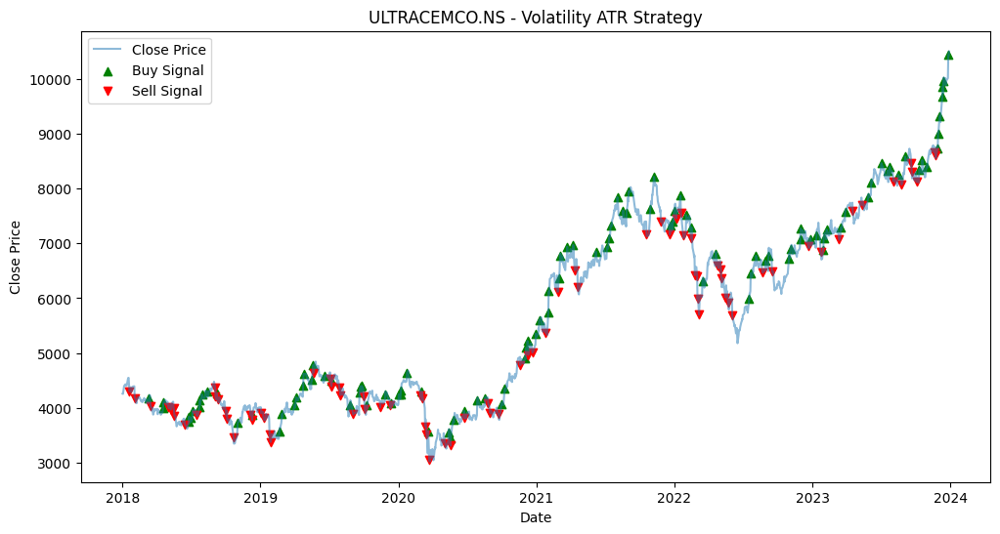

[*********************100%%**********************]  1 of 1 completed


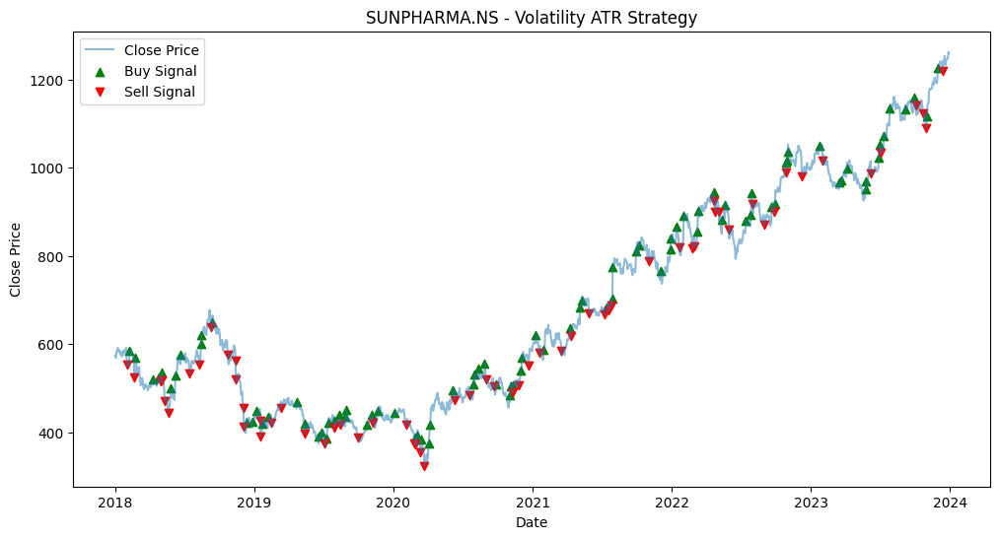

In [ ]:
import yfinance as yf
import pandas as pd
import matplotlib.pyplot as plt

# List of top 20 NSE stocks
top_20_stocks = ['RELIANCE.NS', 'TCS.NS', 'HDFCBANK.NS', 'HINDUNILVR.NS', 'INFY.NS',
                 'HCLTECH.NS', 'ICICIBANK.NS', 'KOTAKBANK.NS', 'SBIN.NS', 'BHARTIARTL.NS',
                 'ITC.NS', 'LT.NS', 'AXISBANK.NS', 'MARUTI.NS', 'NTPC.NS', 'ASIANPAINT.NS',
                 'POWERGRID.NS', 'ONGC.NS', 'ULTRACEMCO.NS', 'SUNPHARMA.NS']

# Dictionary to store buy/sell signals for each stock
signals = {}

# Loop through each stock
for stock_symbol in top_20_stocks:
    # Retrieve historical data
    data = yf.download(stock_symbol, start="2018-01-01", end="2023-12-31")

    # Calculate ATR
    data['ATR'] = data['High'] - data['Low']
    data['ATR'] = data['ATR'].rolling(window=14).mean()

    # Define buy/sell signals
    data['Buy_Signal'] = data['Close'] > data['Close'].shift(1) + data['ATR'].shift(1)
    data['Sell_Signal'] = data['Close'] < data['Close'].shift(1) - data['ATR'].shift(1)

    # Store signals
    signals[stock_symbol] = data[['Close', 'Buy_Signal', 'Sell_Signal']]

    # Plot
    # Plot
    plt.figure(figsize=(12,6))
    plt.plot(data['Close'], label='Close Price', alpha=0.5)
    plt.scatter(data.index[data['Buy_Signal']], data['Close'][data['Buy_Signal']], label='Buy Signal', marker='^', color='green')
    plt.scatter(data.index[data['Sell_Signal']], data['Close'][data['Sell_Signal']], label='Sell Signal', marker='v', color='red')
    plt.title(f'{stock_symbol} - Volatility ATR Strategy')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.show()


In [ ]:
# Dictionary to store yearly returns for each stock
yearly_returns = {}

# Loop through each stock
for stock_symbol in top_20_stocks:
    # Retrieve buy and sell signals
    buy_signals = signals[stock_symbol]['Buy_Signal']
    sell_signals = signals[stock_symbol]['Sell_Signal']

    # Retrieve closing prices
    close_prices = signals[stock_symbol]['Close']

    # Calculate yearly returns
    yearly_returns[stock_symbol] = {}
    for year in range(2018, 2024):
        # Filter signals and prices for the current year
        signals_year = (buy_signals.index.year == year) | (sell_signals.index.year == year)
        prices_year = close_prices[signals_year]

        # Check if there are both buy and sell signals in the year
        if len(prices_year) >= 2:
            # Check if the first signal is a buy signal
            if buy_signals[signals_year].iloc[0]:
                entry_price = prices_year.iloc[0]
                exit_price = prices_year.iloc[-1]
                yearly_returns[stock_symbol][year] = (exit_price - entry_price) / entry_price
            else:
                # If the first signal is a sell signal, ignore it
                entry_price = prices_year.iloc[1]
                exit_price = prices_year.iloc[-1]
                yearly_returns[stock_symbol][year] = (exit_price - entry_price) / entry_price
        else:
            yearly_returns[stock_symbol][year] = 0.0

# Print yearly returns
for stock_symbol, returns in yearly_returns.items():
    print(f'{stock_symbol}: {returns}')


RELIANCE.NS: {2018: 0.23058774089675338, 2019: 0.3684471995725925, 2020: 0.3053596499046716, 2021: 0.18951704888554904, 2022: 0.03624750339202951, 2023: 0.09524526233035419}
TCS.NS: {2018: 0.43892526904692647, 2019: 0.12395356745766636, 2020: 0.32679078143786633, 2021: 0.27664990955562196, 2022: -0.14695829973888416, 2023: 0.1455750042946807}
HDFCBANK.NS: {2018: 0.13317487587111237, 2019: 0.19530183282681465, 2020: 0.11622308049591995, 2021: 0.04477402854100459, 2022: 0.07139801813370468, 2023: 0.042638866291548755}
HINDUNILVR.NS: {2018: 0.3593680394455093, 2019: 0.07755240743440088, 2020: 0.23598454219083217, 2021: -0.02734395122862147, 2022: 0.0665486929008329, 2023: 0.04795338408067354}
INFY.NS: {2018: 0.2798874302307137, 2019: 0.09281823145374606, 2020: 0.7092691274847194, 2021: 0.46535998447506305, 2022: -0.20585528695280714, 2023: 0.01336571865181079}
HCLTECH.NS: {2018: 0.08014111645525747, 2019: 0.20061286044667662, 2020: 0.6496382957915591, 2021: 0.3454711778228479, 2022: -0.22

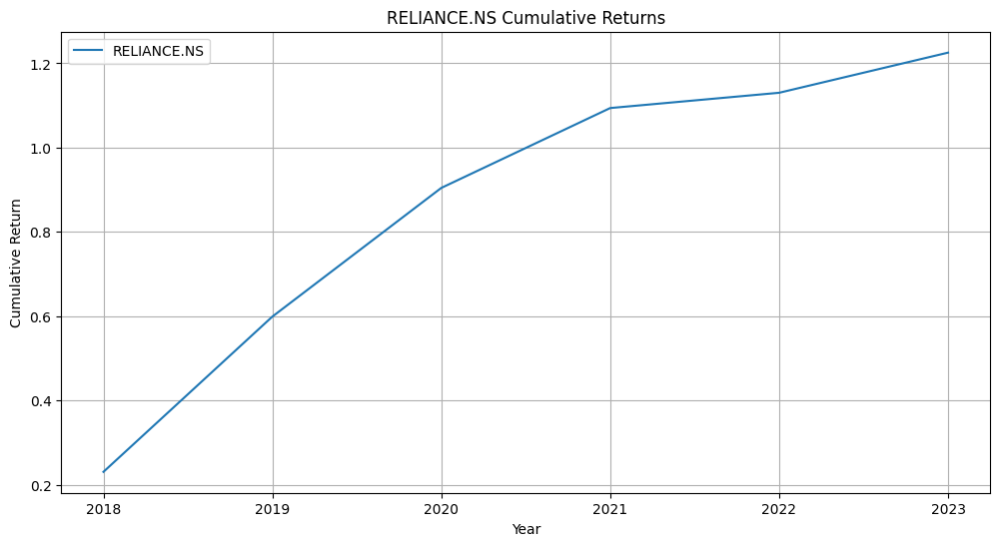

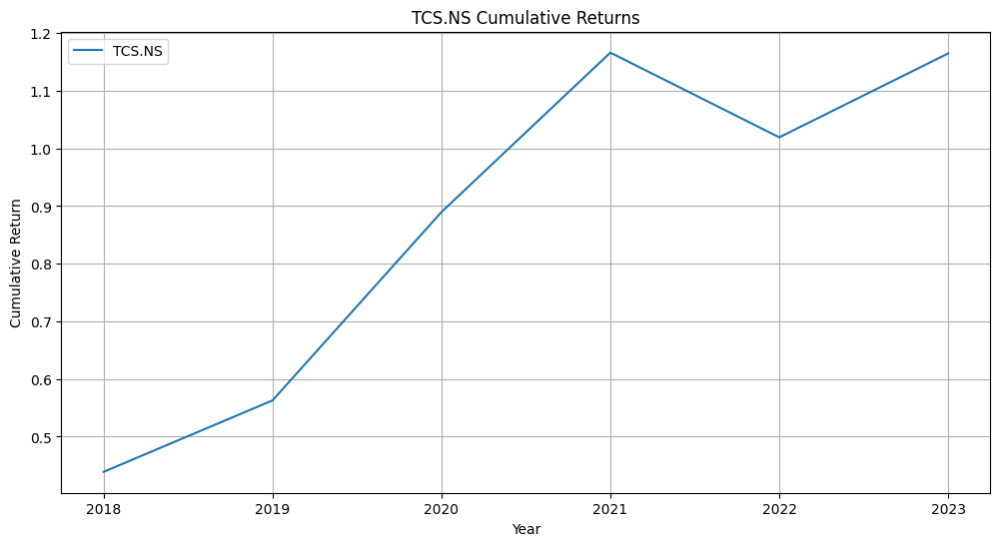

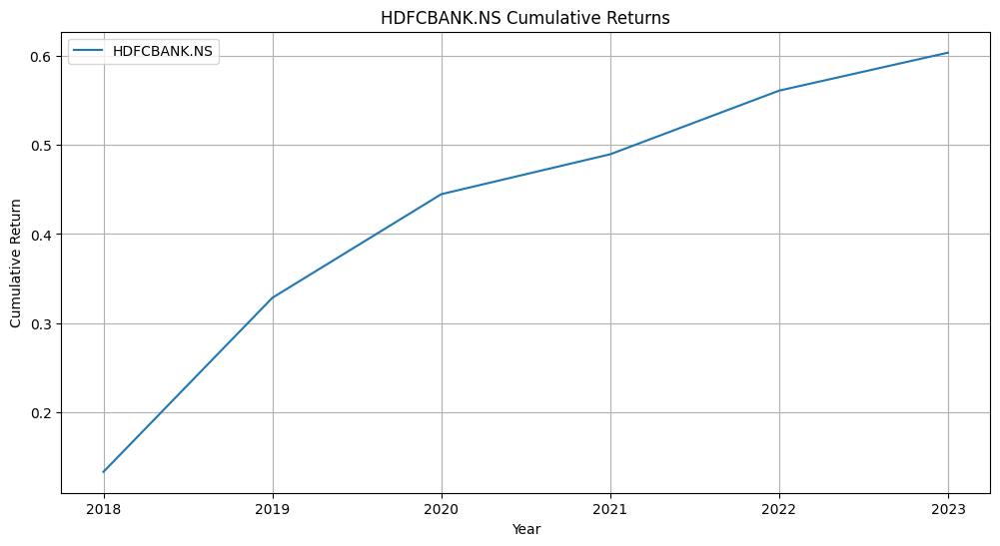

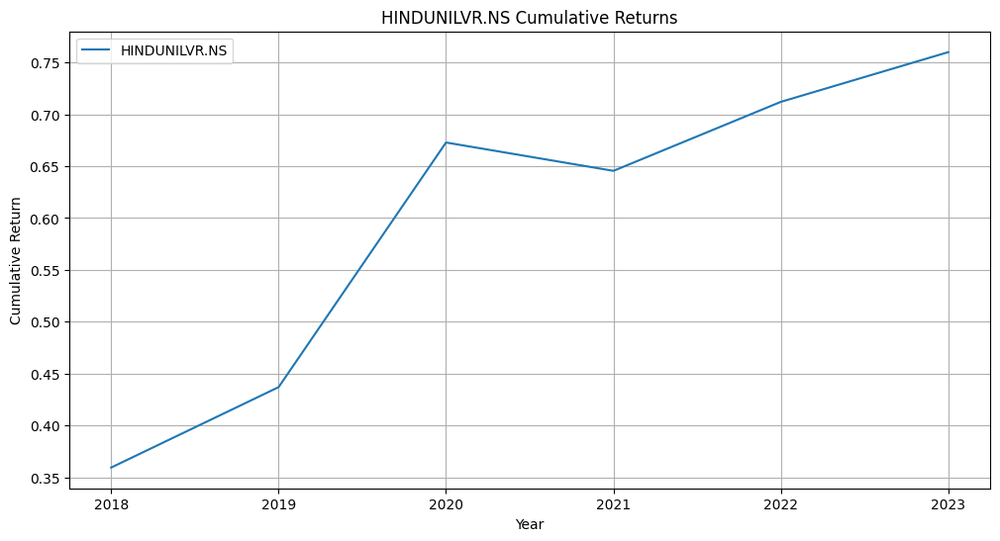

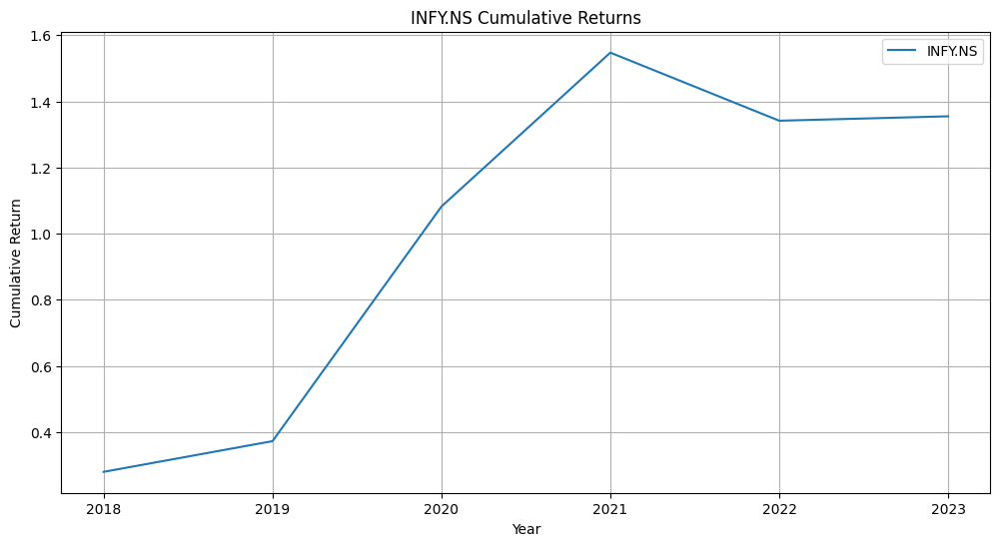

...

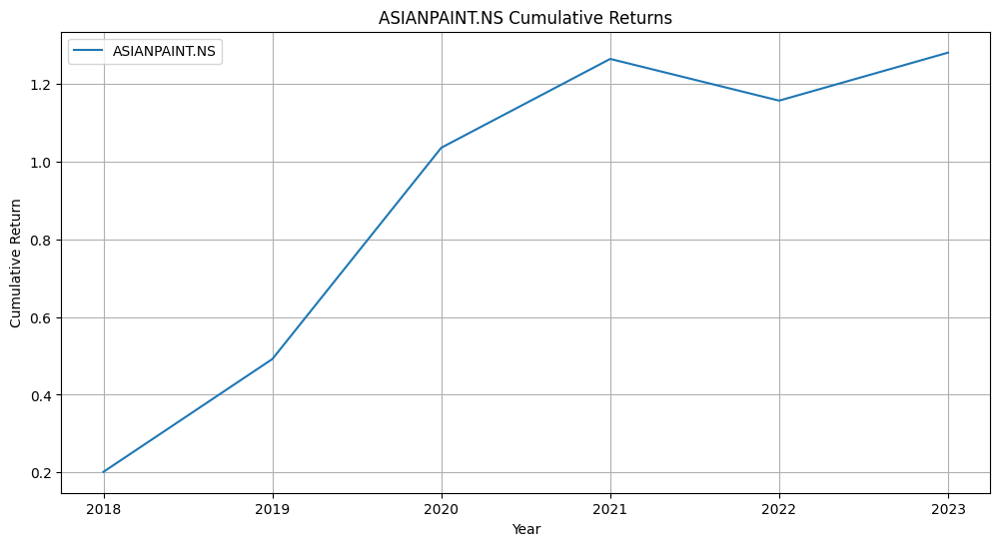

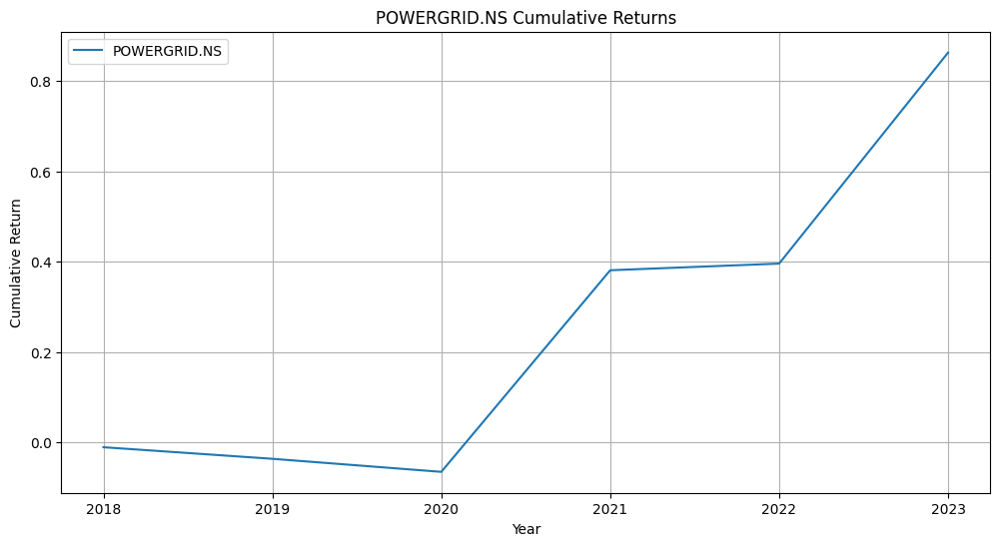

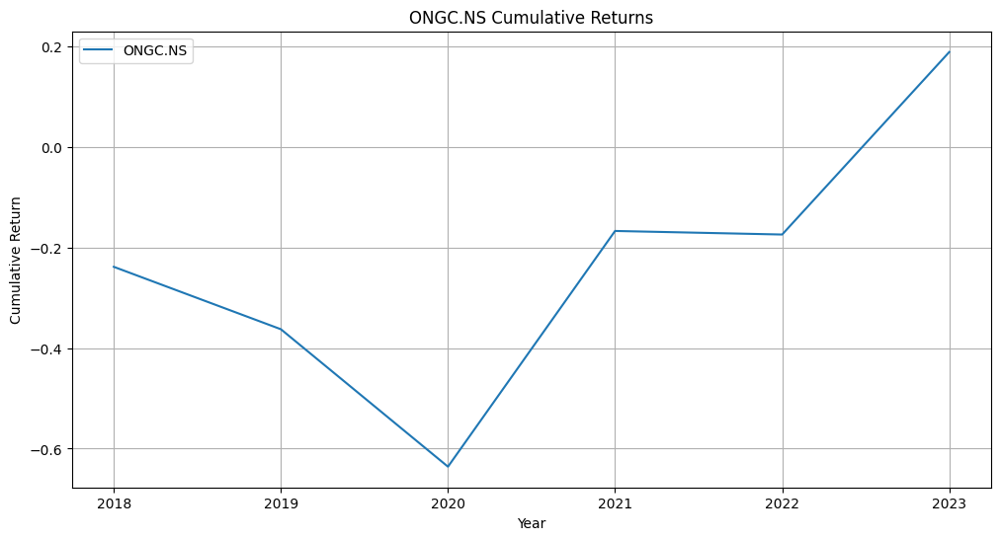

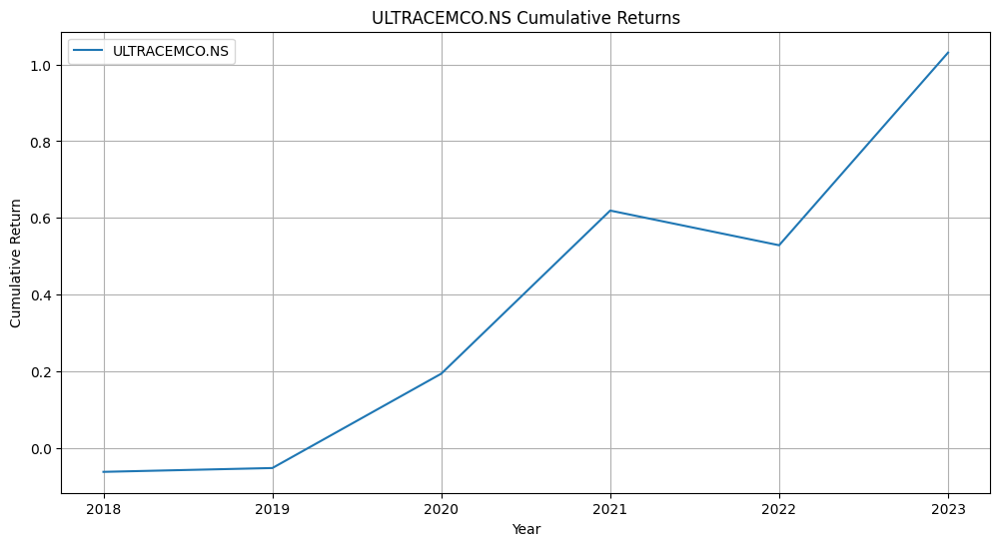

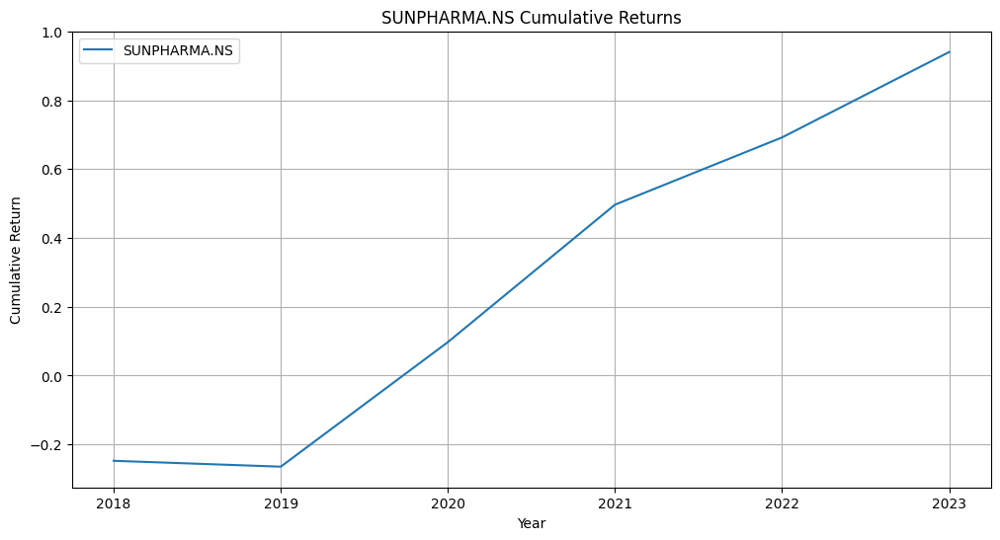

In [ ]:
# Plot individual graphs for each stock
for stock_symbol, returns in cumulative_returns.items():
    plt.figure(figsize=(12, 6))
    plt.plot(returns.index, returns.values, label=stock_symbol)
    plt.title(f'{stock_symbol} Cumulative Returns')
    plt.xlabel('Year')
    plt.ylabel('Cumulative Return')
    plt.legend()
    plt.grid(True)
    plt.show()


# ATR and Risk Management

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%*******

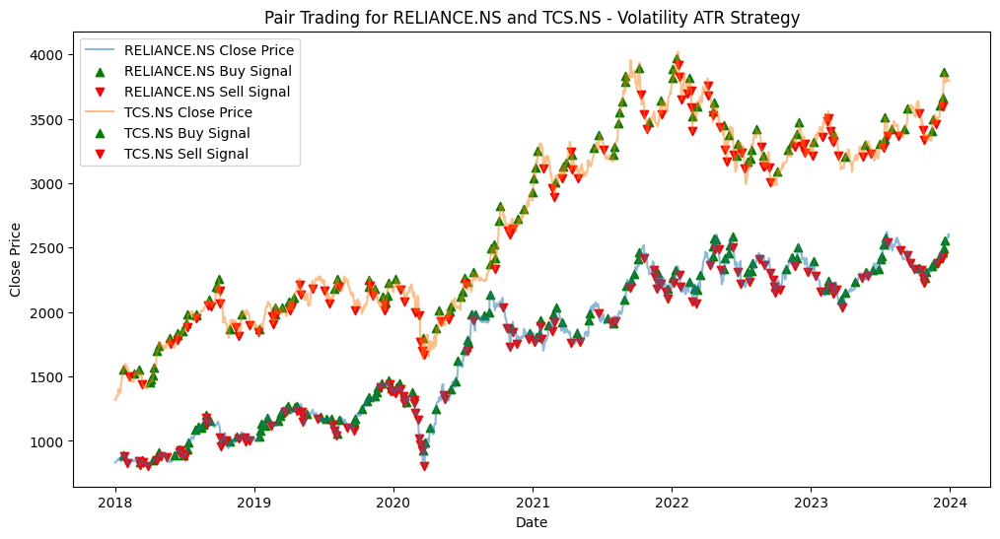

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


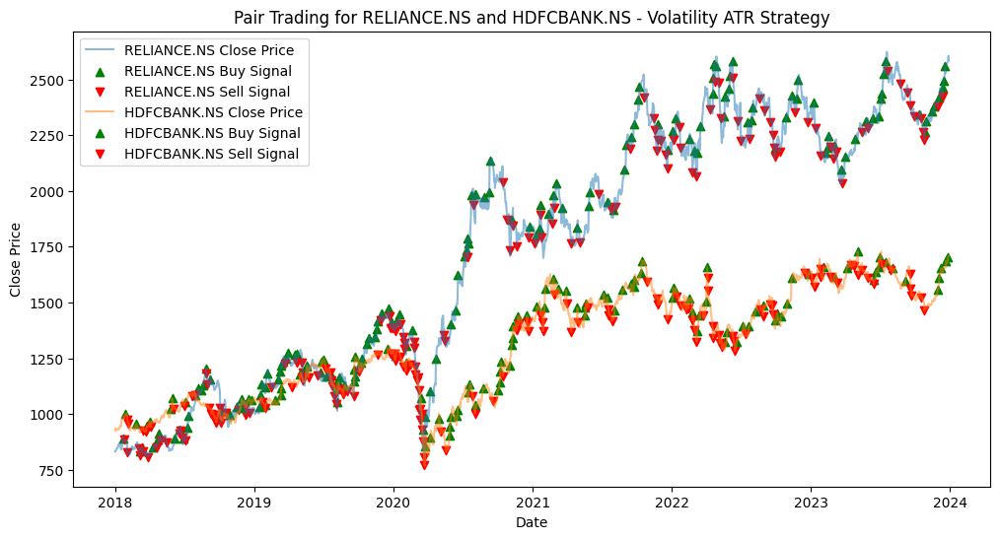

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


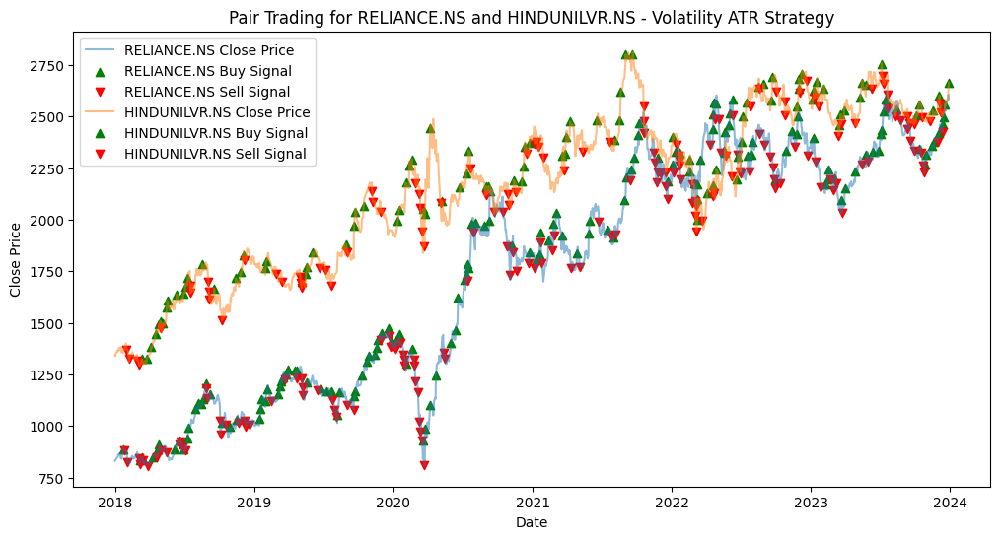

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


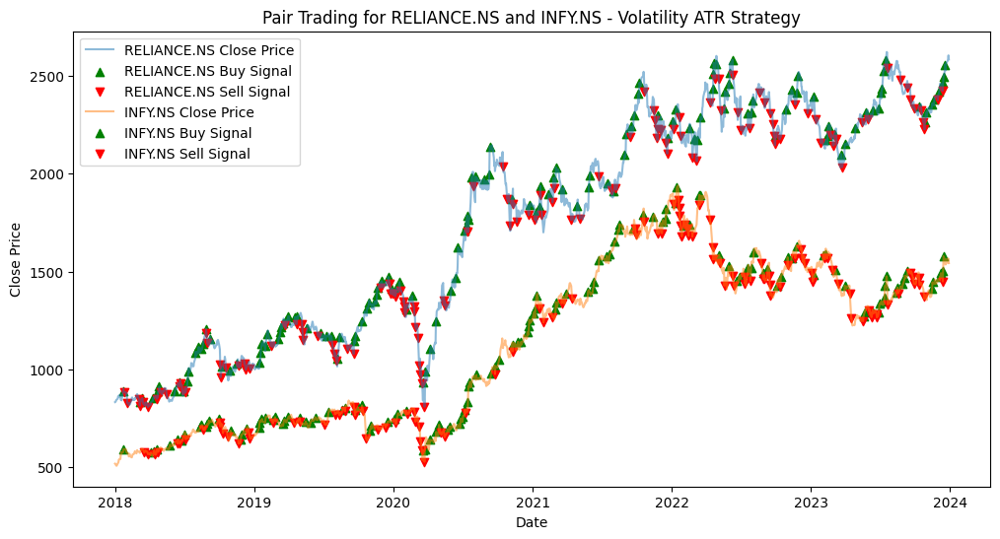

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


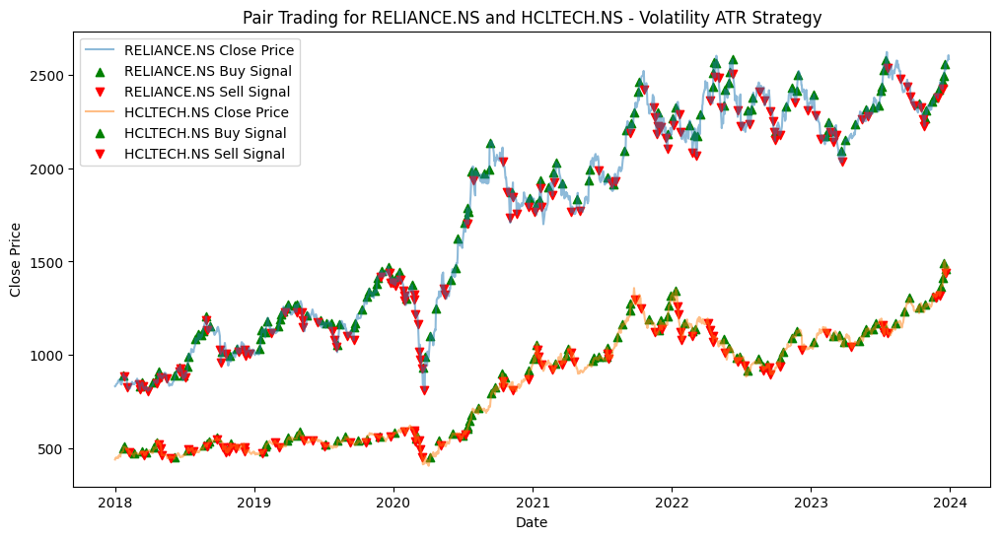

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


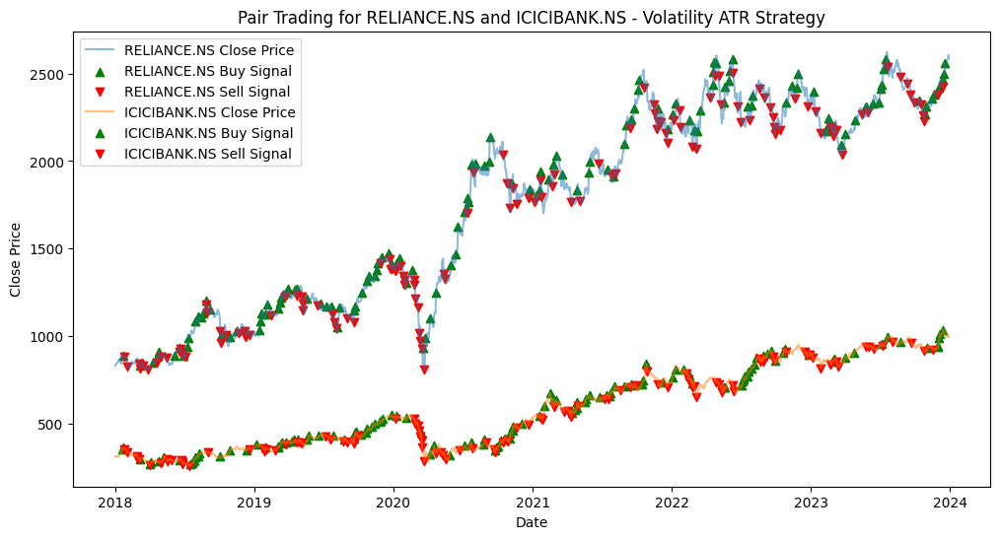

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


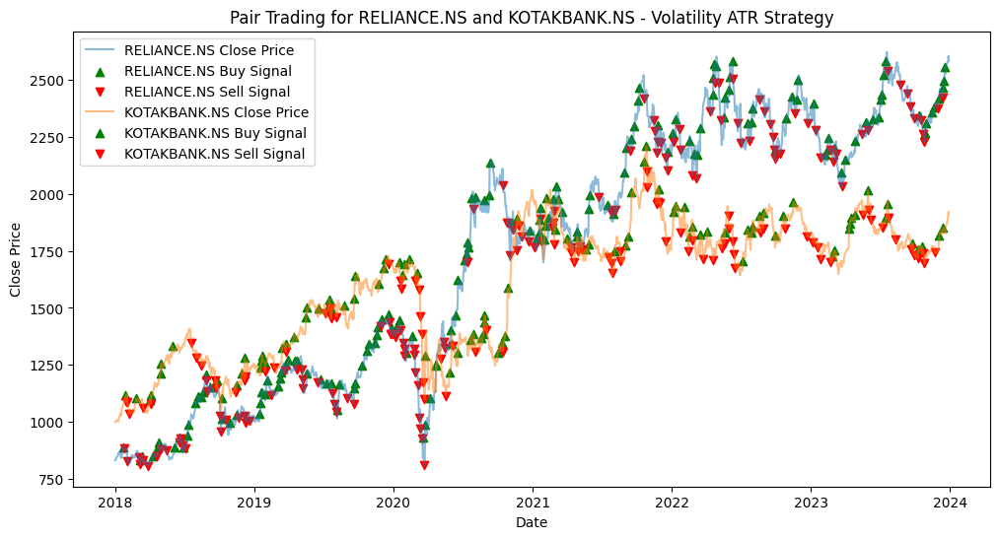

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


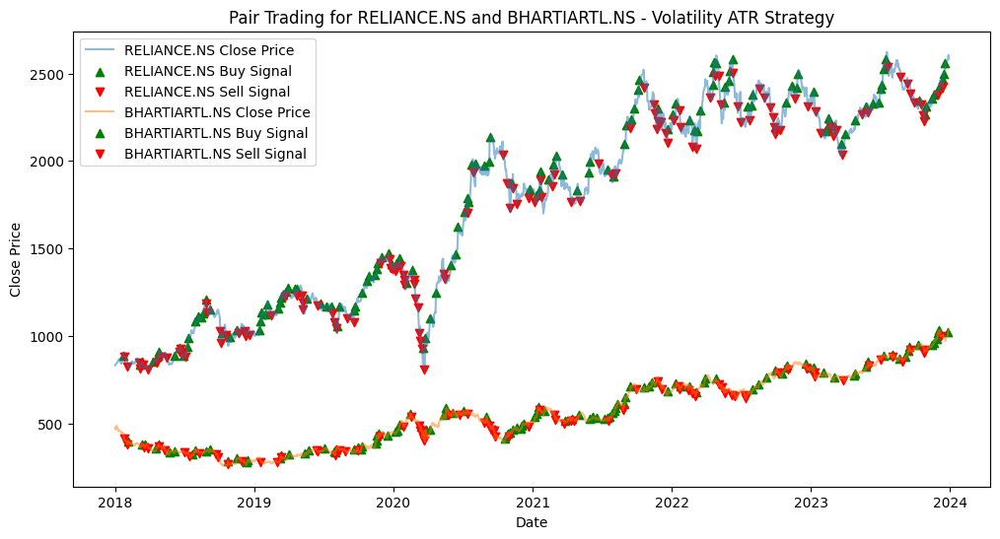

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


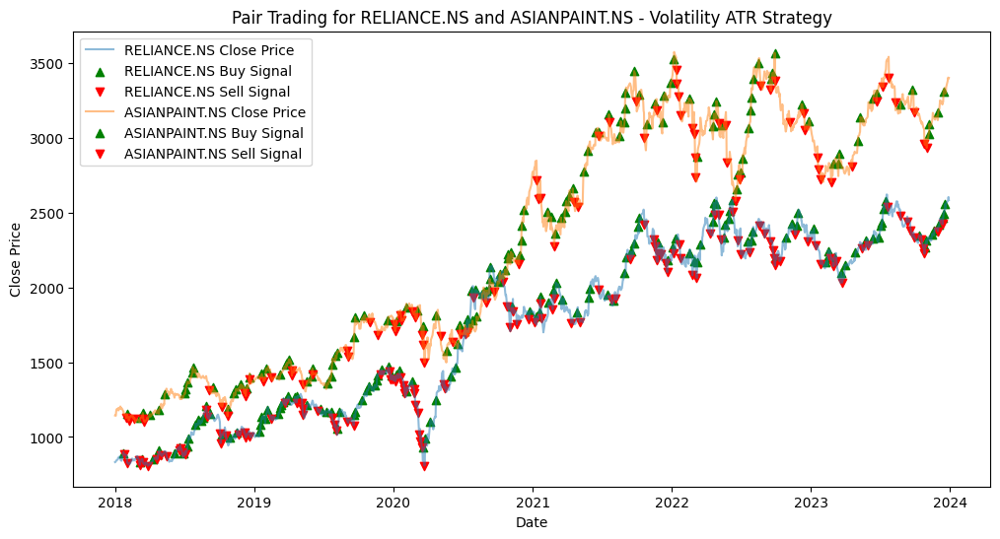

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


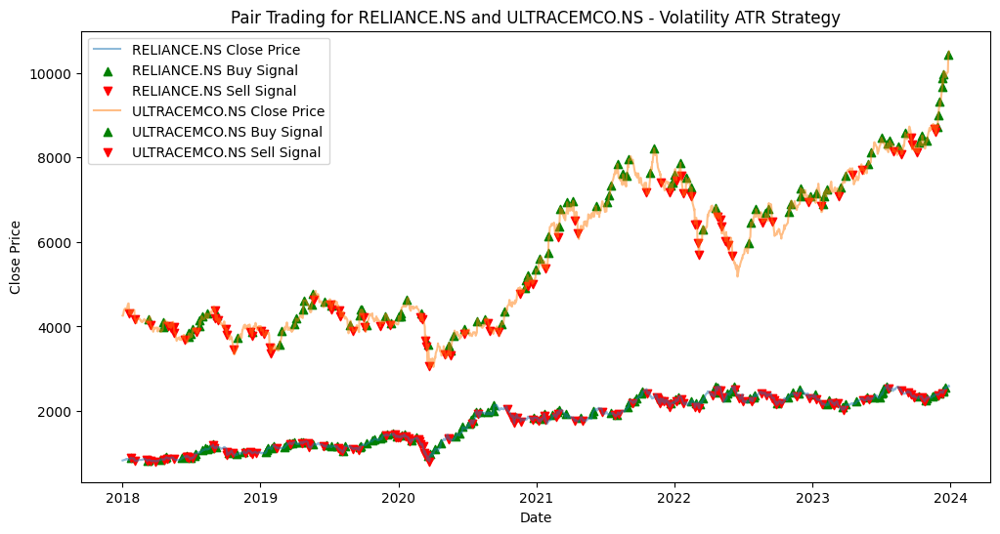

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


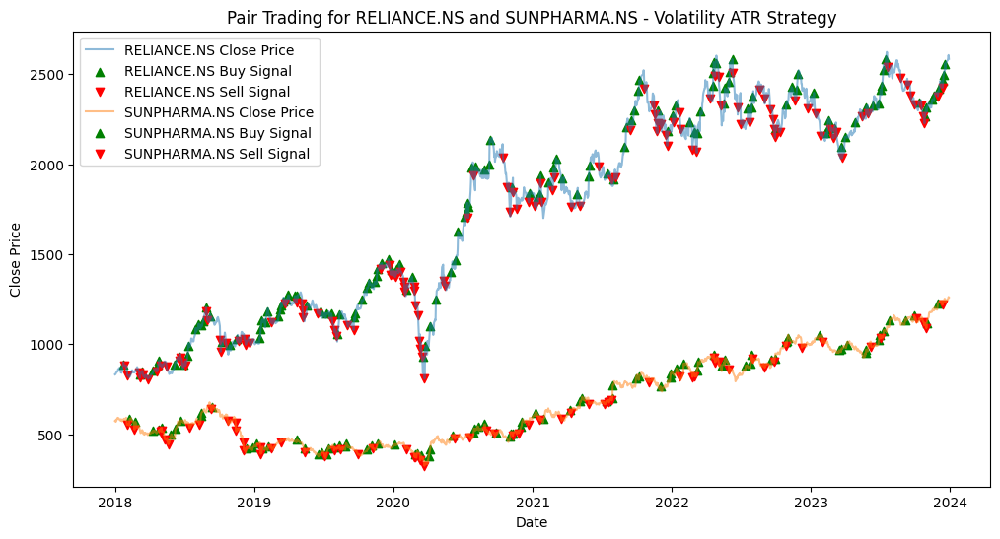

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


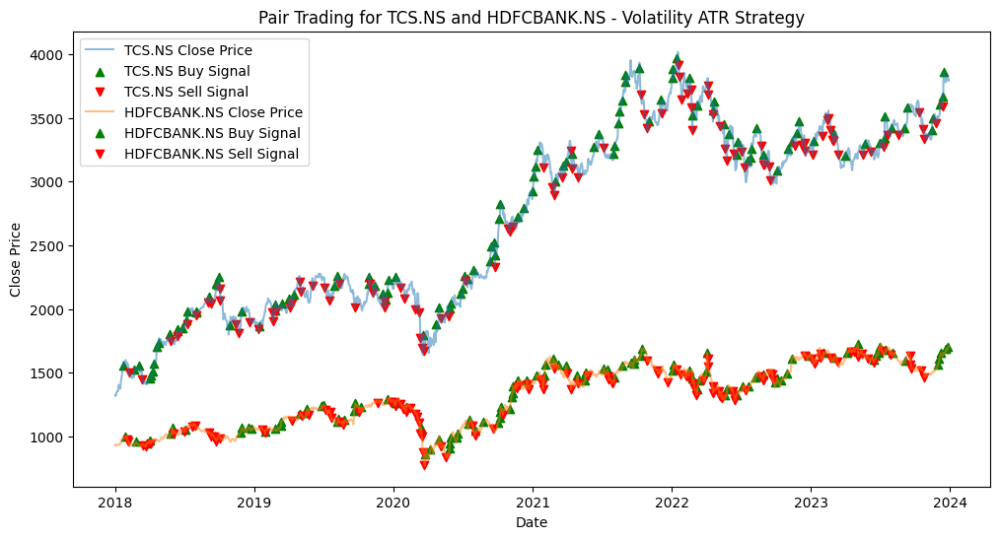

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


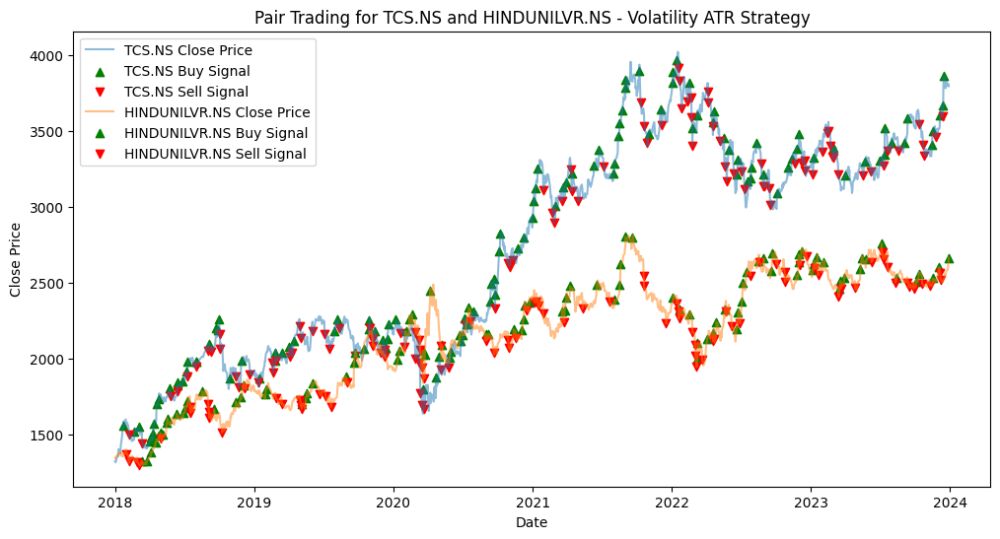

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


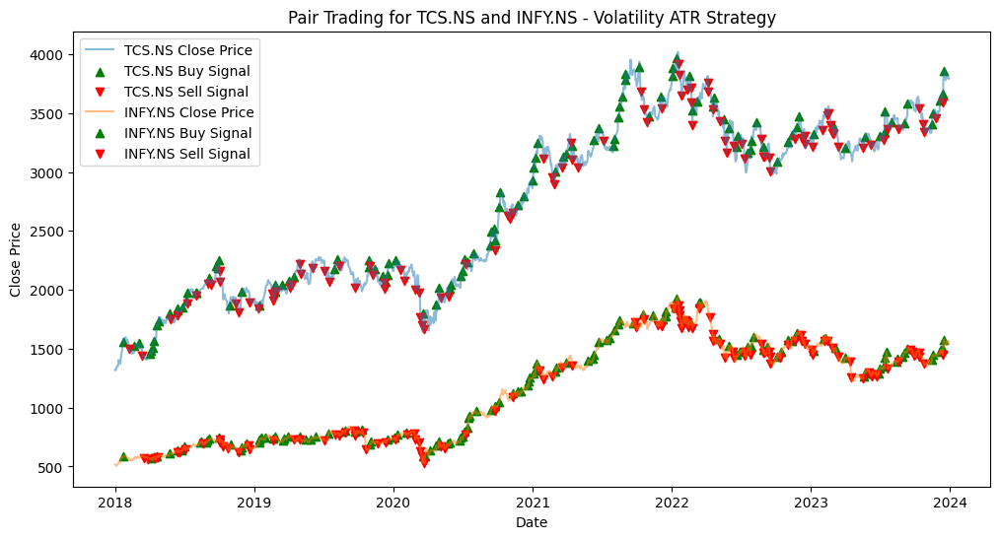

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


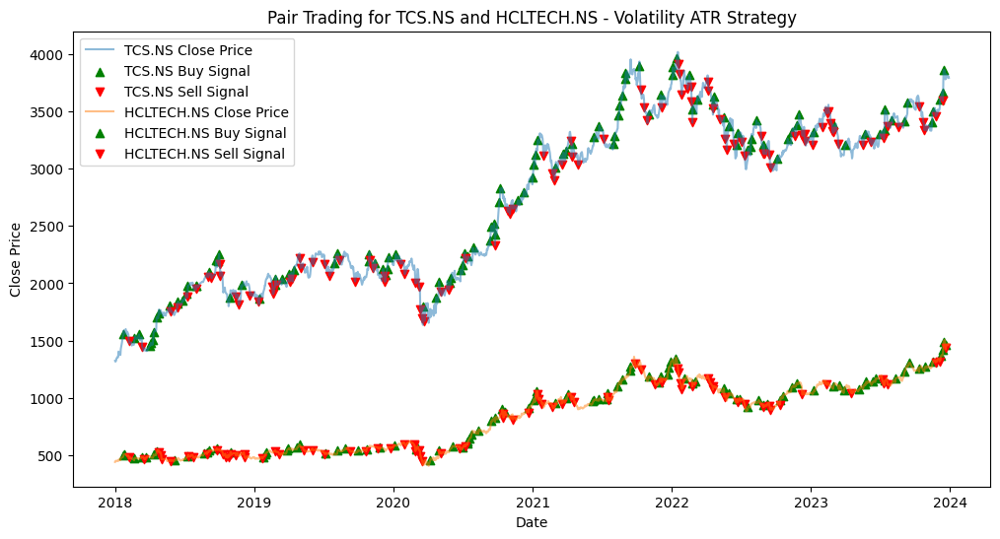

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


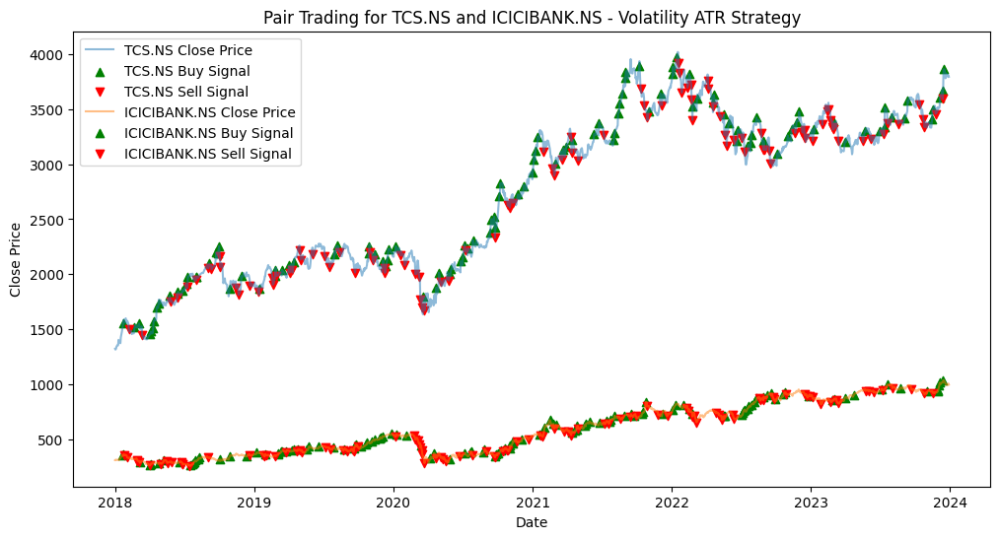

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


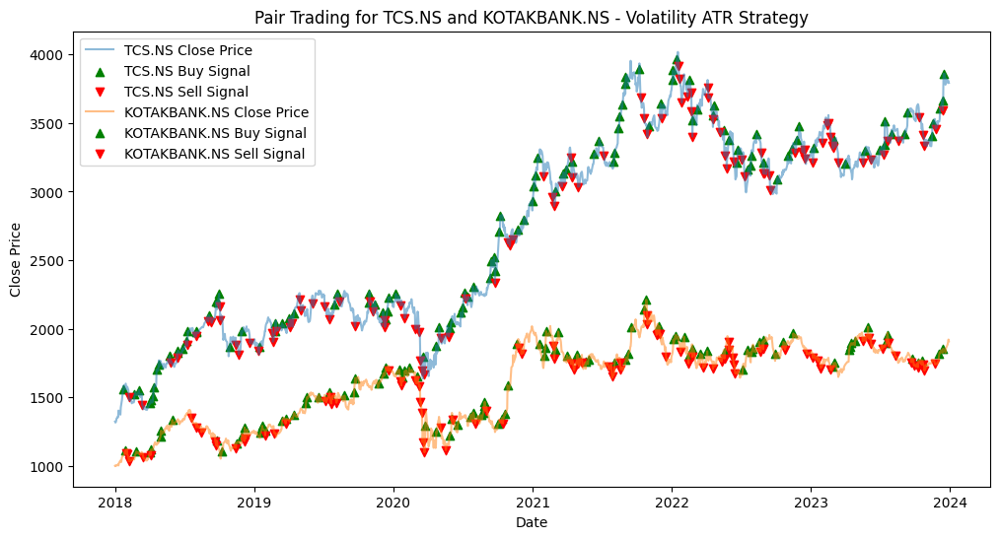

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


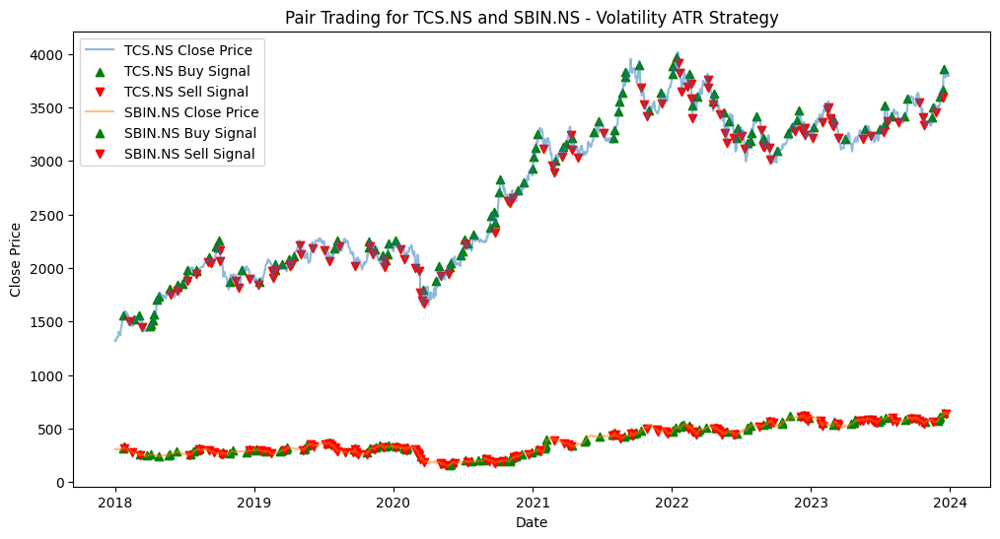

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


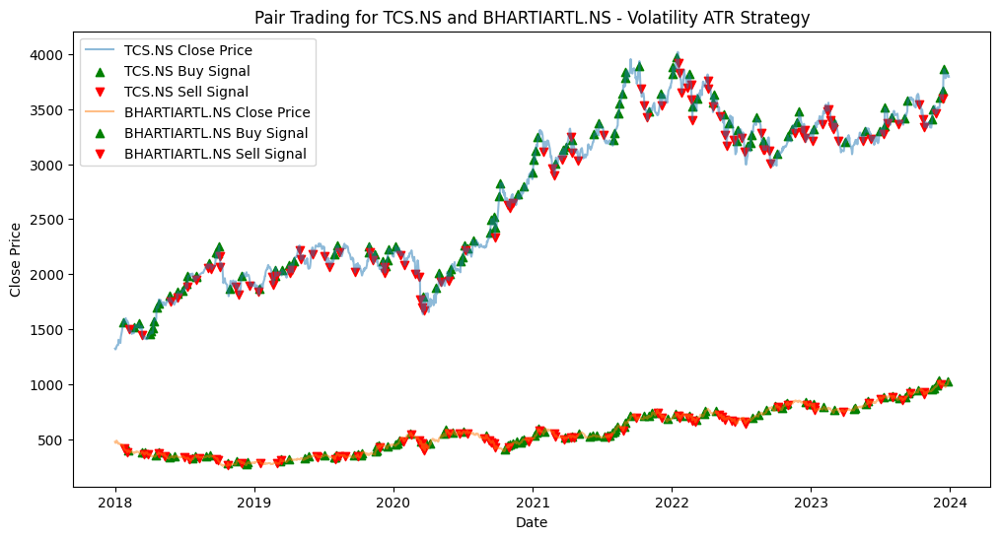

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


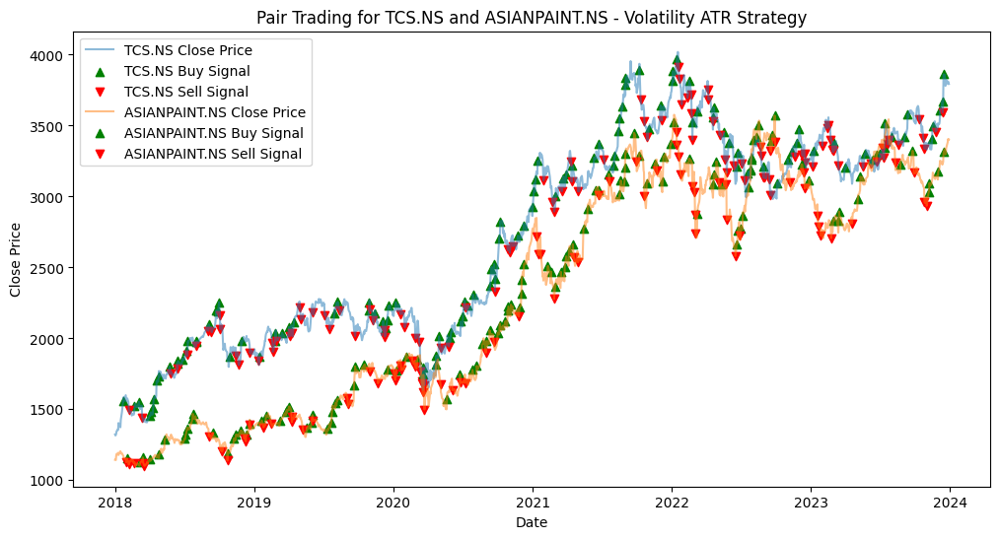

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


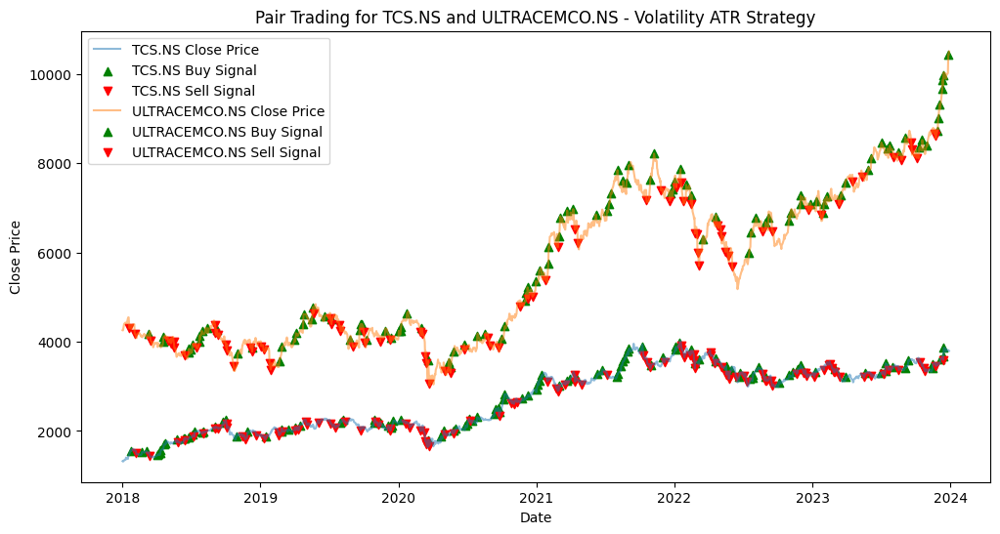

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


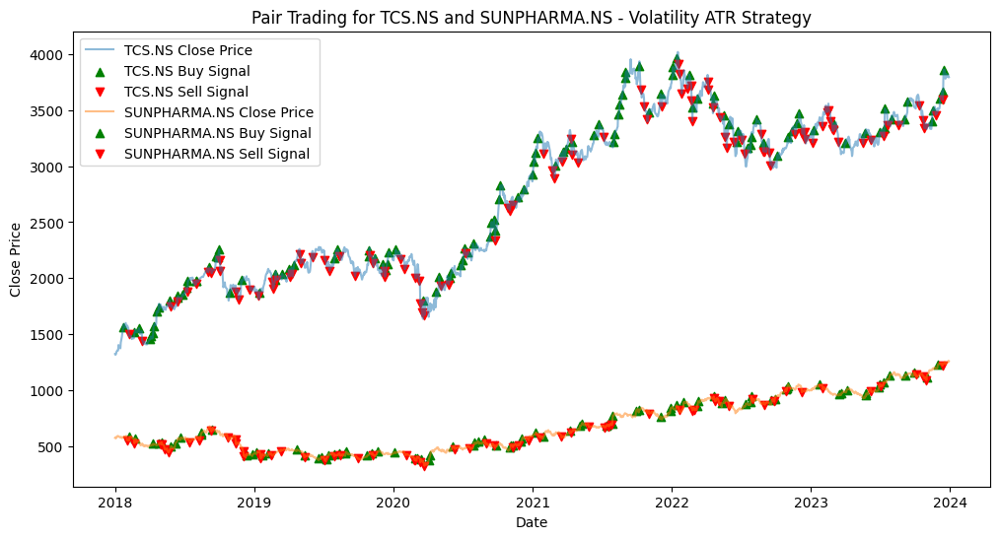

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


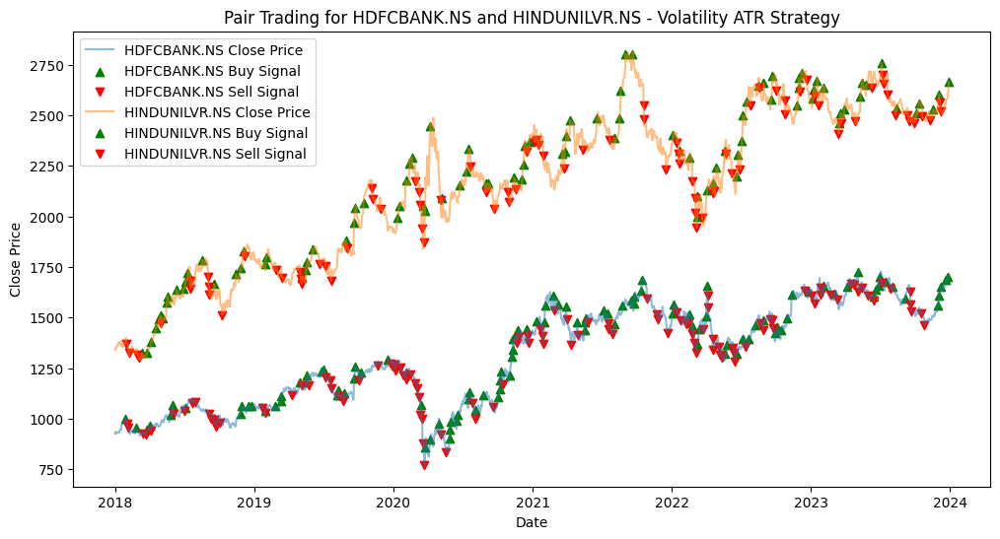

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


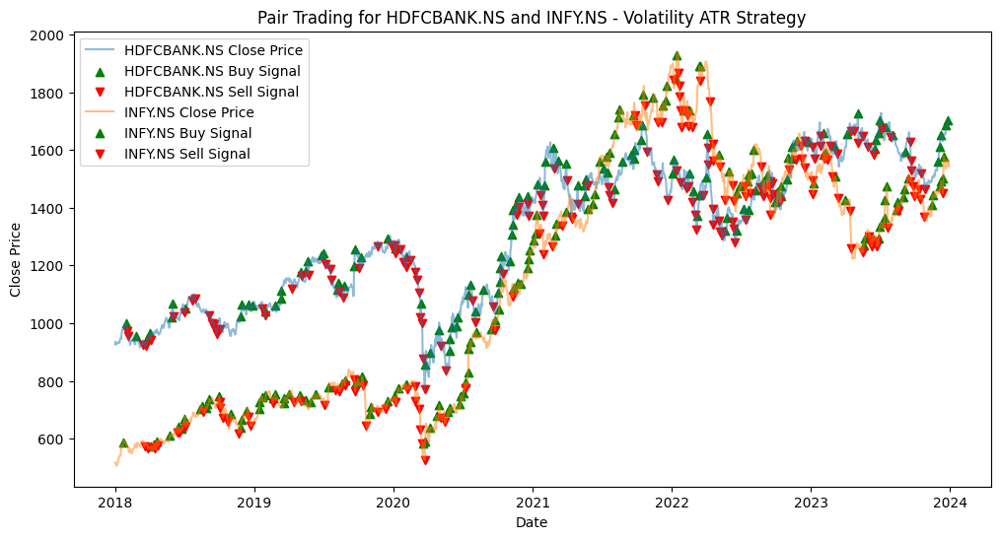

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


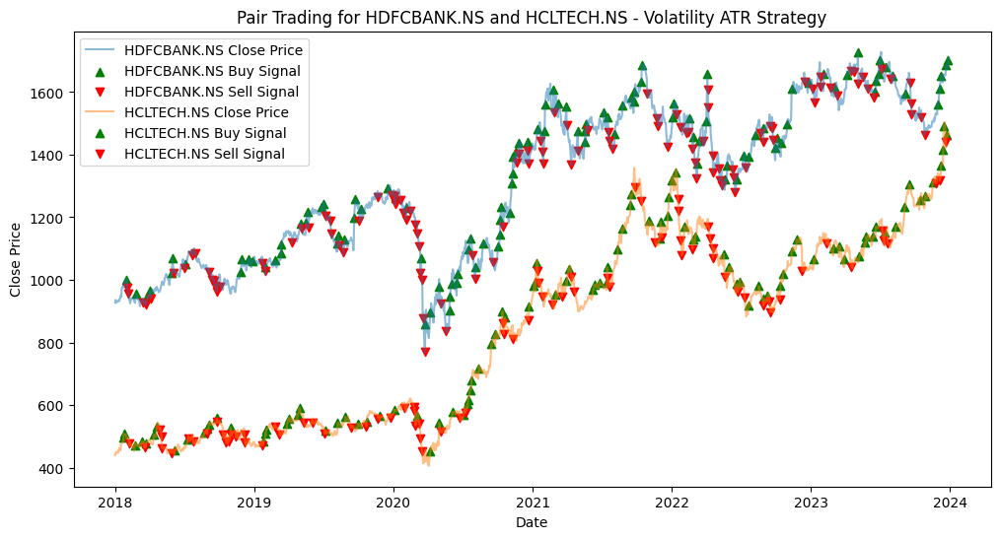

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


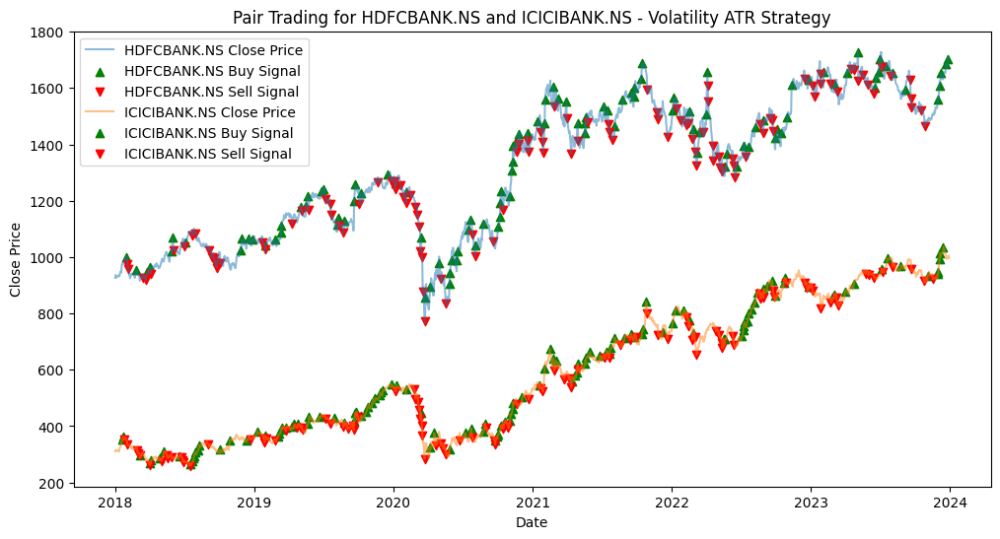

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


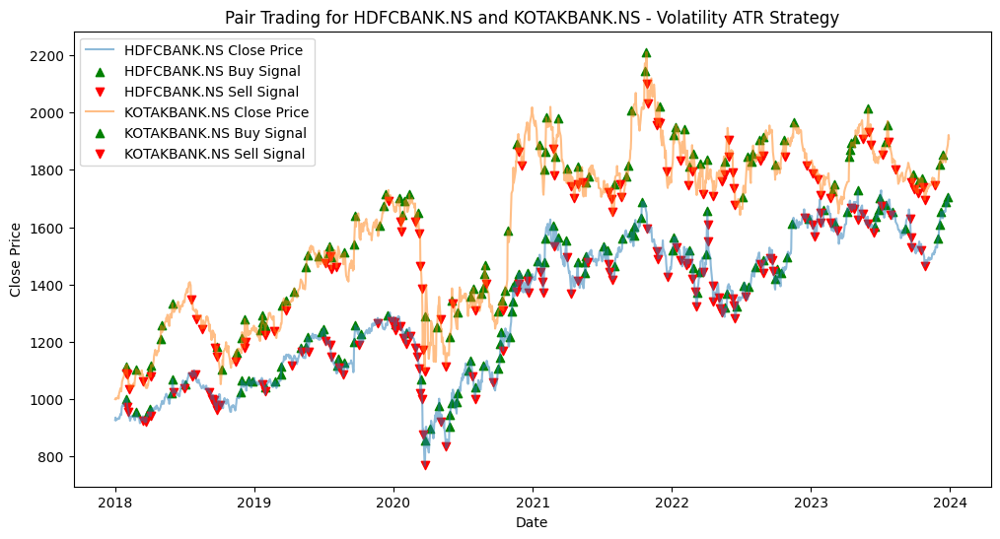

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


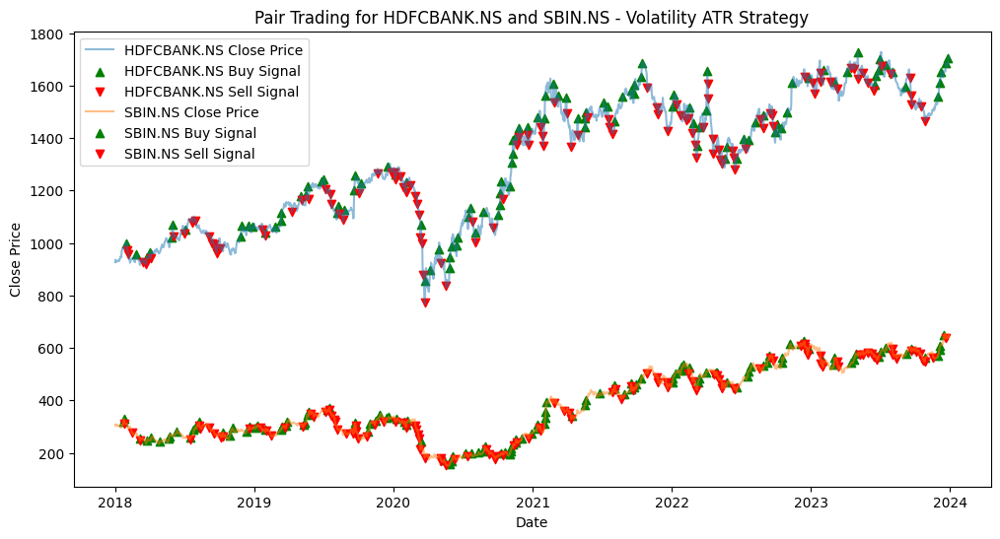

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


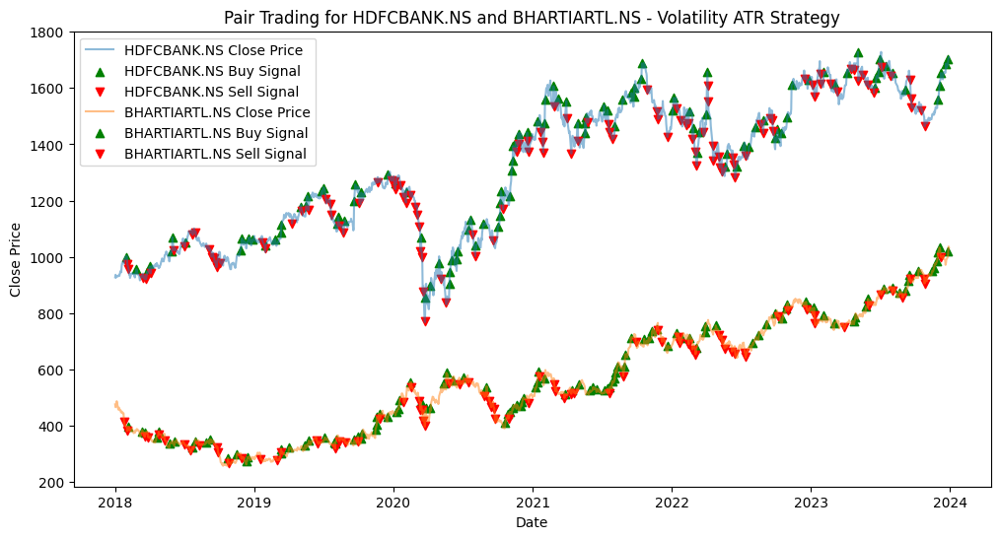

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


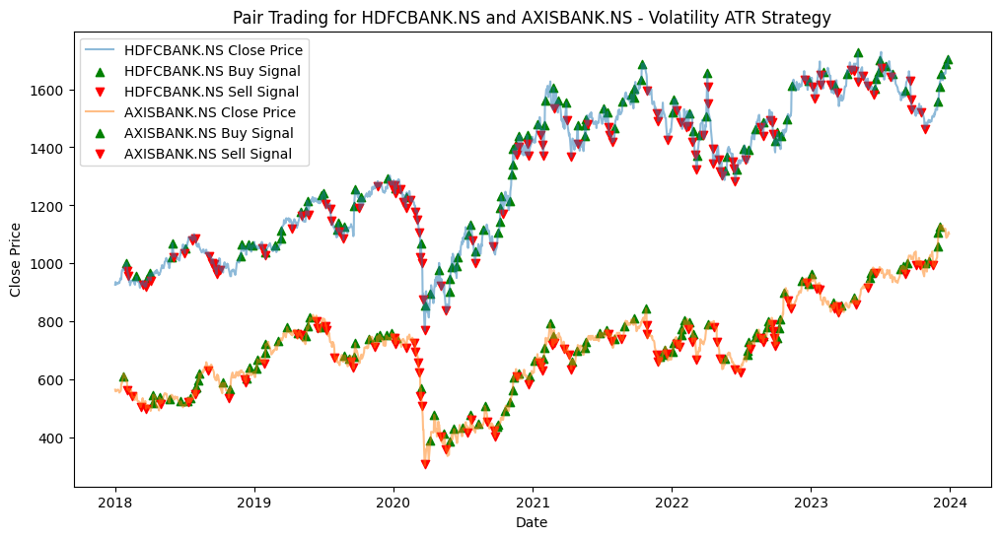

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


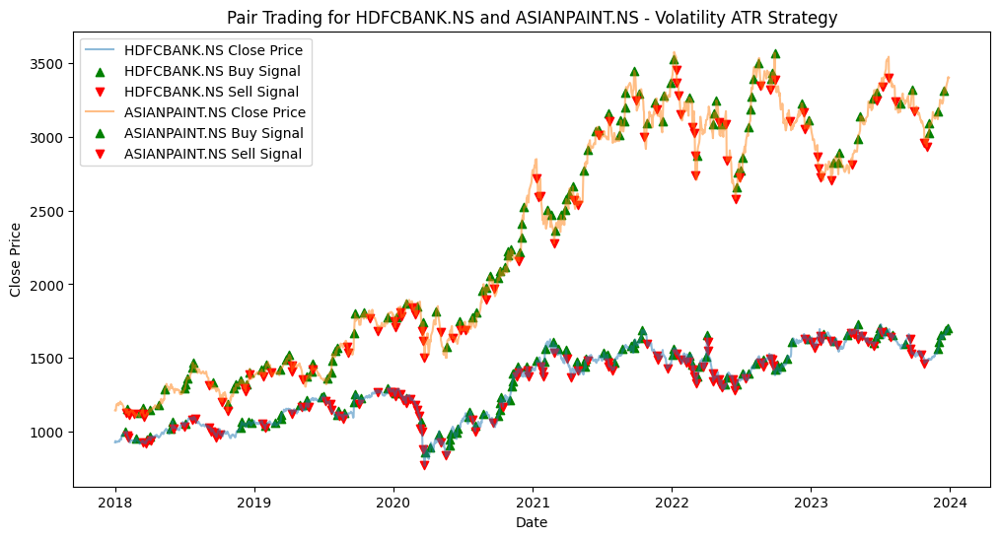

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


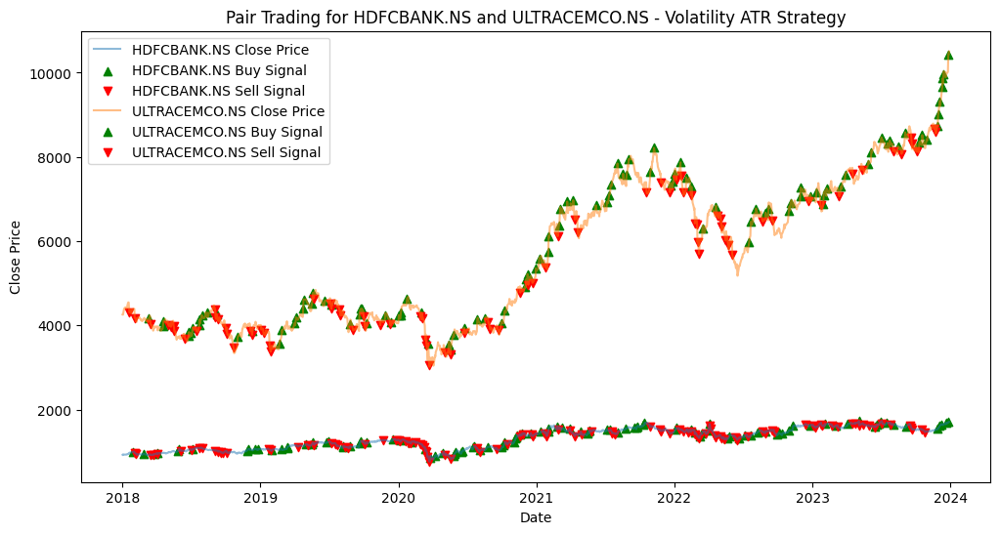

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


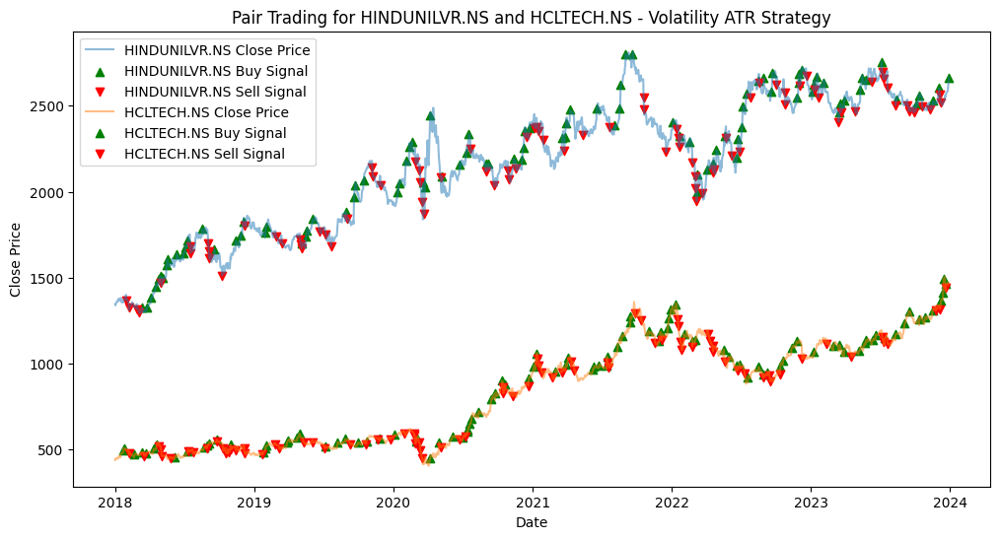

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


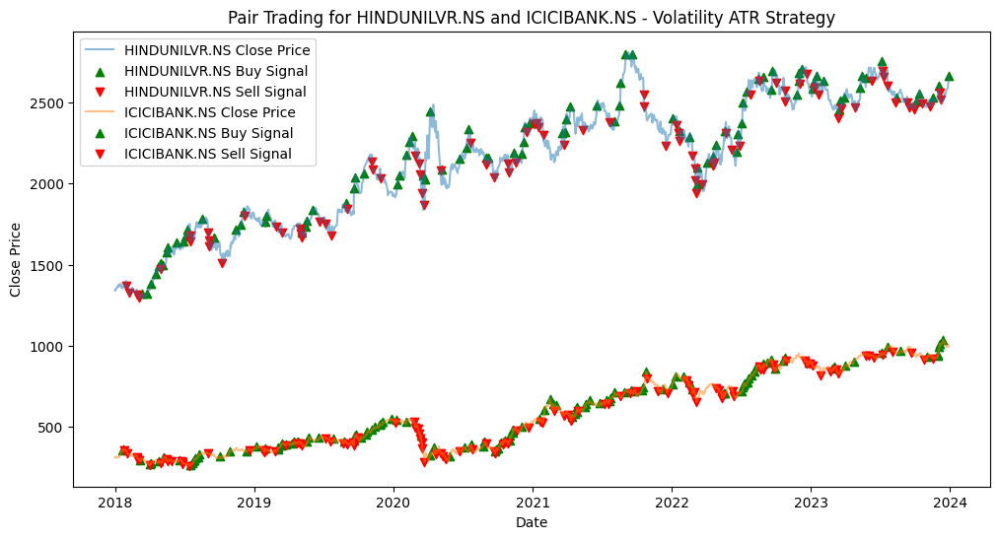

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


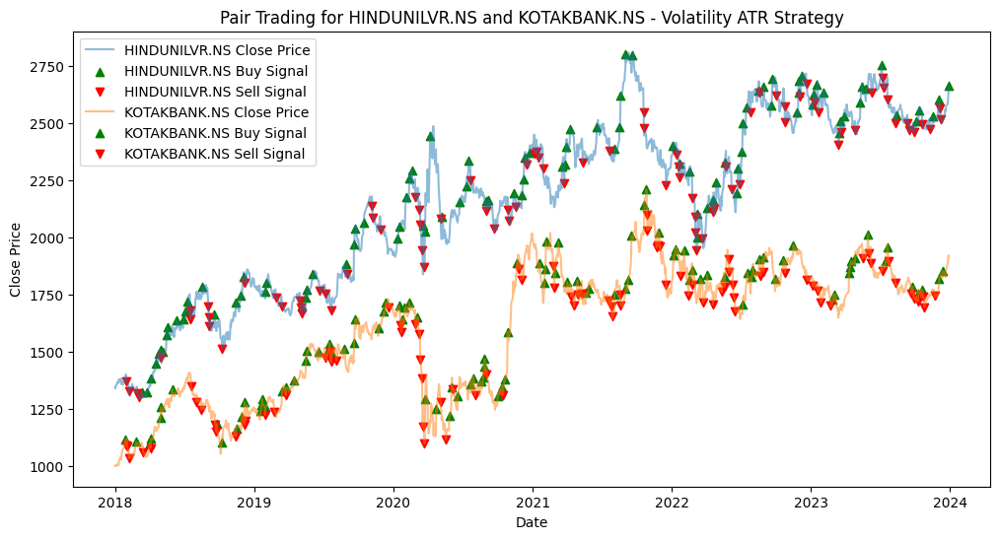

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


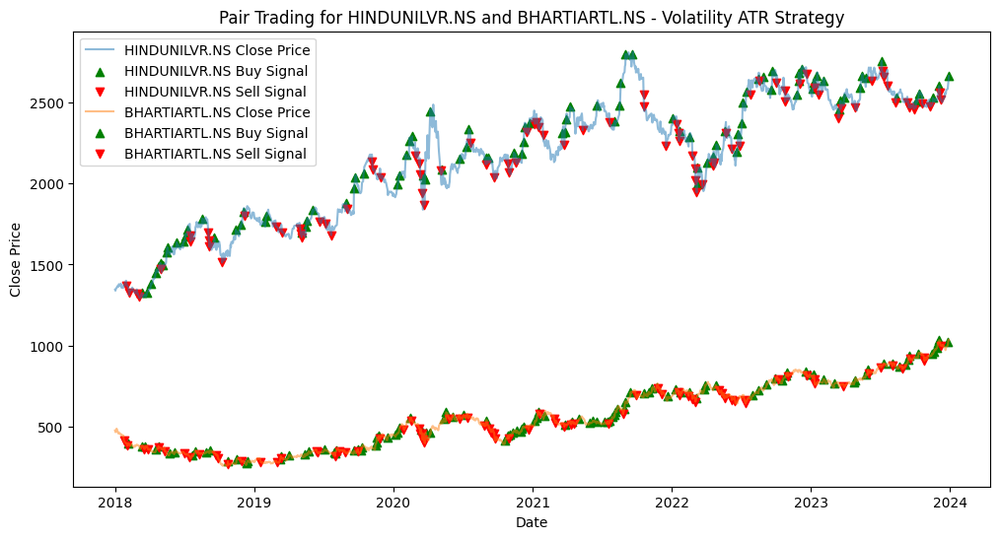

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


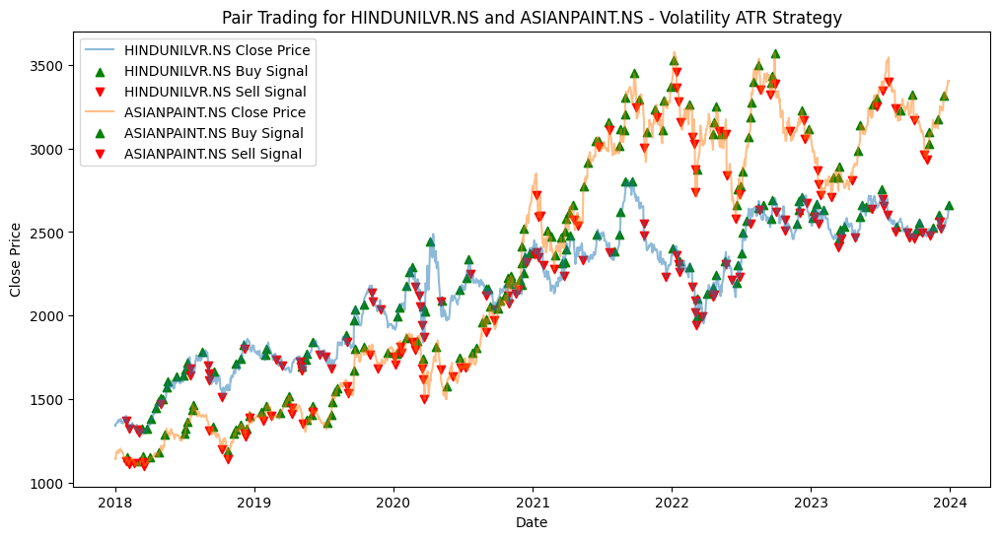

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


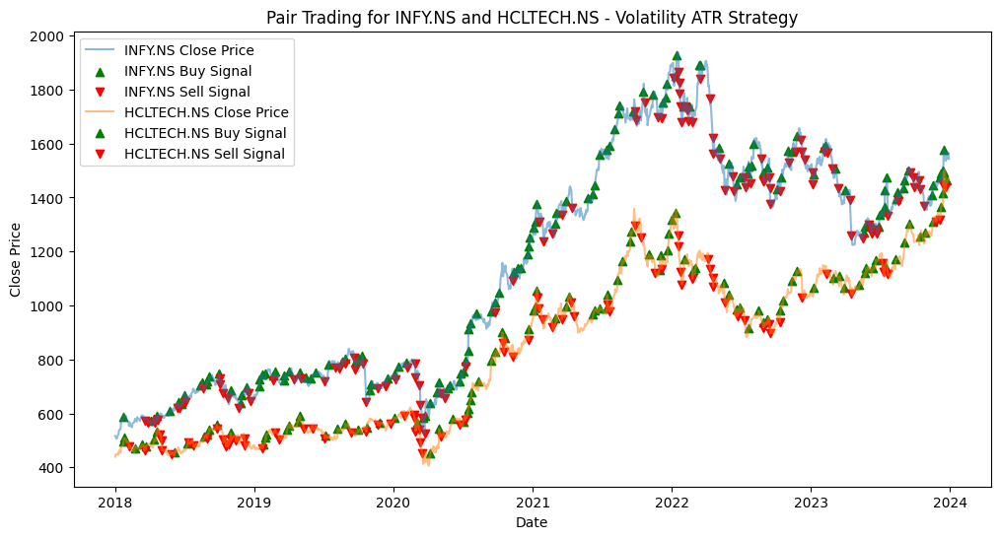

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


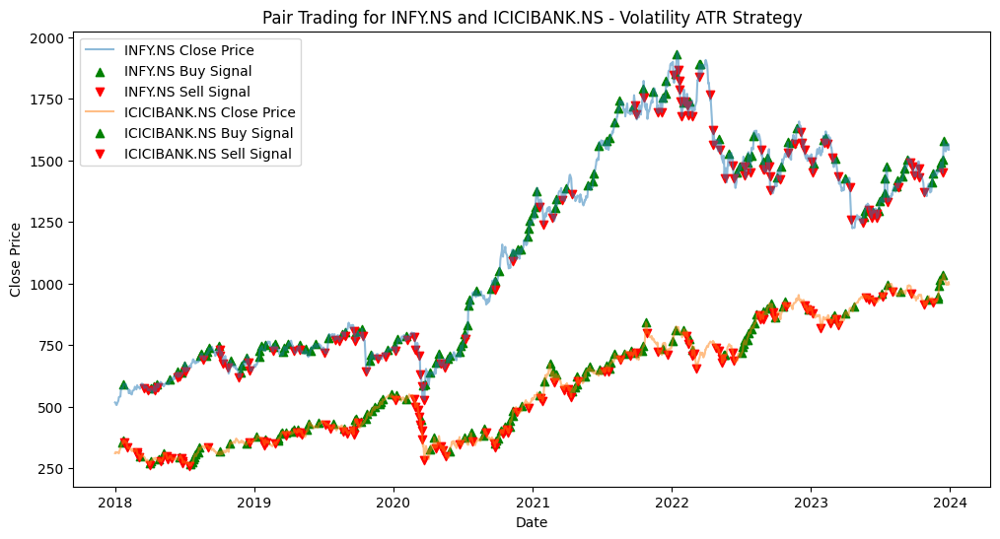

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


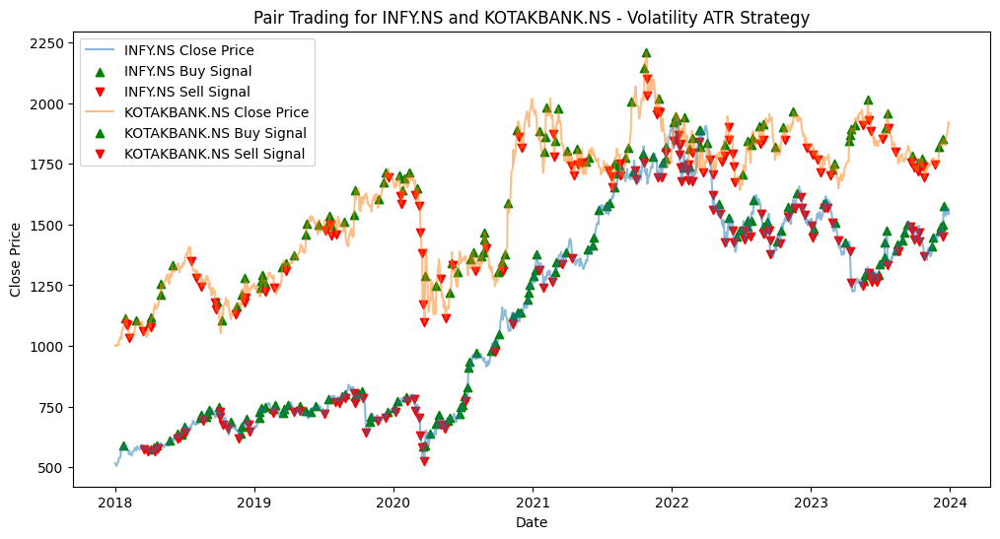

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


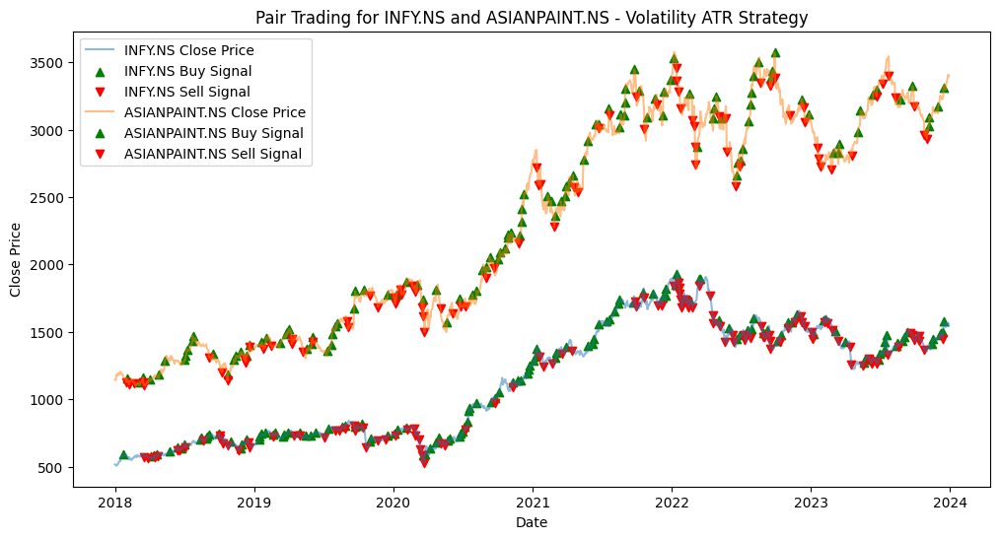

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


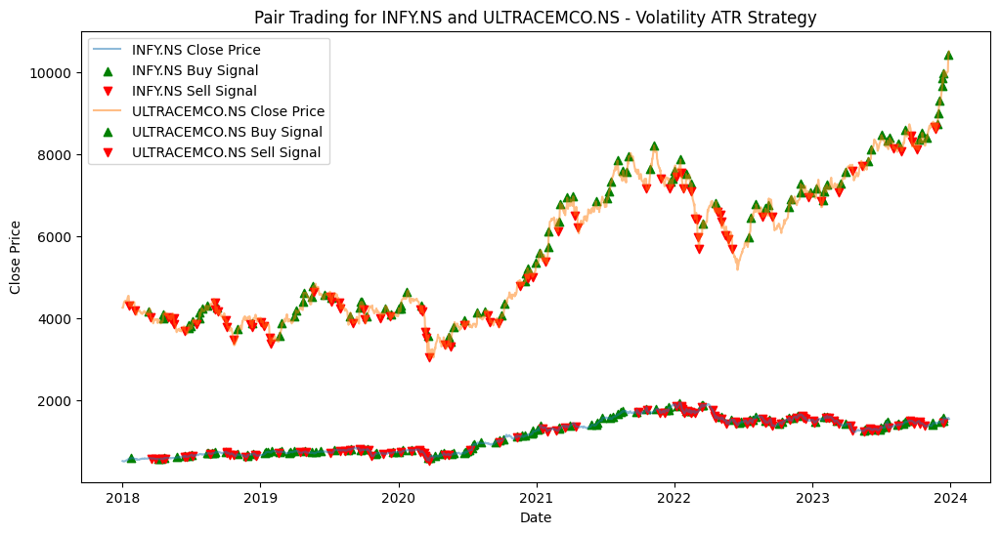

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


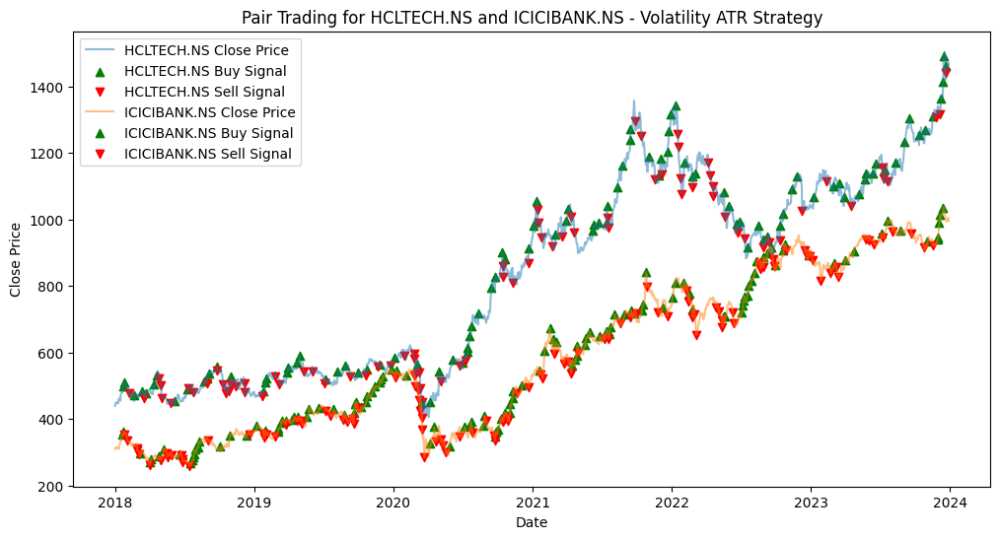

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


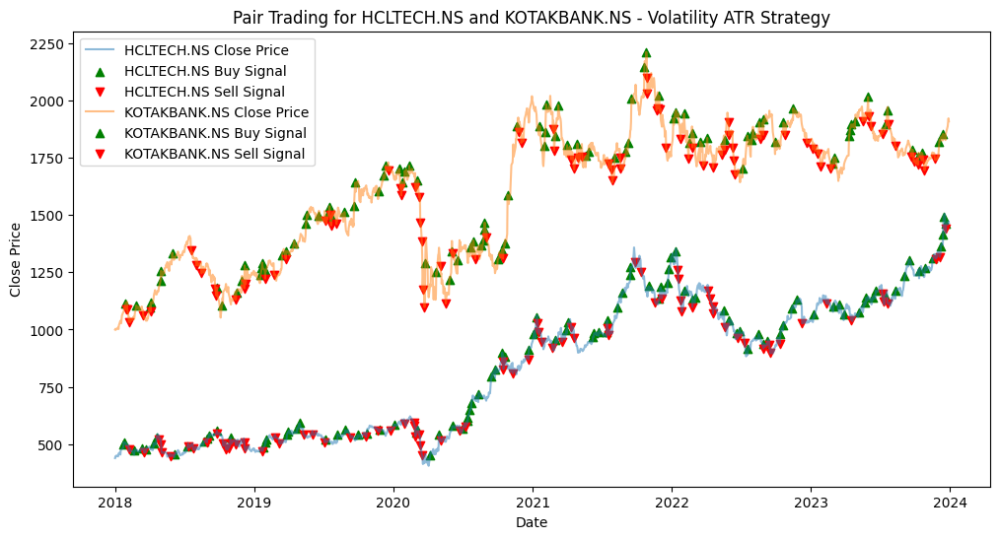

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


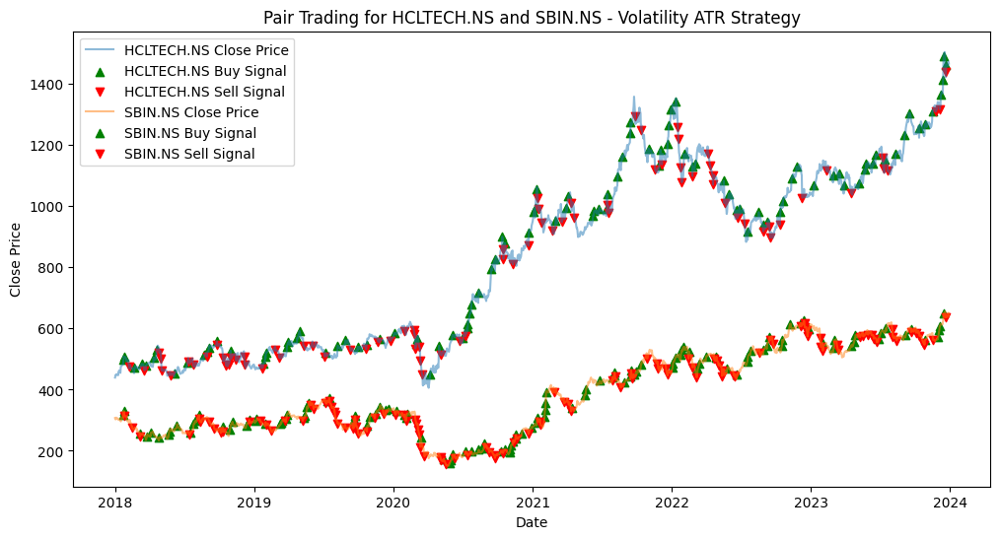

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


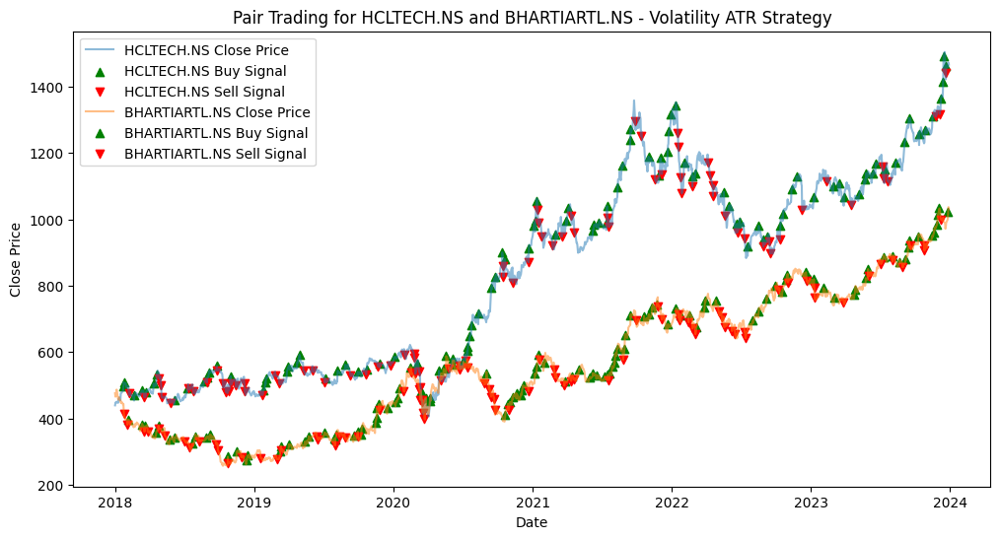

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


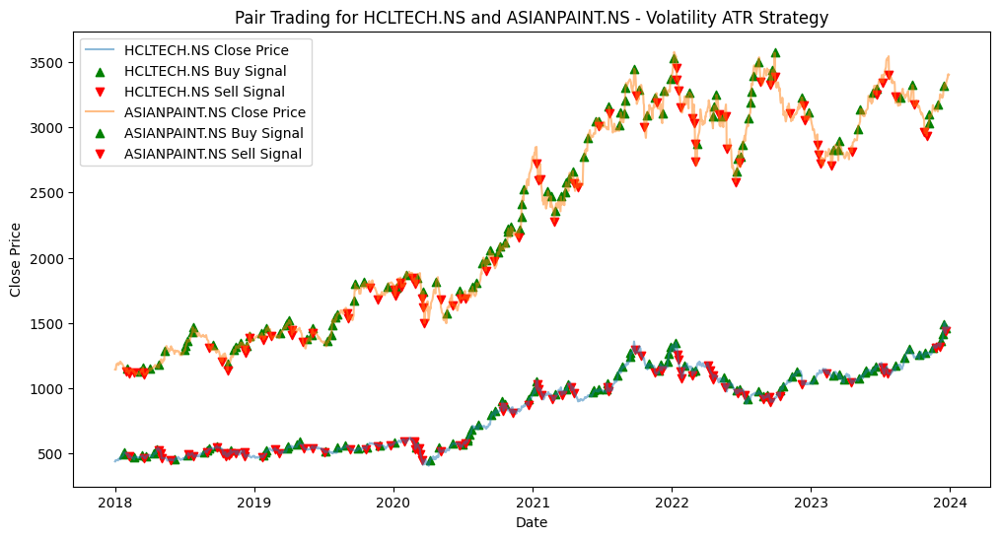

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


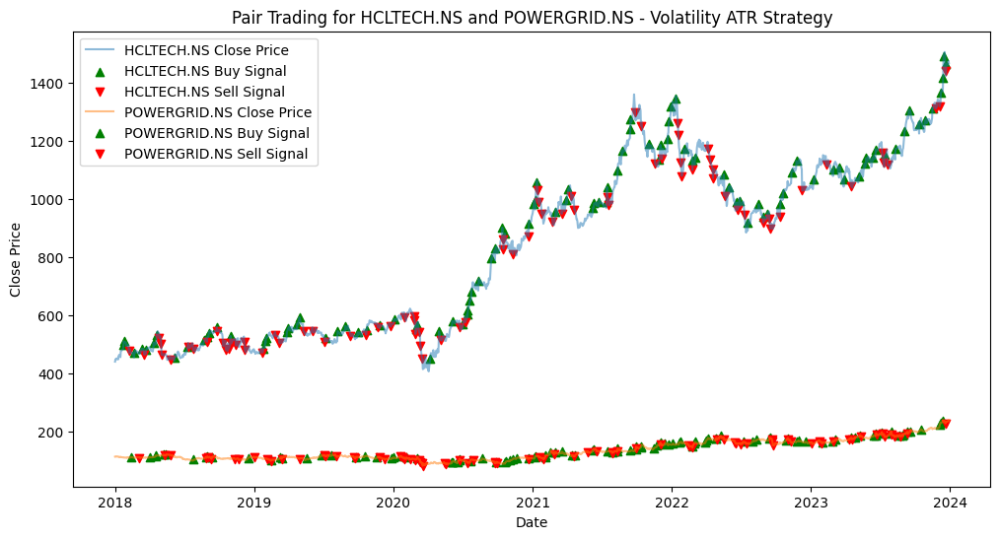

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


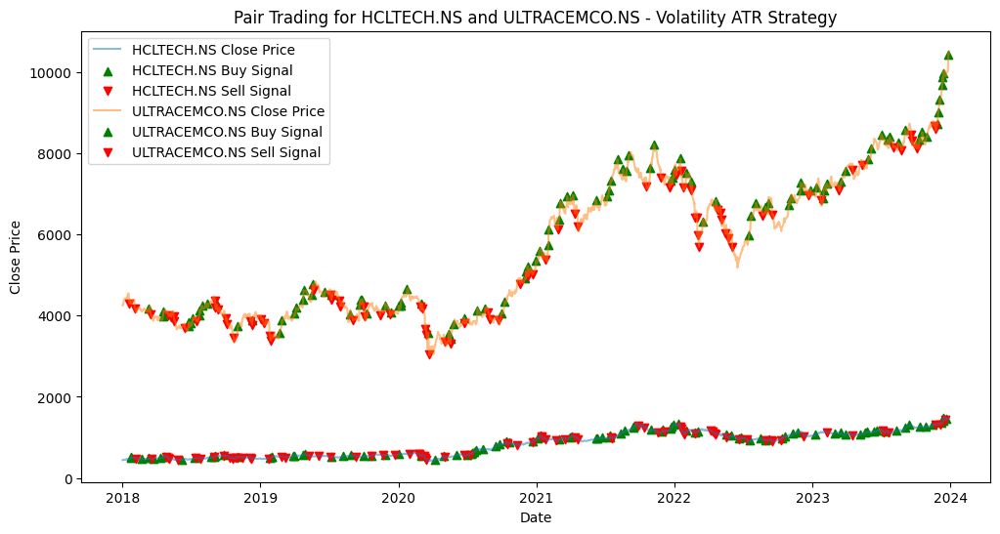

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


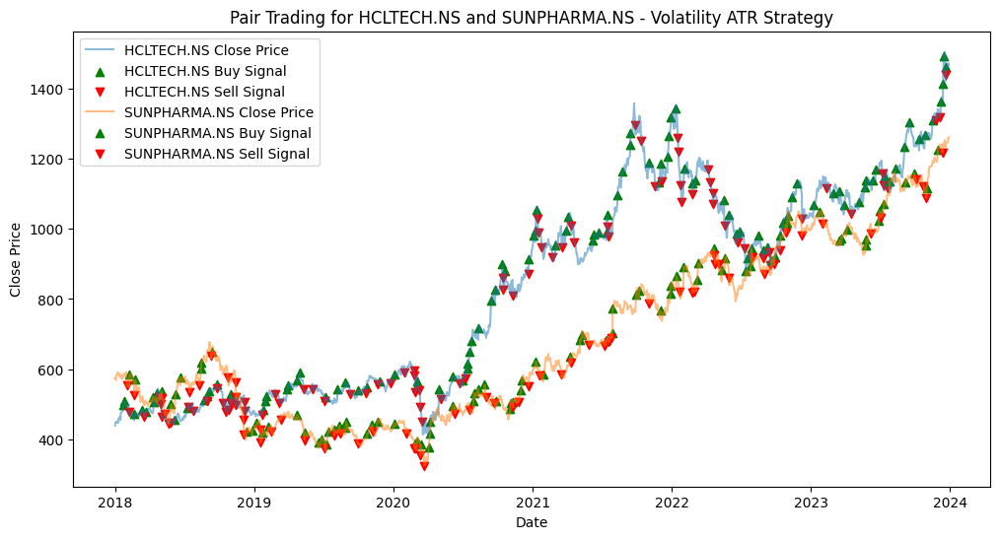

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


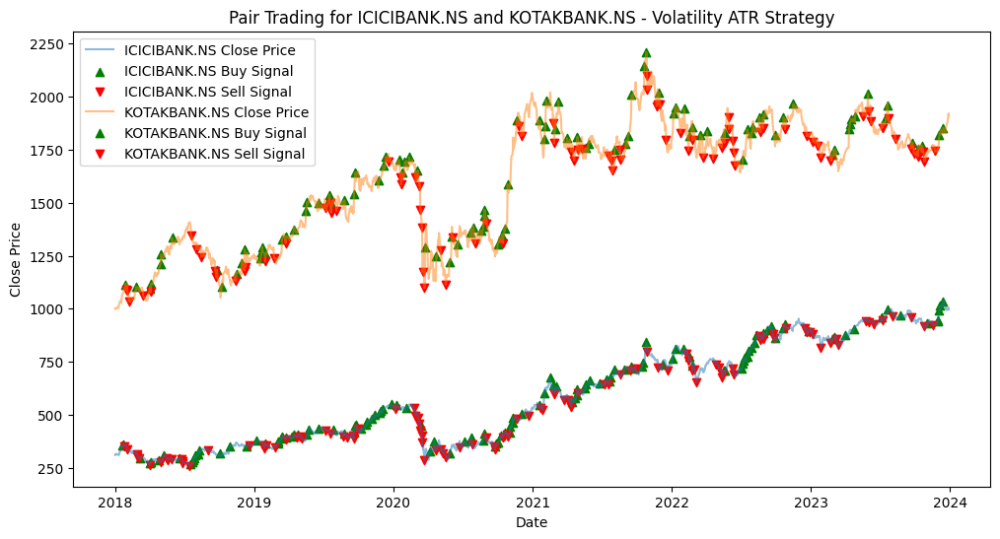

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


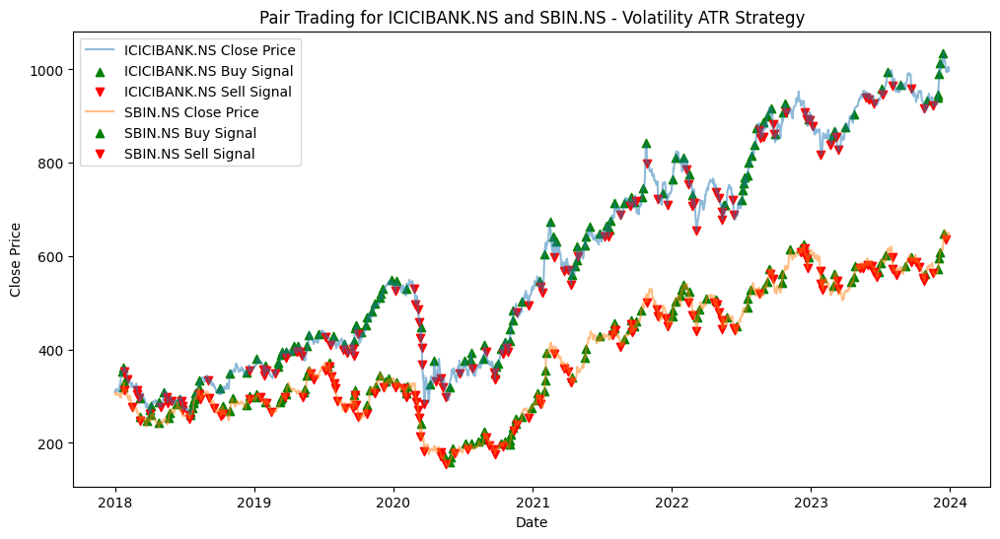

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


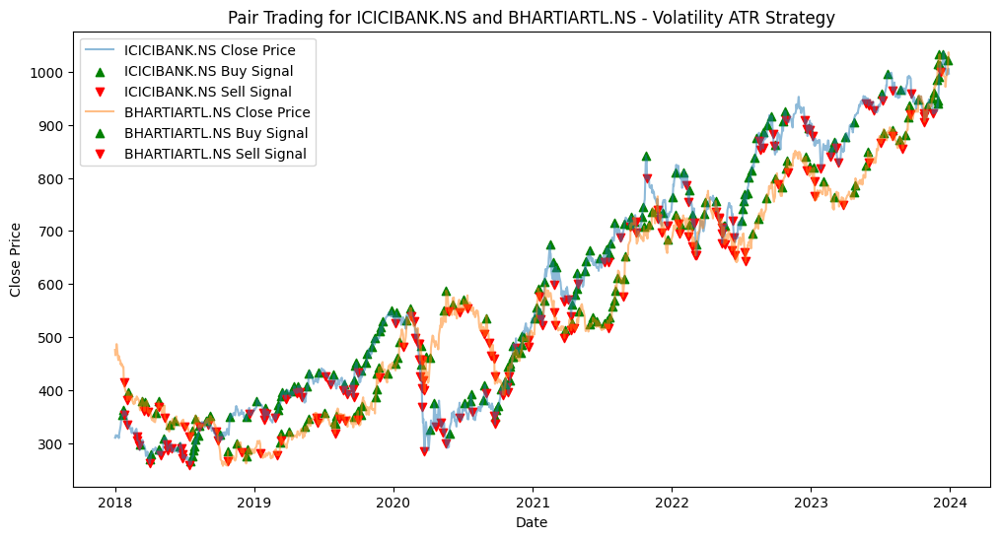

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


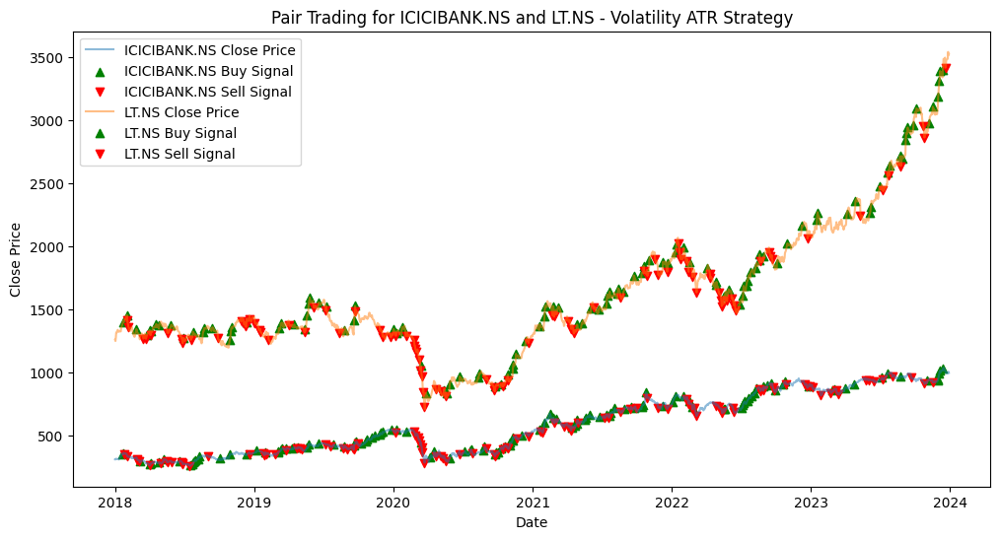

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


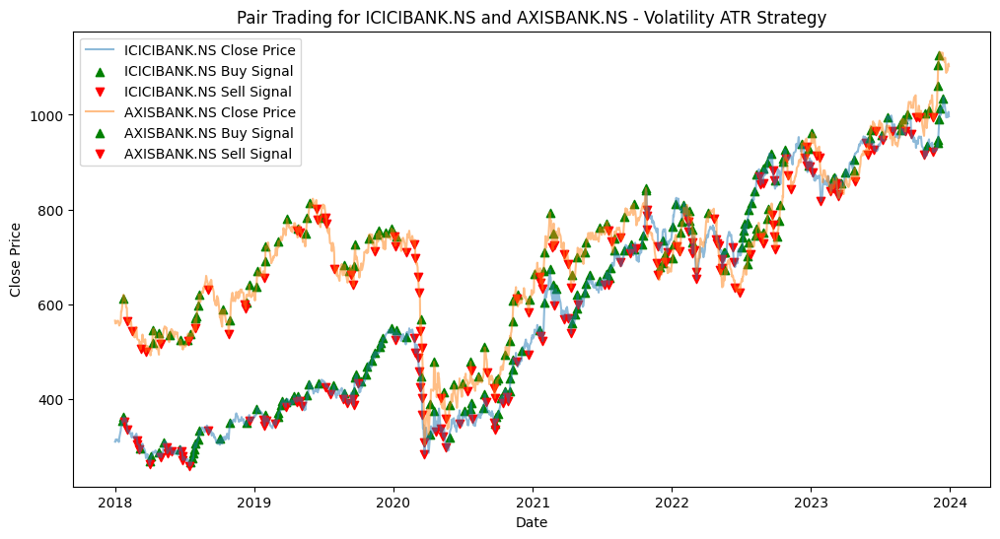

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


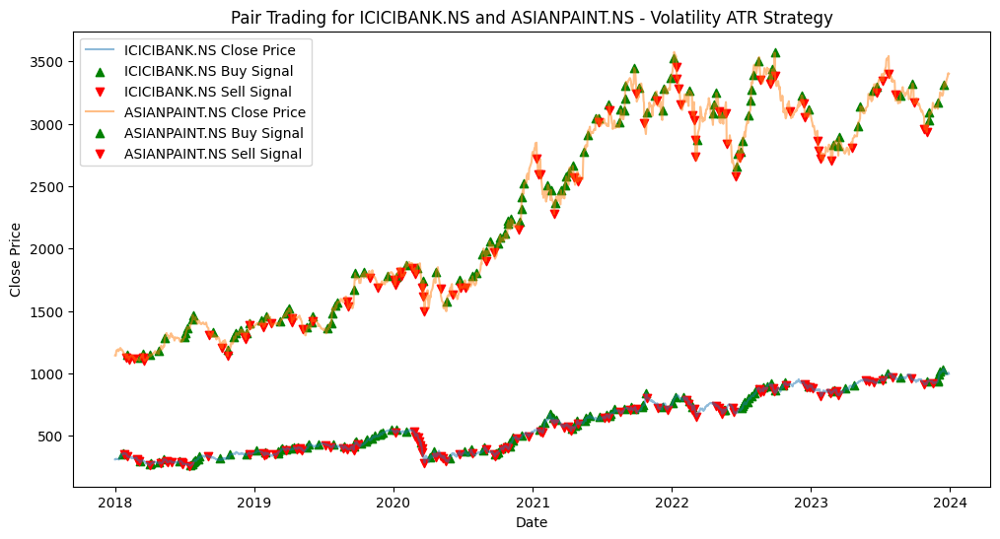

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


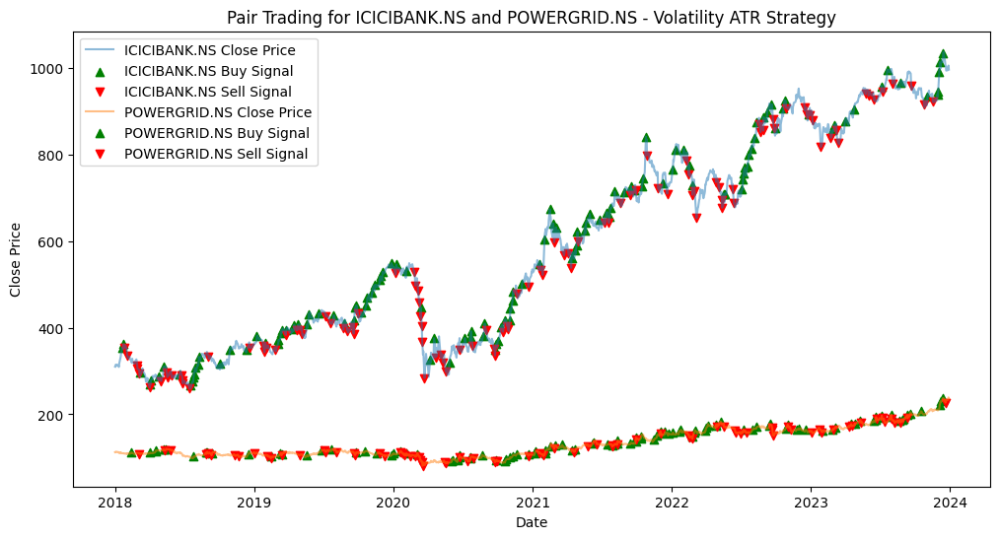

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


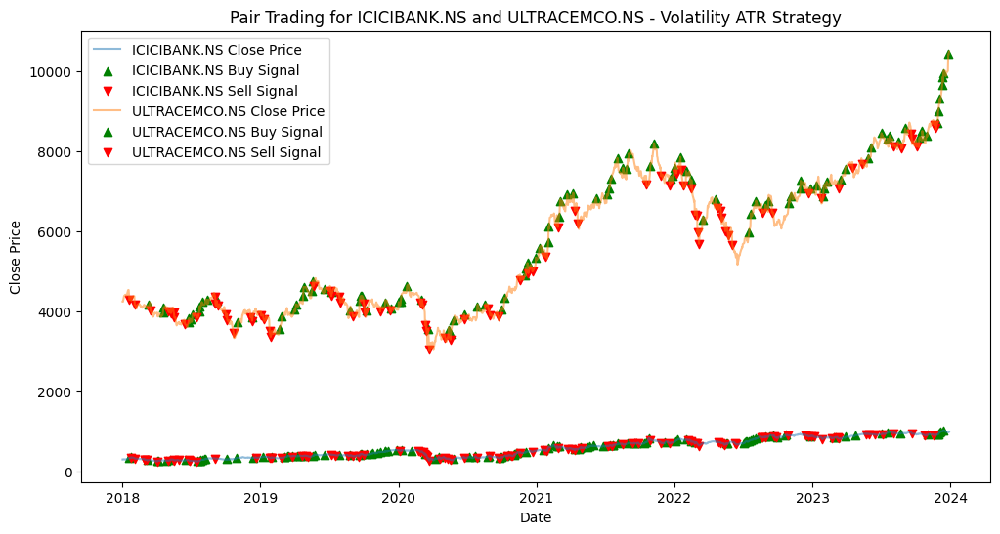

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


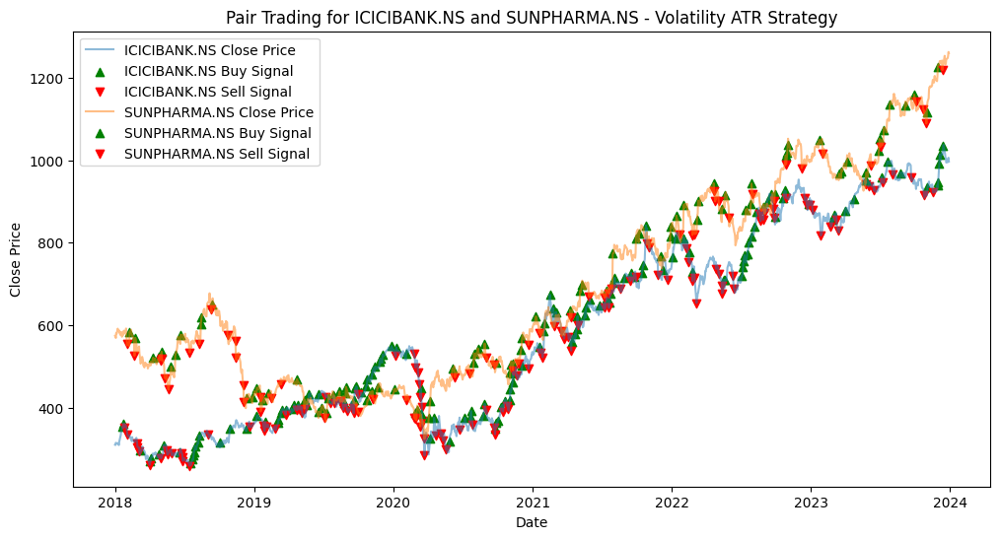

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


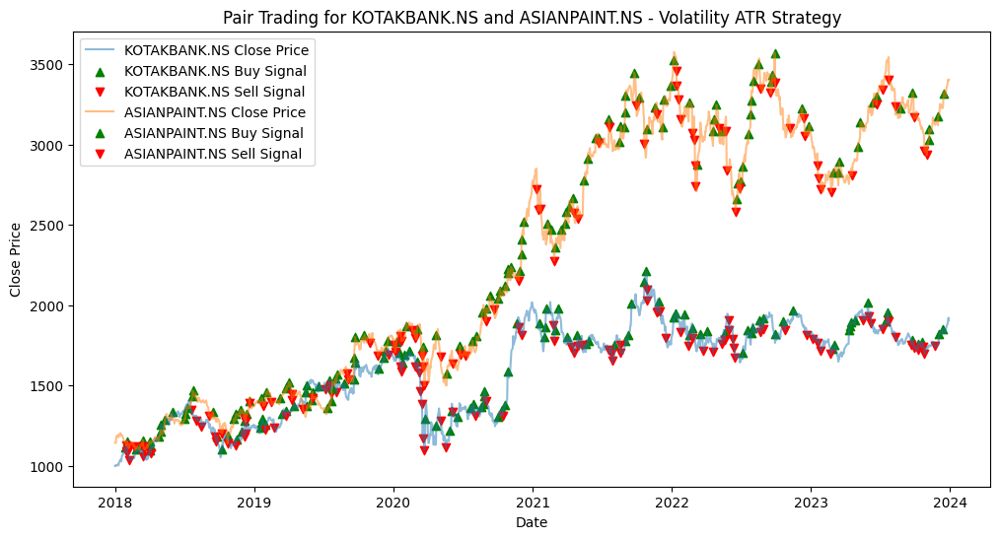

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


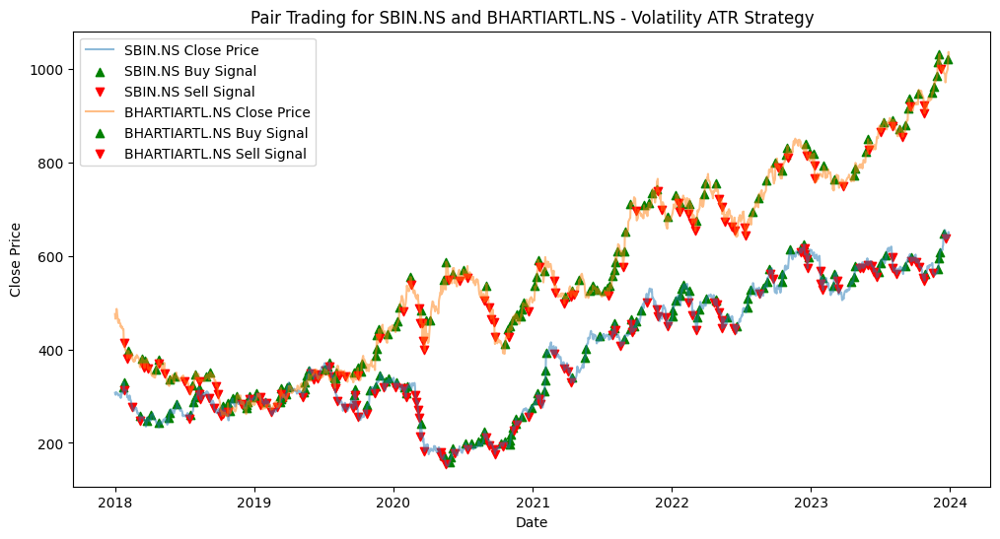

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


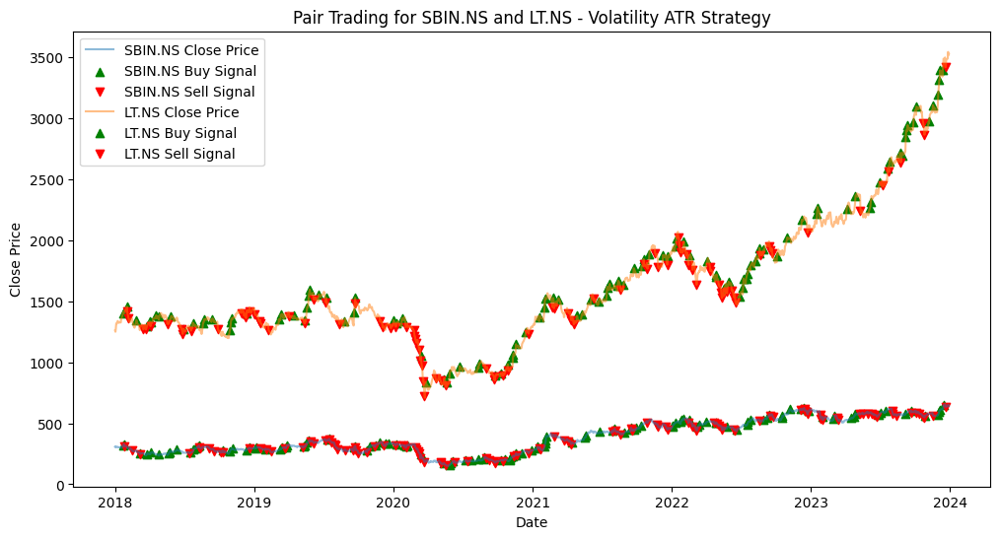

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


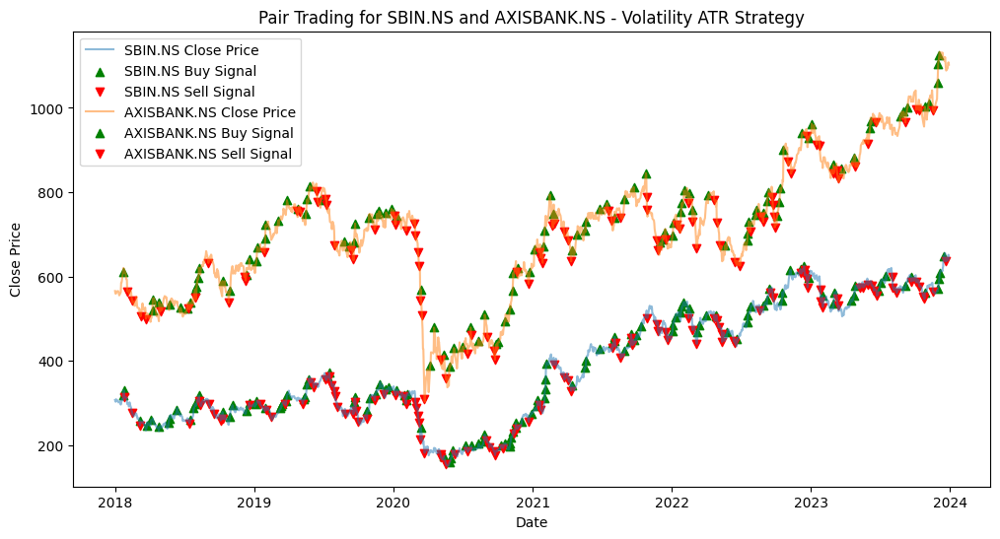

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


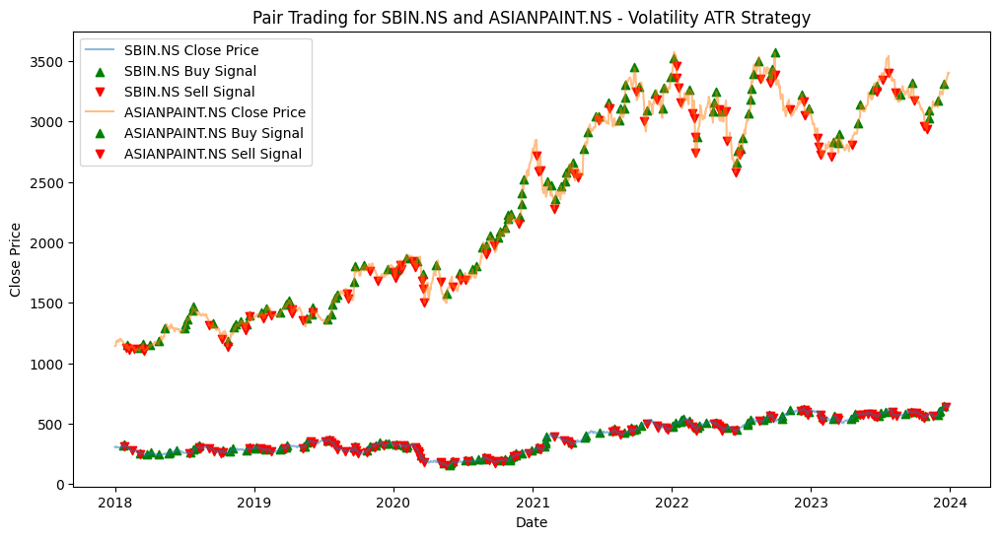

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


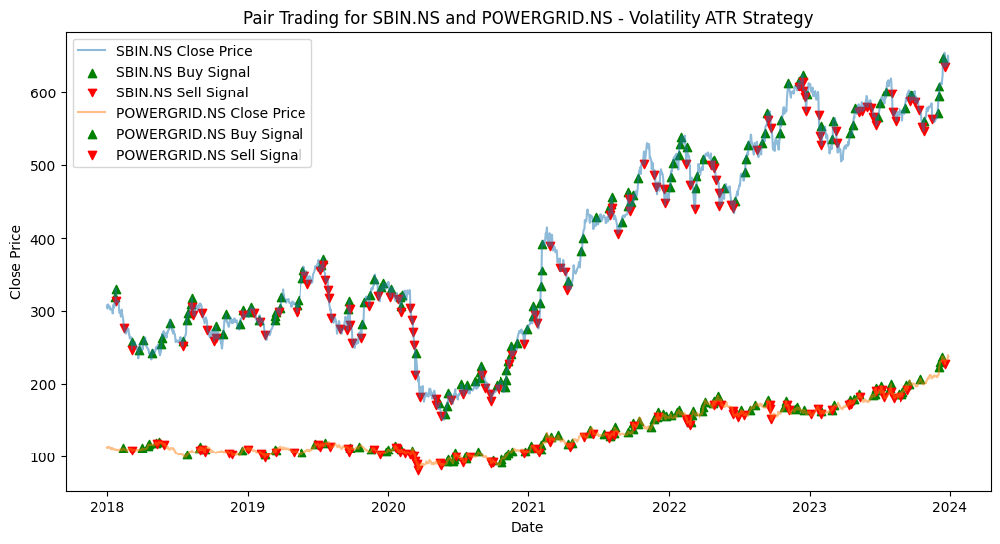

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


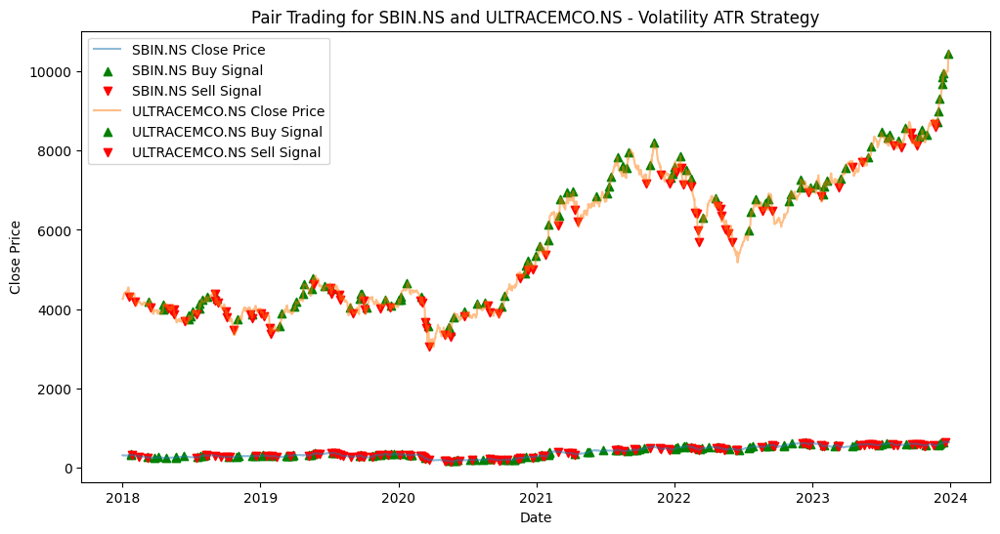

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


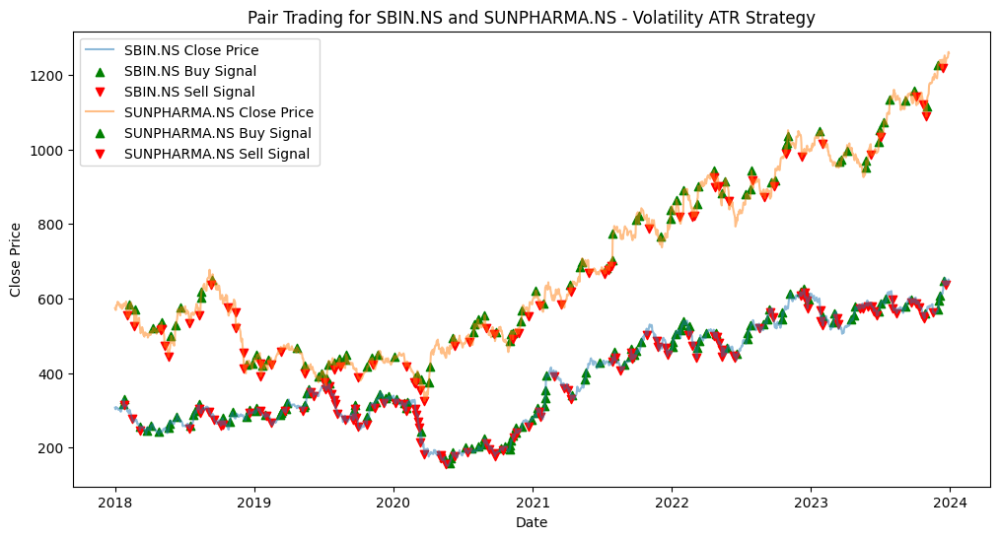

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


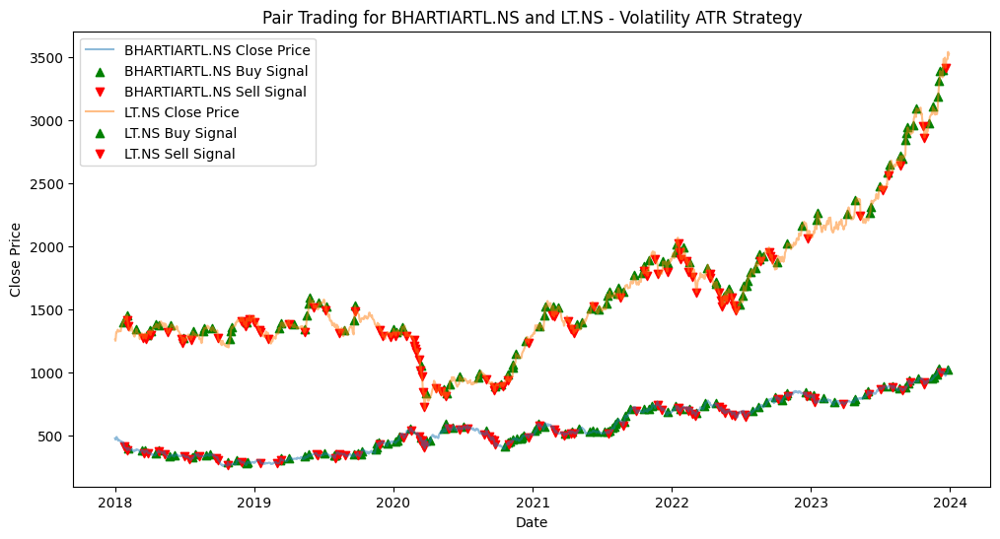

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


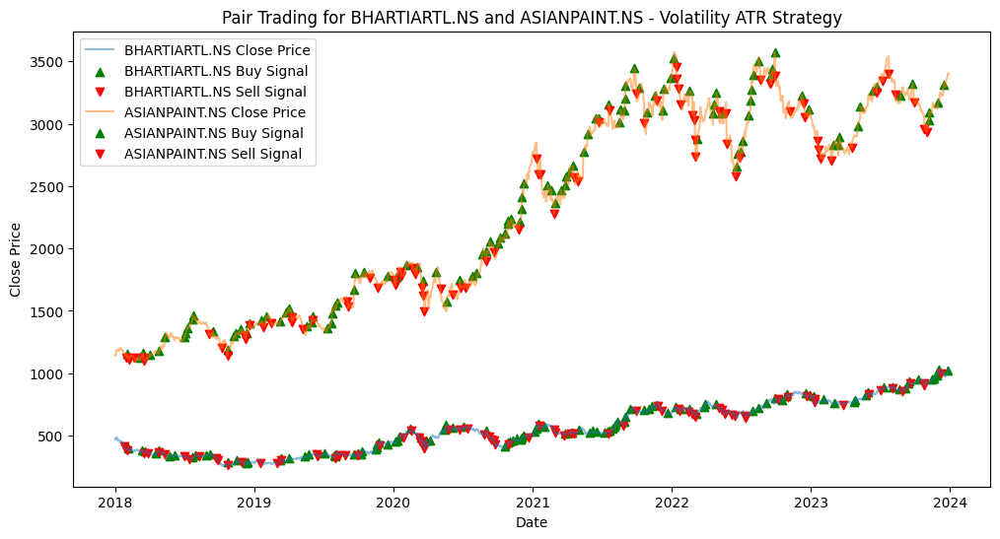

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


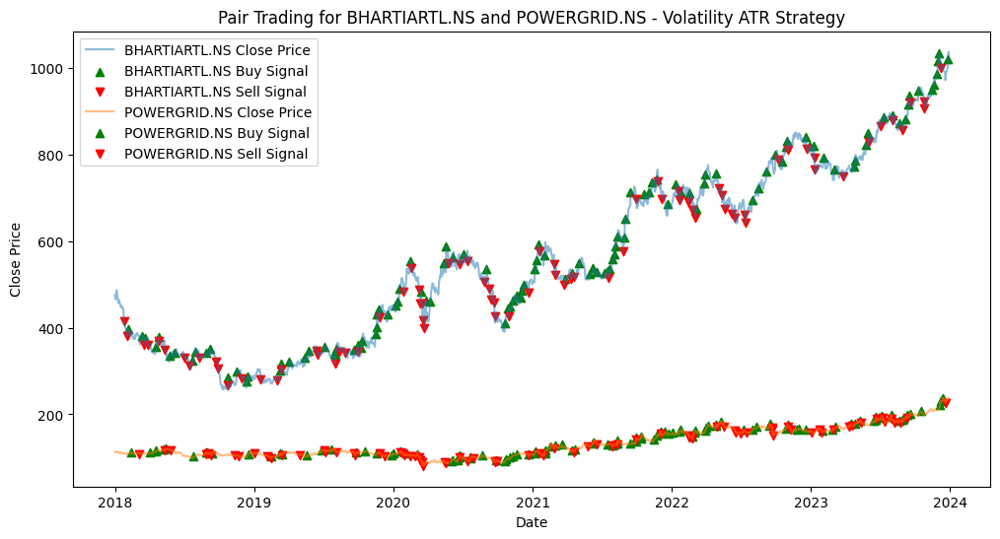

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


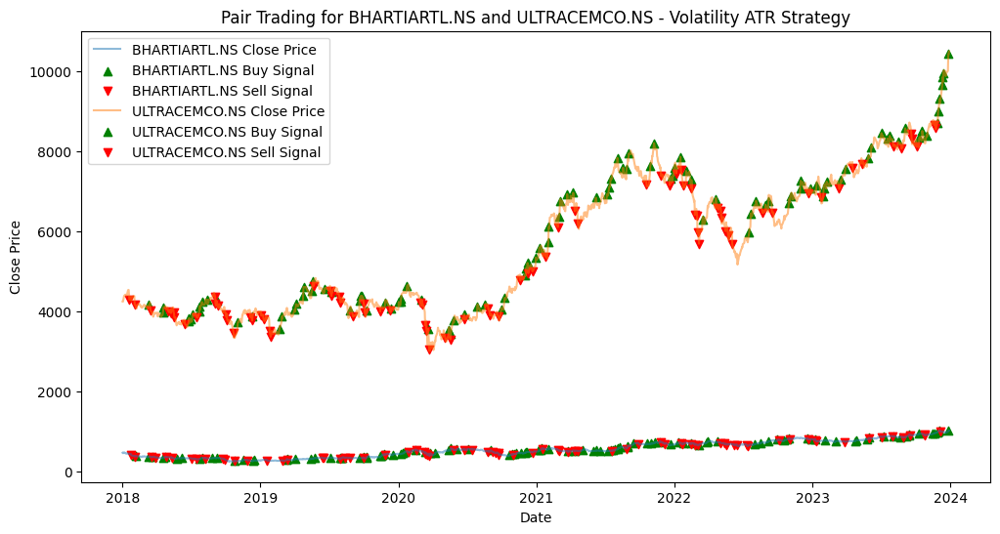

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


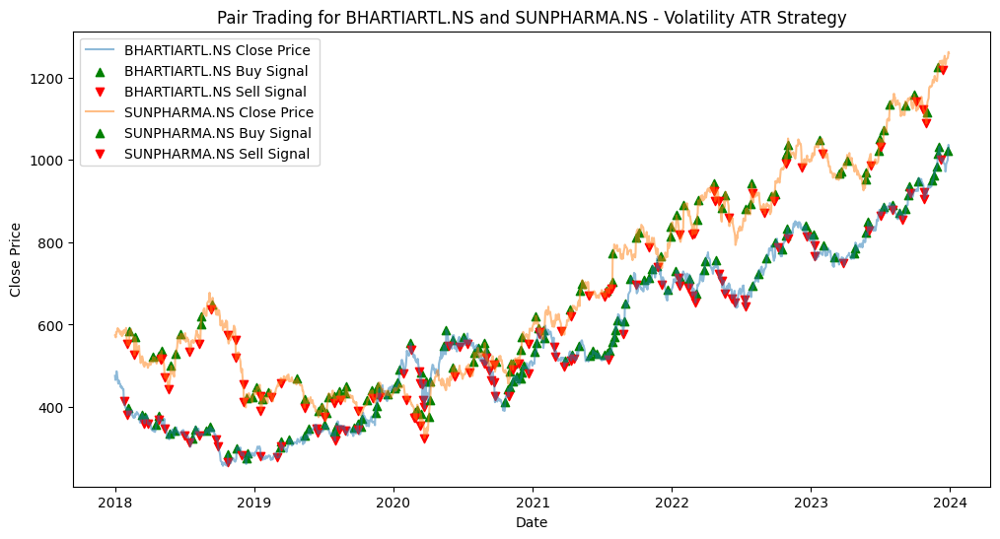

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


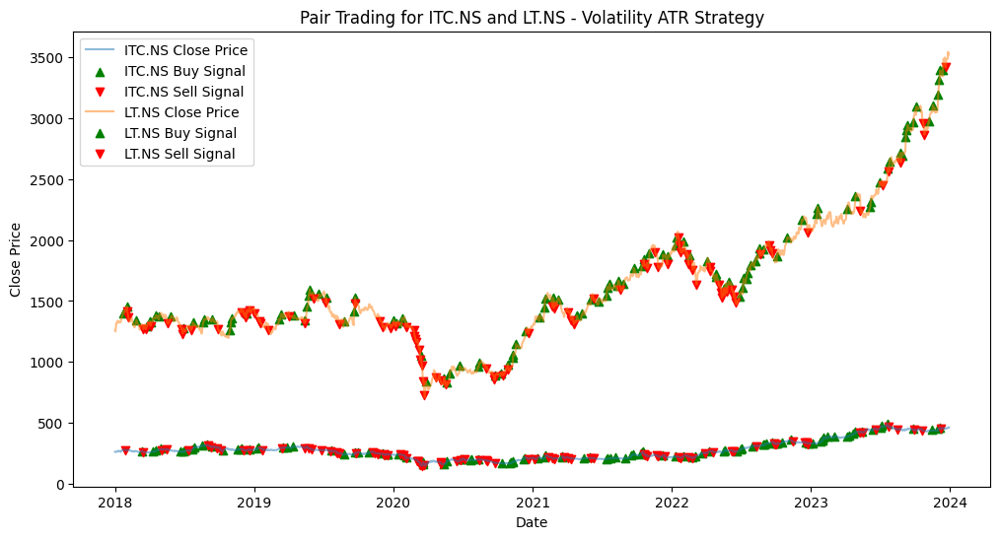

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


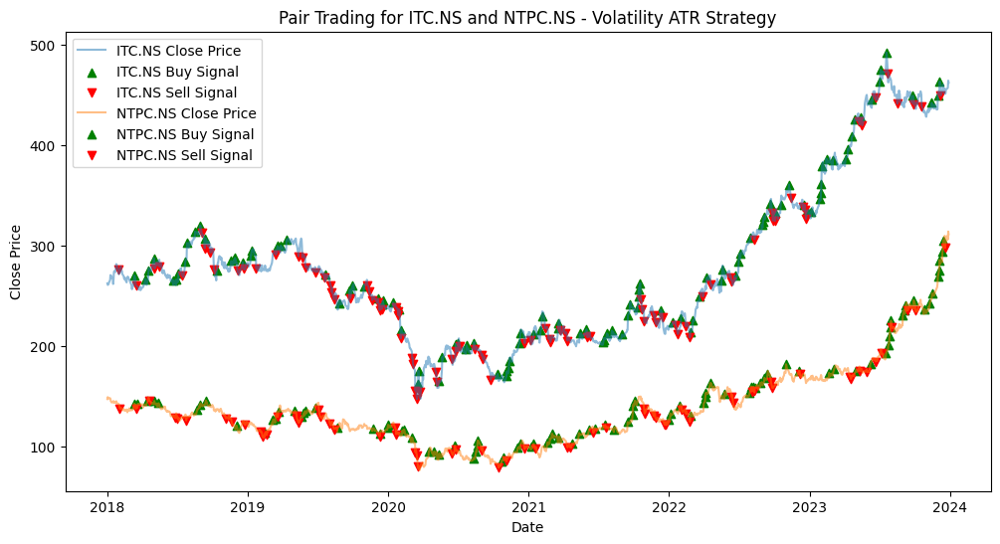

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


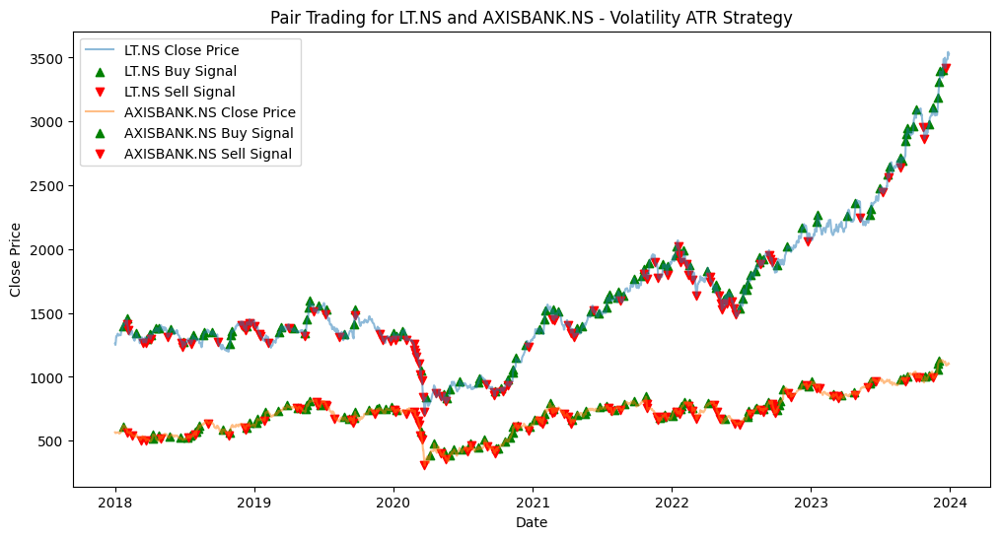

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


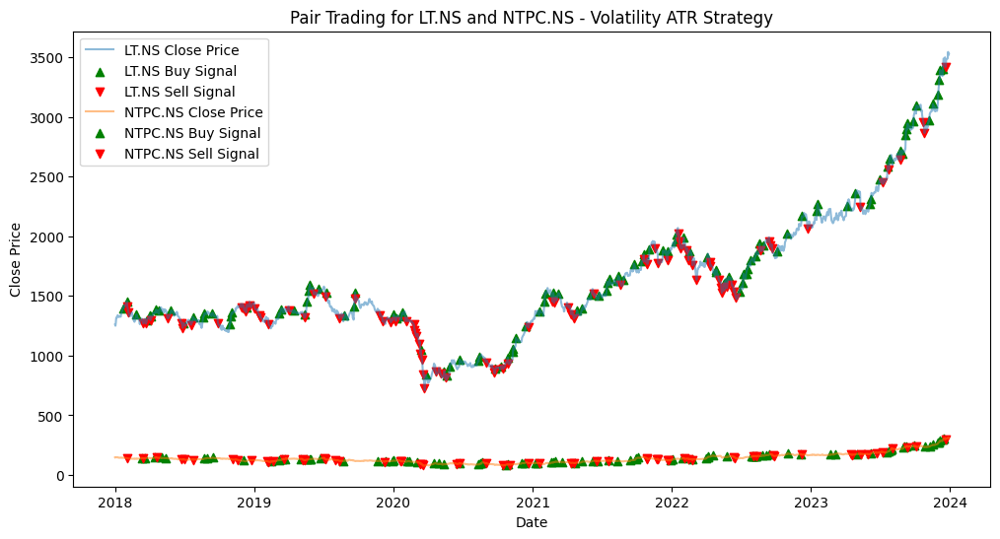

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


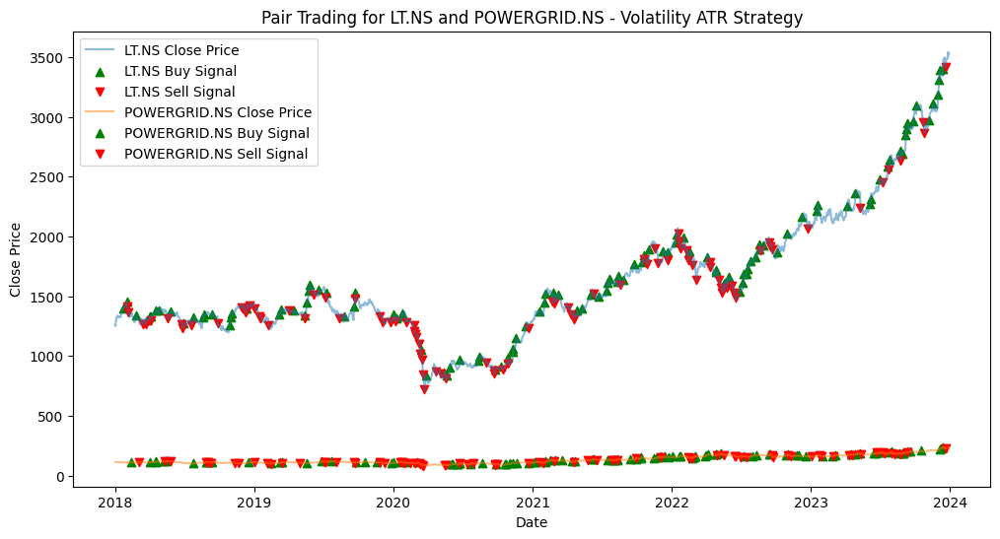

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


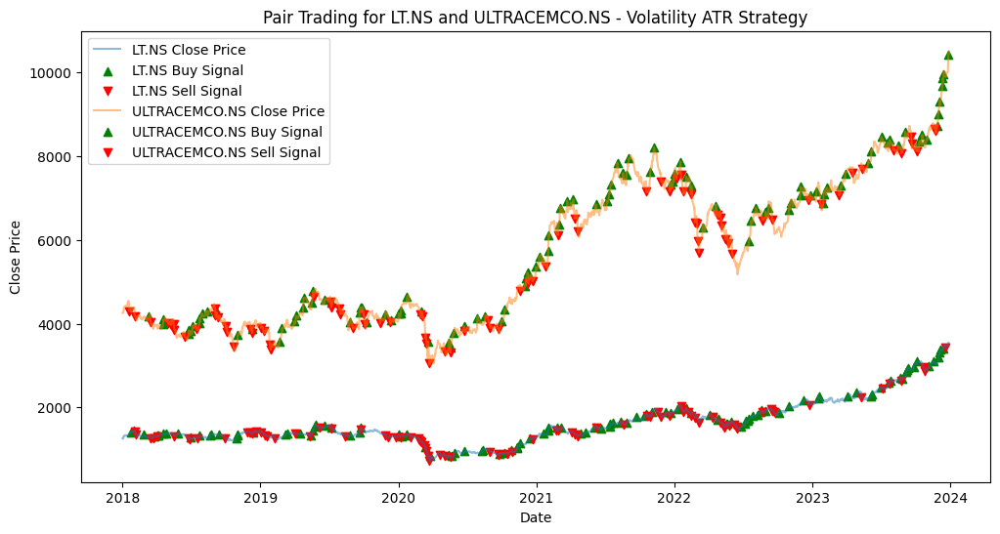

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


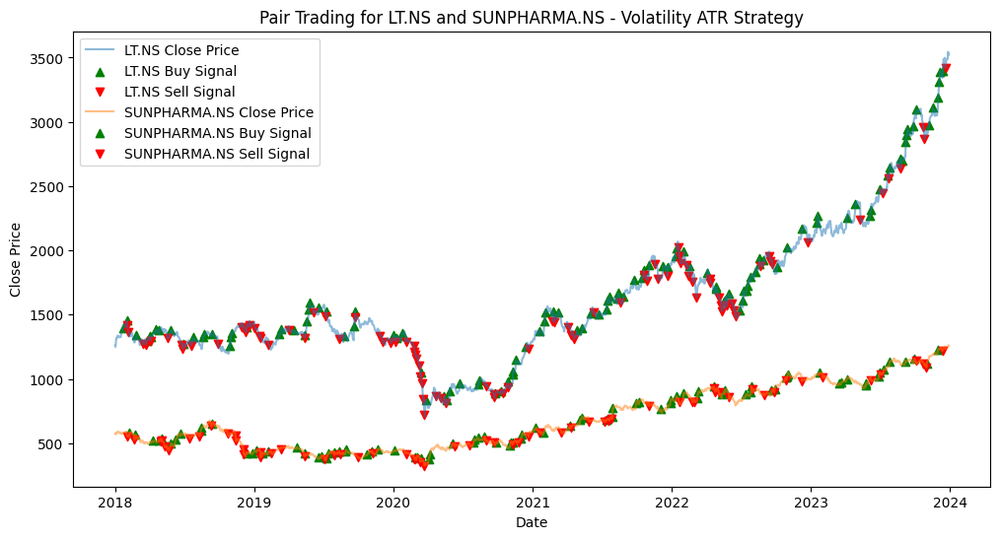

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


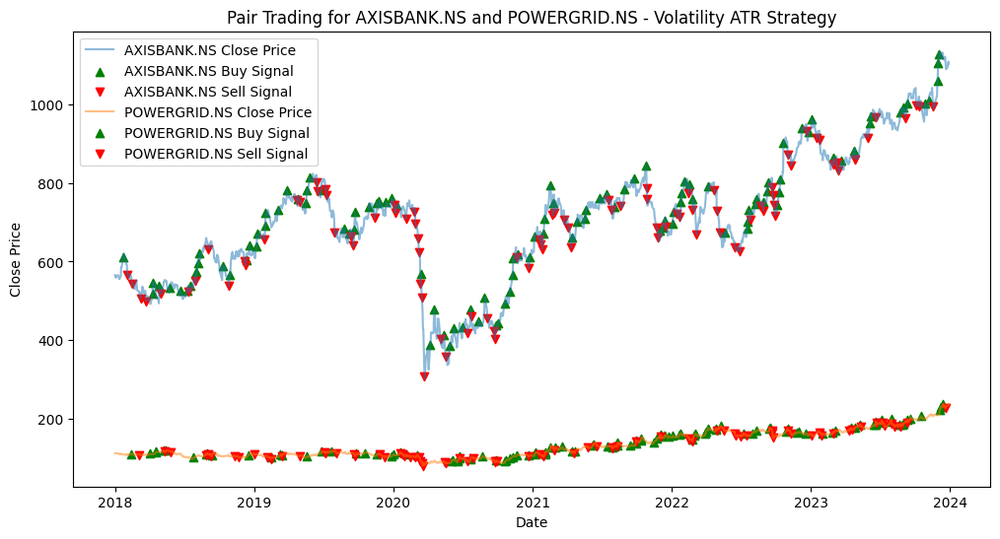

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


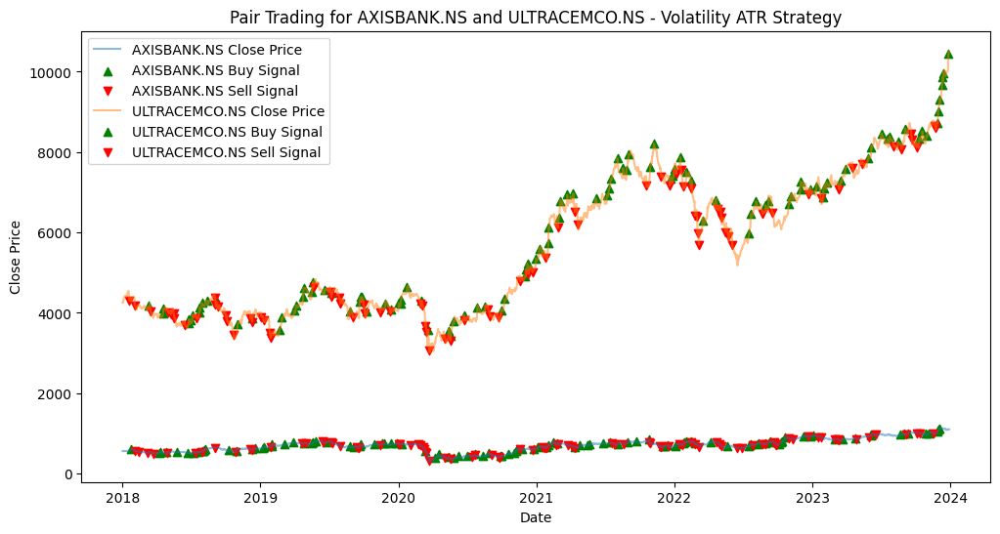

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


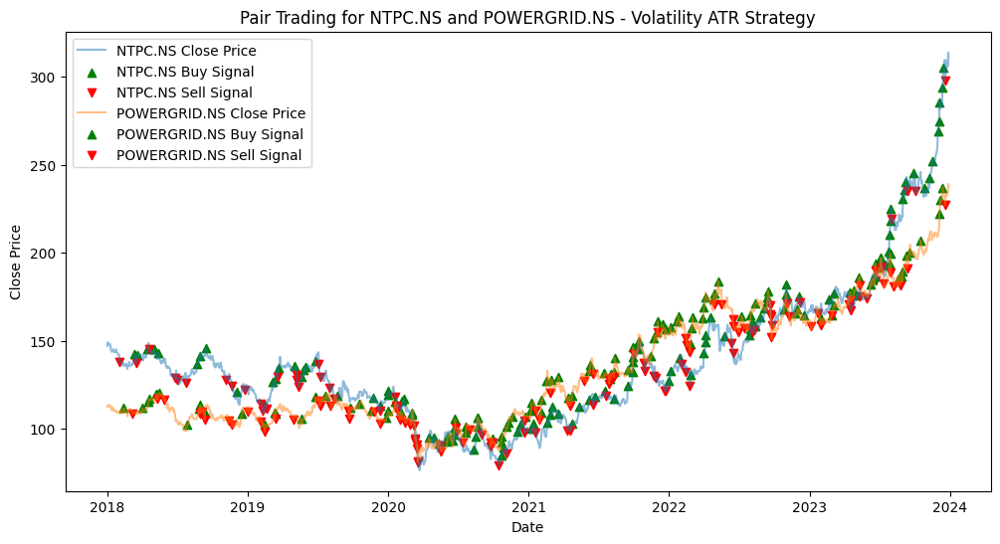

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


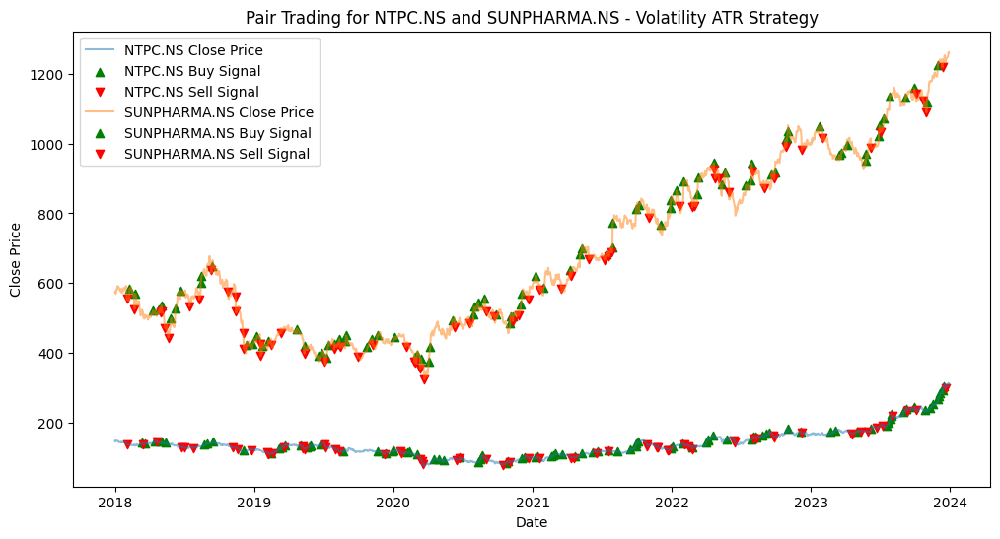

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


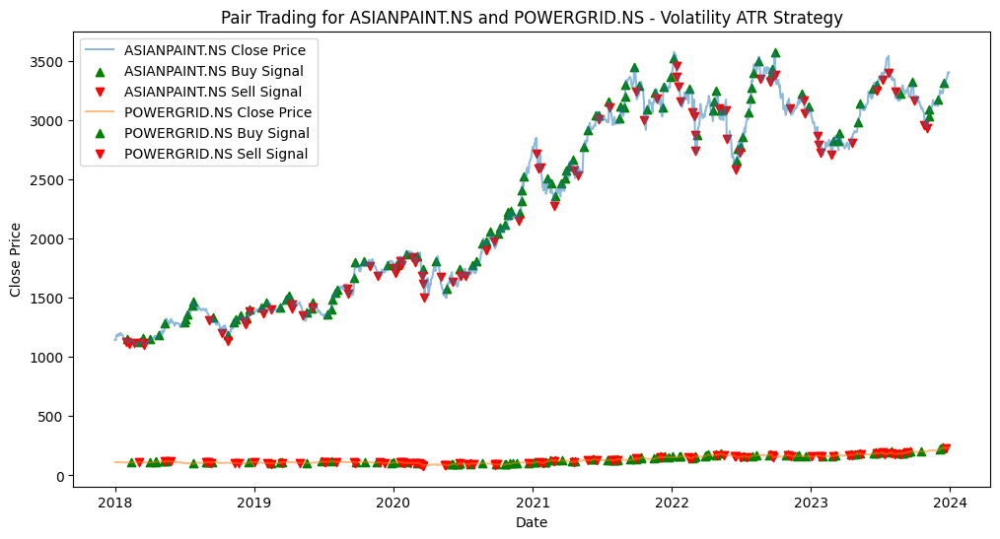

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


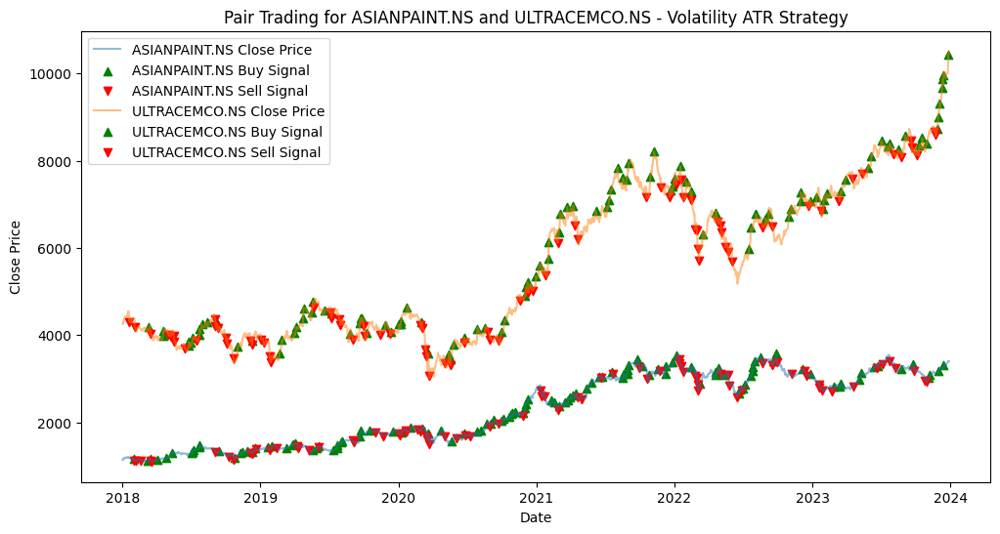

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


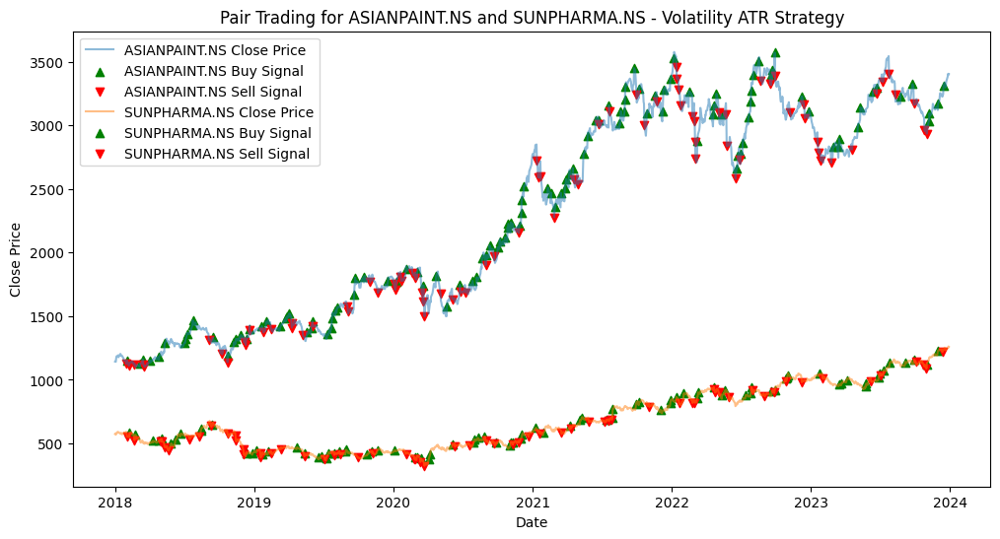

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


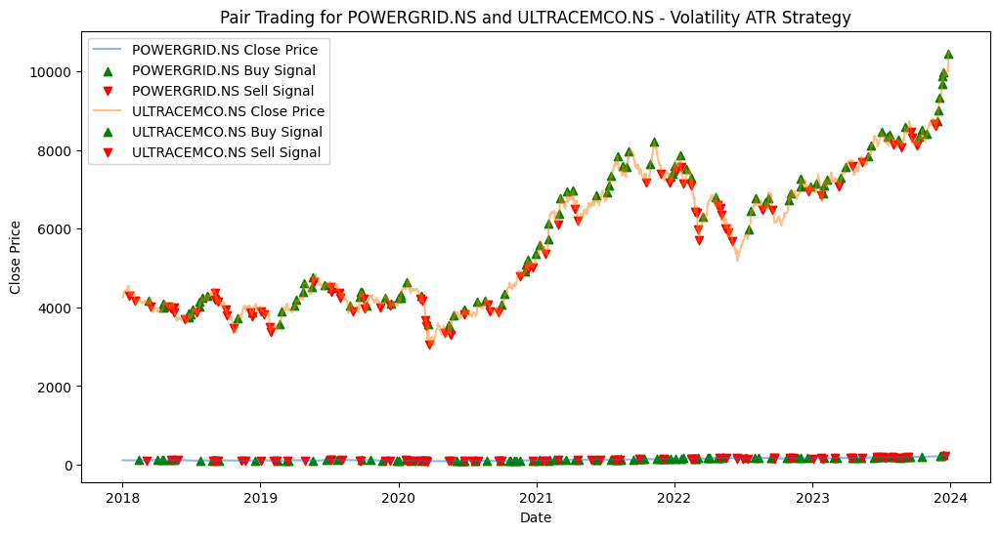

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


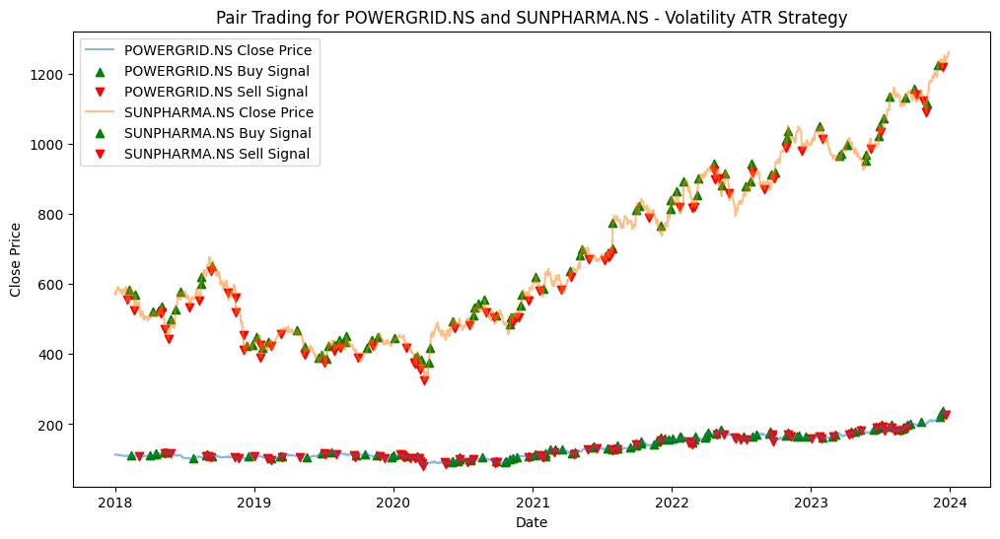

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


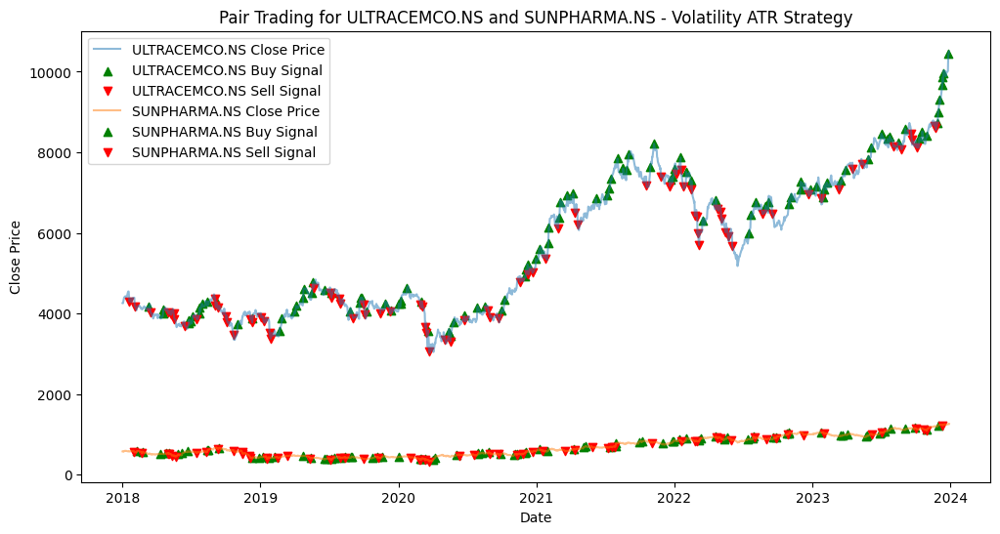

In [1]:
import yfinance as yf
import pandas as pd
import matplotlib.pyplot as plt

# List of top 20 NSE stocks
top_20_stocks = ['RELIANCE.NS', 'TCS.NS', 'HDFCBANK.NS', 'HINDUNILVR.NS', 'INFY.NS',
                 'HCLTECH.NS', 'ICICIBANK.NS', 'KOTAKBANK.NS', 'SBIN.NS', 'BHARTIARTL.NS',
                 'ITC.NS', 'LT.NS', 'AXISBANK.NS', 'MARUTI.NS', 'NTPC.NS', 'ASIANPAINT.NS',
                 'POWERGRID.NS', 'ONGC.NS', 'ULTRACEMCO.NS', 'SUNPHARMA.NS']

# Dictionary to store buy/sell signals for each stock
signals = {}

# Function to calculate correlation matrix
def calculate_correlation_matrix(stocks, start_date, end_date):
    data = {}
    for stock_symbol in stocks:
        data[stock_symbol] = yf.download(stock_symbol, start=start_date, end=end_date)['Close']
    df = pd.DataFrame(data)
    return df.corr()

# Calculate correlation matrix
correlation_matrix = calculate_correlation_matrix(top_20_stocks, "2018-01-01", "2023-12-31")

# Select pairs with high positive correlation
pairs = []
for i in range(len(top_20_stocks)):
    for j in range(i+1, len(top_20_stocks)):
        if correlation_matrix.iloc[i, j] > 0.8:  # Adjust correlation threshold as needed
            pairs.append((top_20_stocks[i], top_20_stocks[j]))

# Loop through each pair
for pair in pairs:
    pair_data = {}
    for stock_symbol in pair:
        # Retrieve historical data
        data = yf.download(stock_symbol, start="2018-01-01", end="2023-12-31")

        # Calculate ATR
        data['ATR'] = data['High'] - data['Low']
        data['ATR'] = data['ATR'].rolling(window=14).mean()

        # Define buy/sell signals
        data['Buy_Signal'] = data['Close'] > data['Close'].shift(1) + data['ATR'].shift(1)
        data['Sell_Signal'] = data['Close'] < data['Close'].shift(1) - data['ATR'].shift(1)

        # Store signals
        pair_data[stock_symbol] = data[['Close', 'Buy_Signal', 'Sell_Signal']]

    # Plot
    plt.figure(figsize=(12,6))
    for stock_symbol, data in pair_data.items():
        plt.plot(data['Close'], label=f'{stock_symbol} Close Price', alpha=0.5)
        plt.scatter(data.index[data['Buy_Signal']], data['Close'][data['Buy_Signal']], label=f'{stock_symbol} Buy Signal', marker='^', color='green')
        plt.scatter(data.index[data['Sell_Signal']], data['Close'][data['Sell_Signal']], label=f'{stock_symbol} Sell Signal', marker='v', color='red')
    plt.title(f'Pair Trading for {pair[0]} and {pair[1]} - Volatility ATR Strategy')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.show()


[*********************100%%**********************]  1 of 1 completed


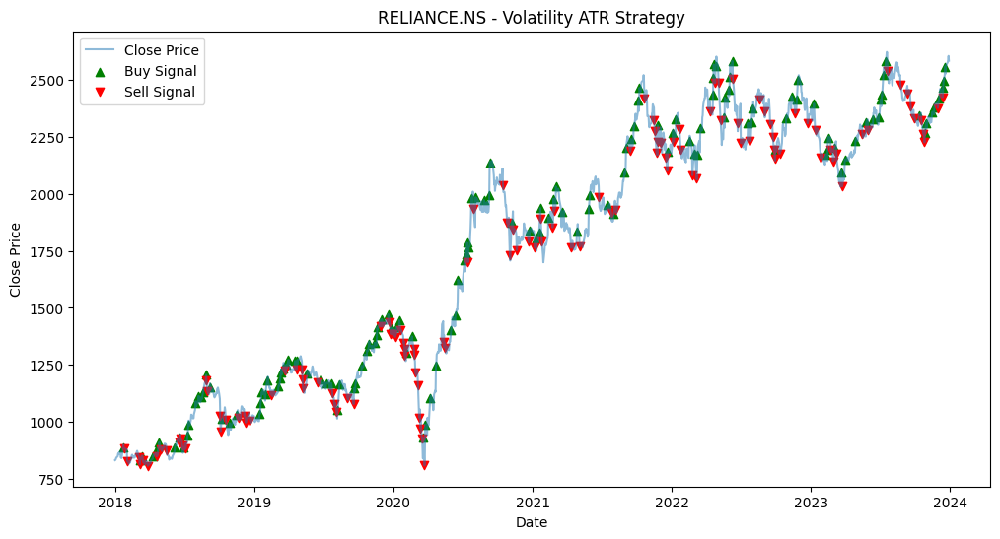

[*********************100%%**********************]  1 of 1 completed


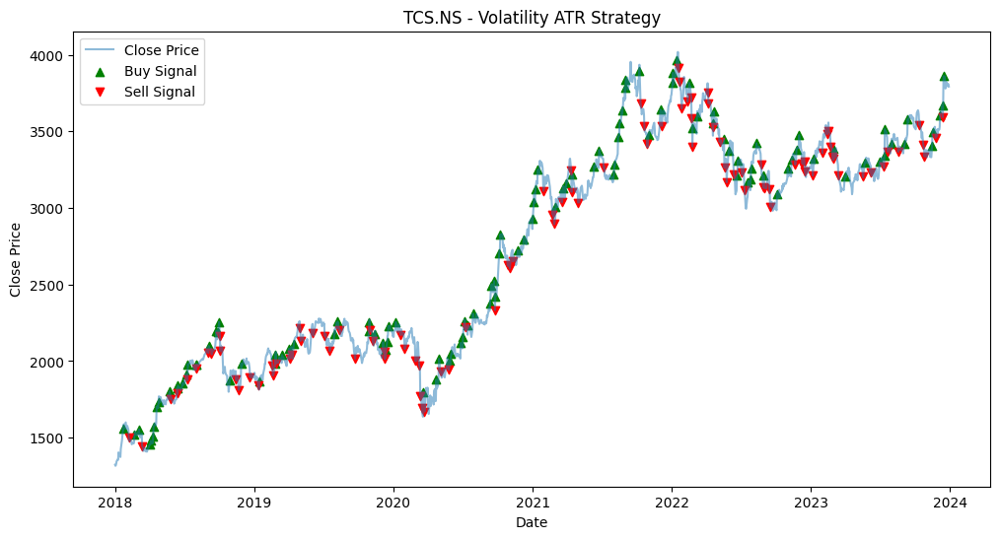

[*********************100%%**********************]  1 of 1 completed


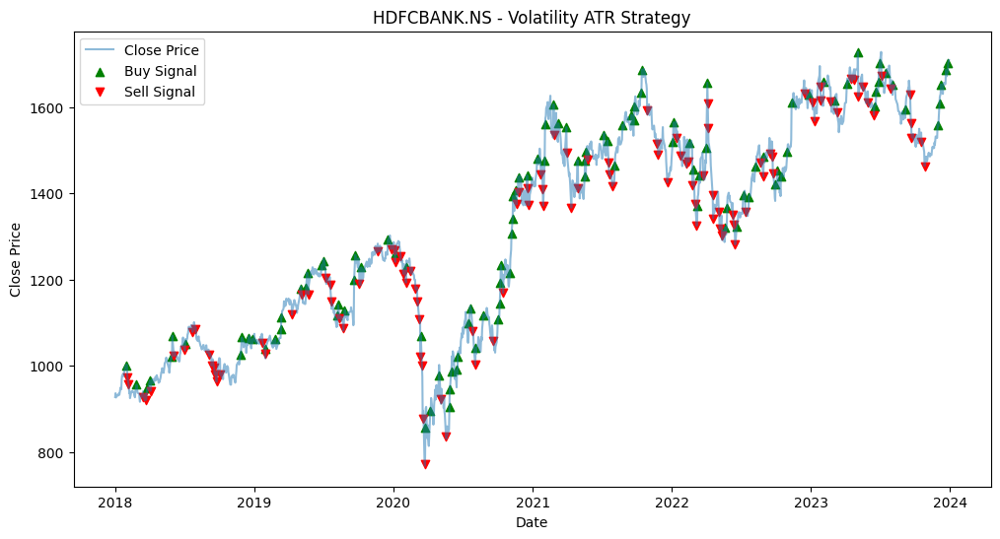

[*********************100%%**********************]  1 of 1 completed


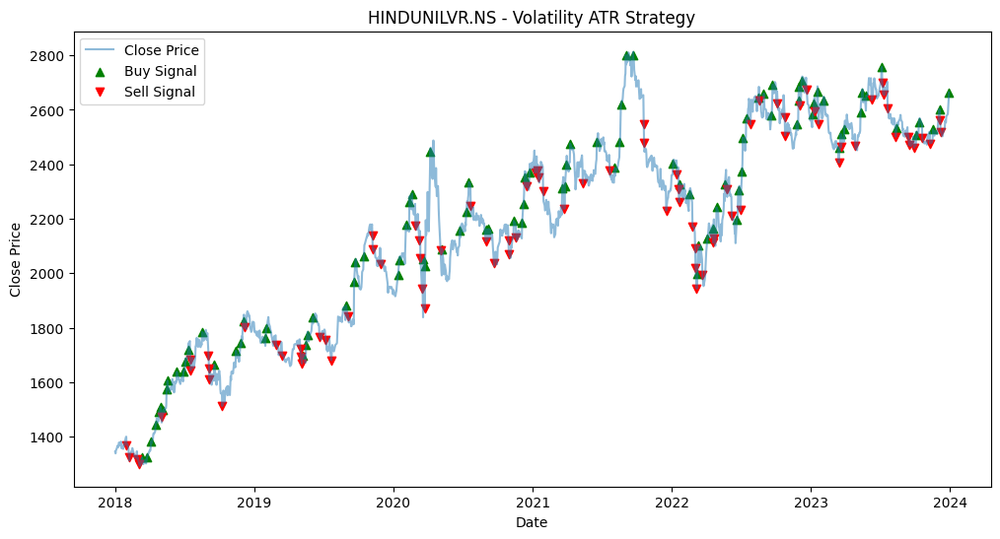

[*********************100%%**********************]  1 of 1 completed


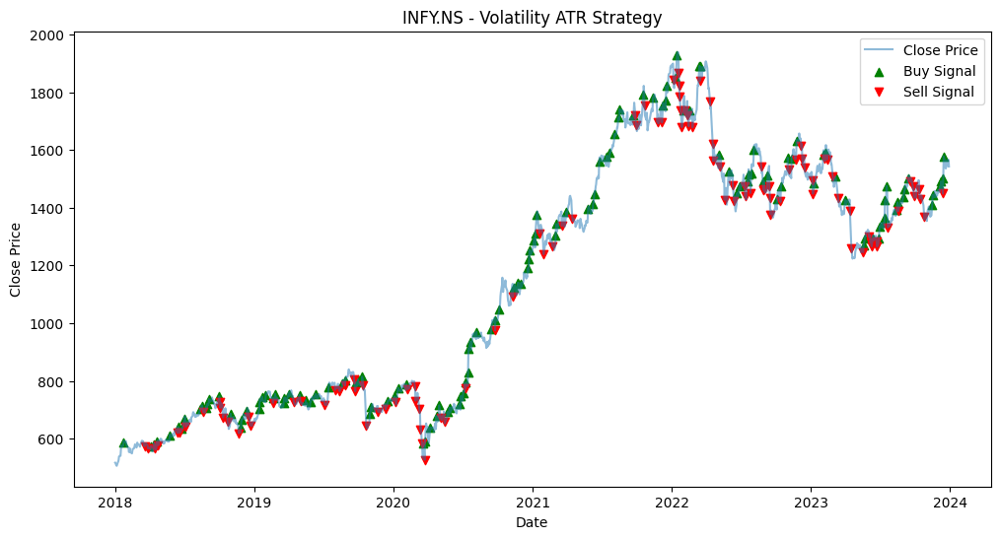

[*********************100%%**********************]  1 of 1 completed


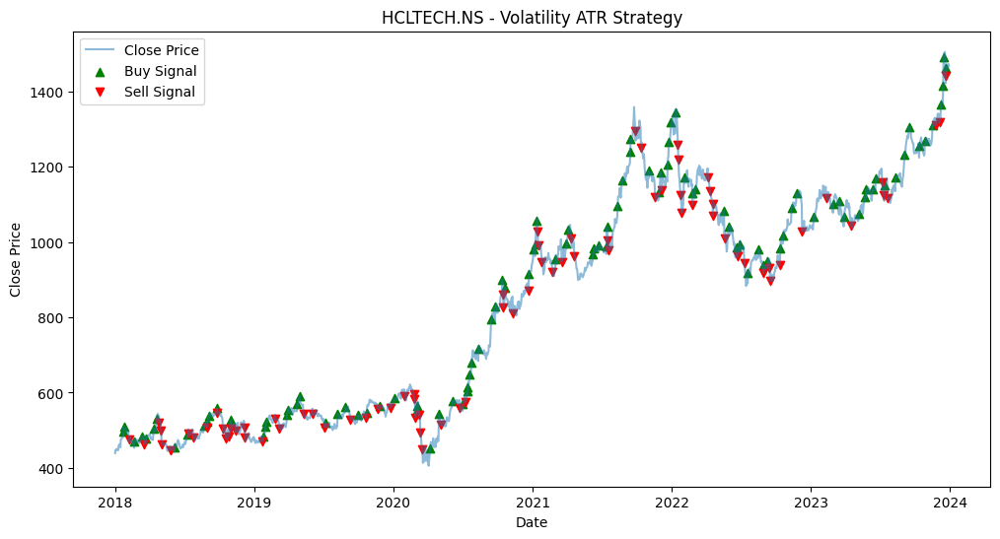

[*********************100%%**********************]  1 of 1 completed


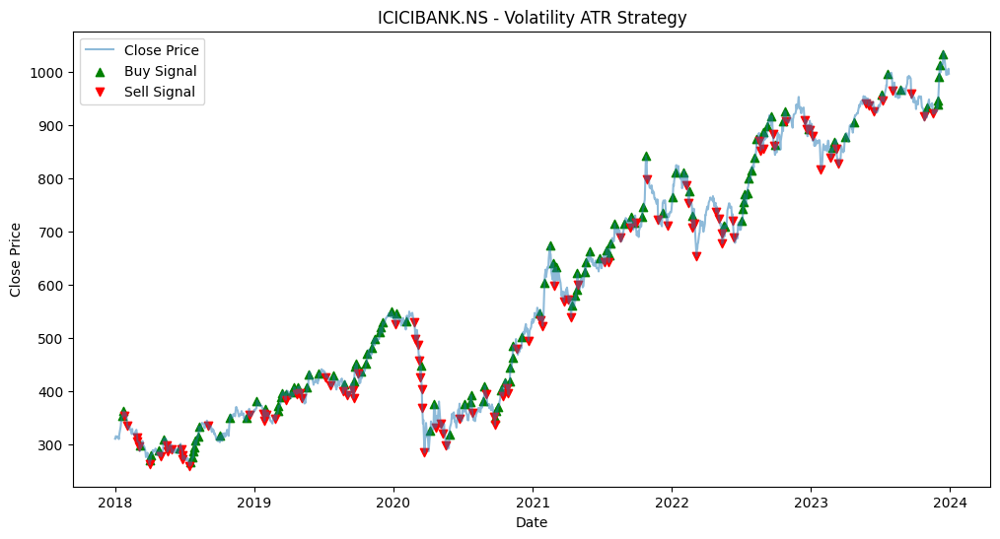

[*********************100%%**********************]  1 of 1 completed


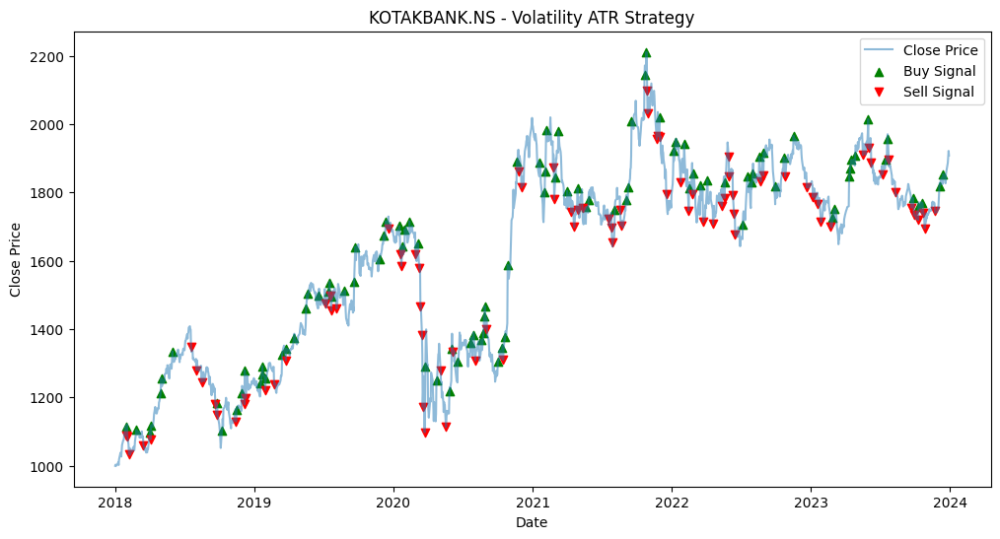

[*********************100%%**********************]  1 of 1 completed


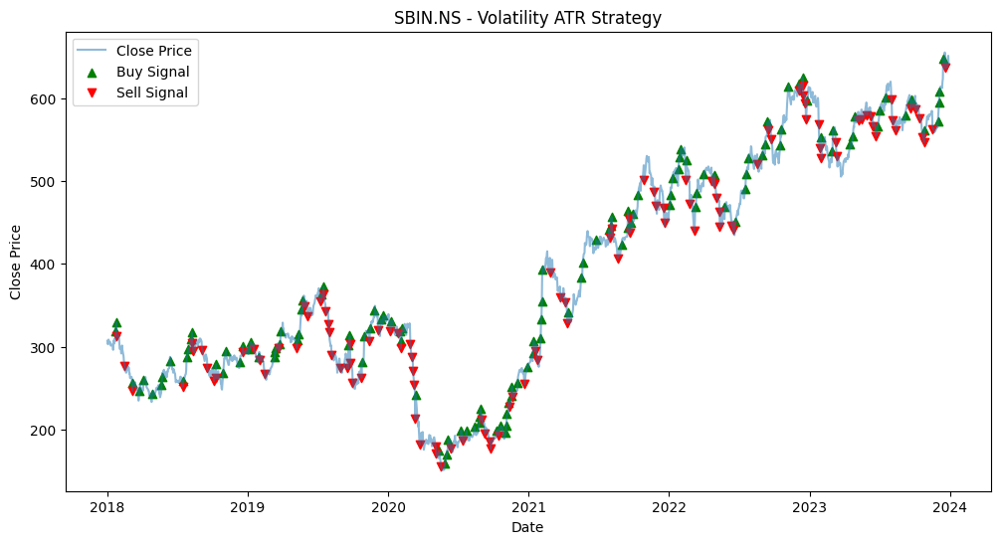

[*********************100%%**********************]  1 of 1 completed


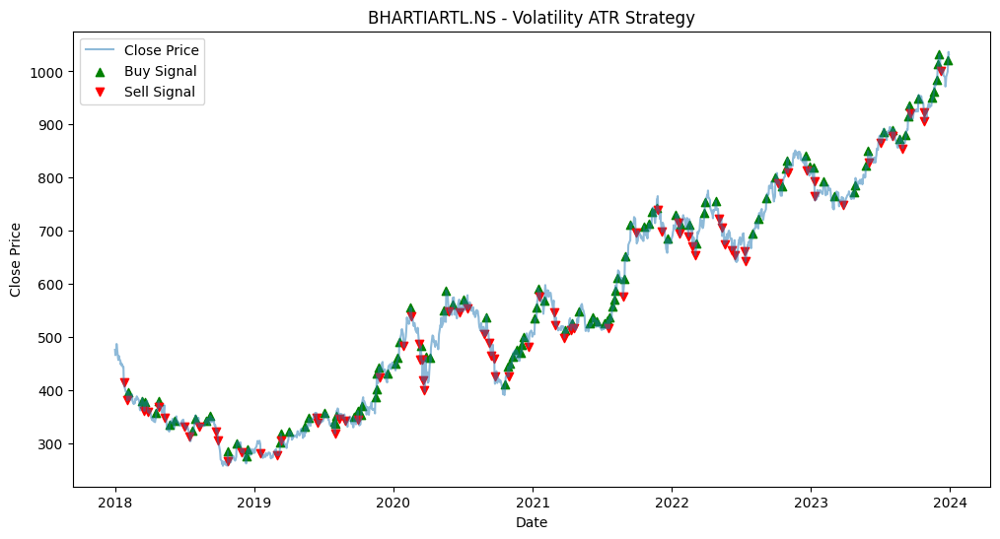

[*********************100%%**********************]  1 of 1 completed


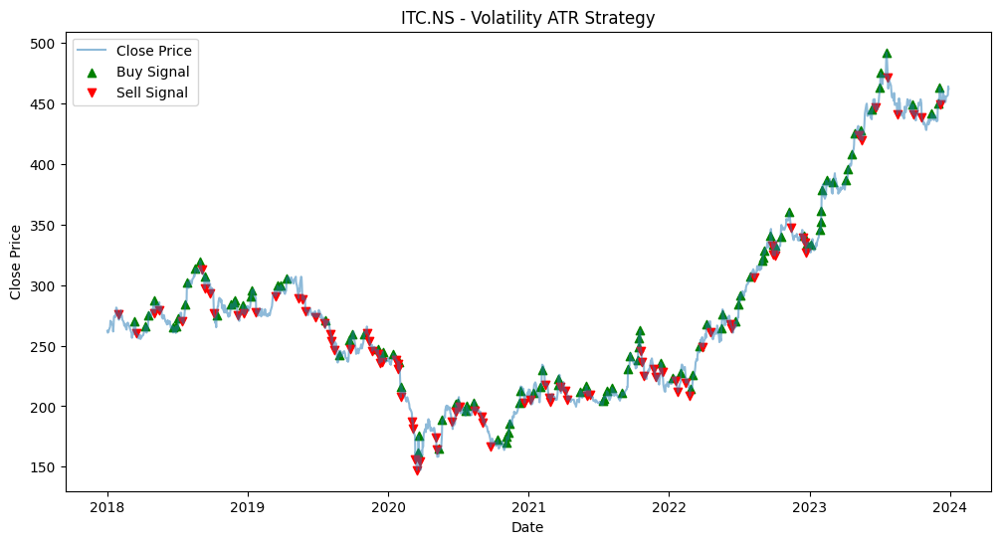

[*********************100%%**********************]  1 of 1 completed


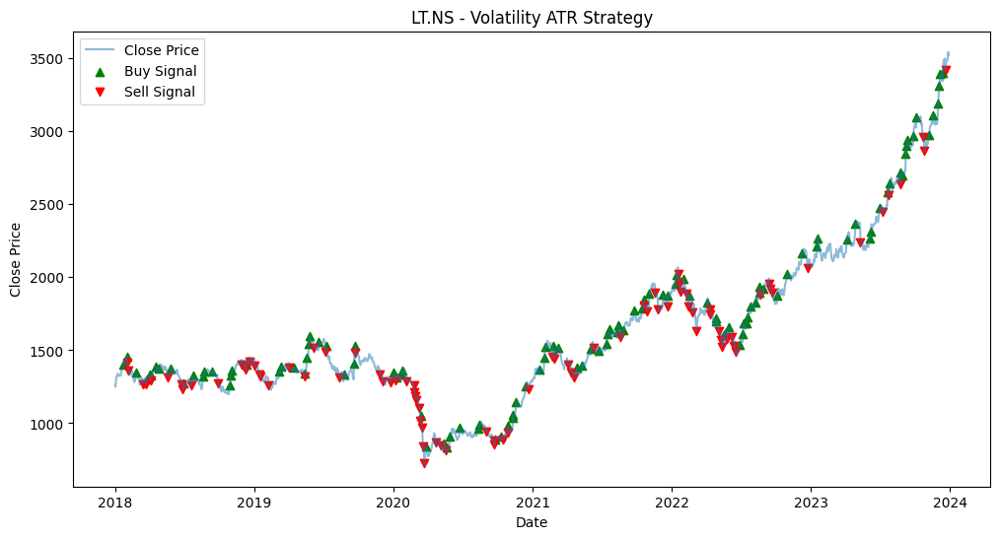

[*********************100%%**********************]  1 of 1 completed


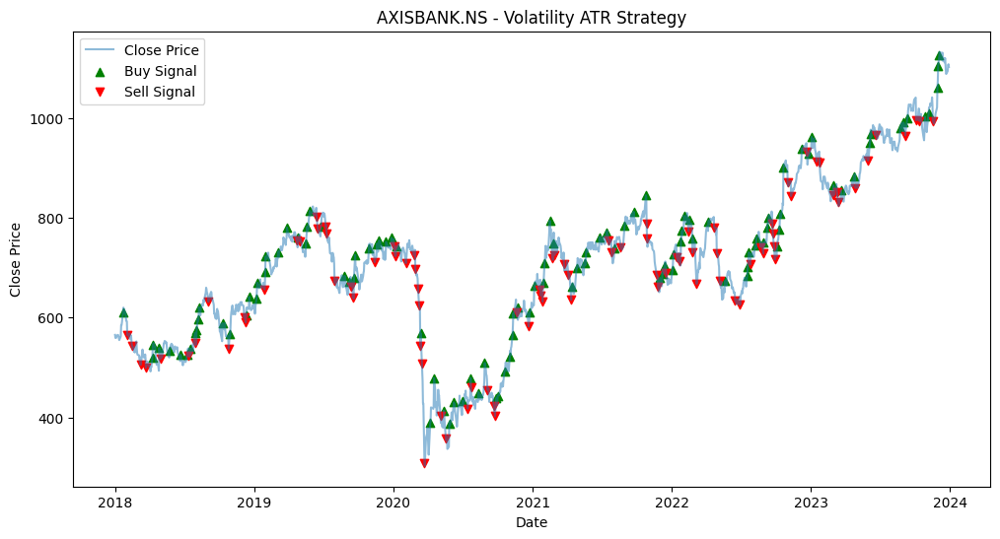

[*********************100%%**********************]  1 of 1 completed


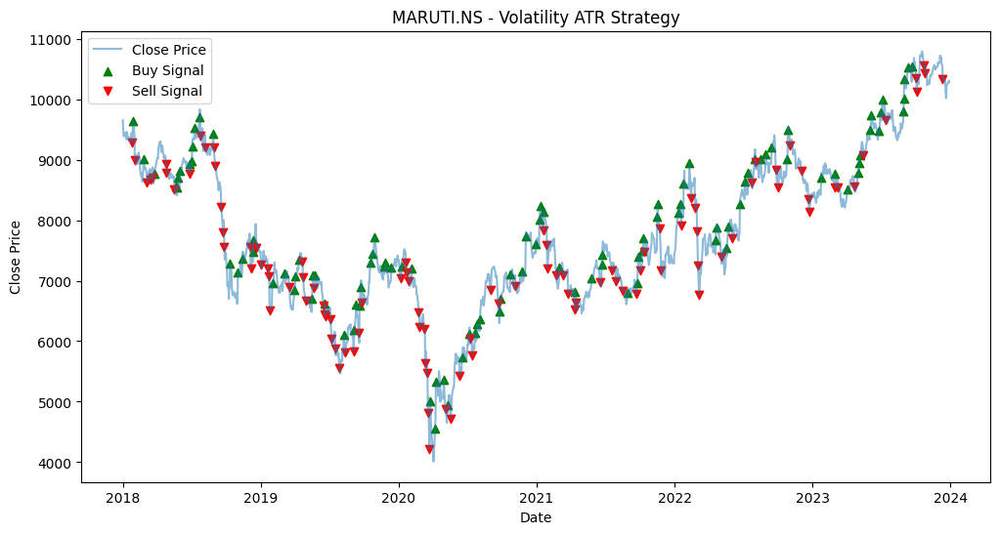

[*********************100%%**********************]  1 of 1 completed


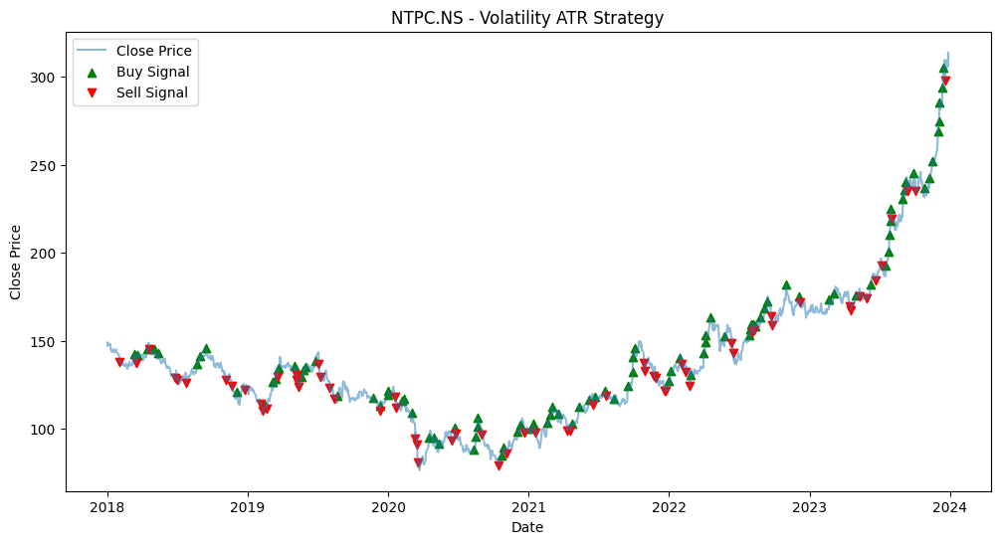

[*********************100%%**********************]  1 of 1 completed


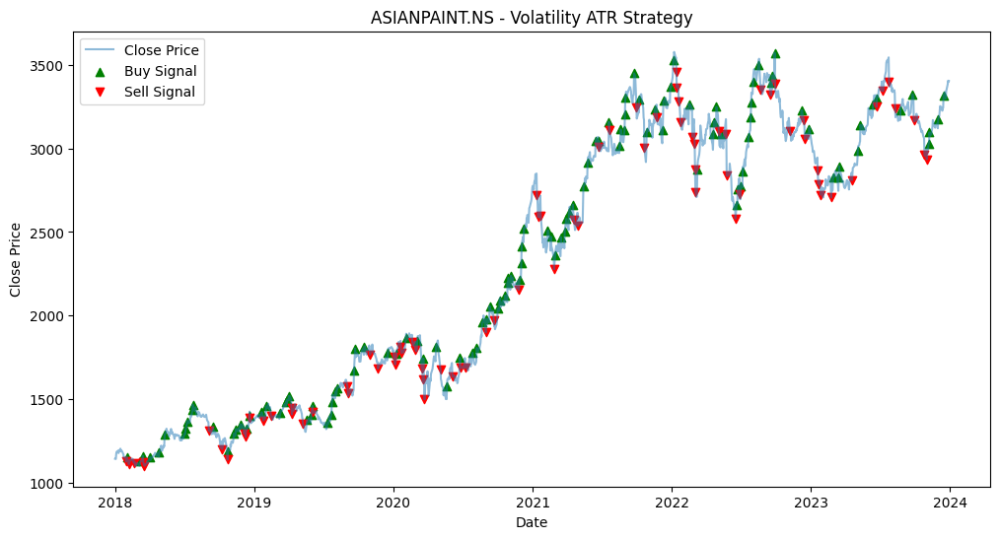

[*********************100%%**********************]  1 of 1 completed


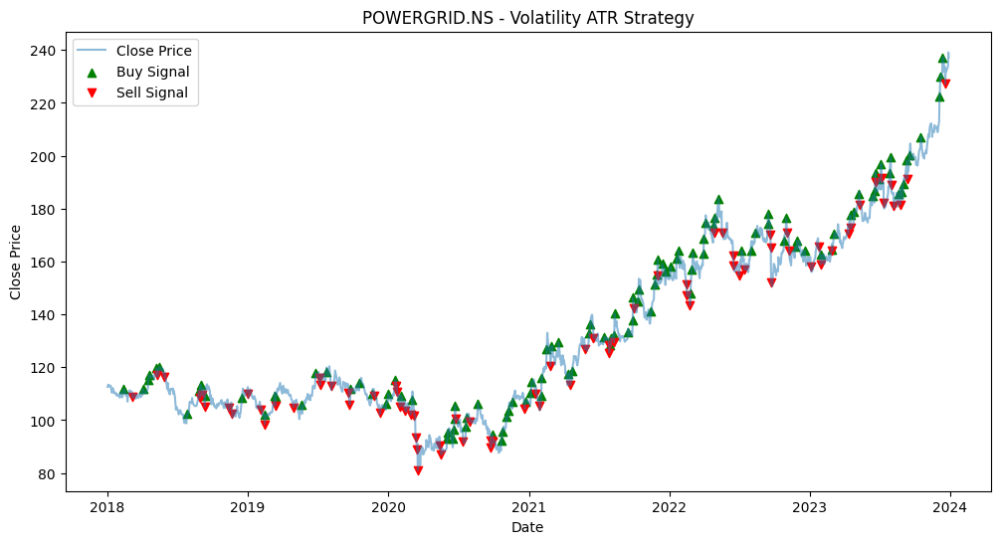

[*********************100%%**********************]  1 of 1 completed


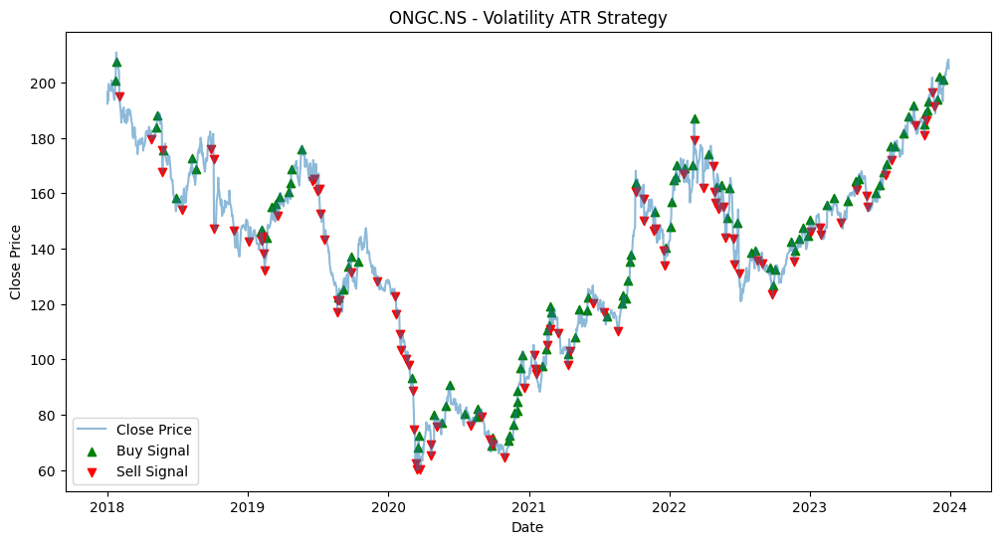

[*********************100%%**********************]  1 of 1 completed


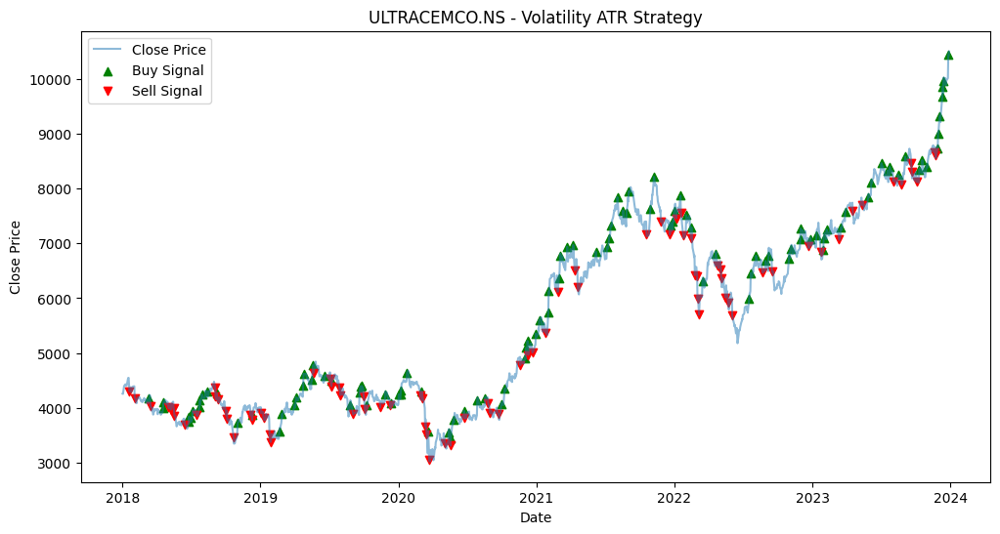

[*********************100%%**********************]  1 of 1 completed


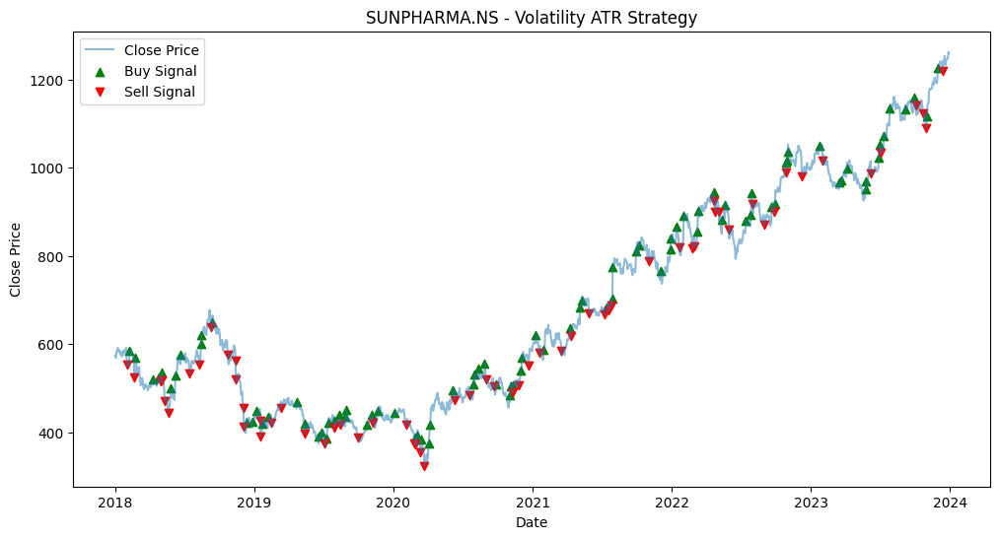

In [10]:
import yfinance as yf
import pandas as pd
import matplotlib.pyplot as plt

# List of top 20 NSE stocks
top_20_stocks = ['RELIANCE.NS', 'TCS.NS', 'HDFCBANK.NS', 'HINDUNILVR.NS', 'INFY.NS',
                 'HCLTECH.NS', 'ICICIBANK.NS', 'KOTAKBANK.NS', 'SBIN.NS', 'BHARTIARTL.NS',
                 'ITC.NS', 'LT.NS', 'AXISBANK.NS', 'MARUTI.NS', 'NTPC.NS', 'ASIANPAINT.NS',
                 'POWERGRID.NS', 'ONGC.NS', 'ULTRACEMCO.NS', 'SUNPHARMA.NS']

# Dictionary to store buy/sell signals for each stock
signals = {}

# Loop through each stock
for stock_symbol in top_20_stocks:
    # Retrieve historical data
    data = yf.download(stock_symbol, start="2018-01-01", end="2023-12-31")

    # Calculate ATR
    data['ATR'] = data['High'] - data['Low']
    data['ATR'] = data['ATR'].rolling(window=14).mean()

    # Define buy/sell signals
    data['Buy_Signal'] = data['Close'] > data['Close'].shift(1) + data['ATR'].shift(1)
    data['Sell_Signal'] = data['Close'] < data['Close'].shift(1) - data['ATR'].shift(1)

    # Store signals
    signals[stock_symbol] = data[['Close', 'Buy_Signal', 'Sell_Signal']]

    # Plot
    plt.figure(figsize=(12,6))
    plt.plot(data['Close'], label='Close Price', alpha=0.5)
    plt.scatter(data.index[data['Buy_Signal']], data['Close'][data['Buy_Signal']], label='Buy Signal', marker='^', color='green')
    plt.scatter(data.index[data['Sell_Signal']], data['Close'][data['Sell_Signal']], label='Sell Signal', marker='v', color='red')
    plt.title(f'{stock_symbol} - Volatility ATR Strategy')
    plt.xlabel('Date')
    plt.ylabel('Close Price')
    plt.legend()
    plt.show()
import yfinance as yf
import pandas as pd
import matplotlib.pyplot as plt

# List of top 20 NSE stocks
top_20_stocks = ['RELIANCE.NS', 'TCS.NS', 'HDFCBANK.NS', 'HINDUNILVR.NS', 'INFY.NS',
                 'HCLTECH.NS', 'ICICIBANK.NS', 'KOTAKBANK.NS', 'SBIN.NS', 'BHARTIARTL.NS',
                 'ITC.NS', 'LT.NS', 'AXISBANK.NS', 'MARUTI.NS', 'NTPC.NS', 'ASIANPAINT.NS',
                 'POWERGRID.NS', 'ONGC.NS', 'ULTRACEMCO.NS', 'SUNPHARMA.NS']

# Initialize portfolio parameters


[*********************100%%**********************]  1 of 1 completed


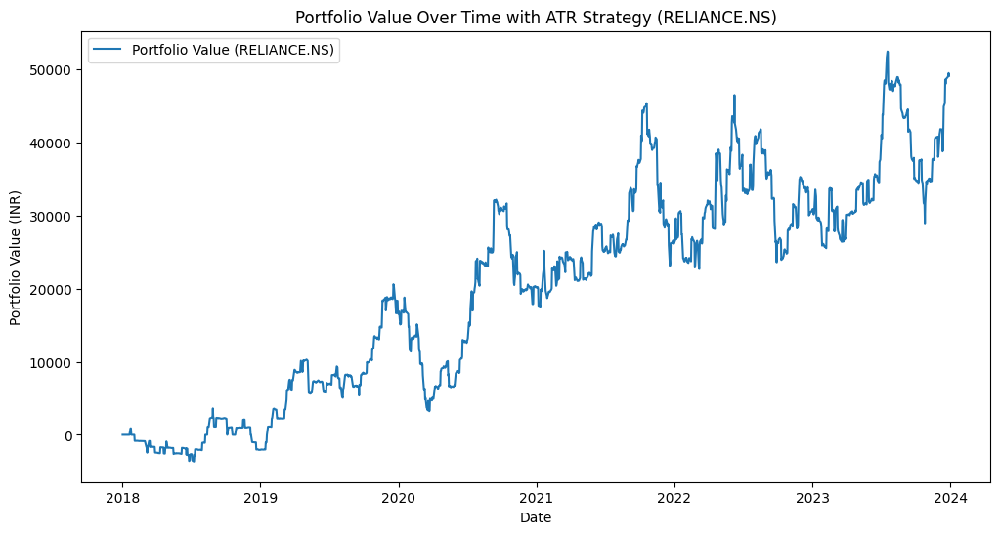

[*********************100%%**********************]  1 of 1 completed


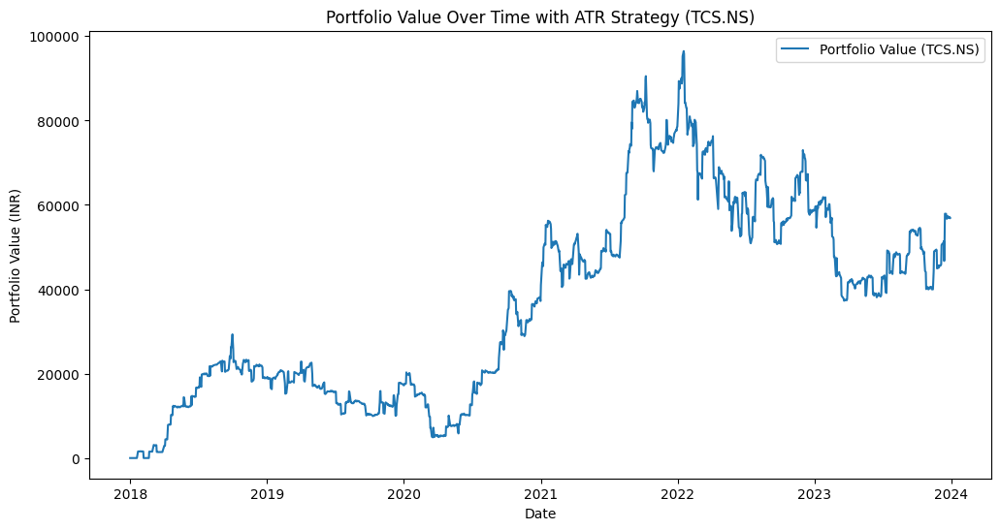

[*********************100%%**********************]  1 of 1 completed


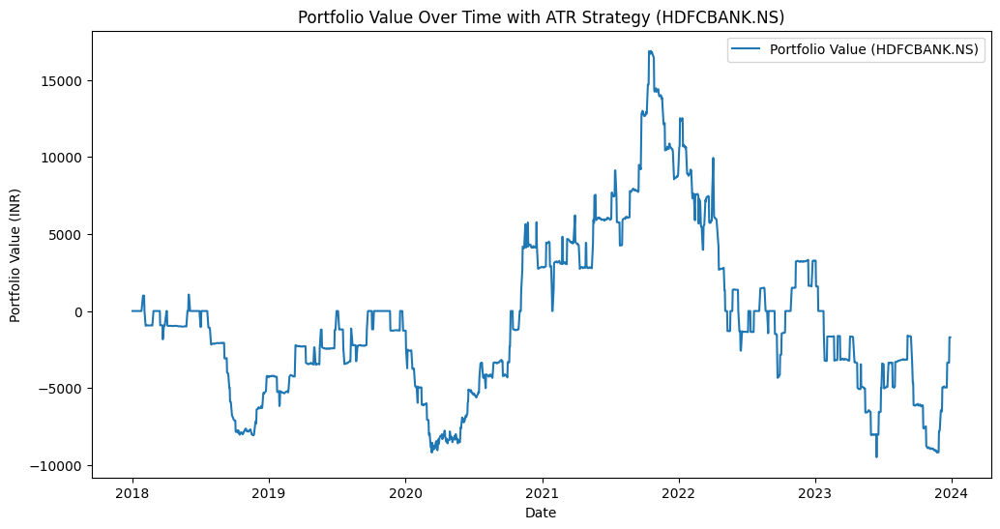

[*********************100%%**********************]  1 of 1 completed


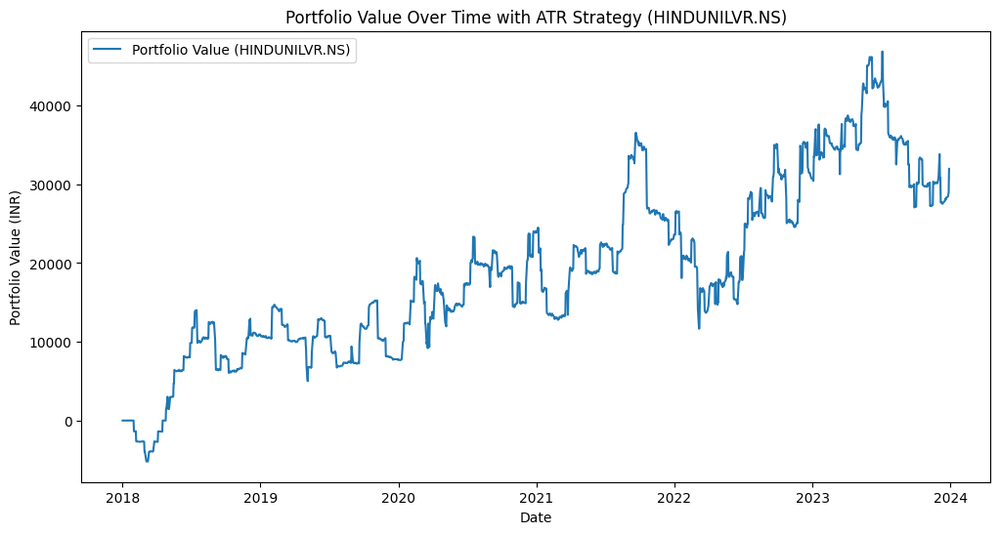

[*********************100%%**********************]  1 of 1 completed


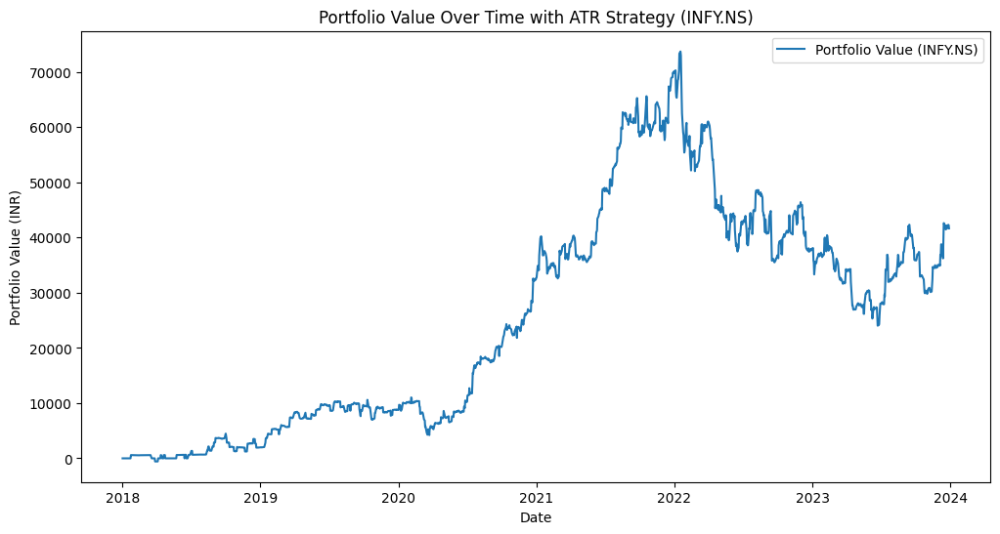

[*********************100%%**********************]  1 of 1 completed


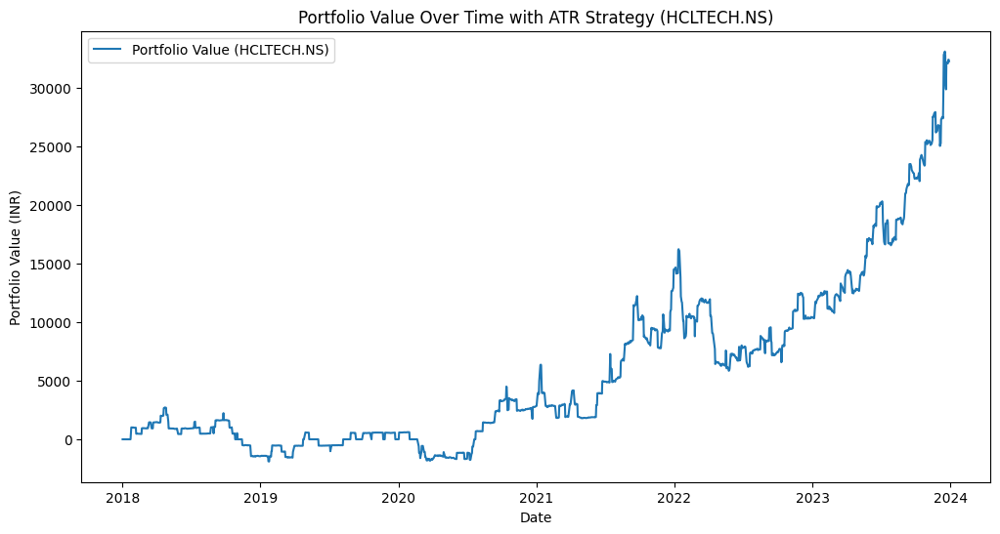

[*********************100%%**********************]  1 of 1 completed


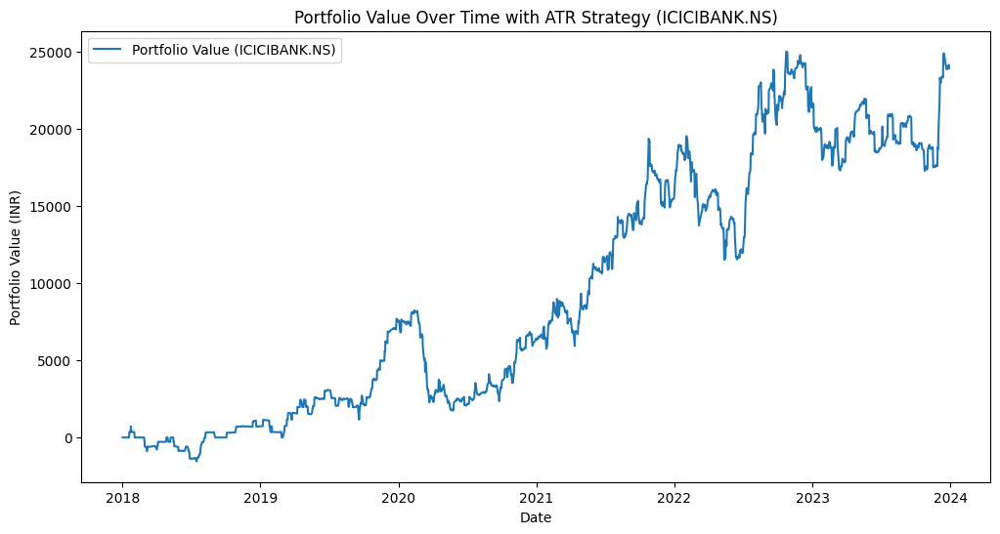

[*********************100%%**********************]  1 of 1 completed


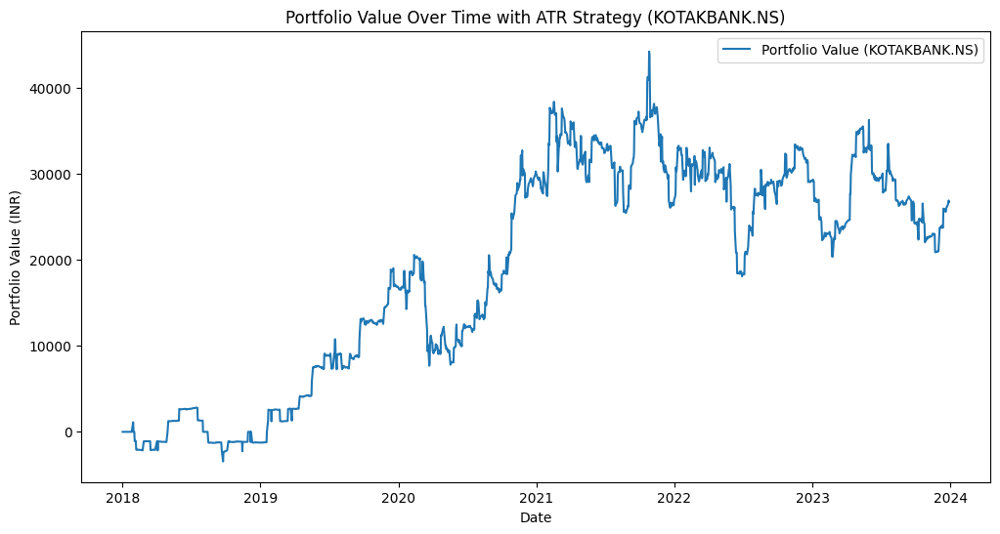

[*********************100%%**********************]  1 of 1 completed


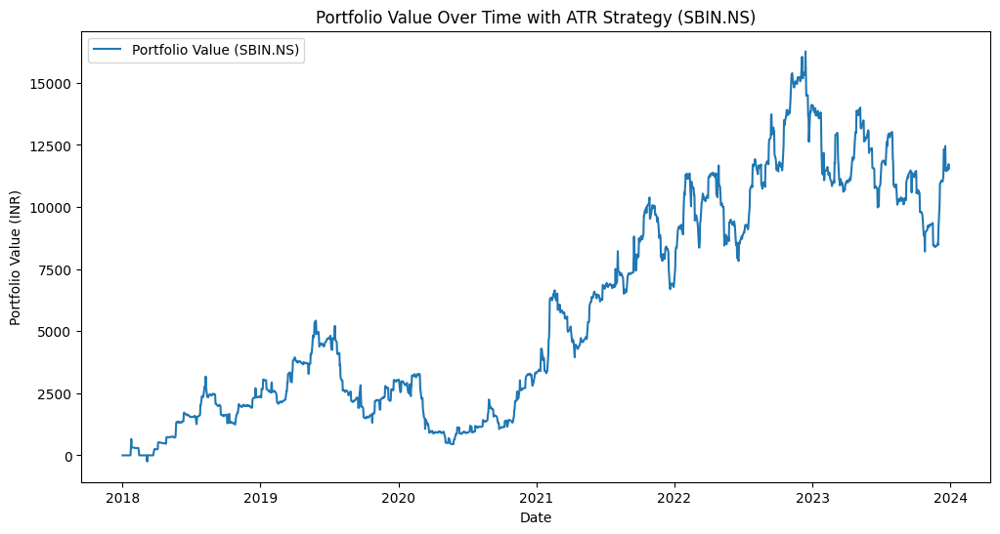

[*********************100%%**********************]  1 of 1 completed


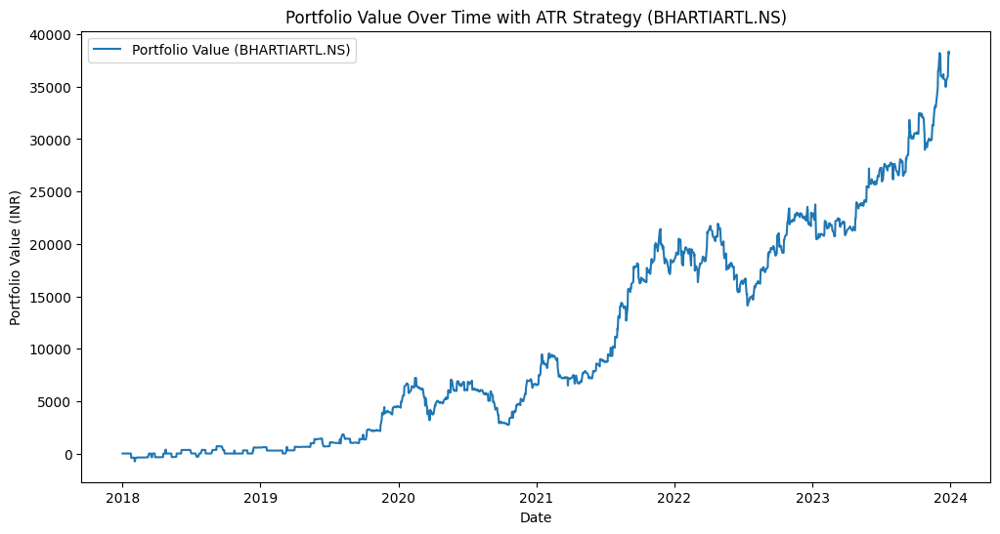

[*********************100%%**********************]  1 of 1 completed


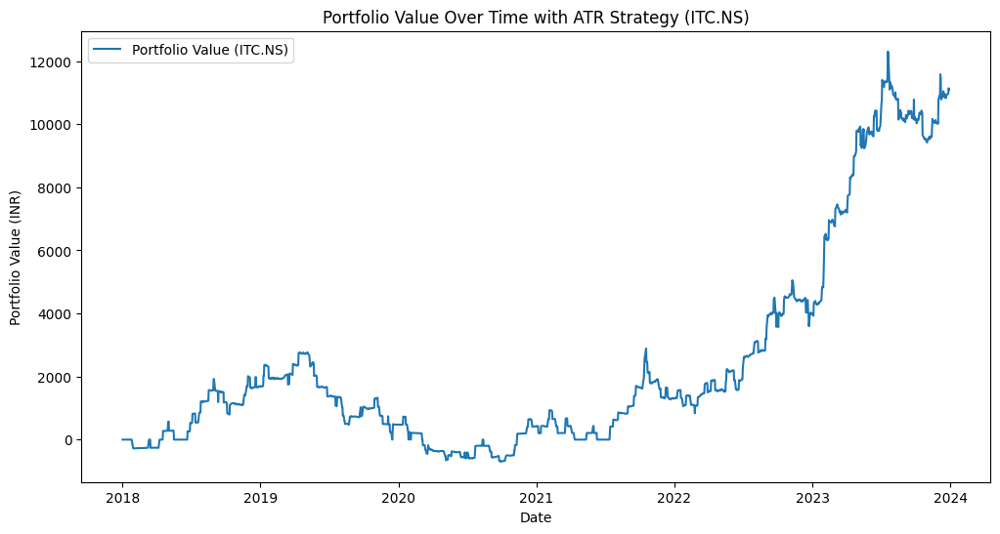

[*********************100%%**********************]  1 of 1 completed


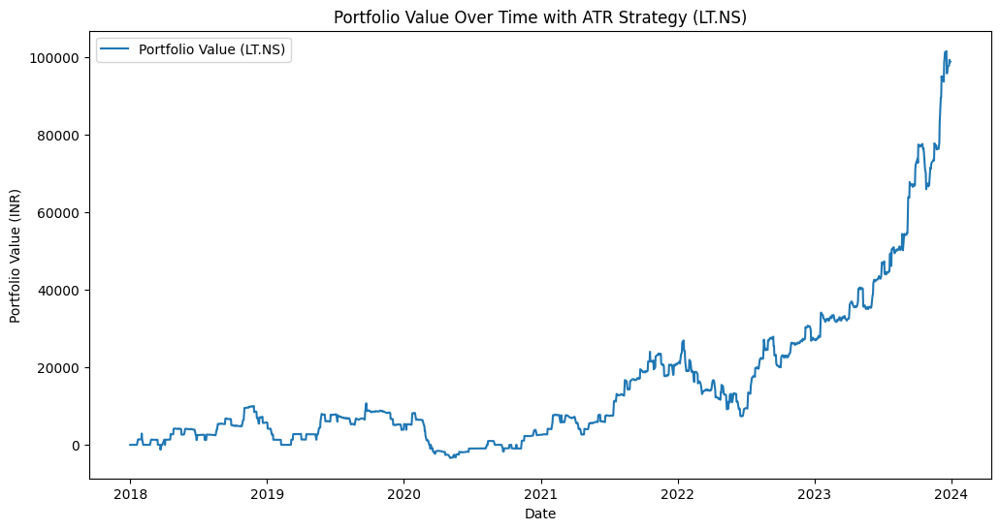

[*********************100%%**********************]  1 of 1 completed


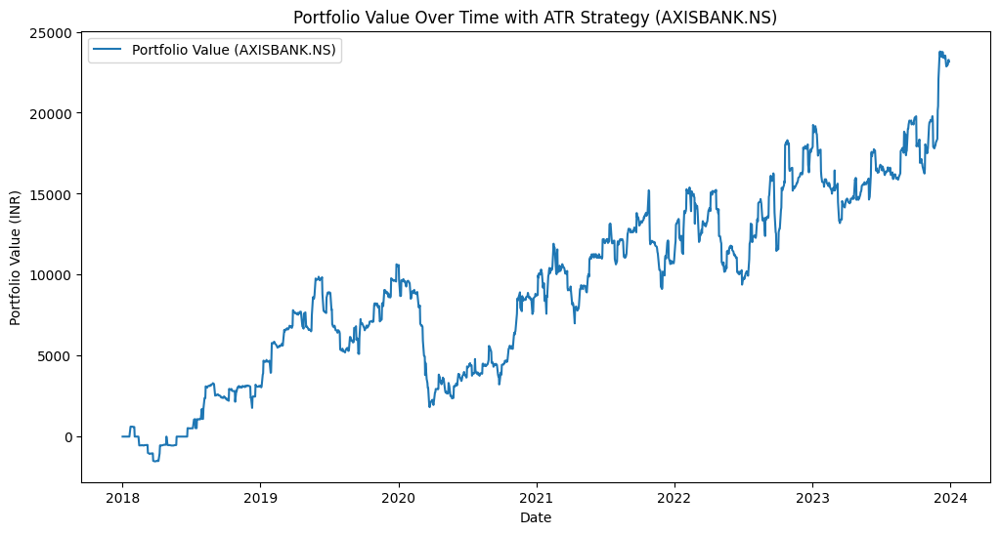

[*********************100%%**********************]  1 of 1 completed


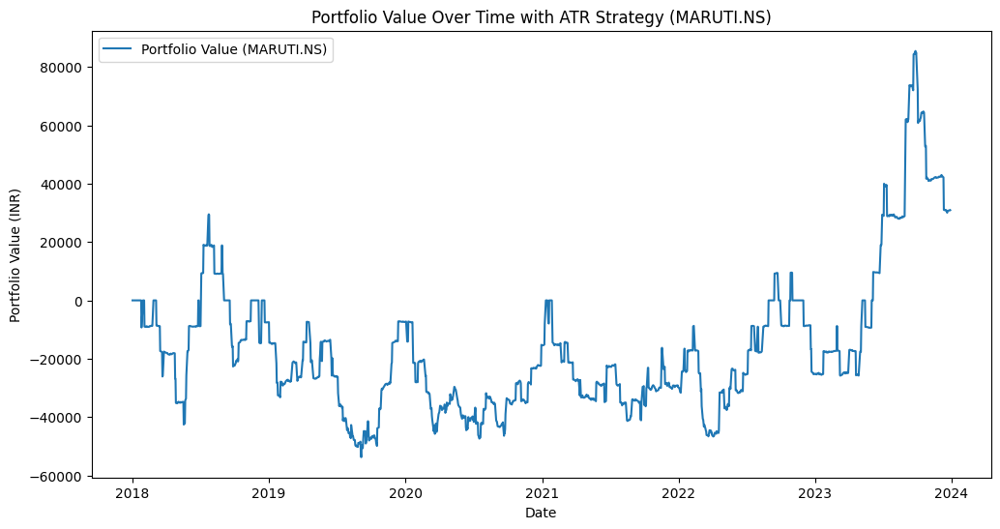

[*********************100%%**********************]  1 of 1 completed


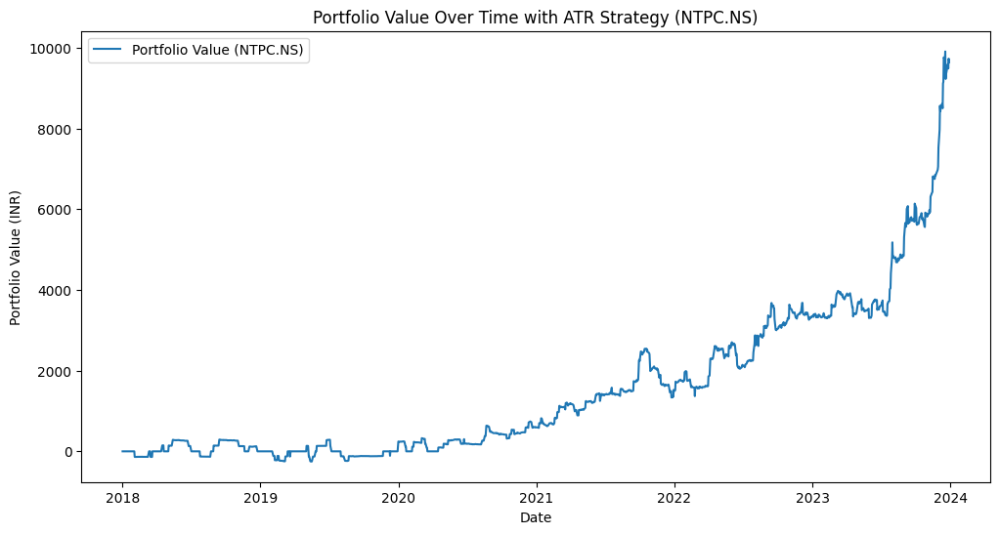

[*********************100%%**********************]  1 of 1 completed


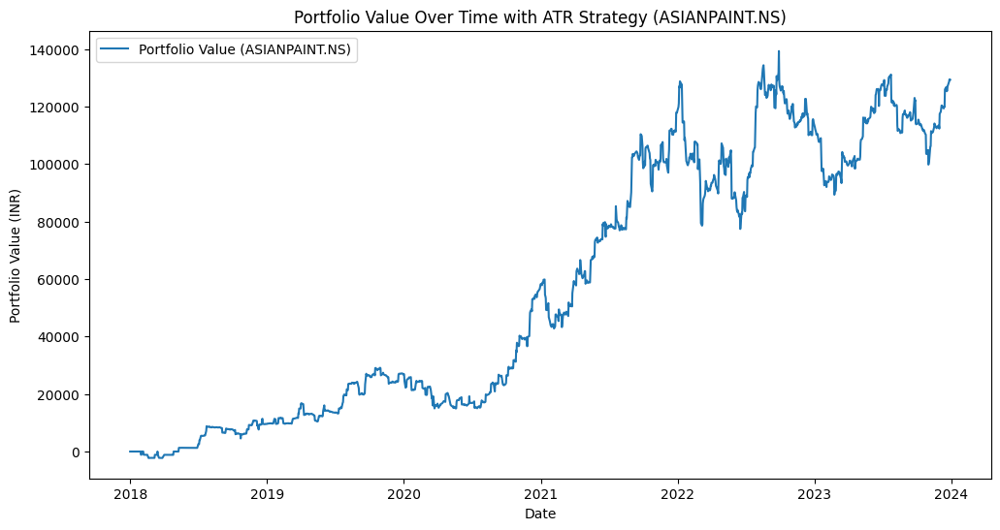

[*********************100%%**********************]  1 of 1 completed


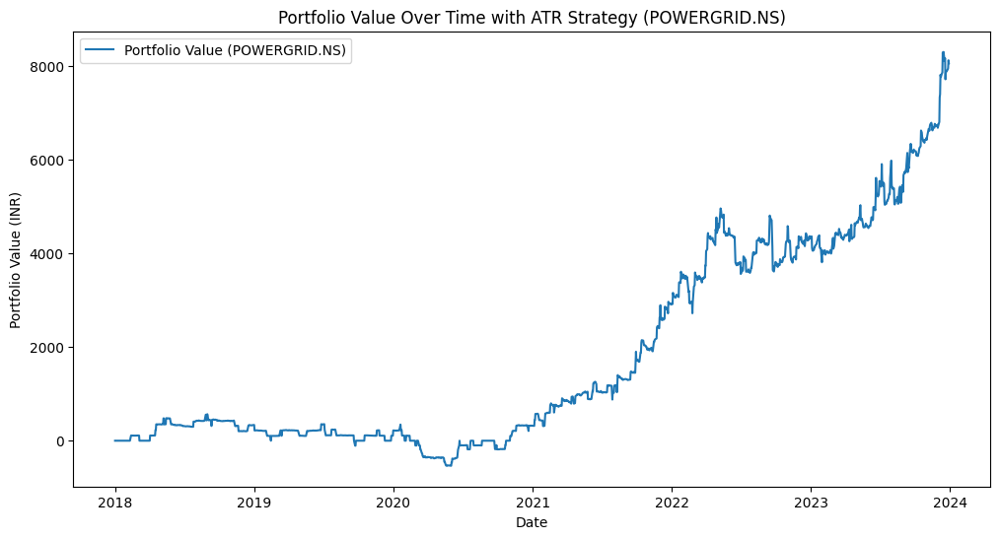

[*********************100%%**********************]  1 of 1 completed


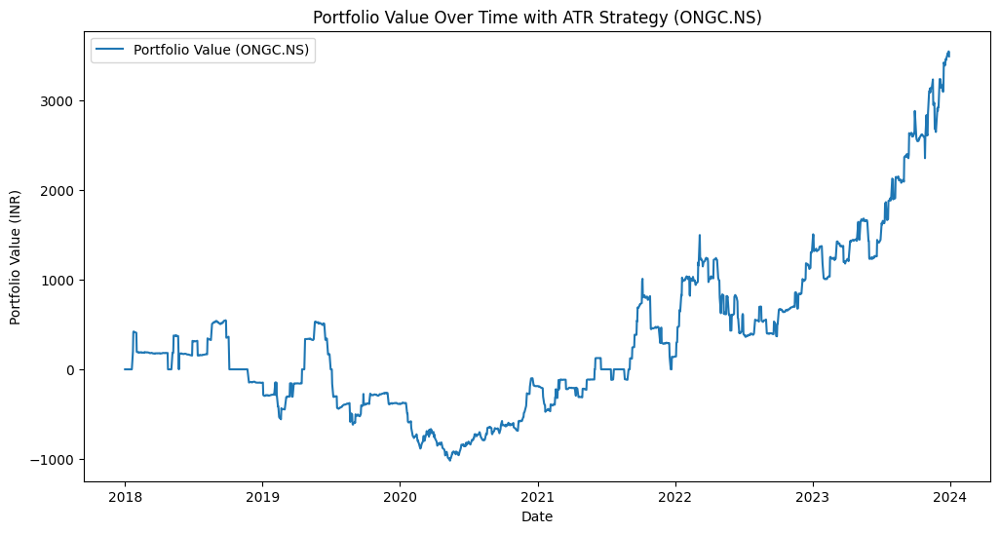

[*********************100%%**********************]  1 of 1 completed


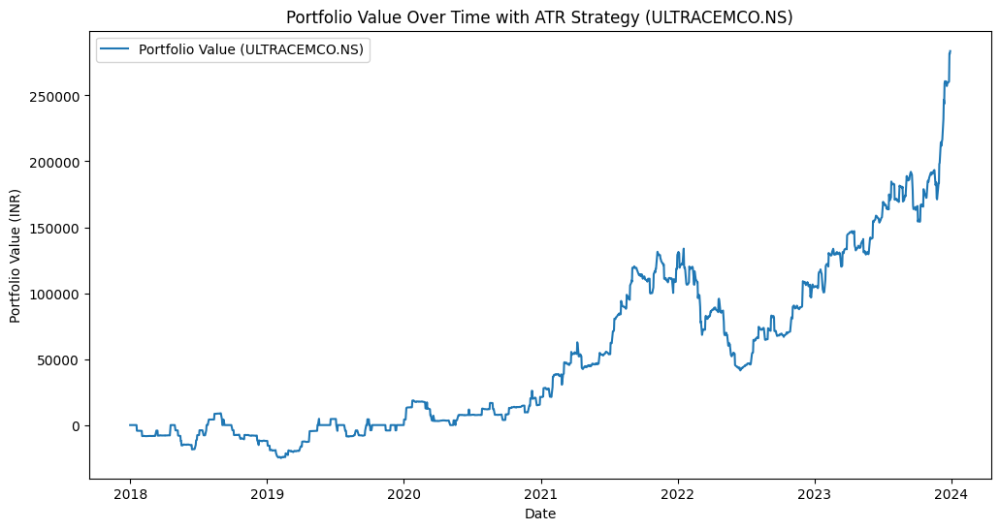

[*********************100%%**********************]  1 of 1 completed


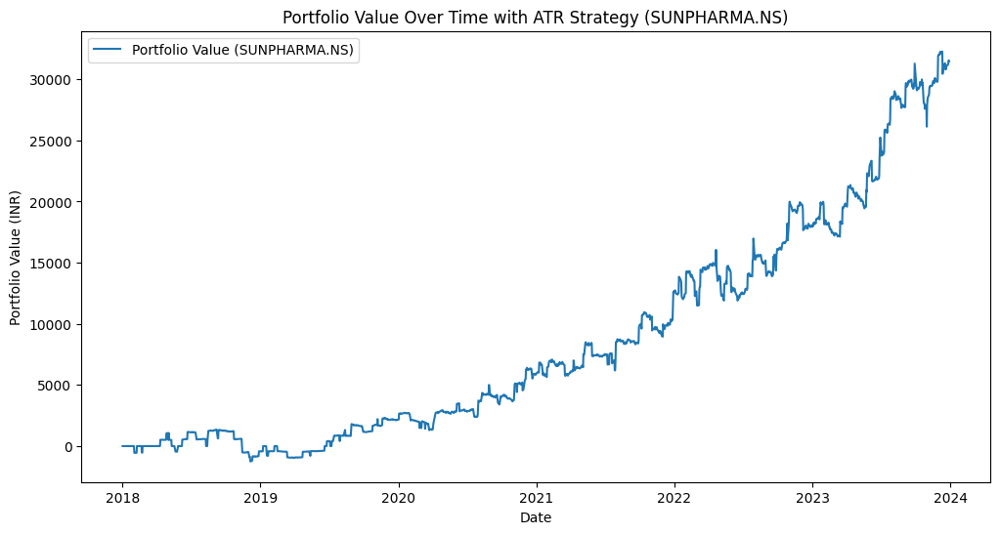

In [14]:
import yfinance as yf
import pandas as pd
import matplotlib.pyplot as plt

# List of top 20 NSE stocks
top_20_stocks = ['RELIANCE.NS', 'TCS.NS', 'HDFCBANK.NS', 'HINDUNILVR.NS', 'INFY.NS',
                 'HCLTECH.NS', 'ICICIBANK.NS', 'KOTAKBANK.NS', 'SBIN.NS', 'BHARTIARTL.NS',
                 'ITC.NS', 'LT.NS', 'AXISBANK.NS', 'MARUTI.NS', 'NTPC.NS', 'ASIANPAINT.NS',
                 'POWERGRID.NS', 'ONGC.NS', 'ULTRACEMCO.NS', 'SUNPHARMA.NS']

initial_capital = 1000000  # 1 million INR

# Loop through each stock
for stock_symbol in top_20_stocks:
    portfolio = {stock_symbol: 0}  # Initialize portfolio for each stock
    portfolio_value = []  # Initialize portfolio value list for each stock

    # Retrieve historical data
    data = yf.download(stock_symbol, start="2018-01-01", end="2023-12-31")

    # Calculate ATR
    data['ATR'] = data['High'] - data['Low']
    data['ATR'] = data['ATR'].rolling(window=14).mean()

    # Define buy/sell signals
    data['Buy_Signal'] = data['Close'] > data['Close'].shift(1) + data['ATR'].shift(1)
    data['Sell_Signal'] = data['Close'] < data['Close'].shift(1) - data['ATR'].shift(1)

    # Calculate portfolio value
    for date in data.index:
        if data.loc[date, 'Buy_Signal']:
            portfolio[stock_symbol] += 1  # Buy one share
        elif data.loc[date, 'Sell_Signal']:
            portfolio[stock_symbol] -= 1  # Sell one share
        portfolio_value.append(sum(portfolio[stock] * data.loc[date, 'Close'] for stock in portfolio))

    # Plot portfolio value
    plt.figure(figsize=(12, 6))
    plt.plot(data.index, portfolio_value, label=f'Portfolio Value ({stock_symbol})')
    plt.title(f'Portfolio Value Over Time with ATR Strategy ({stock_symbol})')
    plt.xlabel('Date')
    plt.ylabel('Portfolio Value (INR)')
    plt.legend()
    plt.show()


[*********************100%%**********************]  1 of 1 completed


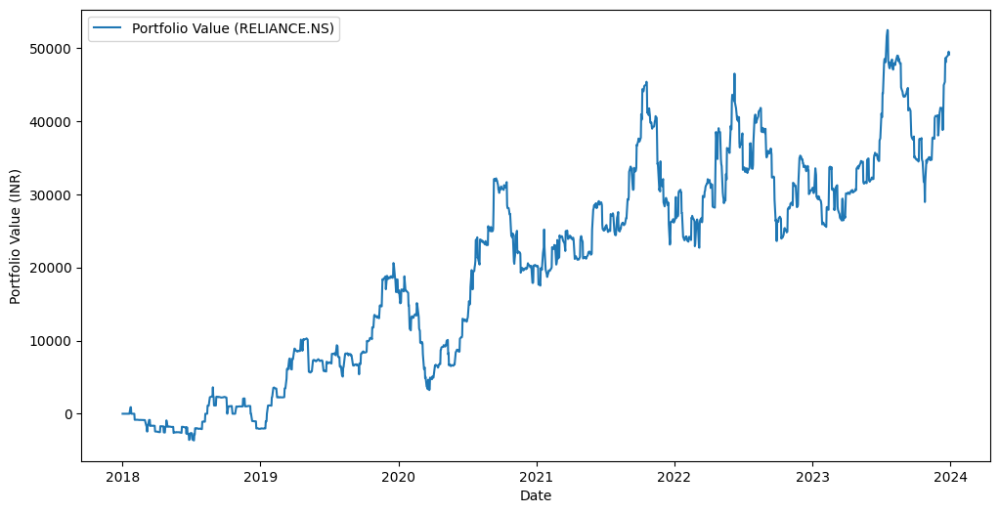

[*********************100%%**********************]  1 of 1 completed


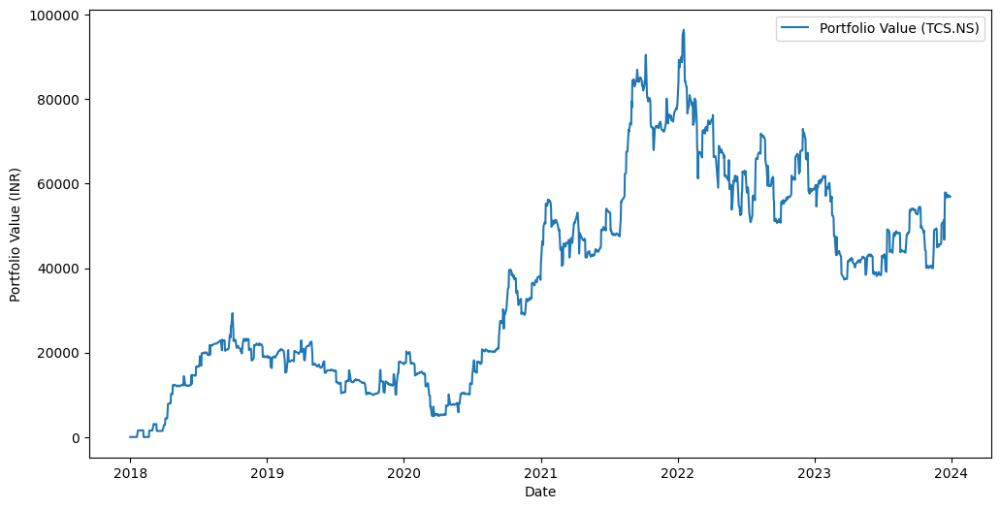

[*********************100%%**********************]  1 of 1 completed


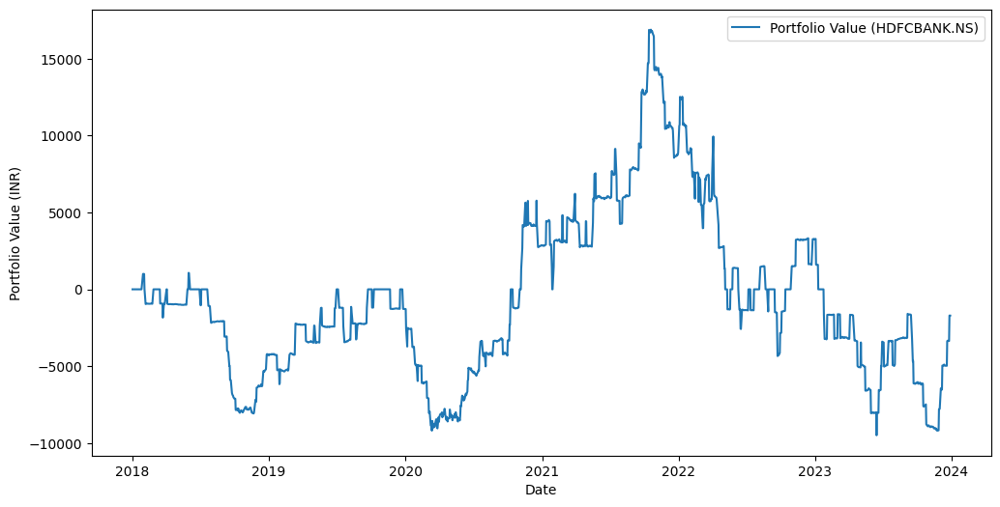

[*********************100%%**********************]  1 of 1 completed


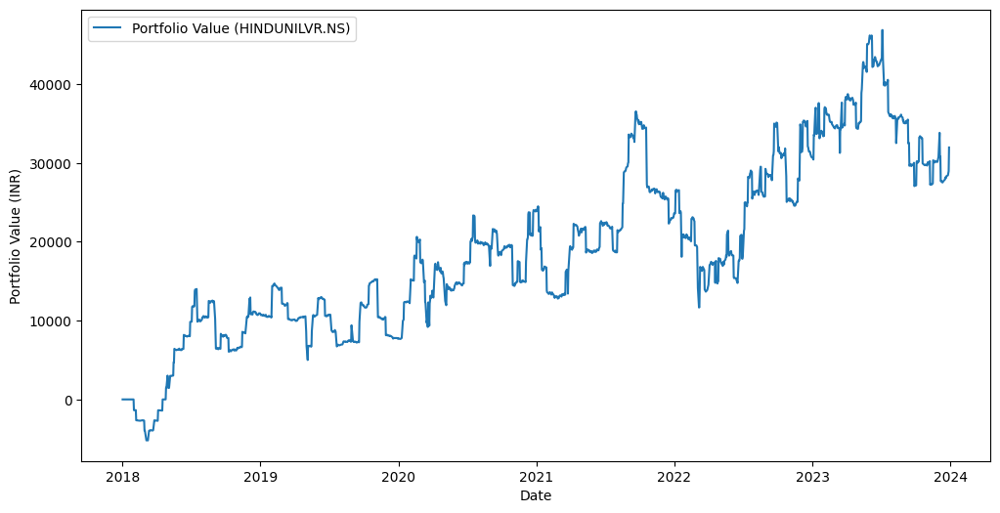

[*********************100%%**********************]  1 of 1 completed


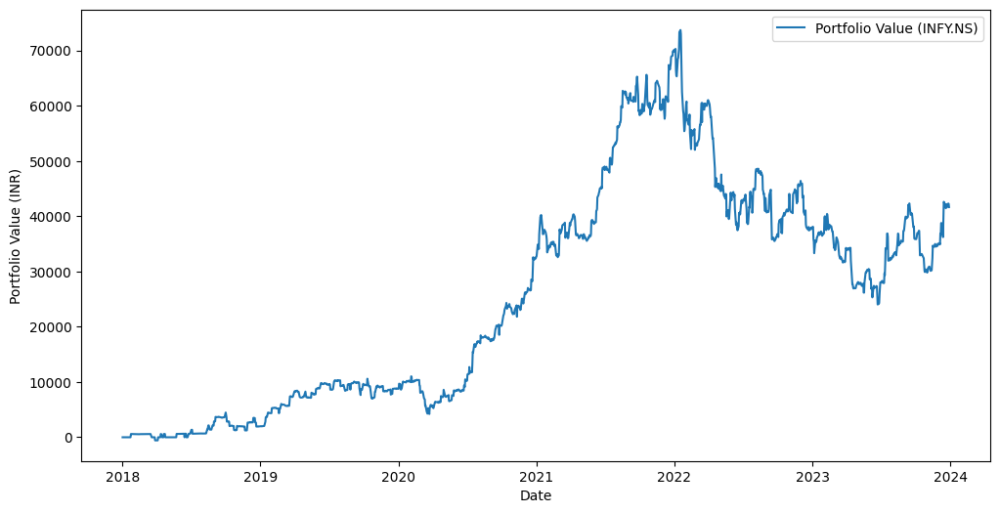

[*********************100%%**********************]  1 of 1 completed


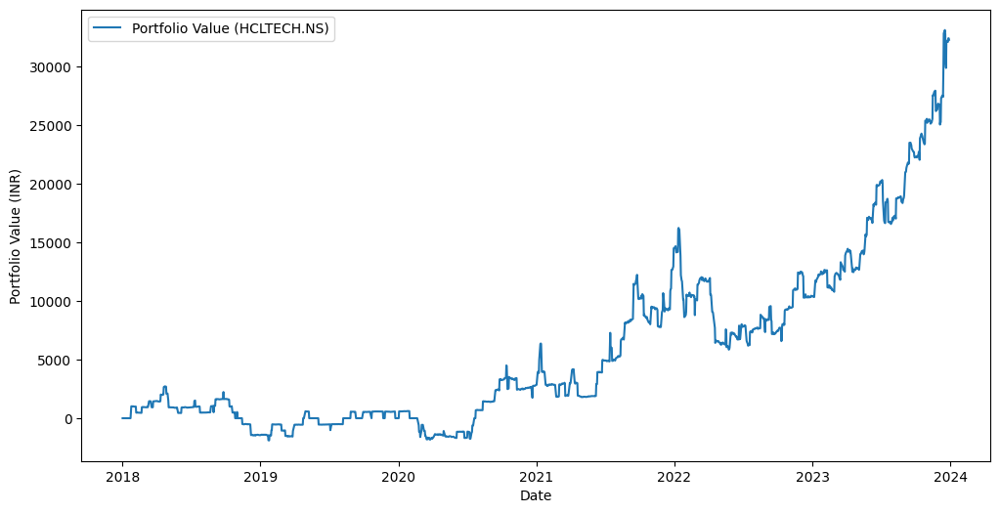

[*********************100%%**********************]  1 of 1 completed


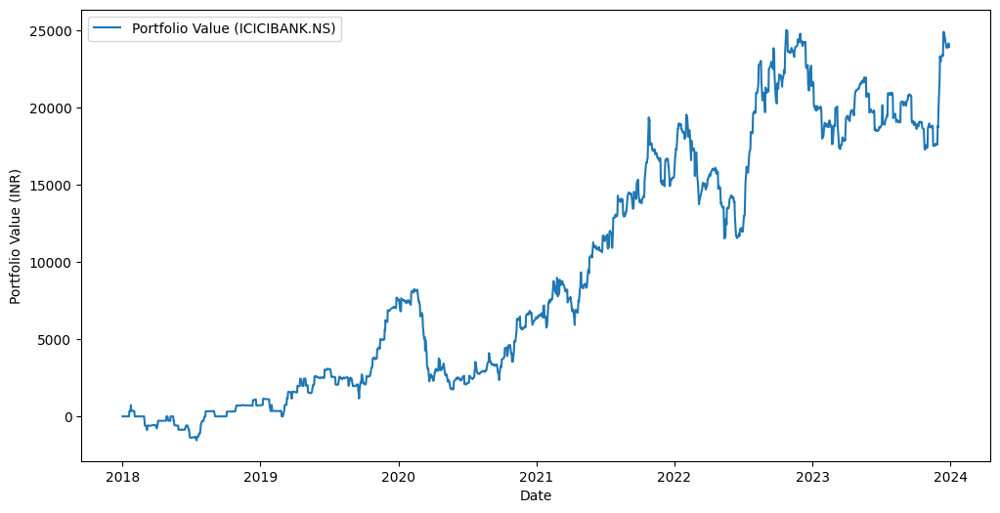

[*********************100%%**********************]  1 of 1 completed


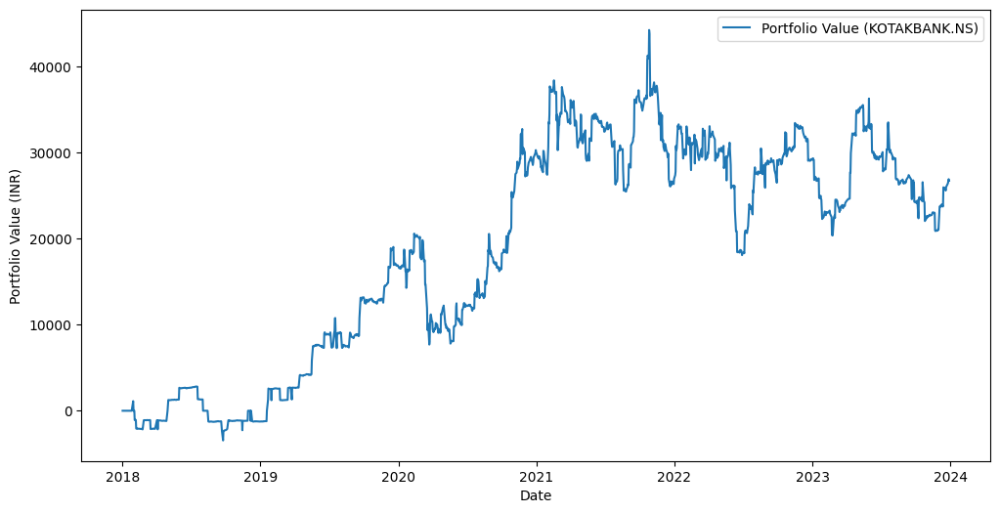

[*********************100%%**********************]  1 of 1 completed


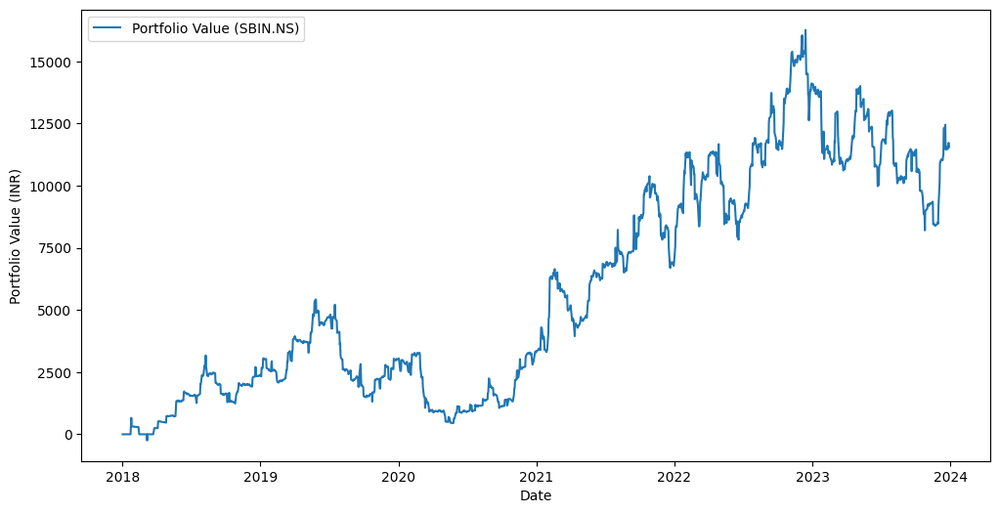

[*********************100%%**********************]  1 of 1 completed


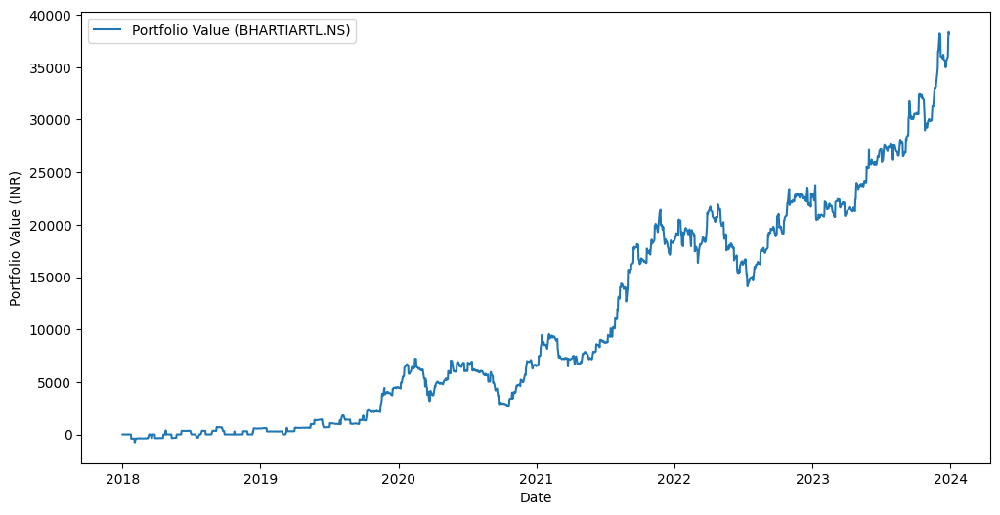

[*********************100%%**********************]  1 of 1 completed


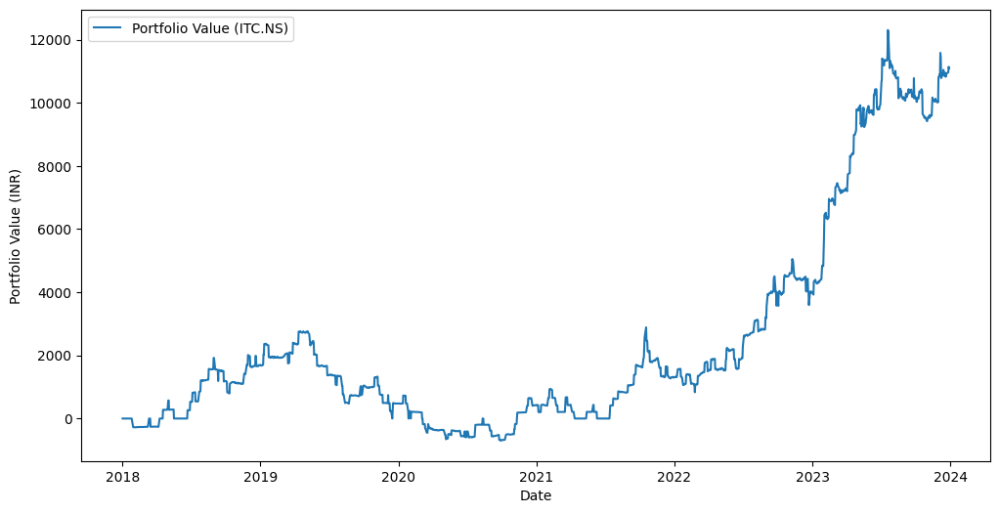

[*********************100%%**********************]  1 of 1 completed


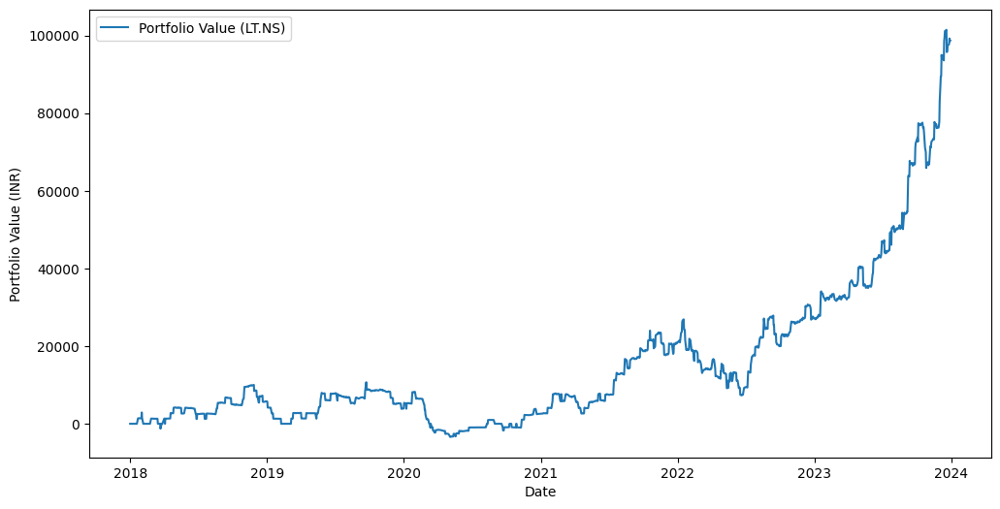

[*********************100%%**********************]  1 of 1 completed


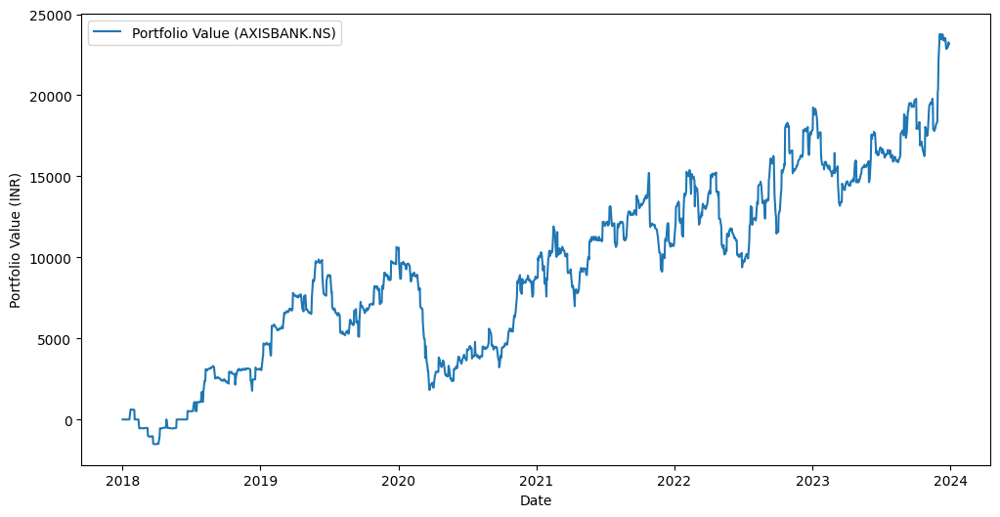

[*********************100%%**********************]  1 of 1 completed


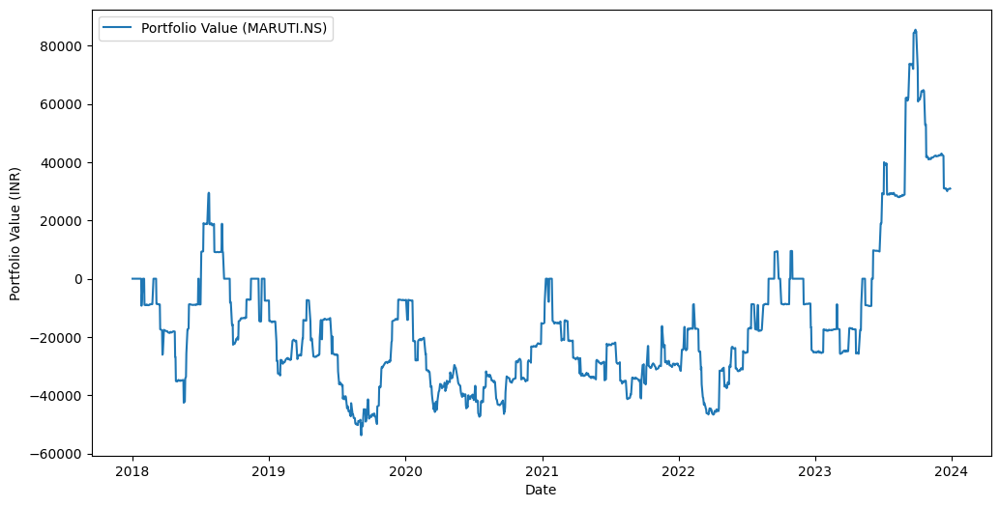

[*********************100%%**********************]  1 of 1 completed


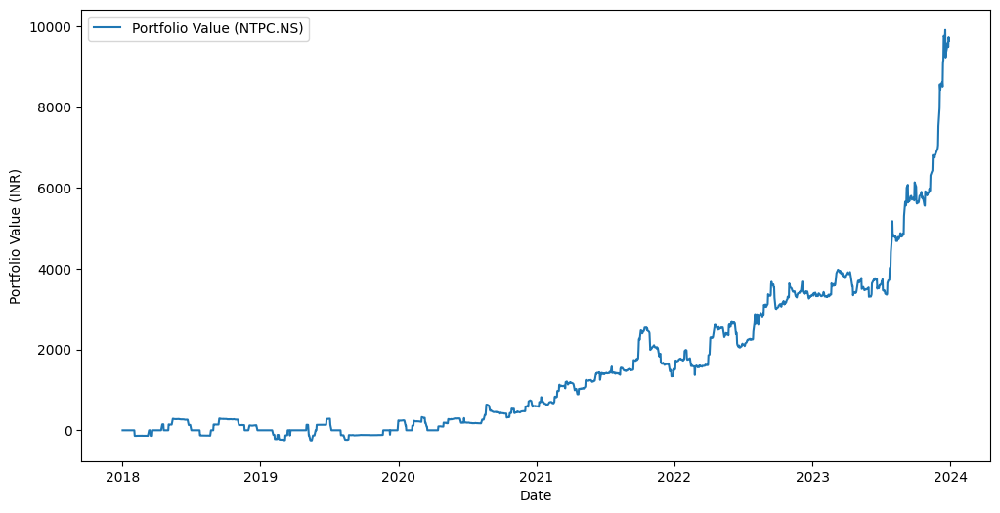

[*********************100%%**********************]  1 of 1 completed


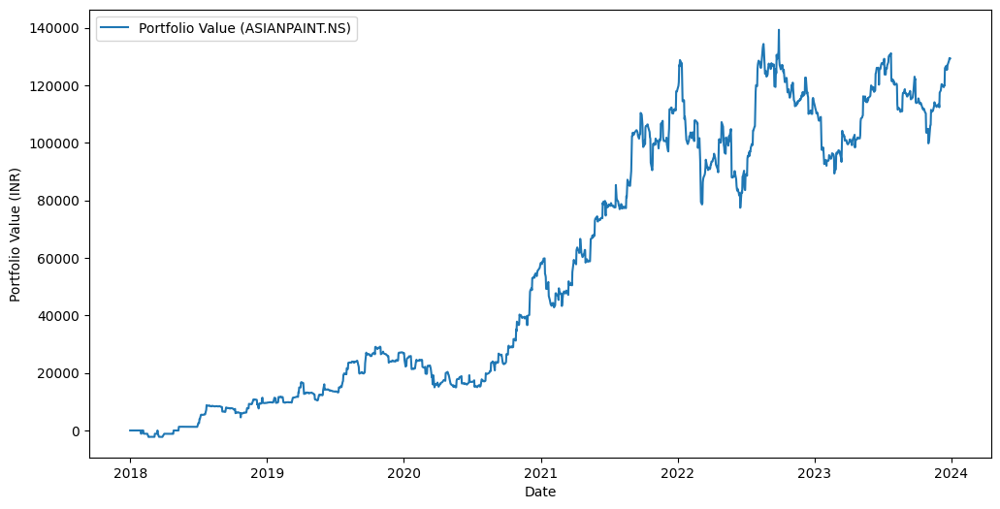

[*********************100%%**********************]  1 of 1 completed


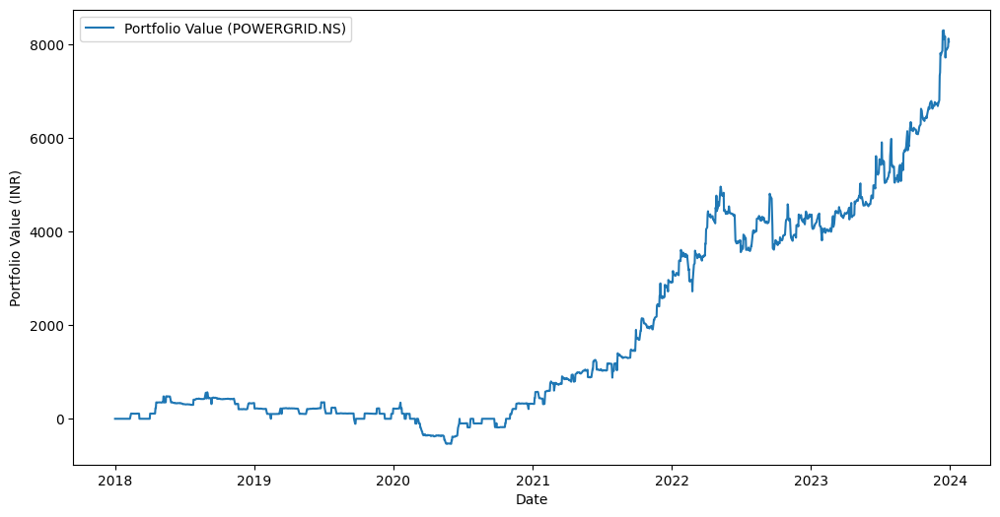

[*********************100%%**********************]  1 of 1 completed


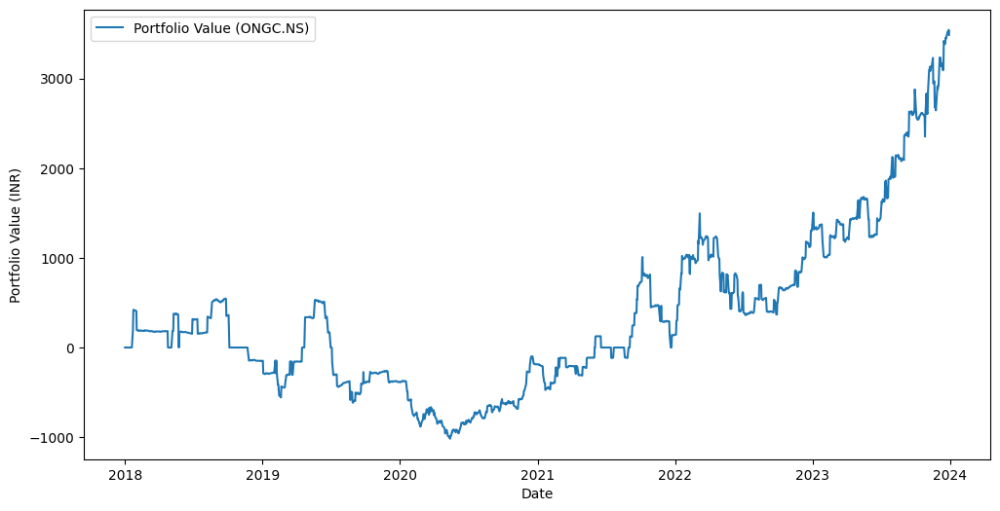

[*********************100%%**********************]  1 of 1 completed


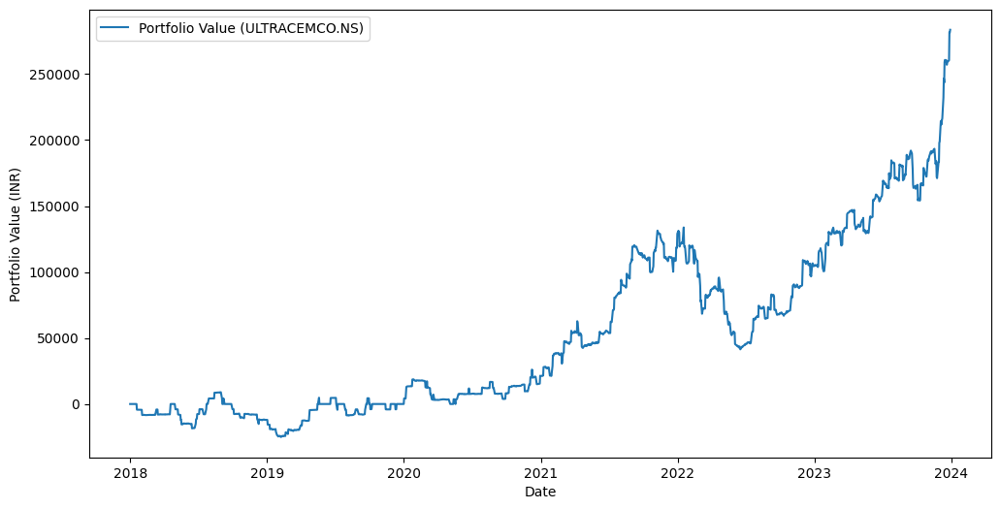

[*********************100%%**********************]  1 of 1 completed


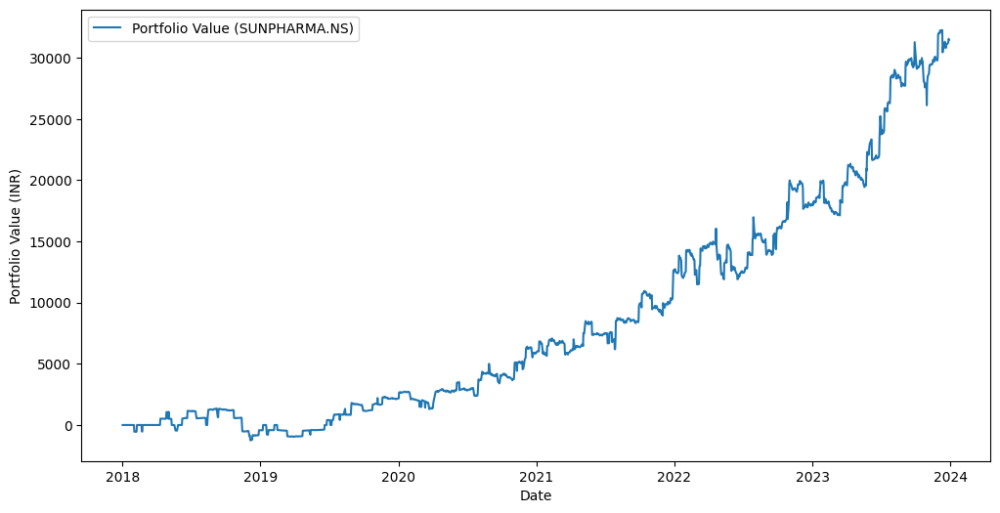

Overall Sharpe Ratio:31.7351665679705


In [26]:
import yfinance as yf
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# List of top 20 NSE stocks
top_20_stocks = ['RELIANCE.NS', 'TCS.NS', 'HDFCBANK.NS', 'HINDUNILVR.NS', 'INFY.NS',
                 'HCLTECH.NS', 'ICICIBANK.NS', 'KOTAKBANK.NS', 'SBIN.NS', 'BHARTIARTL.NS',
                 'ITC.NS', 'LT.NS', 'AXISBANK.NS', 'MARUTI.NS', 'NTPC.NS', 'ASIANPAINT.NS',
                 'POWERGRID.NS', 'ONGC.NS', 'ULTRACEMCO.NS', 'SUNPHARMA.NS']

initial_capital = 10  # 1 million INR

# Initialize lists to store Sharpe ratios and portfolio values
sharpe_ratios = []
portfolio_values = []

# Loop through each stock
for stock_symbol in top_20_stocks:
    portfolio = {stock_symbol: 0}  # Initialize portfolio for each stock
    portfolio_value = []  # Initialize portfolio value list for each stock

    # Retrieve historical data
    data = yf.download(stock_symbol, start="2018-01-01", end="2023-12-31")

    # Calculate ATR
    data['ATR'] = data['High'] - data['Low']
    data['ATR'] = data['ATR'].rolling(window=14).mean()

    # Define buy/sell signals
    data['Buy_Signal'] = data['Close'] > data['Close'].shift(1) + data['ATR'].shift(1)
    data['Sell_Signal'] = data['Close'] < data['Close'].shift(1) - data['ATR'].shift(1)

    # Calculate portfolio value
    for date in data.index:
        if data.loc[date, 'Buy_Signal']:
            portfolio[stock_symbol] += 1  # Buy one share
        elif data.loc[date, 'Sell_Signal']:
            portfolio[stock_symbol] -= 1  # Sell one share
        portfolio_value.append(sum(portfolio[stock] * data.loc[date, 'Close'] for stock in portfolio))

    # Append portfolio value for this stock to the list
    portfolio_values.append(portfolio_value)

    # Calculate daily returns
    daily_returns = pd.Series(portfolio_value).pct_change().dropna()

    # Replace NaN values in daily returns with zero
    daily_returns = daily_returns.fillna(0)

    # Calculate Sharpe ratio
    final_portfolio_value = portfolio_value[-1]  # Final portfolio value
    initial_portfolio_value = portfolio_value[0]  # Initial portfolio value
    trading_days = len(portfolio_value)  # Total number of trading days
    sharpe_ratio = (final_portfolio_value - initial_portfolio_value) / trading_days
    sharpe_ratios.append(sharpe_ratio)

    # Plot portfolio value
    plt.figure(figsize=(12, 6))
    plt.plot(data.index, portfolio_value, label=f'Portfolio Value ({stock_symbol})')
    plt.xlabel('Date')
    plt.ylabel('Portfolio Value (INR)')
    plt.legend()
    plt.show()

# Calculate overall Sharpe ratio
overall_portfolio_value = np.sum(portfolio_values, axis=0)
overall_daily_returns = pd.Series(overall_portfolio_value).pct_change().dropna()
overall_daily_returns_mean = overall_daily_returns.mean()
overall_sharpe_ratio = (overall_daily_returns_mean / overall_daily_returns.std()) * np.sqrt(252)  # Assuming 252 trading days in a year

print(f'Overall Sharpe Ratio:{sum(sharpe_ratios)/len(sharpe_ratios)}')


31.7351665679705

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


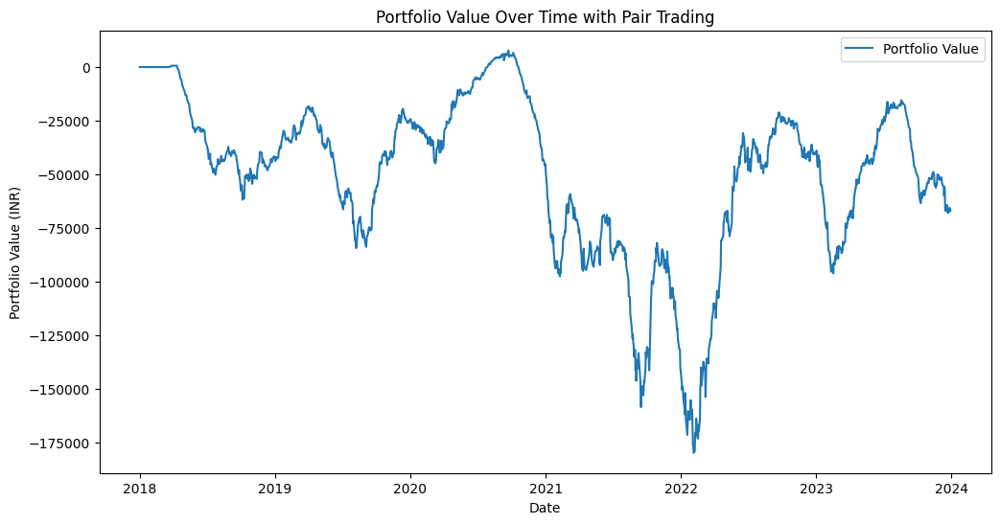

In [17]:
import yfinance as yf
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Define the pair of stocks for pair trading
stock1 = 'RELIANCE.NS'
stock2 = 'TCS.NS'

# Retrieve historical data for both stocks
data1 = yf.download(stock1, start="2018-01-01", end="2023-12-31")
data2 = yf.download(stock2, start="2018-01-01", end="2023-12-31")

# Calculate spread (difference in prices) between the two stocks
spread = data1['Close'] - data2['Close']

# Calculate rolling mean and standard deviation of the spread
spread_mean = spread.rolling(window=50).mean()
spread_std = spread.rolling(window=50).std()

# Calculate z-score of the spread
z_score = (spread - spread_mean) / spread_std

# Initialize portfolio parameters
initial_capital = 1000000  # 1 million INR
portfolio1 = {stock1: 0}
portfolio2 = {stock2: 0}
portfolio_value = []

# Loop through each trading day
for date in data1.index:
    # Check if z-score is below a certain threshold to take long position in stock1 and short position in stock2
    if z_score.loc[date] < -1:
        portfolio1[stock1] += 1  # Buy one share of stock1
        portfolio2[stock2] -= 1  # Sell one share of stock2
    # Check if z-score is above a certain threshold to take short position in stock1 and long position in stock2
    elif z_score.loc[date] > 1:
        portfolio1[stock1] -= 1  # Sell one share of stock1
        portfolio2[stock2] += 1  # Buy one share of stock2

    # Calculate portfolio value for the day
    portfolio_value.append((portfolio1[stock1] * data1.loc[date, 'Close']) + (portfolio2[stock2] * data2.loc[date, 'Close']))

# Plot portfolio value
plt.figure(figsize=(12, 6))
plt.plot(data1.index, portfolio_value, label='Portfolio Value')
plt.title('Portfolio Value Over Time with Pair Trading')
plt.xlabel('Date')
plt.ylabel('Portfolio Value (INR)')
plt.legend()
plt.show()


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%*******

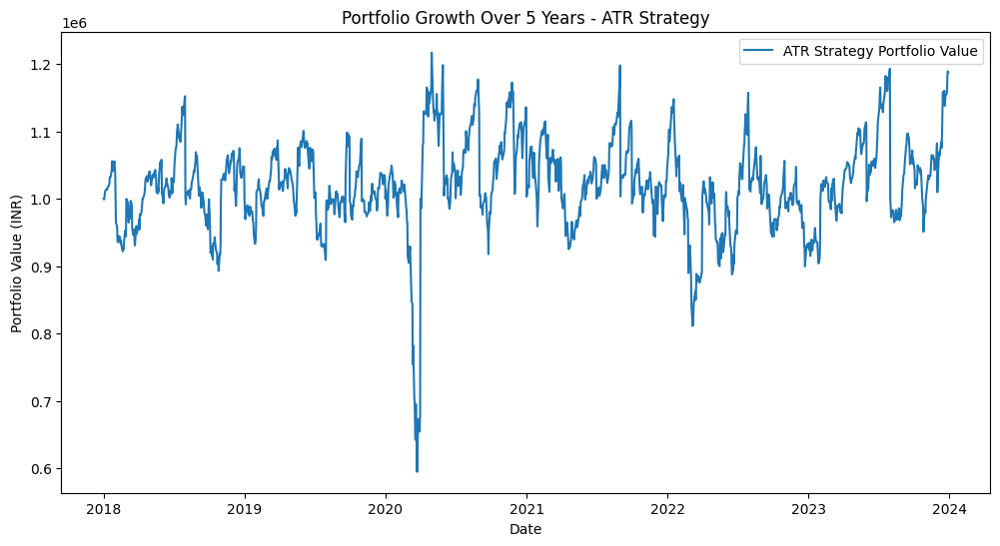

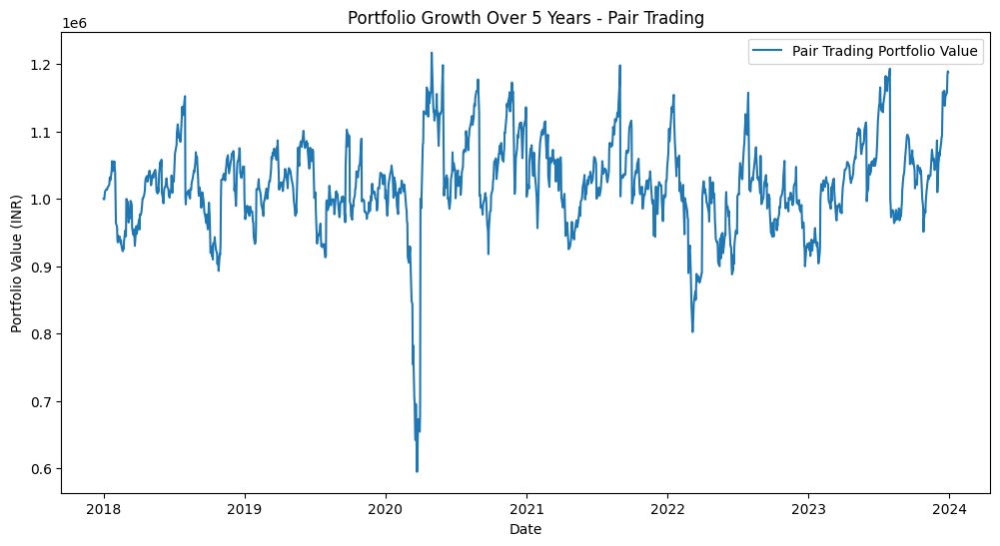

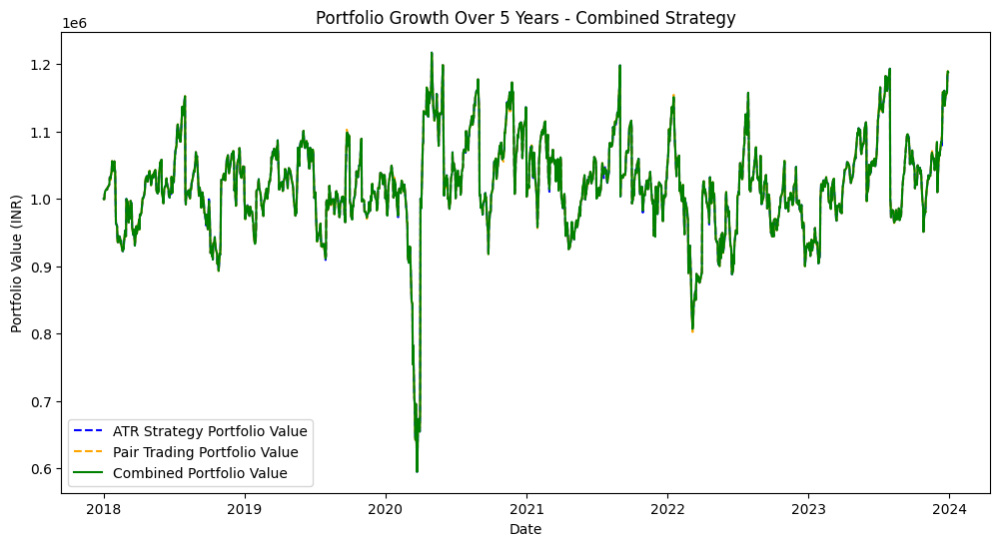

In [6]:
# Initialize portfolio parameters
initial_capital = 1000000  # 1 million INR
portfolio = {stock_symbol: 0 for stock_symbol in top_20_stocks}
portfolio_value_atr = []
portfolio_value_pair_trading = []
portfolio_value_combined = []

# Loop through each trading day
for date in signals[top_20_stocks[0]].index:
    daily_portfolio_value_atr = 0
    daily_portfolio_value_pair_trading = 0
    daily_portfolio_value_combined = 0
    daily_turnover = 0

    # Rebalance the portfolio
    if date.day == 1:  # Rebalance monthly
        # Allocate capital equally to each stock
        allocation_per_stock = initial_capital / len(top_20_stocks)
        for stock_symbol in top_20_stocks:
            portfolio[stock_symbol] = allocation_per_stock / yf.download(stock_symbol, start="2018-01-01", end="2023-12-31")['Close'][date]

    # Execute ATR strategy
    for stock_symbol in top_20_stocks:
        if signals[stock_symbol].loc[date, 'Buy_Signal']:
            daily_turnover += portfolio[stock_symbol] * signals[stock_symbol].loc[date, 'Close']
            portfolio[stock_symbol] += 1  # Buy one share
        elif signals[stock_symbol].loc[date, 'Sell_Signal']:
            daily_turnover += portfolio[stock_symbol] * signals[stock_symbol].loc[date, 'Close']
            portfolio[stock_symbol] -= 1  # Sell one share
    daily_portfolio_value_atr = calculate_portfolio_value(portfolio, {stock_symbol: signals[stock_symbol].loc[date, 'Close'] for stock_symbol in top_20_stocks})
    portfolio_value_atr.append(daily_portfolio_value_atr)

    # Execute pair trading
    for pair in pairs:
        stock1, stock2 = pair
        if signals[stock1].loc[date, 'Buy_Signal'] and signals[stock2].loc[date, 'Sell_Signal']:
            # Buy stock1 and sell stock2
            daily_turnover += portfolio[stock1] * signals[stock1].loc[date, 'Close']
            daily_turnover += portfolio[stock2] * signals[stock2].loc[date, 'Close']
            portfolio[stock1] += 1  # Buy one share of stock1
            portfolio[stock2] -= 1  # Sell one share of stock2
        elif signals[stock1].loc[date, 'Sell_Signal'] and signals[stock2].loc[date, 'Buy_Signal']:
            # Sell stock1 and buy stock2
            daily_turnover += portfolio[stock1] * signals[stock1].loc[date, 'Close']
            daily_turnover += portfolio[stock2] * signals[stock2].loc[date, 'Close']
            portfolio[stock1] -= 1  # Sell one share of stock1
            portfolio[stock2] += 1  # Buy one share of stock2
    daily_portfolio_value_pair_trading = calculate_portfolio_value(portfolio, {stock_symbol: signals[stock_symbol].loc[date, 'Close'] for stock_symbol in top_20_stocks})
    portfolio_value_pair_trading.append(daily_portfolio_value_pair_trading)

    # Calculate combined portfolio value for the day
    daily_portfolio_value_combined = (daily_portfolio_value_atr + daily_portfolio_value_pair_trading) / 2
    portfolio_value_combined.append(daily_portfolio_value_combined)

# Plot portfolio growth for ATR strategy
plt.figure(figsize=(12, 6))
plt.plot(signals[top_20_stocks[0]].index, portfolio_value_atr, label='ATR Strategy Portfolio Value')
plt.title('Portfolio Growth Over 5 Years - ATR Strategy')
plt.xlabel('Date')
plt.ylabel('Portfolio Value (INR)')
plt.legend()
plt.show()

# Plot portfolio growth for pair trading
plt.figure(figsize=(12, 6))
plt.plot(signals[top_20_stocks[0]].index, portfolio_value_pair_trading, label='Pair Trading Portfolio Value')
plt.title('Portfolio Growth Over 5 Years - Pair Trading')
plt.xlabel('Date')
plt.ylabel('Portfolio Value (INR)')
plt.legend()
plt.show()

# Plot combined portfolio growth
plt.figure(figsize=(12, 6))
plt.plot(signals[top_20_stocks[0]].index, portfolio_value_atr, label='ATR Strategy Portfolio Value', linestyle='--', color='blue')
plt.plot(signals[top_20_stocks[0]].index, portfolio_value_pair_trading, label='Pair Trading Portfolio Value', linestyle='--', color='orange')
plt.plot(signals[top_20_stocks[0]].index, portfolio_value_combined, label='Combined Portfolio Value', color='green')
plt.title('Portfolio Growth Over 5 Years - Combined Strategy')
plt.xlabel('Date')
plt.ylabel('Portfolio Value (INR)')
plt.legend()
plt.show()


# Volatility Mean Reversal

In [ ]:
import yfinance as yf
import pandas as pd
import matplotlib.pyplot as plt

# Step 1: Data Retrieval
top_20_tickers = ['RELIANCE.NS', 'TCS.NS', 'HDFCBANK.NS', 'HINDUNILVR.NS', 'INFY.NS',
                 'HCLTECH.NS', 'ICICIBANK.NS', 'KOTAKBANK.NS', 'SBIN.NS', 'BHARTIARTL.NS',
                 'ITC.NS', 'LT.NS', 'AXISBANK.NS', 'MARUTI.NS', 'NTPC.NS', 'ASIANPAINT.NS',
                 'POWERGRID.NS', 'ONGC.NS', 'ULTRACEMCO.NS', 'SUNPHARMA.NS']
stock_data = yf.download(top_20_tickers, start="2018-01-01", end="2023-12-31")
def calculate_yearly_return(stock_data, buy_signals, sell_signals):
    buy_prices = stock_data['Adj Close'][buy_signals]
    sell_prices = stock_data['Adj Close'][sell_signals]
    if len(buy_prices) == 0 or len(sell_prices) == 0:
        return 0
    initial_buy_price = buy_prices.iloc[0]
    final_sell_price = sell_prices.iloc[-1]
    return ((final_sell_price - initial_buy_price) / initial_buy_price) * 100

# Calculate Volatility
volatility = stock_data['Adj Close'].pct_change().rolling(window=20).std()

# Define Mean Reversion
mean_volatility = volatility.mean()

# Generate Signals
buy_signals = volatility < mean_volatility
sell_signals = volatility > mean_volatility

# Calculate Yearly Return
# Calculate Yearly Return
yearly_returns = {}
for year in range(2018, 2024):
    yearly_returns[year] = {}
    for ticker in top_20_tickers:
        year_data = stock_data.loc[str(year)]
        buy_yearly_signals = buy_signals[ticker].loc[str(year)]
        sell_yearly_signals = sell_signals[ticker].loc[str(year)]
        yearly_returns[year][ticker] = calculate_yearly_return(year_data, buy_yearly_signals, sell_yearly_signals)

# Convert Yearly Returns to DataFrame
yearly_returns_df = pd.DataFrame(yearly_returns)

print(yearly_returns_df)

[*********************100%%**********************]  20 of 20 completed


                                                            2018  \
RELIANCE.NS    Ticker
ASIANPAINT.NS    19.865081
AXISBANK.NS ...   
TCS.NS         Ticker
ASIANPAINT.NS    23.630143
AXISBANK.NS ...   
HDFCBANK.NS    Ticker
ASIANPAINT.NS     6.912745
AXISBANK.NS ...   
HINDUNILVR.NS  Ticker
ASIANPAINT.NS    22.734452
AXISBANK.NS ...   
INFY.NS        Ticker
ASIANPAINT.NS    22.734452
AXISBANK.NS ...   
HCLTECH.NS     Ticker
ASIANPAINT.NS    22.734452
AXISBANK.NS ...   
ICICIBANK.NS   Ticker
ASIANPAINT.NS    19.744409
AXISBANK.NS ...   
KOTAKBANK.NS   Ticker
ASIANPAINT.NS    22.734452
AXISBANK.NS ...   
SBIN.NS        Ticker
ASIANPAINT.NS    22.118058
AXISBANK.NS ...   
BHARTIARTL.NS  Ticker
ASIANPAINT.NS    24.541733
AXISBANK.NS ...   
ITC.NS         Ticker
ASIANPAINT.NS    14.309634
AXISBANK.NS ...   
LT.NS          Ticker
ASIANPAINT.NS    14.854900
AXISBANK.NS ...   
AXISBANK.NS    Ticker
ASIANPAINT.NS    19.744409
AXISBANK.NS ...   
MARUTI.NS      Ticker
ASIANPAINT.NS    22.734452

# Portfolio Optimization

In [ ]:
import yfinance as yf
import numpy as np
from scipy.optimize import minimize

# Define the list of top 20 NSE stock symbols
top_20_stocks = ['SBIN.NS', 'HDFCBANK.NS', 'RELIANCE.NS', 'ICICIBANK.NS', 'INFY.NS',
                 'TCS.NS', 'HINDUNILVR.NS', 'KOTAKBANK.NS', 'ITC.NS', 'BAJAJFINSV.NS',
                 'BAJFINANCE.NS', 'LT.NS', 'AXISBANK.NS', 'HCLTECH.NS', 'ONGC.NS',
                 'MARUTI.NS', 'NTPC.NS', 'POWERGRID.NS', 'SUNPHARMA.NS', 'TATASTEEL.NS']

# Download historical data
data = yf.download(top_20_stocks, start="2018-01-01", end="2023-12-31")['Adj Close']

# Calculate daily returns
returns = data.pct_change().dropna()

# Define objective function for optimization
def objective(weights):
    portfolio_return = np.sum(returns.mean() * weights) * 252
    portfolio_std_dev = np.sqrt(np.dot(weights.T, np.dot(returns.cov() * 252, weights)))
    return -portfolio_return / portfolio_std_dev

# Define constraints
constraints = ({'type': 'eq', 'fun': lambda x: np.sum(x) - 1})

# Define bounds for weights
bounds = tuple((0, 1) for _ in range(len(top_20_stocks)))

# Initial guess for weights
initial_guess = np.array([1.0 / len(top_20_stocks) for _ in range(len(top_20_stocks))])

# Perform optimization
opt_results = minimize(objective, initial_guess, method='SLSQP', bounds=bounds, constraints=constraints)

# Optimal weights
optimal_weights = opt_results.x

# Allocate funds
total_investment = 100000
allocation = total_investment * optimal_weights

# Print allocation
for i, stock in enumerate(top_20_stocks):
    print(f"Allocate Rs {allocation[i]:.2f} to {stock}")

# Evaluate performance (e.g., calculate portfolio return, risk, Sharpe ratio)
portfolio_return = np.sum(returns.mean() * optimal_weights) * 252
portfolio_std_dev = np.sqrt(np.dot(optimal_weights.T, np.dot(returns.cov() * 252, optimal_weights)))
sharpe_ratio = portfolio_return / portfolio_std_dev

print(f"Portfolio Return: {portfolio_return:.2f}")
print(f"Portfolio Standard Deviation: {portfolio_std_dev:.2f}")
print(f"Sharpe Ratio: {sharpe_ratio:.2f}")


[*********************100%%**********************]  20 of 20 completed


Allocate Rs 0.00 to SBIN.NS
Allocate Rs 0.00 to HDFCBANK.NS
Allocate Rs 8871.97 to RELIANCE.NS
Allocate Rs 15038.63 to ICICIBANK.NS
Allocate Rs 0.00 to INFY.NS
Allocate Rs 7262.55 to TCS.NS
Allocate Rs 1871.46 to HINDUNILVR.NS
Allocate Rs 6414.85 to KOTAKBANK.NS
Allocate Rs 3414.82 to ITC.NS
Allocate Rs 0.00 to BAJAJFINSV.NS
Allocate Rs 5270.33 to BAJFINANCE.NS
Allocate Rs 0.00 to LT.NS
Allocate Rs 5364.59 to AXISBANK.NS
Allocate Rs 0.00 to HCLTECH.NS
Allocate Rs 19640.24 to ONGC.NS
Allocate Rs 6372.15 to MARUTI.NS
Allocate Rs 0.00 to NTPC.NS
Allocate Rs 6383.32 to POWERGRID.NS
Allocate Rs 0.00 to SUNPHARMA.NS
Allocate Rs 14095.08 to TATASTEEL.NS
Portfolio Return: 0.23
Portfolio Standard Deviation: 0.17
Sharpe Ratio: 1.40


# Portfolio Optimization With MACD and RSI

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%*******

MACD Strategy with RSI Performance:
Cumulative Returns: 338.30%
Sharpe Ratio: 4.36
Maximum Drawdown: 22941.23
Turnover: 0.33


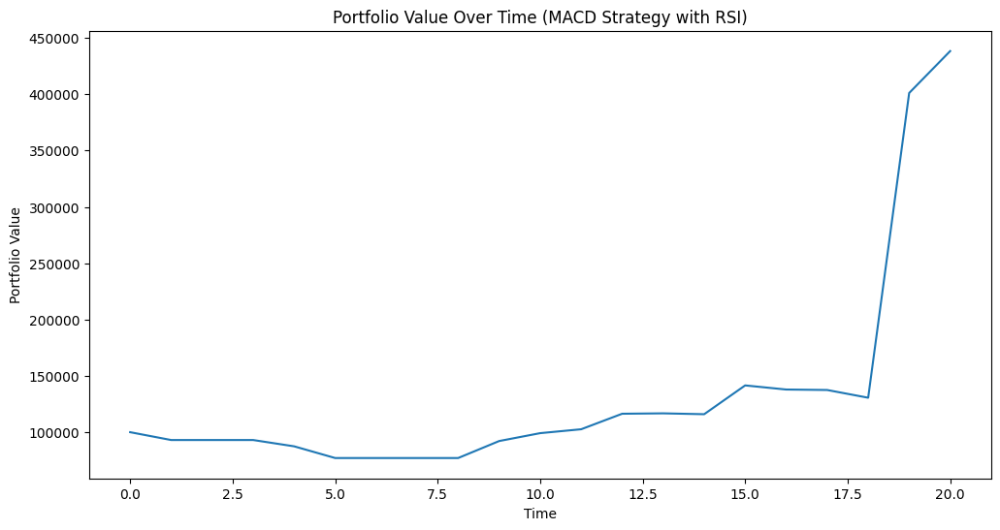

In [ ]:
import yfinance as yf
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# List of top 20 NSE stocks
top_20_stocks = ['RELIANCE.NS', 'TCS.NS', 'HDFCBANK.NS', 'HINDUNILVR.NS', 'INFY.NS',
                 'HCLTECH.NS', 'ICICIBANK.NS', 'KOTAKBANK.NS', 'SBIN.NS', 'BHARTIARTL.NS',
                 'ITC.NS', 'LT.NS', 'AXISBANK.NS', 'MARUTI.NS', 'NTPC.NS', 'ASIANPAINT.NS',
                 'POWERGRID.NS', 'ONGC.NS', 'ULTRACEMCO.NS', 'SUNPHARMA.NS']

# Dictionary to store buy/sell signals for each stock
signals = {}

# Loop through each stock
for stock_symbol in top_20_stocks:
    # Retrieve historical data
    data = yf.download(stock_symbol, start="2018-01-01", end="2023-12-31")

    # Calculate MACD
    data['26_EMA'] = data['Close'].ewm(span=26, adjust=False).mean()
    data['12_EMA'] = data['Close'].ewm(span=12, adjust=False).mean()
    data['MACD'] = data['12_EMA'] - data['26_EMA']
    data['Signal_Line'] = data['MACD'].ewm(span=9, adjust=False).mean()

    # Calculate RSI
    delta = data['Close'].diff()
    gain = (delta.where(delta > 0, 0)).rolling(window=14).mean()
    loss = (-delta.where(delta < 0, 0)).rolling(window=14).mean()
    RS = gain / loss
    data['RSI'] = 100 - (100 / (1 + RS))

    # Define buy/sell signals based on MACD crossover and RSI
    data['Buy_Signal'] = np.where((data['MACD'] > data['Signal_Line']) & (data['RSI'] < 30), True, False)
    data['Sell_Signal'] = np.where((data['MACD'] < data['Signal_Line']) & (data['RSI'] > 70), True, False)

    # Store signals
    signals[stock_symbol] = data[['Close', 'Buy_Signal', 'Sell_Signal']]

# Backtesting the MACD strategy with RSI
initial_investment = 100000
portfolio_value_MACD_RSI = initial_investment
portfolio_values_MACD_RSI = [portfolio_value_MACD_RSI]
shares_owned_MACD_RSI = 0

for stock_symbol in top_20_stocks:
    data = signals[stock_symbol]
    buy_signals_MACD_RSI = data[data['Buy_Signal']].index
    sell_signals_MACD_RSI = data[data['Sell_Signal']].index
    for buy_signal in buy_signals_MACD_RSI:
        buy_price = data.loc[buy_signal, 'Close']
        shares_to_buy_MACD_RSI = portfolio_value_MACD_RSI / len(top_20_stocks) / buy_price
        shares_owned_MACD_RSI += shares_to_buy_MACD_RSI
        portfolio_value_MACD_RSI -= shares_to_buy_MACD_RSI * buy_price
    for sell_signal in sell_signals_MACD_RSI:
        sell_price = data.loc[sell_signal, 'Close']
        portfolio_value_MACD_RSI += shares_owned_MACD_RSI * sell_price
        shares_owned_MACD_RSI = 0
    portfolio_values_MACD_RSI.append(portfolio_value_MACD_RSI)

# Calculate performance metrics for MACD strategy with RSI
returns_MACD_RSI = (portfolio_values_MACD_RSI[-1] - initial_investment) / initial_investment
cumulative_returns_MACD_RSI = (portfolio_values_MACD_RSI[-1] - initial_investment) / initial_investment
daily_returns_MACD_RSI = np.diff(portfolio_values_MACD_RSI) / portfolio_values_MACD_RSI[:-1]
sharpe_ratio_MACD_RSI = np.mean(daily_returns_MACD_RSI) / np.std(daily_returns_MACD_RSI) * np.sqrt(252)
drawdowns_MACD_RSI = np.maximum.accumulate(portfolio_values_MACD_RSI) - portfolio_values_MACD_RSI
max_drawdown_MACD_RSI = np.max(drawdowns_MACD_RSI)
turnover_MACD_RSI = (len(buy_signals_MACD_RSI) + len(sell_signals_MACD_RSI)) / len(portfolio_values_MACD_RSI)

# Print performance metrics for MACD strategy with RSI
print("MACD Strategy with RSI Performance:")
print(f"Cumulative Returns: {cumulative_returns_MACD_RSI:.2%}")
print(f"Sharpe Ratio: {sharpe_ratio_MACD_RSI:.2f}")
print(f"Maximum Drawdown: {max_drawdown_MACD_RSI:.2f}")
print(f"Turnover: {turnover_MACD_RSI:.2f}")

# Plot portfolio value over time for MACD strategy with RSI
plt.figure(figsize=(12, 6))
plt.plot(portfolio_values_MACD_RSI)
plt.title('Portfolio Value Over Time (MACD Strategy with RSI)')
plt.xlabel('Time')
plt.ylabel('Portfolio Value')
plt.show()


# Portfolio Optimization With RSI, MACD, Keltner Channel, and Volatility mean Reversal


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%*******

Strategy Performance:
Cumulative Returns: 19.16%
Sharpe Ratio: 3.21
Maximum Drawdown: 6271.35
Turnover: 0.05


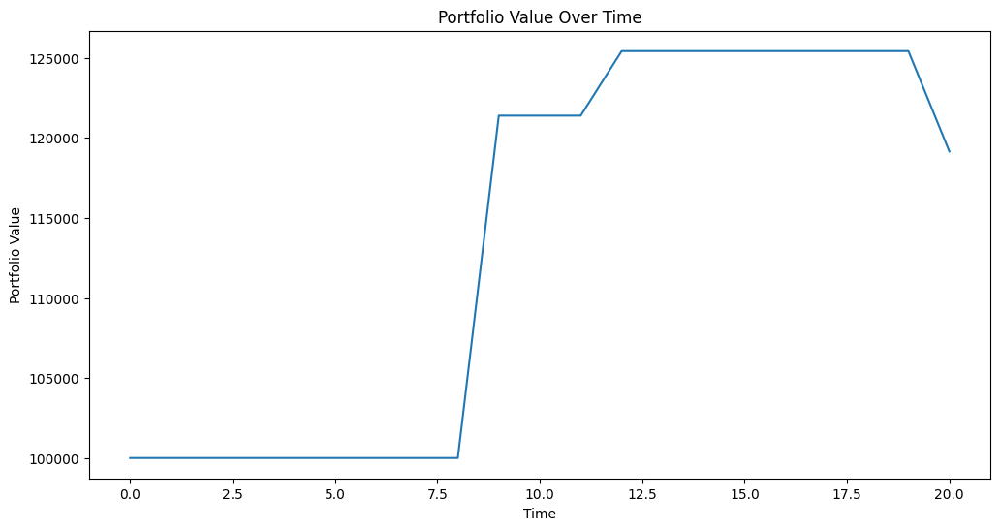

In [ ]:
import yfinance as yf
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# List of top 20 NSE stocks
top_20_stocks = ['RELIANCE.NS', 'TCS.NS', 'HDFCBANK.NS', 'HINDUNILVR.NS', 'INFY.NS',
                 'HCLTECH.NS', 'ICICIBANK.NS', 'KOTAKBANK.NS', 'SBIN.NS', 'BHARTIARTL.NS',
                 'ITC.NS', 'LT.NS', 'AXISBANK.NS', 'MARUTI.NS', 'NTPC.NS', 'ASIANPAINT.NS',
                 'POWERGRID.NS', 'ONGC.NS', 'ULTRACEMCO.NS', 'SUNPHARMA.NS']

# Dictionary to store buy/sell signals for each stock
signals = {}

# Loop through each stock
for stock_symbol in top_20_stocks:
    # Retrieve historical data
    data = yf.download(stock_symbol, start="2018-01-01", end="2023-12-31")

    # Calculate Keltner Channel
    data['TP'] = (data['High'] + data['Low'] + data['Close']) / 3
    data['ATR'] = data['High'] - data['Low']
    data['MA_TP'] = data['TP'].rolling(window=20).mean()
    data['Upper_band'] = data['MA_TP'] + (2 * data['ATR'].rolling(window=20).mean())
    data['Lower_band'] = data['MA_TP'] - (2 * data['ATR'].rolling(window=20).mean())

    # Calculate MACD
    data['26_EMA'] = data['Close'].ewm(span=26, adjust=False).mean()
    data['12_EMA'] = data['Close'].ewm(span=12, adjust=False).mean()
    data['MACD'] = data['12_EMA'] - data['26_EMA']
    data['Signal_Line'] = data['MACD'].ewm(span=9, adjust=False).mean()

    # Calculate RSI
    delta = data['Close'].diff()
    gain = (delta.where(delta > 0, 0)).rolling(window=14).mean()
    loss = (-delta.where(delta < 0, 0)).rolling(window=14).mean()
    RS = gain / loss
    data['RSI'] = 100 - (100 / (1 + RS))

    # Define buy/sell signals based on MACD crossover, RSI, and Keltner Channel
    data['Buy_Signal'] = np.where((data['MACD'] > data['Signal_Line']) &
                                  (data['RSI'] < 30) &
                                  (data['Close'] < data['Lower_band']), True, False)

    data['Sell_Signal'] = np.where((data['MACD'] < data['Signal_Line']) &
                                   (data['RSI'] > 70) &
                                   (data['Close'] > data['Upper_band']), True, False)

    # Store signals
    signals[stock_symbol] = data[['Close', 'Buy_Signal', 'Sell_Signal']]

# Backtesting the strategy with MACD, RSI, and Keltner Channel
initial_investment = 100000
portfolio_value = initial_investment
portfolio_values = [portfolio_value]
shares_owned = 0

for stock_symbol in top_20_stocks:
    data = signals[stock_symbol]
    buy_signals = data[data['Buy_Signal']].index
    sell_signals = data[data['Sell_Signal']].index
    for buy_signal in buy_signals:
        buy_price = data.loc[buy_signal, 'Close']
        shares_to_buy = portfolio_value / len(top_20_stocks) / buy_price
        shares_owned += shares_to_buy
        portfolio_value -= shares_to_buy * buy_price
    for sell_signal in sell_signals:
        sell_price = data.loc[sell_signal, 'Close']
        portfolio_value += shares_owned * sell_price
        shares_owned = 0
    portfolio_values.append(portfolio_value)

# Calculate performance metrics
returns = (portfolio_values[-1] - initial_investment) / initial_investment
cumulative_returns = (portfolio_values[-1] - initial_investment) / initial_investment
daily_returns = np.diff(portfolio_values) / portfolio_values[:-1]
sharpe_ratio = np.mean(daily_returns) / np.std(daily_returns) * np.sqrt(252)
drawdowns = np.maximum.accumulate(portfolio_values) - portfolio_values
max_drawdown = np.max(drawdowns)
turnover = (len(buy_signals) + len(sell_signals)) / len(portfolio_values)

# Print performance metrics
print("Strategy Performance:")
print(f"Cumulative Returns: {cumulative_returns:.2%}")
print(f"Sharpe Ratio: {sharpe_ratio:.2f}")
print(f"Maximum Drawdown: {max_drawdown:.2f}")
print(f"Turnover: {turnover:.2f}")

# Plot portfolio value over time
plt.figure(figsize=(12, 6))
plt.plot(portfolio_values)
plt.title('Portfolio Value Over Time')
plt.xlabel('Time')
plt.ylabel('Portfolio Value')
plt.show()


# Portfolio Optimization With RSI, MACD, Keltner Channel, and ATR

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%*******

Strategy Performance:
Cumulative Returns: 11.30%
Sharpe Ratio: 2.78
Maximum Drawdown: 5858.14
Turnover: 0.05


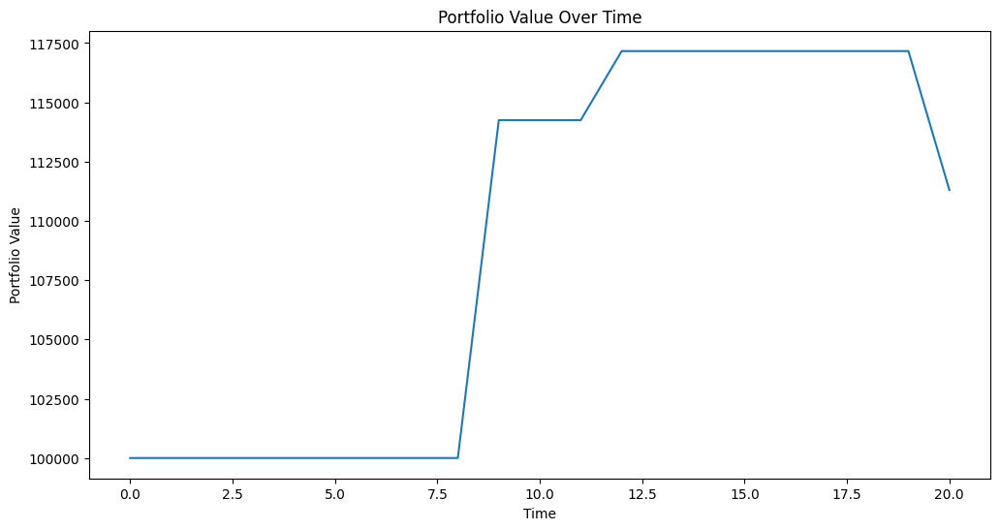

In [ ]:
import yfinance as yf
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# List of top 20 NSE stocks
top_20_stocks = ['RELIANCE.NS', 'TCS.NS', 'HDFCBANK.NS', 'HINDUNILVR.NS', 'INFY.NS',
                 'HCLTECH.NS', 'ICICIBANK.NS', 'KOTAKBANK.NS', 'SBIN.NS', 'BHARTIARTL.NS',
                 'ITC.NS', 'LT.NS', 'AXISBANK.NS', 'MARUTI.NS', 'NTPC.NS', 'ASIANPAINT.NS',
                 'POWERGRID.NS', 'ONGC.NS', 'ULTRACEMCO.NS', 'SUNPHARMA.NS']

# Dictionary to store buy/sell signals for each stock
signals = {}

# Loop through each stock
for stock_symbol in top_20_stocks:
    # Retrieve historical data
    data = yf.download(stock_symbol, start="2018-01-01", end="2023-12-31")

    # Calculate ATR
    data['ATR'] = data['High'] - data['Low']
    data['ATR'] = data['ATR'].rolling(window=14).mean()

    # Calculate Keltner Channel
    data['TP'] = (data['High'] + data['Low'] + data['Close']) / 3
    data['MA_TP'] = data['TP'].rolling(window=20).mean()
    data['Upper_band'] = data['MA_TP'] + (2 * data['ATR'].rolling(window=20).mean())
    data['Lower_band'] = data['MA_TP'] - (2 * data['ATR'].rolling(window=20).mean())

    # Calculate MACD
    data['26_EMA'] = data['Close'].ewm(span=26, adjust=False).mean()
    data['12_EMA'] = data['Close'].ewm(span=12, adjust=False).mean()
    data['MACD'] = data['12_EMA'] - data['26_EMA']
    data['Signal_Line'] = data['MACD'].ewm(span=9, adjust=False).mean()

    # Calculate RSI
    delta = data['Close'].diff()
    gain = (delta.where(delta > 0, 0)).rolling(window=14).mean()
    loss = (-delta.where(delta < 0, 0)).rolling(window=14).mean()
    RS = gain / loss
    data['RSI'] = 100 - (100 / (1 + RS))

    # Define buy/sell signals based on MACD crossover, RSI, and Keltner Channel
    data['Buy_Signal'] = np.where((data['MACD'] > data['Signal_Line']) &
                                  (data['RSI'] < 30) &
                                  (data['Close'] < data['Lower_band']), True, False)

    data['Sell_Signal'] = np.where((data['MACD'] < data['Signal_Line']) &
                                   (data['RSI'] > 70) &
                                   (data['Close'] > data['Upper_band']), True, False)

    # Store signals
    signals[stock_symbol] = data[['Close', 'Buy_Signal', 'Sell_Signal']]

# Backtesting the strategy with MACD, RSI, ATR, and Keltner Channel
initial_investment = 100000
portfolio_value = initial_investment
portfolio_values = [portfolio_value]
shares_owned = 0

for stock_symbol in top_20_stocks:
    data = signals[stock_symbol]
    buy_signals = data[data['Buy_Signal']].index
    sell_signals = data[data['Sell_Signal']].index
    for buy_signal in buy_signals:
        buy_price = data.loc[buy_signal, 'Close']
        shares_to_buy = portfolio_value / len(top_20_stocks) / buy_price
        shares_owned += shares_to_buy
        portfolio_value -= shares_to_buy * buy_price
    for sell_signal in sell_signals:
        sell_price = data.loc[sell_signal, 'Close']
        portfolio_value += shares_owned * sell_price
        shares_owned = 0
    portfolio_values.append(portfolio_value)

# Calculate performance metrics
returns = (portfolio_values[-1] - initial_investment) / initial_investment
cumulative_returns = (portfolio_values[-1] - initial_investment) / initial_investment
daily_returns = np.diff(portfolio_values) / portfolio_values[:-1]
sharpe_ratio = np.mean(daily_returns) / np.std(daily_returns) * np.sqrt(252)
drawdowns = np.maximum.accumulate(portfolio_values) - portfolio_values
max_drawdown = np.max(drawdowns)
turnover = (len(buy_signals) + len(sell_signals)) / len(portfolio_values)

# Print performance metrics
print("Strategy Performance:")
print(f"Cumulative Returns: {cumulative_returns:.2%}")
print(f"Sharpe Ratio: {sharpe_ratio:.2f}")
print(f"Maximum Drawdown: {max_drawdown:.2f}")
print(f"Turnover: {turnover:.2f}")

# Plot portfolio value over time
plt.figure(figsize=(12, 6))
plt.plot(portfolio_values)
plt.title('Portfolio Value Over Time')
plt.xlabel('Time')
plt.ylabel('Portfolio Value')
plt.show()


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%*******

Strategy Performance:
Cumulative Returns: 11.30%
Sharpe Ratio: 2.78
Maximum Drawdown: 5858.14
Turnover: 0.05


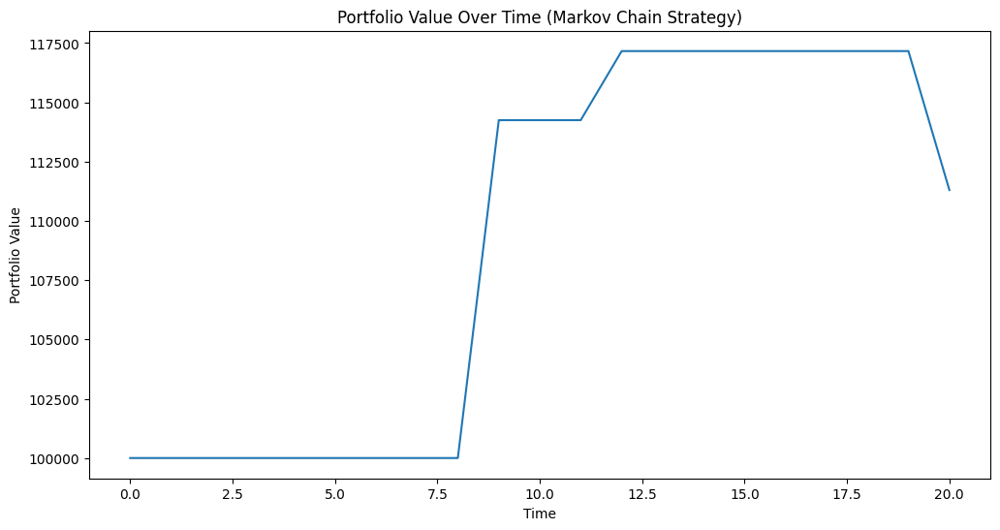

In [ ]:
import yfinance as yf
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# List of top 20 NSE stocks
top_20_stocks = ['RELIANCE.NS', 'TCS.NS', 'HDFCBANK.NS', 'HINDUNILVR.NS', 'INFY.NS',
                 'HCLTECH.NS', 'ICICIBANK.NS', 'KOTAKBANK.NS', 'SBIN.NS', 'BHARTIARTL.NS',
                 'ITC.NS', 'LT.NS', 'AXISBANK.NS', 'MARUTI.NS', 'NTPC.NS', 'ASIANPAINT.NS',
                 'POWERGRID.NS', 'ONGC.NS', 'ULTRACEMCO.NS', 'SUNPHARMA.NS']

# Dictionary to store buy/sell signals for each stock
signals = {}

# Loop through each stock
for stock_symbol in top_20_stocks:
    # Retrieve historical data
    data = yf.download(stock_symbol, start="2018-01-01", end="2023-12-31")

    # Check if data is empty or if 'Close' column is missing
    if data.empty or 'Close' not in data.columns:
        print(f"No data available for {stock_symbol}. Skipping...")
        continue

    # Calculate ATR
    data['ATR'] = data['High'] - data['Low']
    data['ATR'] = data['ATR'].rolling(window=14).mean()

    # Calculate Keltner Channel
    data['TP'] = (data['High'] + data['Low'] + data['Close']) / 3
    data['MA_TP'] = data['TP'].rolling(window=20).mean()
    data['Upper_band'] = data['MA_TP'] + (2 * data['ATR'].rolling(window=20).mean())
    data['Lower_band'] = data['MA_TP'] - (2 * data['ATR'].rolling(window=20).mean())

    # Calculate MACD
    if 'Close' in data.columns:
        data['26_EMA'] = data['Close'].ewm(span=26, adjust=False).mean()
        data['12_EMA'] = data['Close'].ewm(span=12, adjust=False).mean()
        data['MACD'] = data['12_EMA'] - data['26_EMA']
        data['Signal_Line'] = data['MACD'].ewm(span=9, adjust=False).mean()

    # Calculate RSI
    if 'Close' in data.columns:
        delta = data['Close'].diff()
        gain = (delta.where(delta > 0, 0)).rolling(window=14).mean()
        loss = (-delta.where(delta < 0, 0)).rolling(window=14).mean()
        RS = gain / loss
        data['RSI'] = 100 - (100 / (1 + RS))

    # Define buy/sell signals based on MACD crossover, RSI, and Keltner Channel
    if 'Close' in data.columns and 'MACD' in data.columns and 'Signal_Line' in data.columns:
        data['Buy_Signal'] = np.where((data['MACD'] > data['Signal_Line']) &
                                      (data['RSI'] < 30) &
                                      (data['Close'] < data['Lower_band']), True, False)

        data['Sell_Signal'] = np.where((data['MACD'] < data['Signal_Line']) &
                                       (data['RSI'] > 70) &
                                       (data['Close'] > data['Upper_band']), True, False)

        # Store signals
        signals[stock_symbol] = data[['Close', 'Buy_Signal', 'Sell_Signal']]
    else:
        print(f"Required columns not found for {stock_symbol}. Skipping...")

# Define states
BULLISH_STATE = 1
BEARISH_STATE = 0

# Initialize current state
current_state = BULLISH_STATE  # Assume bullish state initially

# Backtesting the strategy with Markov Chain
initial_investment = 100000
portfolio_value = initial_investment
portfolio_values = [portfolio_value]
shares_owned = 0

for stock_symbol in top_20_stocks:
    if stock_symbol not in signals:
        continue

    data = signals[stock_symbol]
    buy_signals = data[data['Buy_Signal']].index
    sell_signals = data[data['Sell_Signal']].index
    for buy_signal in buy_signals:
        if current_state == BULLISH_STATE:
            buy_price = data.loc[buy_signal, 'Close']
            shares_to_buy = portfolio_value / len(top_20_stocks) / buy_price
            shares_owned += shares_to_buy
            portfolio_value -= shares_to_buy * buy_price
        else:
            # Hold cash in bearish state
            pass
    for sell_signal in sell_signals:
        sell_price = data.loc[sell_signal, 'Close']
        portfolio_value += shares_owned * sell_price
        shares_owned = 0
    # Update state based on MACD
    if 'MACD' in data.columns and 'Signal_Line' in data.columns:
        if data['MACD'].iloc[-1] > data['Signal_Line'].iloc[-1]:
            current_state = BULLISH_STATE
        else:
            current_state = BEARISH_STATE
    portfolio_values.append(portfolio_value)

# Calculate performance metrics
returns = (portfolio_values[-1] - initial_investment) / initial_investment
cumulative_returns = (portfolio_values[-1] - initial_investment) / initial_investment
daily_returns = np.diff(portfolio_values) / portfolio_values[:-1]
sharpe_ratio = np.mean(daily_returns) / np.std(daily_returns) * np.sqrt(252)
drawdowns = np.maximum.accumulate(portfolio_values) - portfolio_values
max_drawdown = np.max(drawdowns)
turnover = (len(buy_signals) + len(sell_signals)) / len(portfolio_values)

# Print performance metrics
print("Strategy Performance:")
print(f"Cumulative Returns: {cumulative_returns:.2%}")
print(f"Sharpe Ratio: {sharpe_ratio:.2f}")
print(f"Maximum Drawdown: {max_drawdown:.2f}")
print(f"Turnover: {turnover:.2f}")

# Plot portfolio value over time
plt.figure(figsize=(12, 6))
plt.plot(portfolio_values)
plt.title('Portfolio Value Over Time (Markov Chain Strategy)')
plt.xlabel('Time')
plt.ylabel('Portfolio Value')
plt.show()


# ML Model

In [ ]:
import yfinance as yf
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from sklearn.metrics import accuracy_score

# Define the list of top 20 NSE stock symbols
top_20_stocks = ['RELIANCE.NS', 'TCS.NS', 'HDFCBANK.NS', 'HINDUNILVR.NS', 'INFY.NS',
                 'HCLTECH.NS', 'ICICIBANK.NS', 'KOTAKBANK.NS', 'SBIN.NS', 'BHARTIARTL.NS',
                 'ITC.NS', 'LT.NS', 'AXISBANK.NS', 'MARUTI.NS', 'NTPC.NS', 'ASIANPAINT.NS',
                 'POWERGRID.NS', 'ONGC.NS', 'ULTRACEMCO.NS', 'SUNPHARMA.NS']

# Function to retrieve historical data for a given stock symbol
def get_stock_data(symbol, start_date, end_date):
    data = yf.download(symbol, start=start_date, end=end_date)
    return data

# Function to calculate indicators and generate buy/sell signals
def generate_signals(data):
    # Calculate indicators
    data['ATR'] = data['High'] - data['Low']
    data['ATR'] = data['ATR'].rolling(window=14).mean()
    data['TP'] = (data['High'] + data['Low'] + data['Close']) / 3
    data['MA_TP'] = data['TP'].rolling(window=20).mean()
    data['Upper_band'] = data['MA_TP'] + (2 * data['ATR'].rolling(window=20).mean())
    data['Lower_band'] = data['MA_TP'] - (2 * data['ATR'].rolling(window=20).mean())

    # Generate buy/sell signals
    data['Buy_Signal'] = np.where((data['Close'] < data['Lower_band']), 1, 0)
    data['Sell_Signal'] = np.where((data['Close'] > data['Upper_band']), 1, 0)

    return data[['Close', 'ATR', 'TP', 'MA_TP', 'Upper_band', 'Lower_band', 'Buy_Signal', 'Sell_Signal']]

# Load historical data for training (2000 to 2017)
train_start_date = '2000-01-01'
train_end_date = '2017-12-31'
train_data = pd.DataFrame()

for stock_symbol in top_20_stocks:
    stock_data = get_stock_data(stock_symbol, train_start_date, train_end_date)
    stock_data = generate_signals(stock_data)
    train_data = pd.concat([train_data, stock_data])

# Drop rows with missing values
train_data.dropna(inplace=True)

# Prepare features and labels
X = train_data[['Close', 'ATR', 'TP', 'MA_TP', 'Upper_band', 'Lower_band']]
y = train_data[['Buy_Signal', 'Sell_Signal']]

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Scale the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Build the neural network model
model = Sequential([
    Dense(64, activation='relu', input_shape=(X_train_scaled.shape[1],)),
    Dropout(0.2),
    Dense(32, activation='relu'),
    Dropout(0.2),
    Dense(2, activation='sigmoid')  # Two output neurons for Buy and Sell signals
])

# Compile the model
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Train the model
history = model.fit(X_train_scaled, y_train, epochs=20, batch_size=32, validation_split=0.2, verbose=1)

# Evaluate the model
test_loss, test_accuracy = model.evaluate(X_test_scaled, y_test, verbose=0)
print(f'Test Accuracy: {test_accuracy}')

# Load historical data for testing (2018 to 2023)
test_start_date = '2018-01-01'
test_end_date = '2023-12-31'
test_data = pd.DataFrame()

for stock_symbol in top_20_stocks:
    stock_data = get_stock_data(stock_symbol, test_start_date, test_end_date)
    stock_data = generate_signals(stock_data)
    test_data = pd.concat([test_data, stock_data])

# Drop rows with missing values
test_data.dropna(inplace=True)

# Prepare features for testing
X_test_real = test_data[['Close', 'ATR', 'TP', 'MA_TP', 'Upper_band', 'Lower_band']]
X_test_real_scaled = scaler.transform(X_test_real)

# Predict buy/sell signals
y_pred = model.predict(X_test_real_scaled)

# Backtest the strategy
# Add your backtesting code here


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%*******

Epoch 1/20
1608/1608 [==============================] - 5s 2ms/step - loss: 0.3354 - accuracy: 0.2254 - val_loss: 0.2962 - val_accuracy: 0.1993
Epoch 2/20
1608/1608 [==============================] - 4s 2ms/step - loss: 0.2701 - accuracy: 0.3807 - val_loss: 0.2192 - val_accuracy: 0.3457
Epoch 3/20
1608/1608 [==============================] - 4s 3ms/step - loss: 0.2102 - accuracy: 0.4943 - val_loss: 0.1670 - val_accuracy: 0.4583
Epoch 4/20
1608/1608 [==============================] - 4s 2ms/step - loss: 0.1759 - accuracy: 0.5395 - val_loss: 0.1354 - val_accuracy: 0.4945
Epoch 5/20
1608/1608 [==============================] - 4s 2ms/step - loss: 0.1555 - accuracy: 0.5556 - val_loss: 0.1277 - val_accuracy: 0.5371
Epoch 6/20
1608/1608 [==============================] - 5s 3ms/step - loss: 0.1427 - accuracy: 0.5665 - val_loss: 0.1415 - val_accuracy: 0.4561
Epoch 7/20
1608/1608 [==============================] - 4s 2ms/step - loss: 0.1363 - accuracy: 0.5675 - val_loss: 0.1103 - val_accuracy:

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

Test Accuracy: 0.5727261304855347



[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%******

906/906 [==============================] - 1s 1ms/step


In [ ]:
# Function to backtest the strategy
def backtest_strategy(data, predictions, initial_capital):
    portfolio_value = initial_capital
    shares_owned = 0

    for i in range(len(data)):
        close_price = data.iloc[i]['Close']
        buy_signal = predictions[i][0]  # Buy signal
        sell_signal = predictions[i][1]  # Sell signal

        # Buy signal
        if buy_signal == 1:
            shares_to_buy = portfolio_value // close_price
            shares_owned += shares_to_buy
            portfolio_value -= shares_to_buy * close_price

        # Sell signal
        elif sell_signal == 1:
            portfolio_value += shares_owned * close_price
            shares_owned = 0

    # Add the value of remaining shares to portfolio value
    portfolio_value += shares_owned * close_price

    return portfolio_value

# Load historical data for testing (August 2018 to August 2023)
start_date = '2018-08-01'
end_date = '2023-08-01'
test_data = pd.DataFrame()

for stock_symbol in top_20_stocks:
    stock_data = get_stock_data(stock_symbol, start_date, end_date)
    stock_data = generate_signals(stock_data)
    test_data = pd.concat([test_data, stock_data])

# Drop rows with missing values
test_data.dropna(inplace=True)

# Prepare features for testing
X_test_real = test_data[['Close', 'ATR', 'TP', 'MA_TP', 'Upper_band', 'Lower_band']]
X_test_real_scaled = scaler.transform(X_test_real)

# Predict buy/sell signals
predictions = model.predict(X_test_real_scaled)

# Backtest the strategy
final_portfolio_value = backtest_strategy(test_data, predictions, initial_capital=100000)

print("Final Portfolio Value:", final_portfolio_value)


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%*******

751/751 [==============================] - 2s 2ms/step
Final Portfolio Value: 112220.23034667969


In [ ]:
import yfinance as yf
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from scipy.optimize import minimize

# Function to retrieve historical data for a given stock symbol
def get_stock_data(symbol, start_date, end_date):
    data = yf.download(symbol, start=start_date, end=end_date)
    return data

# Function to calculate indicators and generate buy/sell signals
def generate_signals(data):
    # Calculate indicators
    data['ATR'] = data['High'] - data['Low']
    data['ATR'] = data['ATR'].rolling(window=14).mean()
    data['TP'] = (data['High'] + data['Low'] + data['Close']) / 3
    data['MA_TP'] = data['TP'].rolling(window=20).mean()
    data['Upper_band'] = data['MA_TP'] + (2 * data['ATR'].rolling(window=20).mean())
    data['Lower_band'] = data['MA_TP'] - (2 * data['ATR'].rolling(window=20).mean())

    # Generate buy/sell signals
    data['Buy_Signal'] = np.where((data['Close'] < data['Lower_band']), 1, 0)
    data['Sell_Signal'] = np.where((data['Close'] > data['Upper_band']), 1, 0)

    return data[['Close', 'ATR', 'TP', 'MA_TP', 'Upper_band', 'Lower_band', 'Buy_Signal', 'Sell_Signal']]

# Function to perform portfolio optimization
def portfolio_optimization(data, predictions, initial_investment):
    portfolio_value = initial_investment
    portfolio_allocations = {}
    num_stocks = len(top_20_stocks)
    allocation_per_stock = portfolio_value / num_stocks

    for i, stock_symbol in enumerate(top_20_stocks):
        buy_signal = predictions[i][0]  # Buy signal
        sell_signal = predictions[i][1]  # Sell signal
        stock_price = data[data['Stock'] == stock_symbol].iloc[-1]['Close']

        # Buy signal
        if buy_signal == 1:
            num_shares_to_buy = allocation_per_stock / stock_price
            portfolio_allocations[stock_symbol] = num_shares_to_buy

        # Sell signal
        elif sell_signal == 1:
            if stock_symbol in portfolio_allocations:
                portfolio_value += portfolio_allocations[stock_symbol] * stock_price
                del portfolio_allocations[stock_symbol]

    # Add the value of remaining shares to portfolio value
    for stock_symbol, num_shares in portfolio_allocations.items():
        stock_price = data[data['Stock'] == stock_symbol].iloc[-1]['Close']
        portfolio_value += num_shares * stock_price

    return portfolio_value

# Define the list of top 20 NSE stock symbols
top_20_stocks = ['RELIANCE.NS', 'TCS.NS', 'HDFCBANK.NS', 'HINDUNILVR.NS', 'INFY.NS',
                 'HCLTECH.NS', 'ICICIBANK.NS', 'KOTAKBANK.NS', 'SBIN.NS', 'BHARTIARTL.NS',
                 'ITC.NS', 'LT.NS', 'AXISBANK.NS', 'MARUTI.NS', 'NTPC.NS', 'ASIANPAINT.NS',
                 'POWERGRID.NS', 'ONGC.NS', 'ULTRACEMCO.NS', 'SUNPHARMA.NS']

# Load historical data for training (2000 to 2017)
train_start_date = '2000-01-01'
train_end_date = '2017-12-31'
train_data = pd.DataFrame()

for stock_symbol in top_20_stocks:
    stock_data = get_stock_data(stock_symbol, train_start_date, train_end_date)
    stock_data = generate_signals(stock_data)
    train_data = pd.concat([train_data, stock_data])

# Drop rows with missing values
train_data.dropna(inplace=True)

# Prepare features and labels
X = train_data[['Close', 'ATR', 'TP', 'MA_TP', 'Upper_band', 'Lower_band']]
y = train_data[['Buy_Signal', 'Sell_Signal']]

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Scale the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Build the neural network model with portfolio optimization layer
model = Sequential([
    Dense(64, activation='relu', input_shape=(X_train_scaled.shape[1],)),
    Dropout(0.2),
    Dense(32, activation='relu'),
    Dropout(0.2),
    Dense(2, activation='sigmoid')  # Two output neurons for Buy and Sell signals
])

# Compile the model
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Train the model
history = model.fit(X_train_scaled, y_train, epochs=20, batch_size=32, validation_split=0.2, verbose=1)

# Evaluate the model
test_loss, test_accuracy = model.evaluate(X_test_scaled, y_test, verbose=0)
print(f'Test Accuracy: {test_accuracy}')

# Load historical data for testing (August 2018 to August 2023)
start_date = '2018-08-01'
end_date = '2023-08-01'
test_data = pd.DataFrame()

for stock_symbol in top_20_stocks:
    stock_data = get_stock_data(stock_symbol, start_date, end_date)
    stock_data = generate_signals(stock_data)
    stock_data['Stock'] = stock_symbol  # Add stock symbol column
    test_data = pd.concat([test_data, stock_data])

# Drop rows with missing values
test_data.dropna(inplace=True)

# Prepare features for testing
X_test_real = test_data[['Close', 'ATR', 'TP', 'MA_TP', 'Upper_band', 'Lower_band']]
X_test_real_scaled = scaler.transform(X_test_real)

# Predict buy/sell signals
predictions = model.predict(X_test_real_scaled)

# Perform portfolio optimization
final_portfolio_value = portfolio_optimization(test_data, predictions, initial_investment=100000)

print("Final Portfolio Value after Portfolio Optimization:", final_portfolio_value)


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%*******

Epoch 1/20
1608/1608 [==============================] - 7s 4ms/step - loss: 0.3339 - accuracy: 0.2369 - val_loss: 0.2879 - val_accuracy: 0.2712
Epoch 2/20
1608/1608 [==============================] - 4s 2ms/step - loss: 0.2602 - accuracy: 0.4129 - val_loss: 0.2013 - val_accuracy: 0.3847
Epoch 3/20
1608/1608 [==============================] - 3s 2ms/step - loss: 0.2039 - accuracy: 0.5091 - val_loss: 0.1707 - val_accuracy: 0.4042
Epoch 4/20
1608/1608 [==============================] - 5s 3ms/step - loss: 0.1731 - accuracy: 0.5507 - val_loss: 0.1377 - val_accuracy: 0.5358
Epoch 5/20
1608/1608 [==============================] - 4s 2ms/step - loss: 0.1554 - accuracy: 0.5728 - val_loss: 0.1226 - val_accuracy: 0.6302
Epoch 6/20
1608/1608 [==============================] - 4s 2ms/step - loss: 0.1426 - accuracy: 0.5839 - val_loss: 0.1282 - val_accuracy: 0.5062
Epoch 7/20
1608/1608 [==============================] - 5s 3ms/step - loss: 0.1354 - accuracy: 0.5917 - val_loss: 0.1054 - val_accuracy:

[*********************100%%**********************]  1 of 1 completed
<ipython-input-134-16fd1a545b39>:119: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

[*********************100%%**********************]  1 of 1 completed
<ipython-input-134-16fd1a545b39>:119: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

[*********************100%%**********************]  1 of 1 completed
<ipython-input-134-16fd1a545b39>:119: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try us

Test Accuracy: 0.5317282676696777



<ipython-input-134-16fd1a545b39>:119: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

[*********************100%%**********************]  1 of 1 completed
<ipython-input-134-16fd1a545b39>:119: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

[*********************100%%**********************]  1 of 1 completed
<ipython-input-134-16fd1a545b39>:119: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats i

751/751 [==============================] - 1s 1ms/step
Final Portfolio Value after Portfolio Optimization: 100000
